In [1]:
# Glow: Generative Flow with Invertible 1x1 Convolutions
# https://arxiv.org/pdf/1807.03039.pdf

In [2]:
from typing import Tuple
import torch
from torch import Tensor
import numpy as np
import matplotlib.pyplot as plt
from torchvision import datasets, transforms
from torch.utils.data import DataLoader
from torchvision.utils import make_grid
from torchviz import make_dot
import pdb
# Some data to debug each module
cifar_batch_size = 5
transform = transforms.Compose([transforms.ToTensor()])
cifar = datasets.CIFAR10('../datasets', train=True, transform=transform, download=True)
cifar_loader = DataLoader(cifar, batch_size=cifar_batch_size)

def is_bad(tensor: Tensor):
    assert not tensor.isnan().any() and not tensor.isinf().any(), pdb.set_trace()
    return

# Add some determinism
def set_seed(seed):
    torch.manual_seed(seed)
    torch.cuda.manual_seed_all(seed)
    torch.backends.cudnn.deterministic = True
    torch.backends.cudnn.benchmark = False

def show(x):
    x = np.transpose(x, (1,2,0))
    plt.imshow(x)
    plt.show()
#set_seed(1)

Files already downloaded and verified


Mean Absolute Difference Reconstruction Cost:  0.0


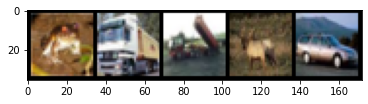

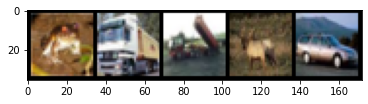

In [3]:

def squeeze(input: Tensor, inverse: bool = False):
    # Simply Re-shaping the tensor incorrectly squeezes
    # the dimensions. We want to maintain a better spatial
    # representation amongst the channels, so permute instead.
    B,C,H,W = input.shape
    out = input
    if not inverse:
        out = out.reshape(B,C, H//2, 2, W//2, 2)
        out = out.permute(0,1,3,5,2,4).contiguous()
        out = out.reshape(B,4*C,H//2, W//2)
    else:
        out = out.reshape(B, C//4, 2, 2, H, W)
        out = out.permute(0,1,4,2,5,3).contiguous()
        out = out.reshape(B,C//4,H*2,W*2)
        
    return out

x = next(iter(cifar_loader))[0]
x_squeeze = squeeze(x)
x_recon = squeeze(x_squeeze, inverse=True)

print('Mean Absolute Difference Reconstruction Cost: ', (x_recon - x).abs().mean().item())

x_grid = make_grid(x)
x_recon_grid = make_grid(x_recon)

show(x_grid)
show(x_recon_grid)

Mean Absolute Difference Reconstruction Cost:  0.0012288594152778387
Max Absolute Difference Reconstruction Cost:  0.0038647055625915527
Min Absolute Difference Reconstruction Cost:  1.341104507446289e-07


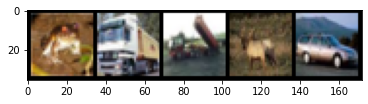

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


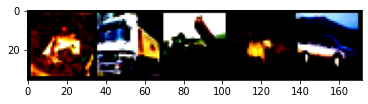

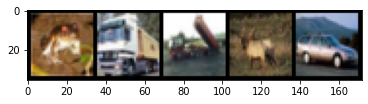

In [4]:
from torch import nn
import torch.nn.functional as F

def logit(p: Tensor) -> Tensor:
    # This is the inverse of a sigmoid function, aka a logit function as described in 4.1
    assert (p < 1).any() and (p >= 0).any(), f'Invalid probability value for logit: p={p}'
    return torch.log(p) - torch.log(1-p)

class Dequantization(nn.Module):
    """ 4.1 Dequantization function
        logit(alpha + (1 - alpha)*(x/256))
    """
    def __init__(self, alpha: float = 0.05) -> None:
        super().__init__()
        self.alpha = alpha
        self.prior = torch.distributions.Uniform(0.01, 0.99)
    
    def forward(self, input: Tensor, logdet: Tensor, inverse: bool = False, device: str = 'cpu') -> Tuple[Tensor, Tensor]:
        # Assume input is in range [0,1] pixel space
        if not inverse:
            input = (input*255 + self.prior.sample(input.shape).to(device))/256. # Some jitter preocedure
            
            # Shift data to [-1, 1]
            input = (input*2 - 1)*.9
            input += 1.
            input /= 2.
            
            logit_x = logit(input)
            
            pre_logit_scale = torch.tensor(np.log(0.9) - np.log(0.1))
            
            logdet = F.softplus(logit_x) + F.softplus(-logit_x) - F.softplus(-pre_logit_scale)
            
            return logit_x, logdet.sum(dim=(1,2,3))
            return input, logdet
        # Assume output should pixel space
        
        input = torch.sigmoid(input)
        input = input*2 - 1
        input = ((input / .9) + 1) / 2.
        
        return input, logdet
        

# Sanity Check
dequant = Dequantization()
x = next(iter(cifar_loader))[0]

x_deq, _ = dequant(x,0)
x_recon, _ = dequant(x_deq, 0, inverse=True)
print('Mean Absolute Difference Reconstruction Cost: ', (x_recon - x).abs().mean().item())
print('Max Absolute Difference Reconstruction Cost: ', (x_recon - x).abs().max().item())
print('Min Absolute Difference Reconstruction Cost: ', (x_recon - x).abs().min().item())

x_grid = make_grid(x)
x_deq_grid = make_grid(x_deq)
x_recon_grid = make_grid(x_recon)

show(x_grid)
show(x_deq_grid)
show(x_recon_grid)


In [ ]:
class Dequantization(nn.Module):
    def __init__(self, alpha=1e-5):
        super().__init__()
        self.alpha = alpha
        
    def forward(self, z, ldj, inverse=False):
        if not inverse:
            z, ldj = self.dequant(z, ldj)
            z, ldj = self.sigmoid(z, ldj, inverse=True)
        else:
            z, ldj = self.sigmoid(z, ldj, inverse=False)
            z = z.clamp(min=0, max=1)
            z[z.isnan()] = 0.# How learned to stop worrying and love the NaN
        return z, ldj
            
    def sigmoid(self, z, ldj, inverse=False):
        # Applies an invertible sigmoid transformation
        if not inverse:
            ldj += (-z-2*F.softplus(-z)).sum(dim=[1,2,3])
            z = torch.sigmoid(z)
        else:
            z = z * (1 - self.alpha) + 0.5 * self.alpha  # Scale to prevent boundaries 0 and 1
            ldj += np.log(1 - self.alpha) * np.prod(z.shape[1:])
            ldj += (-torch.log(z) - torch.log(1-z)).sum(dim=[1,2,3])
            z = torch.log(z) - torch.log(1-z)
        return z, ldj
        
    def dequant(self,x, ldj):
        z = x*255 + torch.rand_like(x).detach()
        z = z / 256.
        return z, ldj


In [ ]:
class OpenAIPreProcess(nn.Module):
    """ Using OpenAI's method for preprocessing.
    """
    def __init__(self):
        super().__init__()
        self.prior = torch.distributions.Uniform(0, 1.)
        
    def forward(self, input: Tensor, logdet: Tensor, inverse: bool = False, device:str='cpu') -> Tuple[Tensor, Tensor]:
        if not inverse:
            noise = self.prior.sample(input.shape).to(device)
            z = (input*255 + noise)/256. - .5
            return z, logdet # Logdet is a constant don't care really
        return input + .5, logdet

Mean Absolute Difference Reconstruction Error 1.8785613065119833e-09
Mean Absolute Difference Reconstruction Error 0.0


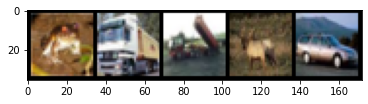

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


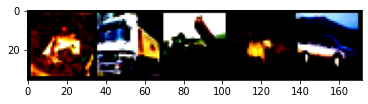

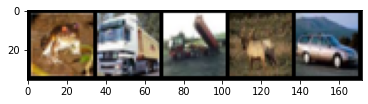

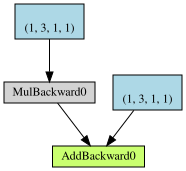

In [7]:
from torch import nn

class ActNorm(nn.Module):
    """ A Data-Dependent Normalization that gets initialized on the first batch.
        Simply a Linear transformation after getting the first mean and variance.
    """
    def __init__(self, in_dim: int) -> None:
        super().__init__()
        self.scale = nn.Parameter(torch.zeros(1,in_dim,1,1))
        self.bias = nn.Parameter(torch.zeros(1,in_dim,1,1))
        
        self.initialized = False
    
    @torch.no_grad()
    def init(self, input):
        B,C,H,W = input.shape
        
        # Calculate Mean, Variance per dimension and normalize
        with torch.no_grad():
            mu = torch.mean(input, dim=[0,2,3], keepdim=True)
            std = torch.sqrt(torch.var(input, dim=[0,2,3], keepdim=True))

            # Initialize the Scale and Bias
            self.bias.copy_(-mu/(std+1e-6)) # Shift Mean
            self.scale.copy_((1./std+1e-6)) # Scale 

            self.initialized = True
        
    def forward(self, input, ldj, inverse=False):
        B,C,H,W = input.shape
        
        # Initialize only once
        # Data-Dependent
        if not self.initialized:
            self.init(input)

        ldj_ = H*W*torch.sum(torch.log(torch.abs(self.scale)))
        
        if not inverse:
            ldj += ldj_
            return self.scale*input + self.bias, ldj
        
        ldj -= ldj_
        return (input - self.bias) / self.scale, ldj

    
# Sanity Check
x = next(iter(cifar_loader))[0]
an = ActNorm(3)
logdet = torch.zeros(cifar_batch_size)
x_an, logdet = an(x, logdet)

x_recon, logdet_recon = an(x_an, logdet, inverse=True)
# Note: The logdet seems very large
print(f'Mean Absolute Difference Reconstruction Error {(x_recon - x).abs().mean().item()}')
print(f'Mean Absolute Difference Reconstruction Error {(logdet - logdet_recon).abs().mean().item()}')

x_grid = make_grid(x)
x_an_grid = make_grid(x_an)
x_recon_grid = make_grid(x_recon.detach())

show(x_grid)
show(x_deq_grid)
show(x_recon_grid)

make_dot(x_an)

Mean Absolute Difference Reconstruction Error 2.184231817636828e-08
Mean Absolute Difference Reconstruction Error 0.0
Mean Absolute Difference Reconstruction Error 2.0422232793748663e-08
Mean Absolute Difference Reconstruction Error 0.0


/usr/lib/python3/dist-packages/ipykernel_launcher.py:21: UserWarning: This overload of nonzero is deprecated:
	nonzero()
Consider using one of the following signatures instead:
	nonzero(*, bool as_tuple) (Triggered internally at  /pytorch/torch/csrc/utils/python_arg_parser.cpp:882.)


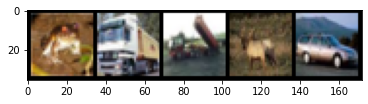

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


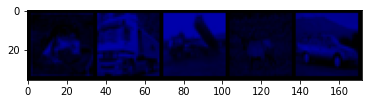

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


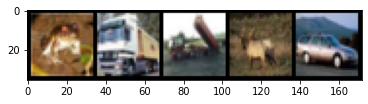

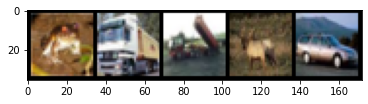

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


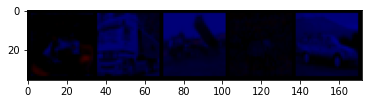

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


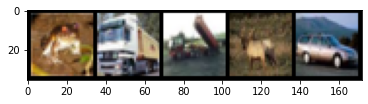

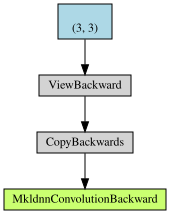

In [8]:
import torch.nn.functional as F

class Invertible1x1Conv(nn.Module):
    """ Just 1 1x1 convolution with the addition of calculating its log determinant and 
        inverse. Also possible to factorize W for faster log determinant calculation.
        The output size is expected to match the input size because we are using this
        as a permutation, furthermore the weight matrix is square.
    """
    
    def __init__(self, in_dim: int, fast: bool = False) -> None:
        super().__init__()
        self.fast = fast
        
        # Sample a Random Orthogonal Matrix using QR Decomposition
        # for intialization.
        W, _ = torch.qr(torch.rand((in_dim, in_dim))) 
        if not fast:
            self.W = nn.Parameter(W, requires_grad=True)
        else:
            LU, pivots, info = W.lu(get_infos=True)
            assert info.nonzero().size(0) == 0, 'LU Decomposition failed.'
            P, L, U = torch.lu_unpack(LU, pivots)
            
            # Extract the diagonal s for our determinant calculation
            s = U.diag()
            U -= torch.diag(s)
            
            # P Remains fixed, L,U, and s will be optimized over.
            self.register_buffer('P', P)
            self.register_parameter('L', nn.Parameter(L))
            self.register_parameter('U', nn.Parameter(U))
            self.register_parameter('s', nn.Parameter(s))
            
            # Debug, make sure decomposition comes out to be W
            #print(W)
            #print(P @ L @ (U + torch.diag(s)))
        
    def forward(self, input: Tensor, logdet: Tensor, inverse: bool = False) -> Tensor:
        b,c,h,w = input.shape
        
        if not self.fast:
            W = self.W
            logdet_ = h*w*W.slogdet()[1]
        else:
            W = self.P @ self.L @ (self.U + torch.diag(self.s))
            logdet_ = self.s.abs().log().sum()
            
        if not inverse:
            logdet += logdet_
            return F.conv2d(input, W.reshape(c,c,1,1)), logdet
        
        logdet -= logdet_
        return F.conv2d(input, W.double().inverse().float().reshape(c,c,1,1)), logdet
    
# Sanity Check
x = next(iter(cifar_loader))[0]
logdet = torch.zeros(cifar_batch_size)
iconv = Invertible1x1Conv(3)

x_iconv, logdet_iconv = iconv(x, logdet)
x_recon, logdet_recon = iconv(x_iconv, logdet_iconv, inverse=True)
print(f'Mean Absolute Difference Reconstruction Error {(x_recon - x).abs().mean().item()}')
print(f'Mean Absolute Difference Reconstruction Error {(logdet - logdet_recon).abs().mean().item()}')

iconv_fast = Invertible1x1Conv(3, fast=True)

x_iconv_fast, logdet_iconv_fast = iconv_fast(x, logdet)
x_recon_fast, logdet_recon = iconv_fast(x_iconv_fast, logdet_iconv_fast, inverse=True)
print(f'Mean Absolute Difference Reconstruction Error {(x_recon_fast - x).abs().mean().item()}')
print(f'Mean Absolute Difference Reconstruction Error {(logdet - logdet_recon).abs().mean().item()}')

x_grid = make_grid(x)
x_iconv_grid = make_grid(x_iconv.detach())
x_recon_grid = make_grid(x_recon.detach())

show(x_grid)
show(x_iconv_grid)
show(x_recon_grid)

x_grid = make_grid(x)
x_iconv_fast_grid = make_grid(x_iconv_fast.detach())
x_recon_fast_grid = make_grid(x_recon_fast.detach())

show(x_grid)
show(x_iconv_fast_grid)
show(x_recon_fast_grid)

make_dot(x_iconv)

torch.Size([5, 3, 32, 32]) torch.Size([5, 3, 32, 32])


/home/jason/.local/lib/python3.6/site-packages/torch/nn/functional.py:1639: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


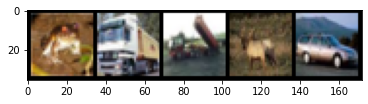

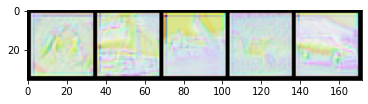

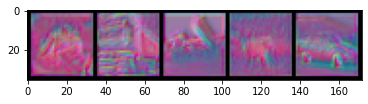

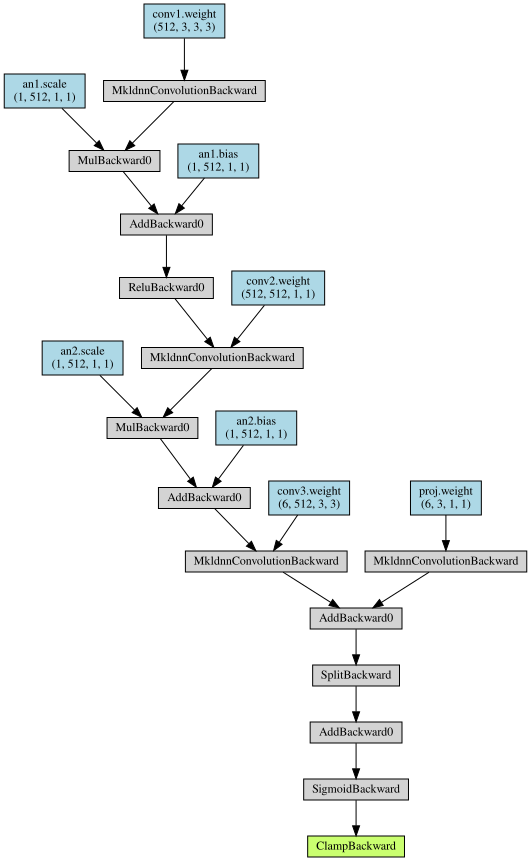

In [9]:
class STNet(nn.Module):
    """ Scale and translation network.
    """
    def __init__(self, in_dim: int, hidden_dim: int, init_last_zero: bool = False) -> None:
        super().__init__()
        self.conv1 = nn.Conv2d(in_dim, hidden_dim, (3,3), padding=1, bias = False)
        self.an1 = ActNorm(hidden_dim)
        self.conv2 = nn.Conv2d(hidden_dim, hidden_dim, (1,1), bias=False)
        self.an2 = ActNorm(hidden_dim)
        
        self.conv3 = nn.Conv2d(hidden_dim, in_dim*2, (3,3), padding=1, bias=False)
        
        self.proj = nn.Conv2d(in_dim, in_dim*2, (1,1), bias=False)
        self.scaling = nn.Parameter(torch.normal(0., 1., (1, in_dim, 1, 1)))
        
        # As in section 3.3, intialize last convolution to zeros
        if init_last_zero:
            self.conv3.weight = nn.Parameter(torch.zeros(self.conv3.weight.shape) + 1e-5)
        
    def forward(self, input: Tensor) -> Tuple[Tensor, Tensor]:        
        out = self.conv1(input)
        out,_ = self.an1(out,0)
        out = F.relu(out)
       
        out = self.conv2(out)
        out,_ = self.an2(out,0)
        
        out = self.conv3(out) + self.proj(input)
        #out = out * self.scaling.exp() * 3
        
        # Split the output evenly for the scale and translation
        s,t = out.chunk(2,dim=1)

        # Use sigmoid for stability
        # Papers says to use tanh, but for some reason OpenAI's source code uses sigmoid
        s = F.sigmoid(s + 2.)
        s = s.clamp(1e-5, 1)
        #s = s.tanh() * self.scaling
        return s,t
    
# Basic sanity check
x = next(iter(cifar_loader))[0]
stnet = STNet(3, 512)

s,t = stnet(x)
print(s.shape, t.shape)

x_grid = make_grid(x)
s_grid = make_grid(s.detach(), normalize=True)
t_grid = make_grid(t.detach(), normalize=True)

show(x_grid)
show(s_grid)
show(t_grid)

make_dot(s, params=dict(stnet.named_parameters()))

torch.Size([5, 12, 16, 16])
Mean Absolute Difference Reconstruction Error: 6.916282657698503e-09
Mean Absolute Difference Reconstruction Error 0.0


/home/jason/.local/lib/python3.6/site-packages/torch/nn/functional.py:1639: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


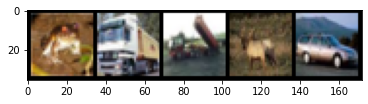

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


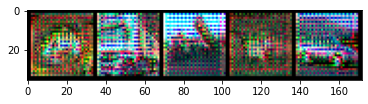

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


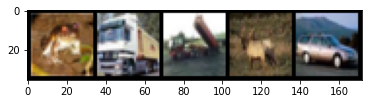

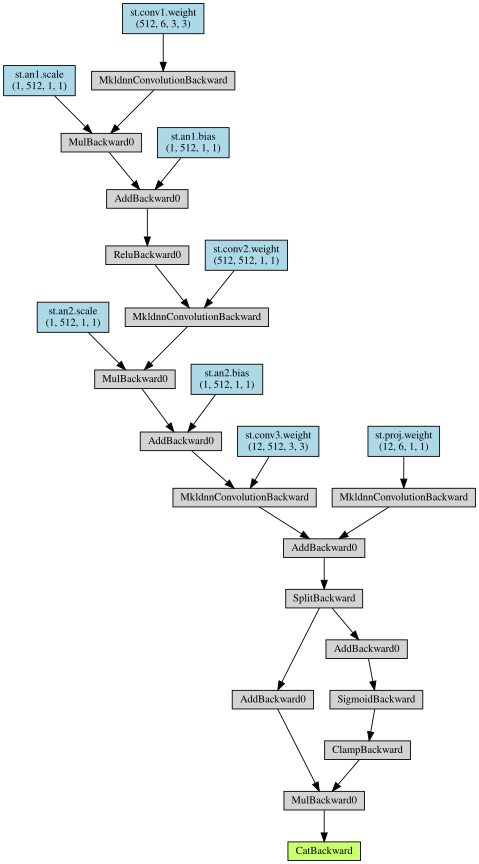

In [10]:
class AffineCoupling(nn.Module):
    def __init__(self, in_dim: int, hidden_dim: int, init_last_zero: bool = False) -> None:
        super().__init__()
        self.st = STNet(in_dim // 2, hidden_dim, init_last_zero)
        
    def forward(self, input: Tensor, logdet: Tensor, inverse: bool = False) -> Tuple[Tensor, Tensor]:
        if not inverse:
            x_a, x_b = input.chunk(2, dim=1)
            s,t = self.st(x_b)

            y_a = (x_a + t)*s
            logdet += s.abs().log().sum(dim=[1,2,3])
            
            y_b = x_b
            y = torch.cat((y_a,y_b),dim=1)
            
            return y, logdet
        
        y_a, y_b = input.chunk(2, dim=1)
        s,t = self.st(y_b)
        
        logdet -= s.abs().log().sum(dim=[1,2,3])
        
        x_a = (y_a / s) - t
        x_b = y_b
        x = torch.cat((x_a,x_b),dim=1)
        return x, logdet
    
# Sanity Check
x = squeeze(next(iter(cifar_loader))[0])
logdet = torch.zeros(cifar_batch_size)
print(x.shape)
affine = AffineCoupling(12,512, init_last_zero = False)
x_affine, logdet_affine = affine(x, logdet)
x_recon, logdet_recon = affine(x_affine, logdet_affine, inverse=True)

print(f'Mean Absolute Difference Reconstruction Error: {(x - x_recon).abs().mean().item()}')
print(f'Mean Absolute Difference Reconstruction Error {(logdet - logdet_recon).abs().mean().item()}')

x_grid = make_grid(squeeze(x, inverse=True))
x_affine_grid = make_grid(squeeze(x_affine.detach(), inverse=True))
x_recon_grid = make_grid(squeeze(x_recon.detach(), inverse=True))

show(x_grid)
show(x_affine_grid)
show(x_recon_grid)

make_dot(x_affine, params=dict(affine.named_parameters()))

Mean Absolute Difference Reconstruction Error: 1.6234345423526975e-08
Mean Absolute Difference Reconstruction Error 0.0


/home/jason/.local/lib/python3.6/site-packages/torch/nn/functional.py:1639: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


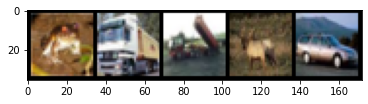

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


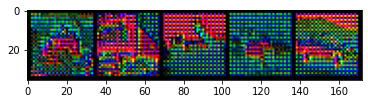

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


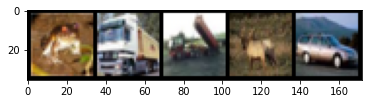

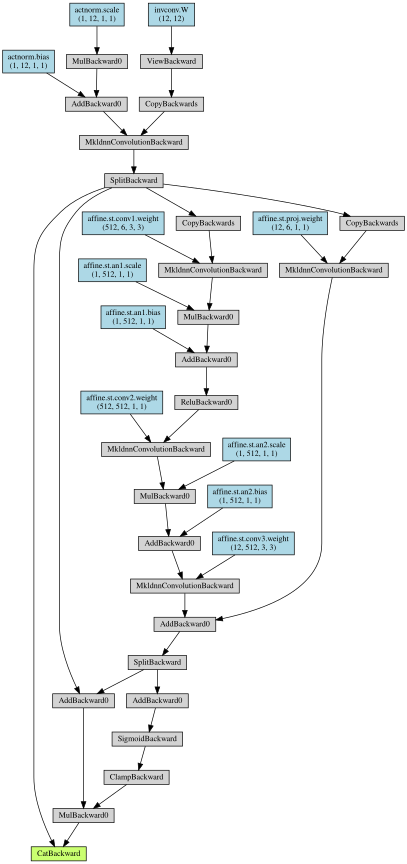

In [11]:
class Flow(nn.Module):
    def __init__(self, in_dim: int, hidden_dim: int) -> None:
        super().__init__()
        
        self.actnorm = ActNorm(in_dim)
        self.invconv = Invertible1x1Conv(in_dim)
        self.affine = AffineCoupling(in_dim, hidden_dim, init_last_zero = True)
        
    def forward(self, input: Tensor, logdet: Tensor, inverse: bool = False) -> Tuple[Tensor, Tensor]:
        out = input
        
        if not inverse:
            out, logdet = self.actnorm(out, logdet)
            out, logdet = self.invconv(out, logdet)
            out, logdet= self.affine(out, logdet)
            return out, logdet
        
        out, logdet = self.affine(out, logdet, inverse = True)
        out, logdet = self.invconv(out, logdet, inverse = True)
        out, logdet = self.actnorm(out, logdet, inverse = True)
        
        return out, logdet

# Sanity check
x = squeeze(next(iter(cifar_loader))[0])
logdet = torch.zeros(cifar_batch_size)

flow = Flow(12, 512)
x_flow, logdet_flow = flow(x, logdet)
x_recon, logdet_recon = flow(x_flow, logdet_flow, inverse=True)

print(f'Mean Absolute Difference Reconstruction Error: {(x - x_recon).abs().mean().item()}')
print(f'Mean Absolute Difference Reconstruction Error {(logdet - logdet_recon).abs().mean().item()}')

x_grid = make_grid(squeeze(x, inverse=True))
x_flow_grid = make_grid(squeeze(x_flow.detach(), inverse=True)) # Checkerboarding here
x_recon_grid = make_grid(squeeze(x_recon.detach(), inverse=True))

show(x_grid)
show(x_flow_grid)
show(x_recon_grid)

make_dot(x_flow, params=dict(flow.named_parameters()))

/home/jason/.local/lib/python3.6/site-packages/torch/nn/functional.py:1639: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


Mean Absolute Difference Reconstruction Error: 1.1047033154909514e-07
Mean Absolute Difference Reconstruction Error 0.0


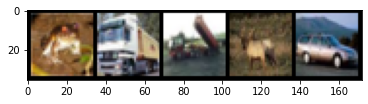

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


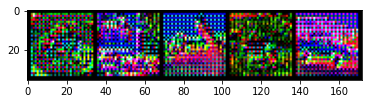

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


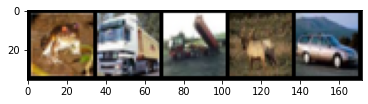

In [12]:
class Flows(nn.Module):
    def __init__(self, K: int, in_dim: int, hidden_dim: int) -> None:
        super().__init__()
        self.K = K
        self.in_dim = in_dim
        self.hidden_dim = hidden_dim 
        self.flows = nn.ModuleList([ Flow(in_dim, hidden_dim) for i in range(K)])
        
    def forward(self, input: Tensor, logdet: Tensor, inverse: bool = False) -> Tuple[Tensor, Tensor]:
        out = input
        if not inverse:
            for flow in self.flows:
                out, logdet = flow(out, logdet)
            return out, logdet
        
        for flow in reversed(self.flows):
            out, logdet = flow(out, logdet, inverse=True)
        
        return out, logdet

# Sanity Check
x = squeeze(next(iter(cifar_loader))[0])
logdet = torch.zeros(cifar_batch_size)

flows = Flows(8,12,512)
x_flows, logdet_flows = flows(x, logdet)
x_recon, logdet_recon = flows(x_flows, logdet_flows, inverse=True)

print(f'Mean Absolute Difference Reconstruction Error: {(x - x_recon).abs().mean().item()}')
print(f'Mean Absolute Difference Reconstruction Error {(logdet - logdet_recon).abs().mean().item()}')

x_grid = make_grid(squeeze(x,inverse=True))
x_flows_grid = make_grid(squeeze(x_flows.detach(),inverse=True))
x_recon_grid = make_grid(squeeze(x_recon.detach(), inverse=True))

show(x_grid)
show(x_flows_grid)
show(x_recon_grid)


Mean Absolute Difference Reconstruction Error: 0.0012466603657230735
Mean Absolute Difference Reconstruction Error 0.03076171875
Log Probability: tensor([ 226.4399,  396.0879, 1760.4141, 1318.3499,  434.3525],
       grad_fn=<AddBackward0>)


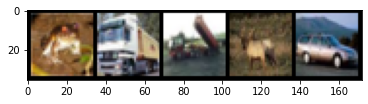

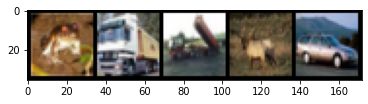

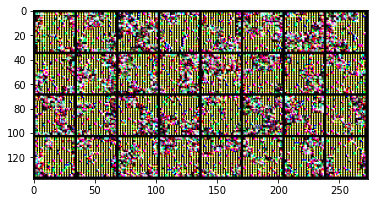

In [13]:
class Glow(nn.Module):
    def __init__(self, K: int, L: int, in_dim: int, hidden_dim: int) -> None:
        super().__init__()
        self.K = K
        self.L = L
        
        self.flows = nn.ModuleList([Flows(K, in_dim*2**(i+2), hidden_dim) for i in range(self.L)])
        self.prior = torch.distributions.Normal(loc=0., scale=1.)
        self.dequantize = Dequantization()
    
    def forward(self, input: Tensor, device: str = 'cpu') -> Tuple[list, Tensor]:
        zs = []        
        logdet = torch.zeros(input.shape[0]).to(device)
        z, logdet = self.dequantize(input, logdet)
        for flow in self.flows[:-1]:
            z = squeeze(z)
            
            z, logdet = flow(z, logdet)
            
            z, z_split = z.chunk(2,dim=1)
            zs.append(z_split)
        
        z = squeeze(z)
        z, logdet = self.flows[-1](z, logdet)
        zs.append(z)
        
        return zs, logdet
    
    @torch.no_grad()
    def inverse(self, zs: list, logdet: Tensor) -> Tuple[Tensor, Tensor]:
        z, logdet = self.flows[-1](zs[-1], logdet, inverse=True)
        z = squeeze(z, inverse=True)

        for flow, z_ in zip(reversed(self.flows[:-1]), reversed(zs[:-1])):
            z = torch.cat((z,z_),dim=1)
            z, logdet = flow(z, logdet, inverse=True)
            z = squeeze(z, inverse=True)
        
        z, logdet = self.dequantize(z, logdet, inverse=True)
        return z, logdet
    
    @torch.no_grad()
    def sample(self, sample_shape, device: str = 'cpu') -> Tensor:
        zs, logdet = self.gen_z(sample_shape, device)
        return self.inverse(zs, logdet)[0]
    
    @torch.no_grad()
    def gen_z(self, sample_shape, device: str = 'cpu') -> Tuple[list, Tensor]:
        B,C,H,W = sample_shape
        
        z = self.prior.sample((B,C,H,W)).to(device, dtype=torch.float)
        zs = []
        
        # Since we have a multi-level architecture,
        # we have to construct the z from each level
        for i in range(self.L):
            z = squeeze(z)
            if self.L - 1 != i:
                z_split, z = z.chunk(2, dim=1)
            zs.append(self.prior.sample(z.shape).to(device, dtype=torch.float))
            
        logdet = torch.zeros(B).to(device, dtype=torch.float)
            
        return zs, logdet
    
    def log_prob(self, input: Tensor, device: str = 'cpu') -> Tensor:
        zs, logdet = self.forward(input, device)
        ll = 0.
        for z in zs:
            ll += self.prior.log_prob(z).sum(dim=[1,2,3])
            
        return ll + logdet
    
# Sanity Check
x = next(iter(cifar_loader))[0]
logdet = torch.zeros(cifar_batch_size)

glow = Glow(8,1,3,32)
zs, logdet_glow = glow(x, logdet)

x_recon, logdet_recon = glow.inverse(zs, logdet_glow)
log_prob = glow.log_prob(x)
sample = glow.sample((32,3,32,32))
print(f'Mean Absolute Difference Reconstruction Error: {(x - x_recon).abs().mean().item()}')
print(f'Mean Absolute Difference Reconstruction Error {(logdet - logdet_recon).abs().mean().item()}')
print(f'Log Probability: {glow.log_prob(x)}')

x_grid = make_grid(x)
x_recon_grid = make_grid(x_recon.detach())

show(x_grid)
show(x_recon_grid) 
sample_grid = make_grid(sample)
show(sample_grid)

#dot = make_dot(log_prob, params=dict(glow.named_parameters()))
#dot.format = 'png'
#dot.render('glow_model_logprob')

torch.Size([800, 1, 28, 28])


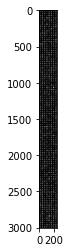

NUMBER OF PARAMETERS:  615104


In [14]:
from torchvision import datasets, transforms
from torchvision.utils import make_grid
from torch.utils.data import DataLoader, Dataset

# Select the Dataset here
DATASET = ['MNIST', 'SVHN', 'CIFAR10', 'MOONS'][0]
BATCH_SIZE = 800

# Load the dataset and define the model
if DATASET == 'MNIST':
    transform = transforms.Compose([transforms.ToTensor()])
    preprocess = None
    train = datasets.MNIST('../datasets', train=True, transform=transform, download=True)
    test = datasets.MNIST('../datasets', train=False, transform=transform, download=True)
    train_loader = DataLoader(train, batch_size=BATCH_SIZE, pin_memory=True)
    test_loader = DataLoader(test, batch_size=BATCH_SIZE)
    
    # Model Architecture
    K = 32
    L = 2
    in_dim = 1
    hidden_dim = 64
    model = Glow(K, L, in_dim, hidden_dim)
    
elif DATASET == 'CIFAR10':
    transform = transforms.Compose([transforms.ToTensor()])
    preprocess = None
    train = datasets.CIFAR10('../datasets', train=True, transform=transform, download=True)
    test = datasets.CIFAR10('../datasets', train=False, transform=transform, download=True)
    train_loader = DataLoader(train, shuffle=True, batch_size=BATCH_SIZE)
    test_loader = DataLoader(test, batch_size=BATCH_SIZE)
    
    # Model Architecture    
    K = 8
    L = 2
    in_dim = 1
    hidden_dim = 512
    model = Glow(K, L, in_dim, hidden_dim)

elif DATASET == 'SVHN':
    svhn_zca = torch.tensor(np.load('svhn_zca.npy'))
    svhn_mean = torch.tensor(np.load('svhn_mean.npy'))
    preprocess = ZCA(svhn_zca, svhn_mean)
    transform = transforms.Compose([transforms.ToTensor()])
    train = datasets.SVHN('../datasets', split='train', transform=transform, download=True)
    test = datasets.SVHN('../datasets', split='test', transform=transform, download=True)
    train_loader = DataLoader(train, shuffle=True, batch_size=BATCH_SIZE, pin_memory = True)
    test_loader = DataLoader(test, batch_size=BATCH_SIZE)

    # Model Architecture
    K = 8
    L = 1
    in_dim = 1
    hidden_dim = 512
    model = Glow(K, L, in_dim, hidden_dim)

batch, _ = next(iter(train_loader))[:10]
print(batch.shape)
batch_grid = make_grid(batch, normalize=True)
show(batch_grid)

if preprocess:    
    batch_grid = make_grid(preprocess(batch.to(device)).detach().cpu(), normalize=True)
    show(batch_grid)
else:
    batch_grid = make_grid(batch, normalize=True)
            
num_params = 0
for p in model.parameters():
    num_params += torch.prod(torch.tensor(p.shape))
    
print('NUMBER OF PARAMETERS: ', num_params.item())


Epoch: [1/500]) Batch: [1/75] Negative Log-Likelihood: -2213.2626953125


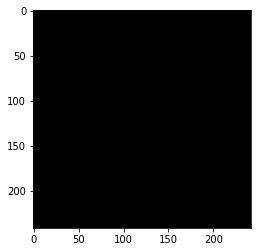

Epoch: [1/500]) Batch: [2/75] Negative Log-Likelihood: -1908.365234375
Epoch: [1/500]) Batch: [3/75] Negative Log-Likelihood: -1737.6121826171875
Epoch: [1/500]) Batch: [4/75] Negative Log-Likelihood: -1482.0455322265625
Epoch: [1/500]) Batch: [5/75] Negative Log-Likelihood: -1618.32373046875
Epoch: [1/500]) Batch: [6/75] Negative Log-Likelihood: -1880.274658203125
Epoch: [1/500]) Batch: [7/75] Negative Log-Likelihood: -2056.0927734375
Epoch: [1/500]) Batch: [8/75] Negative Log-Likelihood: -1936.236328125
Epoch: [1/500]) Batch: [9/75] Negative Log-Likelihood: -2251.568603515625
Epoch: [1/500]) Batch: [10/75] Negative Log-Likelihood: -2224.1640625
Epoch: [1/500]) Batch: [11/75] Negative Log-Likelihood: -2269.278076171875
Epoch: [1/500]) Batch: [12/75] Negative Log-Likelihood: -2414.75732421875
Epoch: [1/500]) Batch: [13/75] Negative Log-Likelihood: -2549.15625
Epoch: [1/500]) Batch: [14/75] Negative Log-Likelihood: -2355.859130859375
Epoch: [1/500]) Batch: [15/75] Negative Log-Likelihoo

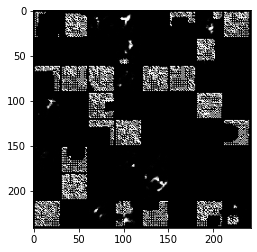

Epoch: [1/500]) Negative Log-Likelihood: -3406.55078125
Epoch: [2/500]) Batch: [1/75] Negative Log-Likelihood: -3442.2080078125


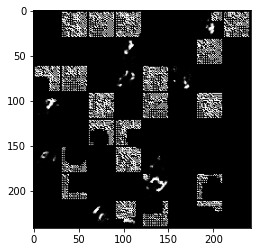

Epoch: [2/500]) Batch: [2/75] Negative Log-Likelihood: -3438.068359375
Epoch: [2/500]) Batch: [3/75] Negative Log-Likelihood: -3443.753662109375
Epoch: [2/500]) Batch: [4/75] Negative Log-Likelihood: -3431.698974609375
Epoch: [2/500]) Batch: [5/75] Negative Log-Likelihood: -3453.378662109375
Epoch: [2/500]) Batch: [6/75] Negative Log-Likelihood: -3447.22314453125
Epoch: [2/500]) Batch: [7/75] Negative Log-Likelihood: -3433.798583984375
Epoch: [2/500]) Batch: [8/75] Negative Log-Likelihood: -3444.777099609375
Epoch: [2/500]) Batch: [9/75] Negative Log-Likelihood: -3466.0166015625
Epoch: [2/500]) Batch: [10/75] Negative Log-Likelihood: -3465.8525390625
Epoch: [2/500]) Batch: [11/75] Negative Log-Likelihood: -3454.46875
Epoch: [2/500]) Batch: [12/75] Negative Log-Likelihood: -3468.436767578125
Epoch: [2/500]) Batch: [13/75] Negative Log-Likelihood: -3447.6806640625
Epoch: [2/500]) Batch: [14/75] Negative Log-Likelihood: -3463.25927734375
Epoch: [2/500]) Batch: [15/75] Negative Log-Likelih

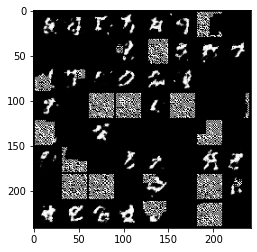

Epoch: [2/500]) Negative Log-Likelihood: -3479.647705078125
Epoch: [3/500]) Batch: [1/75] Negative Log-Likelihood: -3504.317626953125


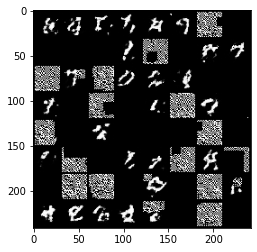

Epoch: [3/500]) Batch: [2/75] Negative Log-Likelihood: -3513.063720703125
Epoch: [3/500]) Batch: [3/75] Negative Log-Likelihood: -3511.239990234375
Epoch: [3/500]) Batch: [4/75] Negative Log-Likelihood: -3498.296142578125
Epoch: [3/500]) Batch: [5/75] Negative Log-Likelihood: -3512.27734375
Epoch: [3/500]) Batch: [6/75] Negative Log-Likelihood: -3510.1796875
Epoch: [3/500]) Batch: [7/75] Negative Log-Likelihood: -3496.30859375
Epoch: [3/500]) Batch: [8/75] Negative Log-Likelihood: -3510.801513671875
Epoch: [3/500]) Batch: [9/75] Negative Log-Likelihood: -3525.357421875
Epoch: [3/500]) Batch: [10/75] Negative Log-Likelihood: -3518.62744140625
Epoch: [3/500]) Batch: [11/75] Negative Log-Likelihood: -3510.583984375
Epoch: [3/500]) Batch: [12/75] Negative Log-Likelihood: -3515.143310546875
Epoch: [3/500]) Batch: [13/75] Negative Log-Likelihood: -3506.161376953125
Epoch: [3/500]) Batch: [14/75] Negative Log-Likelihood: -3506.2373046875
Epoch: [3/500]) Batch: [15/75] Negative Log-Likelihood:

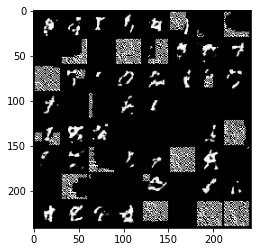

Epoch: [3/500]) Negative Log-Likelihood: -3487.49658203125
Epoch: [4/500]) Batch: [1/75] Negative Log-Likelihood: -3519.733154296875


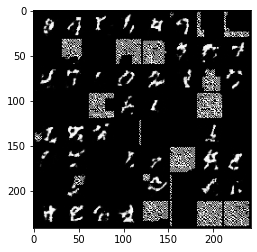

Epoch: [4/500]) Batch: [2/75] Negative Log-Likelihood: -3509.7421875
Epoch: [4/500]) Batch: [3/75] Negative Log-Likelihood: -3531.309326171875
Epoch: [4/500]) Batch: [4/75] Negative Log-Likelihood: -3505.1279296875
Epoch: [4/500]) Batch: [5/75] Negative Log-Likelihood: -3509.986083984375
Epoch: [4/500]) Batch: [6/75] Negative Log-Likelihood: -3519.15966796875
Epoch: [4/500]) Batch: [7/75] Negative Log-Likelihood: -3506.736083984375
Epoch: [4/500]) Batch: [8/75] Negative Log-Likelihood: -3516.6767578125
Epoch: [4/500]) Batch: [9/75] Negative Log-Likelihood: -3537.936279296875
Epoch: [4/500]) Batch: [10/75] Negative Log-Likelihood: -3529.58935546875
Epoch: [4/500]) Batch: [11/75] Negative Log-Likelihood: -3524.5947265625
Epoch: [4/500]) Batch: [12/75] Negative Log-Likelihood: -3530.48828125
Epoch: [4/500]) Batch: [13/75] Negative Log-Likelihood: -3511.880615234375
Epoch: [4/500]) Batch: [14/75] Negative Log-Likelihood: -3531.066162109375
Epoch: [4/500]) Batch: [15/75] Negative Log-Likeli

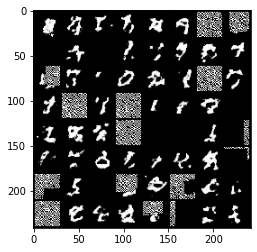

Epoch: [4/500]) Negative Log-Likelihood: -3508.76513671875
Epoch: [5/500]) Batch: [1/75] Negative Log-Likelihood: -3544.894287109375


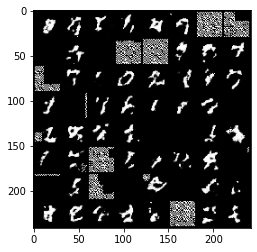

Epoch: [5/500]) Batch: [2/75] Negative Log-Likelihood: -3539.96923828125
Epoch: [5/500]) Batch: [3/75] Negative Log-Likelihood: -3545.90869140625
Epoch: [5/500]) Batch: [4/75] Negative Log-Likelihood: -3529.6162109375
Epoch: [5/500]) Batch: [5/75] Negative Log-Likelihood: -3543.351806640625
Epoch: [5/500]) Batch: [6/75] Negative Log-Likelihood: -3541.970458984375
Epoch: [5/500]) Batch: [7/75] Negative Log-Likelihood: -3528.670654296875
Epoch: [5/500]) Batch: [8/75] Negative Log-Likelihood: -3543.445556640625
Epoch: [5/500]) Batch: [9/75] Negative Log-Likelihood: -3554.42919921875
Epoch: [5/500]) Batch: [10/75] Negative Log-Likelihood: -3553.55126953125
Epoch: [5/500]) Batch: [11/75] Negative Log-Likelihood: -3547.705810546875
Epoch: [5/500]) Batch: [12/75] Negative Log-Likelihood: -3545.647705078125
Epoch: [5/500]) Batch: [13/75] Negative Log-Likelihood: -3539.720947265625
Epoch: [5/500]) Batch: [14/75] Negative Log-Likelihood: -3538.47705078125
Epoch: [5/500]) Batch: [15/75] Negative 

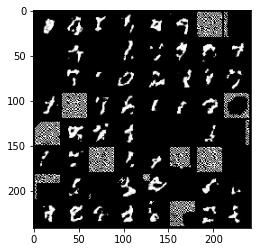

Epoch: [5/500]) Negative Log-Likelihood: -3530.432373046875
Epoch: [6/500]) Batch: [1/75] Negative Log-Likelihood: -3556.734375


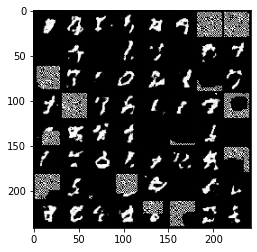

Epoch: [6/500]) Batch: [2/75] Negative Log-Likelihood: -3557.279296875
Epoch: [6/500]) Batch: [3/75] Negative Log-Likelihood: -3559.686767578125
Epoch: [6/500]) Batch: [4/75] Negative Log-Likelihood: -3549.375
Epoch: [6/500]) Batch: [5/75] Negative Log-Likelihood: -3558.075927734375
Epoch: [6/500]) Batch: [6/75] Negative Log-Likelihood: -3553.873046875
Epoch: [6/500]) Batch: [7/75] Negative Log-Likelihood: -3547.050537109375
Epoch: [6/500]) Batch: [8/75] Negative Log-Likelihood: -3558.963623046875
Epoch: [6/500]) Batch: [9/75] Negative Log-Likelihood: -3566.811767578125
Epoch: [6/500]) Batch: [10/75] Negative Log-Likelihood: -3568.11669921875
Epoch: [6/500]) Batch: [11/75] Negative Log-Likelihood: -3554.1728515625
Epoch: [6/500]) Batch: [12/75] Negative Log-Likelihood: -3554.736083984375
Epoch: [6/500]) Batch: [13/75] Negative Log-Likelihood: -3550.00732421875
Epoch: [6/500]) Batch: [14/75] Negative Log-Likelihood: -3551.653564453125
Epoch: [6/500]) Batch: [15/75] Negative Log-Likeliho

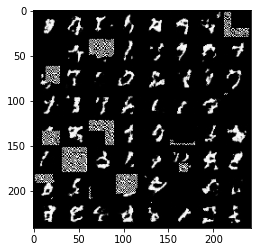

Epoch: [6/500]) Negative Log-Likelihood: -3525.453125
Epoch: [7/500]) Batch: [1/75] Negative Log-Likelihood: -3558.57861328125


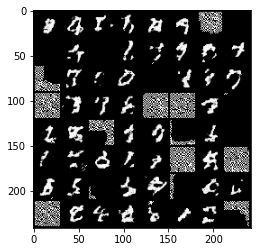

Epoch: [7/500]) Batch: [2/75] Negative Log-Likelihood: -3556.94873046875
Epoch: [7/500]) Batch: [3/75] Negative Log-Likelihood: -3563.9609375
Epoch: [7/500]) Batch: [4/75] Negative Log-Likelihood: -3550.646728515625
Epoch: [7/500]) Batch: [5/75] Negative Log-Likelihood: -3566.3232421875
Epoch: [7/500]) Batch: [6/75] Negative Log-Likelihood: -3561.4462890625
Epoch: [7/500]) Batch: [7/75] Negative Log-Likelihood: -3547.588134765625
Epoch: [7/500]) Batch: [8/75] Negative Log-Likelihood: -3567.658447265625
Epoch: [7/500]) Batch: [9/75] Negative Log-Likelihood: -3578.032470703125
Epoch: [7/500]) Batch: [10/75] Negative Log-Likelihood: -3572.014404296875
Epoch: [7/500]) Batch: [11/75] Negative Log-Likelihood: -3572.622314453125
Epoch: [7/500]) Batch: [12/75] Negative Log-Likelihood: -3560.94677734375
Epoch: [7/500]) Batch: [13/75] Negative Log-Likelihood: -3546.738037109375
Epoch: [7/500]) Batch: [14/75] Negative Log-Likelihood: -3564.7041015625
Epoch: [7/500]) Batch: [15/75] Negative Log-Li

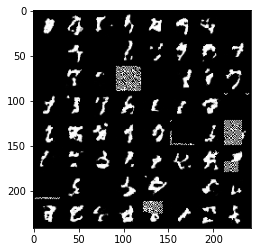

Epoch: [7/500]) Negative Log-Likelihood: -3548.733154296875
Epoch: [8/500]) Batch: [1/75] Negative Log-Likelihood: -3564.068115234375


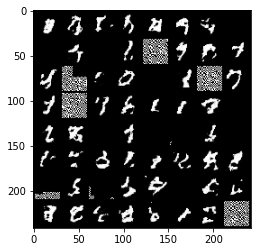

Epoch: [8/500]) Batch: [2/75] Negative Log-Likelihood: -3568.1435546875
Epoch: [8/500]) Batch: [3/75] Negative Log-Likelihood: -3577.6103515625
Epoch: [8/500]) Batch: [4/75] Negative Log-Likelihood: -3564.1494140625
Epoch: [8/500]) Batch: [5/75] Negative Log-Likelihood: -3572.65673828125
Epoch: [8/500]) Batch: [6/75] Negative Log-Likelihood: -3572.89892578125
Epoch: [8/500]) Batch: [7/75] Negative Log-Likelihood: -3558.1953125
Epoch: [8/500]) Batch: [8/75] Negative Log-Likelihood: -3567.60205078125
Epoch: [8/500]) Batch: [9/75] Negative Log-Likelihood: -3588.614501953125
Epoch: [8/500]) Batch: [10/75] Negative Log-Likelihood: -3584.453125
Epoch: [8/500]) Batch: [11/75] Negative Log-Likelihood: -3575.313720703125
Epoch: [8/500]) Batch: [12/75] Negative Log-Likelihood: -3578.0654296875
Epoch: [8/500]) Batch: [13/75] Negative Log-Likelihood: -3570.683349609375
Epoch: [8/500]) Batch: [14/75] Negative Log-Likelihood: -3576.790771484375
Epoch: [8/500]) Batch: [15/75] Negative Log-Likelihood:

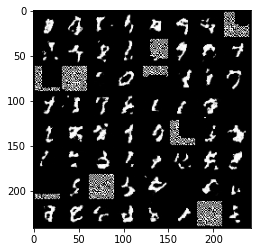

Epoch: [8/500]) Negative Log-Likelihood: -3553.85986328125
Epoch: [9/500]) Batch: [1/75] Negative Log-Likelihood: -3576.97216796875


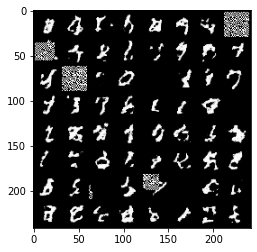

Epoch: [9/500]) Batch: [2/75] Negative Log-Likelihood: -3575.510009765625
Epoch: [9/500]) Batch: [3/75] Negative Log-Likelihood: -3583.58251953125
Epoch: [9/500]) Batch: [4/75] Negative Log-Likelihood: -3553.86376953125
Epoch: [9/500]) Batch: [5/75] Negative Log-Likelihood: -3578.823974609375
Epoch: [9/500]) Batch: [6/75] Negative Log-Likelihood: -3555.98486328125
Epoch: [9/500]) Batch: [7/75] Negative Log-Likelihood: -3543.387939453125
Epoch: [9/500]) Batch: [8/75] Negative Log-Likelihood: -3564.025634765625
Epoch: [9/500]) Batch: [9/75] Negative Log-Likelihood: -3581.919189453125
Epoch: [9/500]) Batch: [10/75] Negative Log-Likelihood: -3576.156494140625
Epoch: [9/500]) Batch: [11/75] Negative Log-Likelihood: -3570.232421875
Epoch: [9/500]) Batch: [12/75] Negative Log-Likelihood: -3579.91748046875
Epoch: [9/500]) Batch: [13/75] Negative Log-Likelihood: -3564.64111328125
Epoch: [9/500]) Batch: [14/75] Negative Log-Likelihood: -3577.938720703125
Epoch: [9/500]) Batch: [15/75] Negative L

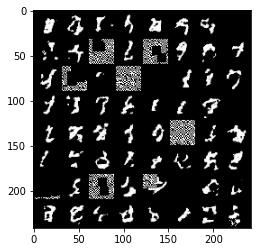

Epoch: [9/500]) Negative Log-Likelihood: -3550.816162109375
Epoch: [10/500]) Batch: [1/75] Negative Log-Likelihood: -3581.349853515625


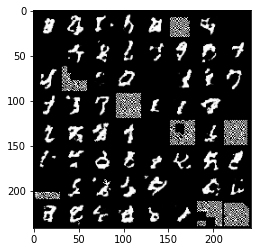

Epoch: [10/500]) Batch: [2/75] Negative Log-Likelihood: -3584.731689453125
Epoch: [10/500]) Batch: [3/75] Negative Log-Likelihood: -3588.58740234375
Epoch: [10/500]) Batch: [4/75] Negative Log-Likelihood: -3571.08544921875
Epoch: [10/500]) Batch: [5/75] Negative Log-Likelihood: -3584.389404296875
Epoch: [10/500]) Batch: [6/75] Negative Log-Likelihood: -3588.9140625
Epoch: [10/500]) Batch: [7/75] Negative Log-Likelihood: -3575.9462890625
Epoch: [10/500]) Batch: [8/75] Negative Log-Likelihood: -3583.62548828125
Epoch: [10/500]) Batch: [9/75] Negative Log-Likelihood: -3602.4873046875
Epoch: [10/500]) Batch: [10/75] Negative Log-Likelihood: -3593.976806640625
Epoch: [10/500]) Batch: [11/75] Negative Log-Likelihood: -3588.634521484375
Epoch: [10/500]) Batch: [12/75] Negative Log-Likelihood: -3591.49951171875
Epoch: [10/500]) Batch: [13/75] Negative Log-Likelihood: -3582.3505859375
Epoch: [10/500]) Batch: [14/75] Negative Log-Likelihood: -3585.99560546875
Epoch: [10/500]) Batch: [15/75] Nega

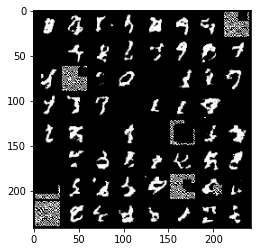

Epoch: [10/500]) Negative Log-Likelihood: -3563.543701171875
Epoch: [11/500]) Batch: [1/75] Negative Log-Likelihood: -3578.328369140625


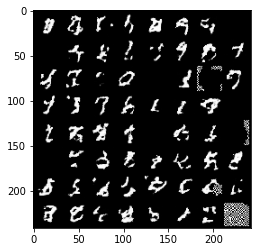

Epoch: [11/500]) Batch: [2/75] Negative Log-Likelihood: -3589.14990234375
Epoch: [11/500]) Batch: [3/75] Negative Log-Likelihood: -3591.80615234375
Epoch: [11/500]) Batch: [4/75] Negative Log-Likelihood: -3580.10302734375
Epoch: [11/500]) Batch: [5/75] Negative Log-Likelihood: -3592.23486328125
Epoch: [11/500]) Batch: [6/75] Negative Log-Likelihood: -3584.5908203125
Epoch: [11/500]) Batch: [7/75] Negative Log-Likelihood: -3579.50439453125
Epoch: [11/500]) Batch: [8/75] Negative Log-Likelihood: -3586.40625
Epoch: [11/500]) Batch: [9/75] Negative Log-Likelihood: -3602.095458984375
Epoch: [11/500]) Batch: [10/75] Negative Log-Likelihood: -3595.7529296875
Epoch: [11/500]) Batch: [11/75] Negative Log-Likelihood: -3595.18359375
Epoch: [11/500]) Batch: [12/75] Negative Log-Likelihood: -3587.2451171875
Epoch: [11/500]) Batch: [13/75] Negative Log-Likelihood: -3583.536376953125
Epoch: [11/500]) Batch: [14/75] Negative Log-Likelihood: -3587.14794921875
Epoch: [11/500]) Batch: [15/75] Negative Lo

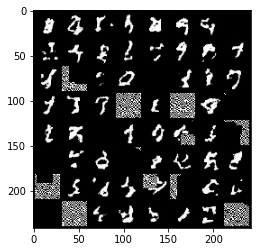

Epoch: [11/500]) Negative Log-Likelihood: -3565.80029296875
Epoch: [12/500]) Batch: [1/75] Negative Log-Likelihood: -3580.48046875


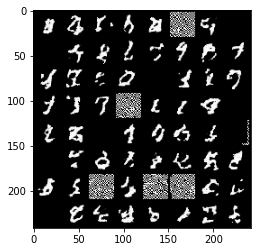

Epoch: [12/500]) Batch: [2/75] Negative Log-Likelihood: -3581.890869140625
Epoch: [12/500]) Batch: [3/75] Negative Log-Likelihood: -3592.578125
Epoch: [12/500]) Batch: [4/75] Negative Log-Likelihood: -3573.657958984375
Epoch: [12/500]) Batch: [5/75] Negative Log-Likelihood: -3594.04248046875
Epoch: [12/500]) Batch: [6/75] Negative Log-Likelihood: -3587.318115234375
Epoch: [12/500]) Batch: [7/75] Negative Log-Likelihood: -3575.7373046875
Epoch: [12/500]) Batch: [8/75] Negative Log-Likelihood: -3583.699951171875
Epoch: [12/500]) Batch: [9/75] Negative Log-Likelihood: -3604.95654296875
Epoch: [12/500]) Batch: [10/75] Negative Log-Likelihood: -3599.833984375
Epoch: [12/500]) Batch: [11/75] Negative Log-Likelihood: -3594.74169921875
Epoch: [12/500]) Batch: [12/75] Negative Log-Likelihood: -3602.13671875
Epoch: [12/500]) Batch: [13/75] Negative Log-Likelihood: -3579.05810546875
Epoch: [12/500]) Batch: [14/75] Negative Log-Likelihood: -3592.799560546875
Epoch: [12/500]) Batch: [15/75] Negativ

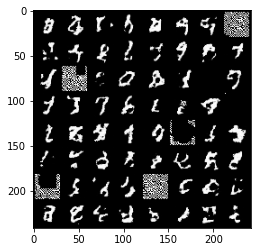

Epoch: [12/500]) Negative Log-Likelihood: -3568.259033203125
Epoch: [13/500]) Batch: [1/75] Negative Log-Likelihood: -3596.7080078125


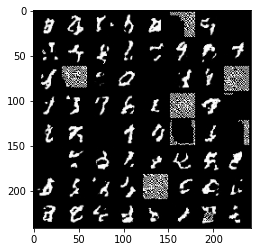

Epoch: [13/500]) Batch: [2/75] Negative Log-Likelihood: -3599.752197265625
Epoch: [13/500]) Batch: [3/75] Negative Log-Likelihood: -3606.6708984375
Epoch: [13/500]) Batch: [4/75] Negative Log-Likelihood: -3584.2890625
Epoch: [13/500]) Batch: [5/75] Negative Log-Likelihood: -3603.3935546875
Epoch: [13/500]) Batch: [6/75] Negative Log-Likelihood: -3586.1298828125
Epoch: [13/500]) Batch: [7/75] Negative Log-Likelihood: -3579.240234375
Epoch: [13/500]) Batch: [8/75] Negative Log-Likelihood: -3582.371826171875
Epoch: [13/500]) Batch: [9/75] Negative Log-Likelihood: -3594.7998046875
Epoch: [13/500]) Batch: [10/75] Negative Log-Likelihood: -3602.68115234375
Epoch: [13/500]) Batch: [11/75] Negative Log-Likelihood: -3587.823974609375
Epoch: [13/500]) Batch: [12/75] Negative Log-Likelihood: -3597.912353515625
Epoch: [13/500]) Batch: [13/75] Negative Log-Likelihood: -3577.5849609375
Epoch: [13/500]) Batch: [14/75] Negative Log-Likelihood: -3577.4443359375
Epoch: [13/500]) Batch: [15/75] Negative 

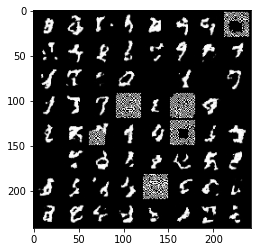

Epoch: [13/500]) Negative Log-Likelihood: -3578.61181640625
Epoch: [14/500]) Batch: [1/75] Negative Log-Likelihood: -3602.9111328125


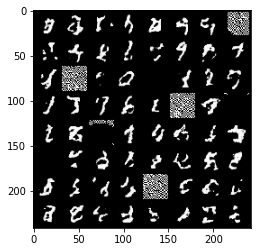

Epoch: [14/500]) Batch: [2/75] Negative Log-Likelihood: -3599.8349609375
Epoch: [14/500]) Batch: [3/75] Negative Log-Likelihood: -3612.06689453125
Epoch: [14/500]) Batch: [4/75] Negative Log-Likelihood: -3584.615478515625
Epoch: [14/500]) Batch: [5/75] Negative Log-Likelihood: -3600.499267578125
Epoch: [14/500]) Batch: [6/75] Negative Log-Likelihood: -3596.407470703125
Epoch: [14/500]) Batch: [7/75] Negative Log-Likelihood: -3588.210205078125
Epoch: [14/500]) Batch: [8/75] Negative Log-Likelihood: -3597.5791015625
Epoch: [14/500]) Batch: [9/75] Negative Log-Likelihood: -3607.9365234375
Epoch: [14/500]) Batch: [10/75] Negative Log-Likelihood: -3605.98046875
Epoch: [14/500]) Batch: [11/75] Negative Log-Likelihood: -3606.7001953125
Epoch: [14/500]) Batch: [12/75] Negative Log-Likelihood: -3602.029052734375
Epoch: [14/500]) Batch: [13/75] Negative Log-Likelihood: -3596.384033203125
Epoch: [14/500]) Batch: [14/75] Negative Log-Likelihood: -3599.859619140625
Epoch: [14/500]) Batch: [15/75] N

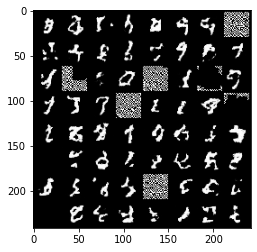

Epoch: [14/500]) Negative Log-Likelihood: -3579.016845703125
Epoch: [15/500]) Batch: [1/75] Negative Log-Likelihood: -3607.935546875


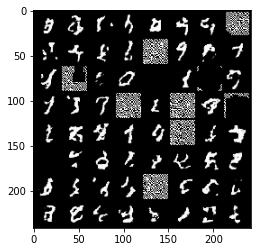

Epoch: [15/500]) Batch: [2/75] Negative Log-Likelihood: -3608.93701171875
Epoch: [15/500]) Batch: [3/75] Negative Log-Likelihood: -3612.771728515625
Epoch: [15/500]) Batch: [4/75] Negative Log-Likelihood: -3593.841796875
Epoch: [15/500]) Batch: [5/75] Negative Log-Likelihood: -3608.4736328125
Epoch: [15/500]) Batch: [6/75] Negative Log-Likelihood: -3606.921875
Epoch: [15/500]) Batch: [7/75] Negative Log-Likelihood: -3594.08935546875
Epoch: [15/500]) Batch: [8/75] Negative Log-Likelihood: -3605.626708984375
Epoch: [15/500]) Batch: [9/75] Negative Log-Likelihood: -3620.450439453125
Epoch: [15/500]) Batch: [10/75] Negative Log-Likelihood: -3615.334228515625
Epoch: [15/500]) Batch: [11/75] Negative Log-Likelihood: -3608.545654296875
Epoch: [15/500]) Batch: [12/75] Negative Log-Likelihood: -3613.363037109375
Epoch: [15/500]) Batch: [13/75] Negative Log-Likelihood: -3602.624267578125
Epoch: [15/500]) Batch: [14/75] Negative Log-Likelihood: -3609.97314453125
Epoch: [15/500]) Batch: [15/75] Ne

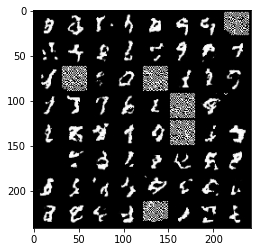

Epoch: [15/500]) Negative Log-Likelihood: -3581.14111328125
Epoch: [16/500]) Batch: [1/75] Negative Log-Likelihood: -3610.12548828125


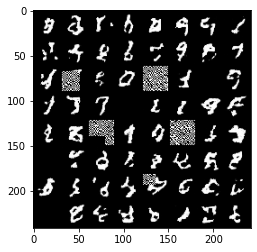

Epoch: [16/500]) Batch: [2/75] Negative Log-Likelihood: -3612.8037109375
Epoch: [16/500]) Batch: [3/75] Negative Log-Likelihood: -3614.455322265625
Epoch: [16/500]) Batch: [4/75] Negative Log-Likelihood: -3605.6025390625
Epoch: [16/500]) Batch: [5/75] Negative Log-Likelihood: -3613.68798828125
Epoch: [16/500]) Batch: [6/75] Negative Log-Likelihood: -3610.514892578125
Epoch: [16/500]) Batch: [7/75] Negative Log-Likelihood: -3595.3525390625
Epoch: [16/500]) Batch: [8/75] Negative Log-Likelihood: -3612.37109375
Epoch: [16/500]) Batch: [9/75] Negative Log-Likelihood: -3621.46826171875
Epoch: [16/500]) Batch: [10/75] Negative Log-Likelihood: -3614.34375
Epoch: [16/500]) Batch: [11/75] Negative Log-Likelihood: -3614.492431640625
Epoch: [16/500]) Batch: [12/75] Negative Log-Likelihood: -3608.1279296875
Epoch: [16/500]) Batch: [13/75] Negative Log-Likelihood: -3601.2919921875
Epoch: [16/500]) Batch: [14/75] Negative Log-Likelihood: -3598.859375
Epoch: [16/500]) Batch: [15/75] Negative Log-Like

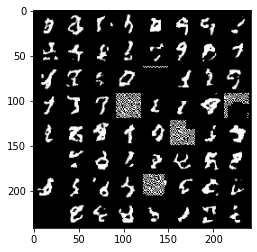

Epoch: [16/500]) Negative Log-Likelihood: -3581.747802734375
Epoch: [17/500]) Batch: [1/75] Negative Log-Likelihood: -3613.30517578125


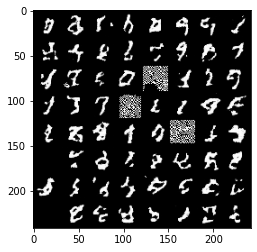

Epoch: [17/500]) Batch: [2/75] Negative Log-Likelihood: -3611.40283203125
Epoch: [17/500]) Batch: [3/75] Negative Log-Likelihood: -3621.33544921875
Epoch: [17/500]) Batch: [4/75] Negative Log-Likelihood: -3599.595947265625
Epoch: [17/500]) Batch: [5/75] Negative Log-Likelihood: -3615.75927734375
Epoch: [17/500]) Batch: [6/75] Negative Log-Likelihood: -3608.1650390625
Epoch: [17/500]) Batch: [7/75] Negative Log-Likelihood: -3597.97998046875
Epoch: [17/500]) Batch: [8/75] Negative Log-Likelihood: -3604.66796875
Epoch: [17/500]) Batch: [9/75] Negative Log-Likelihood: -3616.51171875
Epoch: [17/500]) Batch: [10/75] Negative Log-Likelihood: -3615.4736328125
Epoch: [17/500]) Batch: [11/75] Negative Log-Likelihood: -3604.282470703125
Epoch: [17/500]) Batch: [12/75] Negative Log-Likelihood: -3616.4560546875
Epoch: [17/500]) Batch: [13/75] Negative Log-Likelihood: -3600.1767578125
Epoch: [17/500]) Batch: [14/75] Negative Log-Likelihood: -3611.7099609375
Epoch: [17/500]) Batch: [15/75] Negative L

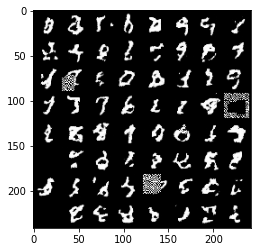

Epoch: [17/500]) Negative Log-Likelihood: -3591.0693359375
Epoch: [18/500]) Batch: [1/75] Negative Log-Likelihood: -3616.08837890625


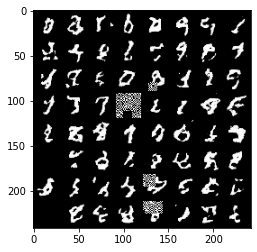

Epoch: [18/500]) Batch: [2/75] Negative Log-Likelihood: -3617.2236328125
Epoch: [18/500]) Batch: [3/75] Negative Log-Likelihood: -3617.74169921875
Epoch: [18/500]) Batch: [4/75] Negative Log-Likelihood: -3608.412353515625
Epoch: [18/500]) Batch: [5/75] Negative Log-Likelihood: -3612.32861328125
Epoch: [18/500]) Batch: [6/75] Negative Log-Likelihood: -3610.091796875
Epoch: [18/500]) Batch: [7/75] Negative Log-Likelihood: -3598.83251953125
Epoch: [18/500]) Batch: [8/75] Negative Log-Likelihood: -3601.236083984375
Epoch: [18/500]) Batch: [9/75] Negative Log-Likelihood: -3628.2412109375
Epoch: [18/500]) Batch: [10/75] Negative Log-Likelihood: -3607.73828125
Epoch: [18/500]) Batch: [11/75] Negative Log-Likelihood: -3598.77392578125
Epoch: [18/500]) Batch: [12/75] Negative Log-Likelihood: -3605.791259765625
Epoch: [18/500]) Batch: [13/75] Negative Log-Likelihood: -3601.15673828125
Epoch: [18/500]) Batch: [14/75] Negative Log-Likelihood: -3596.44775390625
Epoch: [18/500]) Batch: [15/75] Negat

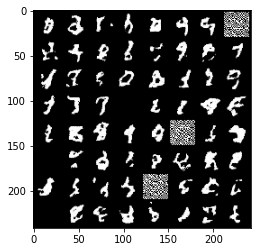

Epoch: [18/500]) Negative Log-Likelihood: -3570.8994140625
Epoch: [19/500]) Batch: [1/75] Negative Log-Likelihood: -3611.99658203125


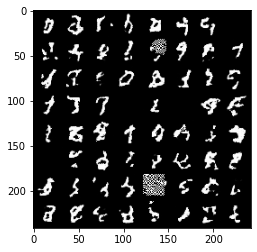

Epoch: [19/500]) Batch: [2/75] Negative Log-Likelihood: -3608.9931640625
Epoch: [19/500]) Batch: [3/75] Negative Log-Likelihood: -3610.69091796875
Epoch: [19/500]) Batch: [4/75] Negative Log-Likelihood: -3602.896240234375
Epoch: [19/500]) Batch: [5/75] Negative Log-Likelihood: -3606.669189453125
Epoch: [19/500]) Batch: [6/75] Negative Log-Likelihood: -3609.204345703125
Epoch: [19/500]) Batch: [7/75] Negative Log-Likelihood: -3599.21044921875
Epoch: [19/500]) Batch: [8/75] Negative Log-Likelihood: -3603.072509765625
Epoch: [19/500]) Batch: [9/75] Negative Log-Likelihood: -3622.017333984375
Epoch: [19/500]) Batch: [10/75] Negative Log-Likelihood: -3621.961181640625
Epoch: [19/500]) Batch: [11/75] Negative Log-Likelihood: -3609.6533203125
Epoch: [19/500]) Batch: [12/75] Negative Log-Likelihood: -3616.1435546875
Epoch: [19/500]) Batch: [13/75] Negative Log-Likelihood: -3614.739501953125
Epoch: [19/500]) Batch: [14/75] Negative Log-Likelihood: -3608.072509765625
Epoch: [19/500]) Batch: [15/

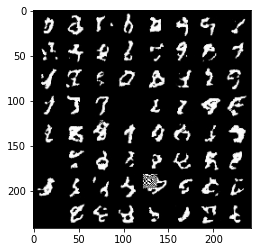

Epoch: [19/500]) Negative Log-Likelihood: -3588.429931640625
Epoch: [20/500]) Batch: [1/75] Negative Log-Likelihood: -3613.39111328125


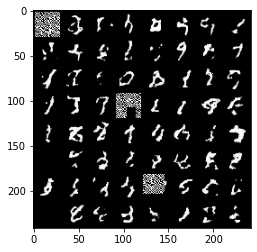

Epoch: [20/500]) Batch: [2/75] Negative Log-Likelihood: -3613.952392578125
Epoch: [20/500]) Batch: [3/75] Negative Log-Likelihood: -3623.353759765625
Epoch: [20/500]) Batch: [4/75] Negative Log-Likelihood: -3608.193359375
Epoch: [20/500]) Batch: [5/75] Negative Log-Likelihood: -3622.1220703125
Epoch: [20/500]) Batch: [6/75] Negative Log-Likelihood: -3620.282470703125
Epoch: [20/500]) Batch: [7/75] Negative Log-Likelihood: -3604.982421875
Epoch: [20/500]) Batch: [8/75] Negative Log-Likelihood: -3620.549072265625
Epoch: [20/500]) Batch: [9/75] Negative Log-Likelihood: -3630.42431640625
Epoch: [20/500]) Batch: [10/75] Negative Log-Likelihood: -3624.7119140625
Epoch: [20/500]) Batch: [11/75] Negative Log-Likelihood: -3617.8310546875
Epoch: [20/500]) Batch: [12/75] Negative Log-Likelihood: -3623.915283203125
Epoch: [20/500]) Batch: [13/75] Negative Log-Likelihood: -3610.02392578125
Epoch: [20/500]) Batch: [14/75] Negative Log-Likelihood: -3619.840576171875
Epoch: [20/500]) Batch: [15/75] Ne

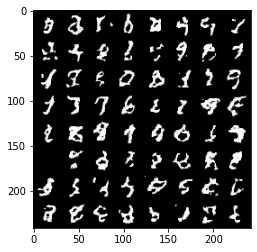

Epoch: [20/500]) Negative Log-Likelihood: -3591.681884765625
Epoch: [21/500]) Batch: [1/75] Negative Log-Likelihood: -3608.201904296875


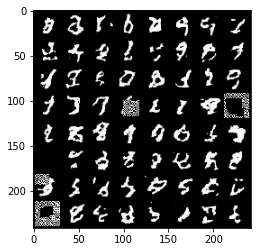

Epoch: [21/500]) Batch: [2/75] Negative Log-Likelihood: -3592.9931640625
Epoch: [21/500]) Batch: [3/75] Negative Log-Likelihood: -3618.503662109375
Epoch: [21/500]) Batch: [4/75] Negative Log-Likelihood: -3600.48876953125
Epoch: [21/500]) Batch: [5/75] Negative Log-Likelihood: -3611.08740234375
Epoch: [21/500]) Batch: [6/75] Negative Log-Likelihood: -3617.153076171875
Epoch: [21/500]) Batch: [7/75] Negative Log-Likelihood: -3601.42578125
Epoch: [21/500]) Batch: [8/75] Negative Log-Likelihood: -3619.012939453125
Epoch: [21/500]) Batch: [9/75] Negative Log-Likelihood: -3626.38232421875
Epoch: [21/500]) Batch: [10/75] Negative Log-Likelihood: -3626.6953125
Epoch: [21/500]) Batch: [11/75] Negative Log-Likelihood: -3620.349365234375
Epoch: [21/500]) Batch: [12/75] Negative Log-Likelihood: -3620.387939453125
Epoch: [21/500]) Batch: [13/75] Negative Log-Likelihood: -3615.02734375
Epoch: [21/500]) Batch: [14/75] Negative Log-Likelihood: -3622.38623046875
Epoch: [21/500]) Batch: [15/75] Negativ

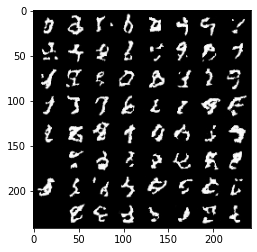

Epoch: [21/500]) Negative Log-Likelihood: -3590.920654296875
Epoch: [22/500]) Batch: [1/75] Negative Log-Likelihood: -3620.95263671875


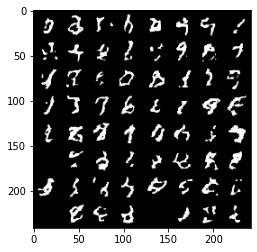

Epoch: [22/500]) Batch: [2/75] Negative Log-Likelihood: -3621.427001953125
Epoch: [22/500]) Batch: [3/75] Negative Log-Likelihood: -3629.842041015625
Epoch: [22/500]) Batch: [4/75] Negative Log-Likelihood: -3611.889404296875
Epoch: [22/500]) Batch: [5/75] Negative Log-Likelihood: -3626.2998046875
Epoch: [22/500]) Batch: [6/75] Negative Log-Likelihood: -3611.7216796875
Epoch: [22/500]) Batch: [7/75] Negative Log-Likelihood: -3596.4345703125
Epoch: [22/500]) Batch: [8/75] Negative Log-Likelihood: -3620.045166015625
Epoch: [22/500]) Batch: [9/75] Negative Log-Likelihood: -3628.20654296875
Epoch: [22/500]) Batch: [10/75] Negative Log-Likelihood: -3624.68310546875
Epoch: [22/500]) Batch: [11/75] Negative Log-Likelihood: -3615.80810546875
Epoch: [22/500]) Batch: [12/75] Negative Log-Likelihood: -3619.65625
Epoch: [22/500]) Batch: [13/75] Negative Log-Likelihood: -3621.16455078125
Epoch: [22/500]) Batch: [14/75] Negative Log-Likelihood: -3618.544677734375
Epoch: [22/500]) Batch: [15/75] Negat

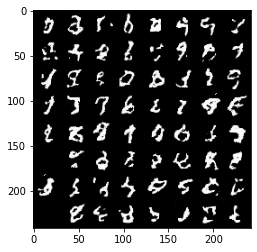

Epoch: [22/500]) Negative Log-Likelihood: -3591.3408203125
Epoch: [23/500]) Batch: [1/75] Negative Log-Likelihood: -3616.662841796875


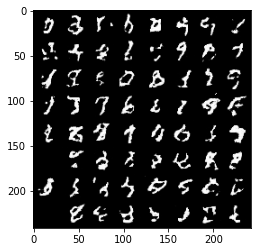

Epoch: [23/500]) Batch: [2/75] Negative Log-Likelihood: -3616.492431640625
Epoch: [23/500]) Batch: [3/75] Negative Log-Likelihood: -3629.404052734375
Epoch: [23/500]) Batch: [4/75] Negative Log-Likelihood: -3609.951416015625
Epoch: [23/500]) Batch: [5/75] Negative Log-Likelihood: -3622.548095703125
Epoch: [23/500]) Batch: [6/75] Negative Log-Likelihood: -3618.2177734375
Epoch: [23/500]) Batch: [7/75] Negative Log-Likelihood: -3603.974365234375
Epoch: [23/500]) Batch: [8/75] Negative Log-Likelihood: -3625.822509765625
Epoch: [23/500]) Batch: [9/75] Negative Log-Likelihood: -3631.846435546875
Epoch: [23/500]) Batch: [10/75] Negative Log-Likelihood: -3628.026123046875
Epoch: [23/500]) Batch: [11/75] Negative Log-Likelihood: -3627.06494140625
Epoch: [23/500]) Batch: [12/75] Negative Log-Likelihood: -3627.588134765625
Epoch: [23/500]) Batch: [13/75] Negative Log-Likelihood: -3619.79296875
Epoch: [23/500]) Batch: [14/75] Negative Log-Likelihood: -3632.89111328125
Epoch: [23/500]) Batch: [15/

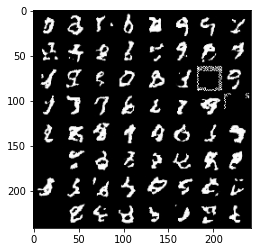

Epoch: [23/500]) Negative Log-Likelihood: -3603.0341796875
Epoch: [24/500]) Batch: [1/75] Negative Log-Likelihood: -3623.318603515625


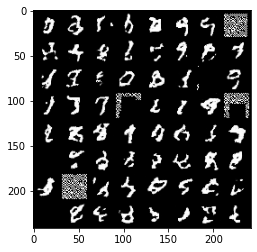

Epoch: [24/500]) Batch: [2/75] Negative Log-Likelihood: -3621.93017578125
Epoch: [24/500]) Batch: [3/75] Negative Log-Likelihood: -3635.22265625
Epoch: [24/500]) Batch: [4/75] Negative Log-Likelihood: -3615.177490234375
Epoch: [24/500]) Batch: [5/75] Negative Log-Likelihood: -3632.216796875
Epoch: [24/500]) Batch: [6/75] Negative Log-Likelihood: -3630.787353515625
Epoch: [24/500]) Batch: [7/75] Negative Log-Likelihood: -3617.176513671875
Epoch: [24/500]) Batch: [8/75] Negative Log-Likelihood: -3630.452392578125
Epoch: [24/500]) Batch: [9/75] Negative Log-Likelihood: -3642.5869140625
Epoch: [24/500]) Batch: [10/75] Negative Log-Likelihood: -3633.669189453125
Epoch: [24/500]) Batch: [11/75] Negative Log-Likelihood: -3630.043701171875
Epoch: [24/500]) Batch: [12/75] Negative Log-Likelihood: -3630.5185546875
Epoch: [24/500]) Batch: [13/75] Negative Log-Likelihood: -3630.98681640625
Epoch: [24/500]) Batch: [14/75] Negative Log-Likelihood: -3615.29931640625
Epoch: [24/500]) Batch: [15/75] Ne

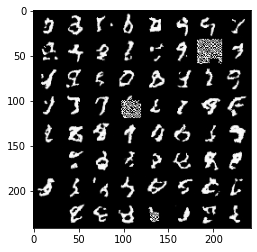

Epoch: [24/500]) Negative Log-Likelihood: -3598.45654296875
Epoch: [25/500]) Batch: [1/75] Negative Log-Likelihood: -3625.88232421875


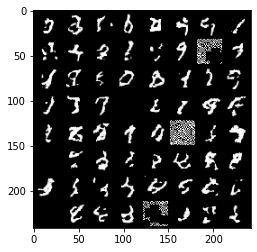

Epoch: [25/500]) Batch: [2/75] Negative Log-Likelihood: -3623.01123046875
Epoch: [25/500]) Batch: [3/75] Negative Log-Likelihood: -3631.419189453125
Epoch: [25/500]) Batch: [4/75] Negative Log-Likelihood: -3610.6025390625
Epoch: [25/500]) Batch: [5/75] Negative Log-Likelihood: -3611.983154296875
Epoch: [25/500]) Batch: [6/75] Negative Log-Likelihood: -3623.316162109375
Epoch: [25/500]) Batch: [7/75] Negative Log-Likelihood: -3612.81591796875
Epoch: [25/500]) Batch: [8/75] Negative Log-Likelihood: -3615.903076171875
Epoch: [25/500]) Batch: [9/75] Negative Log-Likelihood: -3635.536376953125
Epoch: [25/500]) Batch: [10/75] Negative Log-Likelihood: -3634.4287109375
Epoch: [25/500]) Batch: [11/75] Negative Log-Likelihood: -3622.678955078125
Epoch: [25/500]) Batch: [12/75] Negative Log-Likelihood: -3628.02490234375
Epoch: [25/500]) Batch: [13/75] Negative Log-Likelihood: -3622.1044921875
Epoch: [25/500]) Batch: [14/75] Negative Log-Likelihood: -3627.240966796875
Epoch: [25/500]) Batch: [15/7

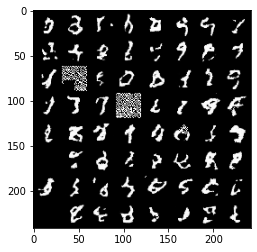

Epoch: [25/500]) Negative Log-Likelihood: -3602.380126953125
Epoch: [26/500]) Batch: [1/75] Negative Log-Likelihood: -3623.996826171875


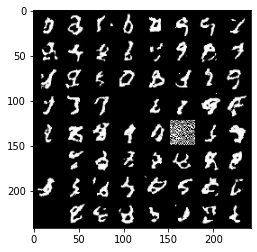

Epoch: [26/500]) Batch: [2/75] Negative Log-Likelihood: -3619.580322265625
Epoch: [26/500]) Batch: [3/75] Negative Log-Likelihood: -3632.63232421875
Epoch: [26/500]) Batch: [4/75] Negative Log-Likelihood: -3608.305908203125
Epoch: [26/500]) Batch: [5/75] Negative Log-Likelihood: -3628.09814453125
Epoch: [26/500]) Batch: [6/75] Negative Log-Likelihood: -3627.1103515625
Epoch: [26/500]) Batch: [7/75] Negative Log-Likelihood: -3614.872802734375
Epoch: [26/500]) Batch: [8/75] Negative Log-Likelihood: -3629.4072265625
Epoch: [26/500]) Batch: [9/75] Negative Log-Likelihood: -3646.380615234375
Epoch: [26/500]) Batch: [10/75] Negative Log-Likelihood: -3639.267822265625
Epoch: [26/500]) Batch: [11/75] Negative Log-Likelihood: -3628.939208984375
Epoch: [26/500]) Batch: [12/75] Negative Log-Likelihood: -3638.6689453125
Epoch: [26/500]) Batch: [13/75] Negative Log-Likelihood: -3622.892822265625
Epoch: [26/500]) Batch: [14/75] Negative Log-Likelihood: -3621.030029296875
Epoch: [26/500]) Batch: [15/

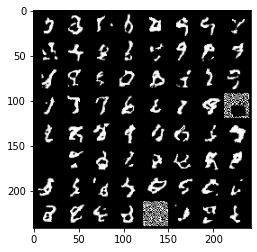

Epoch: [26/500]) Negative Log-Likelihood: -3603.442626953125
Epoch: [27/500]) Batch: [1/75] Negative Log-Likelihood: -3628.9150390625


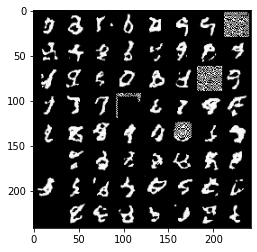

Epoch: [27/500]) Batch: [2/75] Negative Log-Likelihood: -3626.59423828125
Epoch: [27/500]) Batch: [3/75] Negative Log-Likelihood: -3633.659912109375
Epoch: [27/500]) Batch: [4/75] Negative Log-Likelihood: -3616.4697265625
Epoch: [27/500]) Batch: [5/75] Negative Log-Likelihood: -3623.247802734375
Epoch: [27/500]) Batch: [6/75] Negative Log-Likelihood: -3625.556396484375
Epoch: [27/500]) Batch: [7/75] Negative Log-Likelihood: -3617.0283203125
Epoch: [27/500]) Batch: [8/75] Negative Log-Likelihood: -3623.890869140625
Epoch: [27/500]) Batch: [9/75] Negative Log-Likelihood: -3639.32080078125
Epoch: [27/500]) Batch: [10/75] Negative Log-Likelihood: -3635.742431640625
Epoch: [27/500]) Batch: [11/75] Negative Log-Likelihood: -3629.907958984375
Epoch: [27/500]) Batch: [12/75] Negative Log-Likelihood: -3633.303466796875
Epoch: [27/500]) Batch: [13/75] Negative Log-Likelihood: -3617.267333984375
Epoch: [27/500]) Batch: [14/75] Negative Log-Likelihood: -3628.527099609375
Epoch: [27/500]) Batch: [1

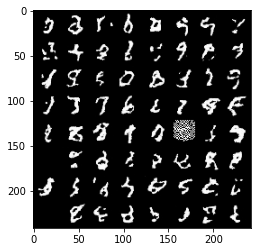

Epoch: [27/500]) Negative Log-Likelihood: -3592.6806640625
Epoch: [28/500]) Batch: [1/75] Negative Log-Likelihood: -3632.710205078125


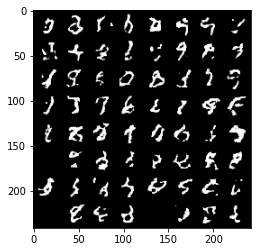

Epoch: [28/500]) Batch: [2/75] Negative Log-Likelihood: -3624.13427734375
Epoch: [28/500]) Batch: [3/75] Negative Log-Likelihood: -3630.0576171875
Epoch: [28/500]) Batch: [4/75] Negative Log-Likelihood: -3618.39404296875
Epoch: [28/500]) Batch: [5/75] Negative Log-Likelihood: -3618.4248046875
Epoch: [28/500]) Batch: [6/75] Negative Log-Likelihood: -3614.41064453125
Epoch: [28/500]) Batch: [7/75] Negative Log-Likelihood: -3610.078125
Epoch: [28/500]) Batch: [8/75] Negative Log-Likelihood: -3628.099609375
Epoch: [28/500]) Batch: [9/75] Negative Log-Likelihood: -3634.34375
Epoch: [28/500]) Batch: [10/75] Negative Log-Likelihood: -3631.40087890625
Epoch: [28/500]) Batch: [11/75] Negative Log-Likelihood: -3629.200439453125
Epoch: [28/500]) Batch: [12/75] Negative Log-Likelihood: -3625.12109375
Epoch: [28/500]) Batch: [13/75] Negative Log-Likelihood: -3614.93359375
Epoch: [28/500]) Batch: [14/75] Negative Log-Likelihood: -3628.72314453125
Epoch: [28/500]) Batch: [15/75] Negative Log-Likeliho

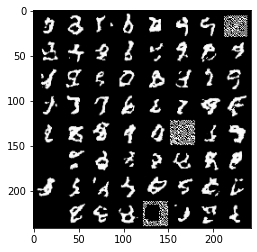

Epoch: [28/500]) Negative Log-Likelihood: -3612.15673828125
Epoch: [29/500]) Batch: [1/75] Negative Log-Likelihood: -3633.900634765625


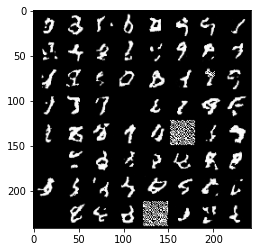

Epoch: [29/500]) Batch: [2/75] Negative Log-Likelihood: -3635.969970703125
Epoch: [29/500]) Batch: [3/75] Negative Log-Likelihood: -3639.1328125
Epoch: [29/500]) Batch: [4/75] Negative Log-Likelihood: -3626.49267578125
Epoch: [29/500]) Batch: [5/75] Negative Log-Likelihood: -3635.8818359375
Epoch: [29/500]) Batch: [6/75] Negative Log-Likelihood: -3635.388427734375
Epoch: [29/500]) Batch: [7/75] Negative Log-Likelihood: -3625.4423828125
Epoch: [29/500]) Batch: [8/75] Negative Log-Likelihood: -3640.334228515625
Epoch: [29/500]) Batch: [9/75] Negative Log-Likelihood: -3645.89501953125
Epoch: [29/500]) Batch: [10/75] Negative Log-Likelihood: -3638.01171875
Epoch: [29/500]) Batch: [11/75] Negative Log-Likelihood: -3634.96044921875
Epoch: [29/500]) Batch: [12/75] Negative Log-Likelihood: -3636.994873046875
Epoch: [29/500]) Batch: [13/75] Negative Log-Likelihood: -3634.631103515625
Epoch: [29/500]) Batch: [14/75] Negative Log-Likelihood: -3634.873046875
Epoch: [29/500]) Batch: [15/75] Negativ

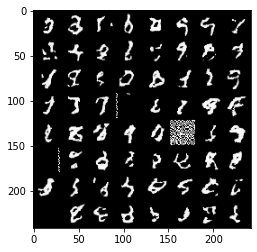

Epoch: [29/500]) Negative Log-Likelihood: -3607.9462890625
Epoch: [30/500]) Batch: [1/75] Negative Log-Likelihood: -3626.677490234375


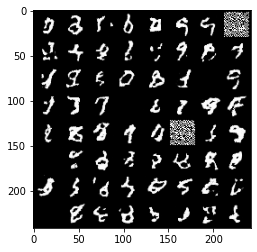

Epoch: [30/500]) Batch: [2/75] Negative Log-Likelihood: -3634.908935546875
Epoch: [30/500]) Batch: [3/75] Negative Log-Likelihood: -3636.54736328125
Epoch: [30/500]) Batch: [4/75] Negative Log-Likelihood: -3621.642333984375
Epoch: [30/500]) Batch: [5/75] Negative Log-Likelihood: -3633.41845703125
Epoch: [30/500]) Batch: [6/75] Negative Log-Likelihood: -3630.958251953125
Epoch: [30/500]) Batch: [7/75] Negative Log-Likelihood: -3623.956787109375
Epoch: [30/500]) Batch: [8/75] Negative Log-Likelihood: -3629.829345703125
Epoch: [30/500]) Batch: [9/75] Negative Log-Likelihood: -3637.822998046875
Epoch: [30/500]) Batch: [10/75] Negative Log-Likelihood: -3643.279296875
Epoch: [30/500]) Batch: [11/75] Negative Log-Likelihood: -3629.341064453125
Epoch: [30/500]) Batch: [12/75] Negative Log-Likelihood: -3629.14990234375
Epoch: [30/500]) Batch: [13/75] Negative Log-Likelihood: -3617.5712890625
Epoch: [30/500]) Batch: [14/75] Negative Log-Likelihood: -3626.06982421875
Epoch: [30/500]) Batch: [15/7

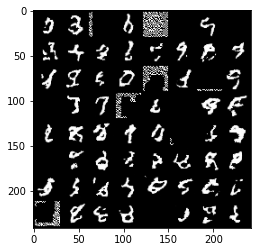

Epoch: [30/500]) Negative Log-Likelihood: -3609.71875
Epoch: [31/500]) Batch: [1/75] Negative Log-Likelihood: -3629.023681640625


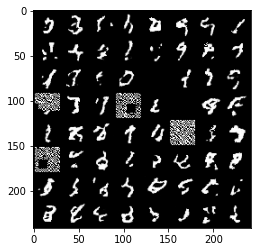

Epoch: [31/500]) Batch: [2/75] Negative Log-Likelihood: -3630.54296875
Epoch: [31/500]) Batch: [3/75] Negative Log-Likelihood: -3638.1162109375
Epoch: [31/500]) Batch: [4/75] Negative Log-Likelihood: -3615.615966796875
Epoch: [31/500]) Batch: [5/75] Negative Log-Likelihood: -3635.762939453125
Epoch: [31/500]) Batch: [6/75] Negative Log-Likelihood: -3632.990478515625
Epoch: [31/500]) Batch: [7/75] Negative Log-Likelihood: -3624.843017578125
Epoch: [31/500]) Batch: [8/75] Negative Log-Likelihood: -3637.624267578125
Epoch: [31/500]) Batch: [9/75] Negative Log-Likelihood: -3642.41748046875
Epoch: [31/500]) Batch: [10/75] Negative Log-Likelihood: -3633.733642578125
Epoch: [31/500]) Batch: [11/75] Negative Log-Likelihood: -3633.136474609375
Epoch: [31/500]) Batch: [12/75] Negative Log-Likelihood: -3630.677490234375
Epoch: [31/500]) Batch: [13/75] Negative Log-Likelihood: -3629.14794921875
Epoch: [31/500]) Batch: [14/75] Negative Log-Likelihood: -3635.381591796875
Epoch: [31/500]) Batch: [15/

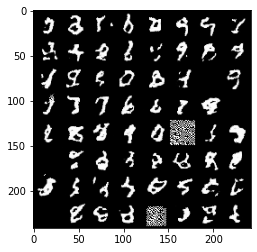

Epoch: [31/500]) Negative Log-Likelihood: -3614.1728515625
Epoch: [32/500]) Batch: [1/75] Negative Log-Likelihood: -3637.7783203125


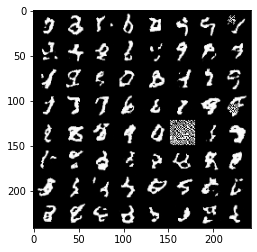

Epoch: [32/500]) Batch: [2/75] Negative Log-Likelihood: -3638.764892578125
Epoch: [32/500]) Batch: [3/75] Negative Log-Likelihood: -3642.6435546875
Epoch: [32/500]) Batch: [4/75] Negative Log-Likelihood: -3630.397705078125
Epoch: [32/500]) Batch: [5/75] Negative Log-Likelihood: -3636.80419921875
Epoch: [32/500]) Batch: [6/75] Negative Log-Likelihood: -3630.82861328125
Epoch: [32/500]) Batch: [7/75] Negative Log-Likelihood: -3626.609619140625
Epoch: [32/500]) Batch: [8/75] Negative Log-Likelihood: -3642.635009765625
Epoch: [32/500]) Batch: [9/75] Negative Log-Likelihood: -3641.320556640625
Epoch: [32/500]) Batch: [10/75] Negative Log-Likelihood: -3640.20556640625
Epoch: [32/500]) Batch: [11/75] Negative Log-Likelihood: -3622.759521484375
Epoch: [32/500]) Batch: [12/75] Negative Log-Likelihood: -3624.356201171875
Epoch: [32/500]) Batch: [13/75] Negative Log-Likelihood: -3614.2021484375
Epoch: [32/500]) Batch: [14/75] Negative Log-Likelihood: -3614.00927734375
Epoch: [32/500]) Batch: [15/

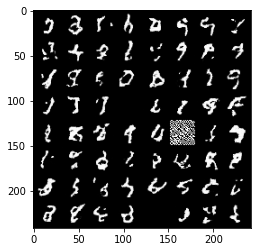

Epoch: [32/500]) Negative Log-Likelihood: -3609.7080078125
Epoch: [33/500]) Batch: [1/75] Negative Log-Likelihood: -3632.415283203125


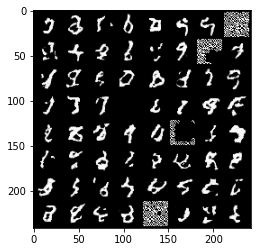

Epoch: [33/500]) Batch: [2/75] Negative Log-Likelihood: -3639.6962890625
Epoch: [33/500]) Batch: [3/75] Negative Log-Likelihood: -3639.4951171875
Epoch: [33/500]) Batch: [4/75] Negative Log-Likelihood: -3630.162353515625
Epoch: [33/500]) Batch: [5/75] Negative Log-Likelihood: -3634.923095703125
Epoch: [33/500]) Batch: [6/75] Negative Log-Likelihood: -3637.968994140625
Epoch: [33/500]) Batch: [7/75] Negative Log-Likelihood: -3635.407470703125
Epoch: [33/500]) Batch: [8/75] Negative Log-Likelihood: -3638.572509765625
Epoch: [33/500]) Batch: [9/75] Negative Log-Likelihood: -3654.044921875
Epoch: [33/500]) Batch: [10/75] Negative Log-Likelihood: -3649.389892578125
Epoch: [33/500]) Batch: [11/75] Negative Log-Likelihood: -3643.377685546875
Epoch: [33/500]) Batch: [12/75] Negative Log-Likelihood: -3642.982666015625
Epoch: [33/500]) Batch: [13/75] Negative Log-Likelihood: -3636.87109375
Epoch: [33/500]) Batch: [14/75] Negative Log-Likelihood: -3639.0234375
Epoch: [33/500]) Batch: [15/75] Nega

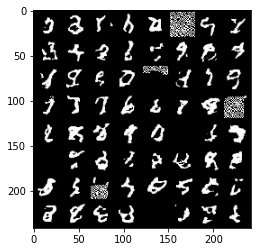

Epoch: [33/500]) Negative Log-Likelihood: -3597.373046875
Epoch: [34/500]) Batch: [1/75] Negative Log-Likelihood: -3631.2822265625


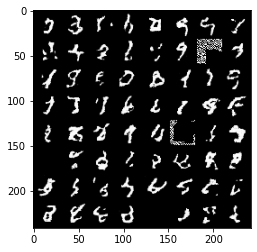

Epoch: [34/500]) Batch: [2/75] Negative Log-Likelihood: -3632.730224609375
Epoch: [34/500]) Batch: [3/75] Negative Log-Likelihood: -3637.272705078125
Epoch: [34/500]) Batch: [4/75] Negative Log-Likelihood: -3625.31201171875
Epoch: [34/500]) Batch: [5/75] Negative Log-Likelihood: -3640.304931640625
Epoch: [34/500]) Batch: [6/75] Negative Log-Likelihood: -3634.294921875
Epoch: [34/500]) Batch: [7/75] Negative Log-Likelihood: -3625.583740234375
Epoch: [34/500]) Batch: [8/75] Negative Log-Likelihood: -3641.614990234375
Epoch: [34/500]) Batch: [9/75] Negative Log-Likelihood: -3639.2578125
Epoch: [34/500]) Batch: [10/75] Negative Log-Likelihood: -3636.703125
Epoch: [34/500]) Batch: [11/75] Negative Log-Likelihood: -3640.44921875
Epoch: [34/500]) Batch: [12/75] Negative Log-Likelihood: -3631.13427734375
Epoch: [34/500]) Batch: [13/75] Negative Log-Likelihood: -3629.93359375
Epoch: [34/500]) Batch: [14/75] Negative Log-Likelihood: -3634.11865234375
Epoch: [34/500]) Batch: [15/75] Negative Log-

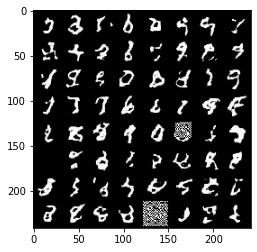

Epoch: [34/500]) Negative Log-Likelihood: -3621.81689453125
Epoch: [35/500]) Batch: [1/75] Negative Log-Likelihood: -3642.704345703125


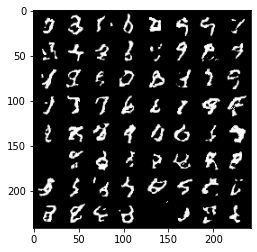

Epoch: [35/500]) Batch: [2/75] Negative Log-Likelihood: -3646.428466796875
Epoch: [35/500]) Batch: [3/75] Negative Log-Likelihood: -3652.40185546875
Epoch: [35/500]) Batch: [4/75] Negative Log-Likelihood: -3638.846435546875
Epoch: [35/500]) Batch: [5/75] Negative Log-Likelihood: -3647.33251953125
Epoch: [35/500]) Batch: [6/75] Negative Log-Likelihood: -3645.297119140625
Epoch: [35/500]) Batch: [7/75] Negative Log-Likelihood: -3636.118408203125
Epoch: [35/500]) Batch: [8/75] Negative Log-Likelihood: -3646.927978515625
Epoch: [35/500]) Batch: [9/75] Negative Log-Likelihood: -3658.52783203125
Epoch: [35/500]) Batch: [10/75] Negative Log-Likelihood: -3655.499267578125
Epoch: [35/500]) Batch: [11/75] Negative Log-Likelihood: -3644.9599609375
Epoch: [35/500]) Batch: [12/75] Negative Log-Likelihood: -3646.192626953125
Epoch: [35/500]) Batch: [13/75] Negative Log-Likelihood: -3632.365234375
Epoch: [35/500]) Batch: [14/75] Negative Log-Likelihood: -3629.78271484375
Epoch: [35/500]) Batch: [15/7

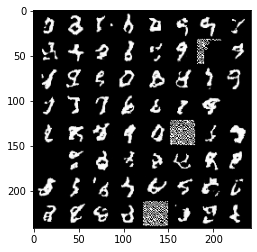

Epoch: [35/500]) Negative Log-Likelihood: -3614.36376953125
Epoch: [36/500]) Batch: [1/75] Negative Log-Likelihood: -3631.3525390625


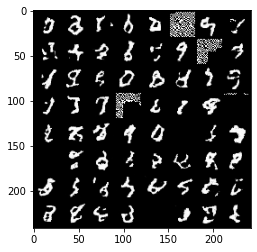

Epoch: [36/500]) Batch: [2/75] Negative Log-Likelihood: -3640.860595703125
Epoch: [36/500]) Batch: [3/75] Negative Log-Likelihood: -3643.34326171875
Epoch: [36/500]) Batch: [4/75] Negative Log-Likelihood: -3631.98681640625
Epoch: [36/500]) Batch: [5/75] Negative Log-Likelihood: -3640.8779296875
Epoch: [36/500]) Batch: [6/75] Negative Log-Likelihood: -3644.34716796875
Epoch: [36/500]) Batch: [7/75] Negative Log-Likelihood: -3623.6171875
Epoch: [36/500]) Batch: [8/75] Negative Log-Likelihood: -3631.01708984375
Epoch: [36/500]) Batch: [9/75] Negative Log-Likelihood: -3642.0791015625
Epoch: [36/500]) Batch: [10/75] Negative Log-Likelihood: -3631.342041015625
Epoch: [36/500]) Batch: [11/75] Negative Log-Likelihood: -3632.33056640625
Epoch: [36/500]) Batch: [12/75] Negative Log-Likelihood: -3640.17626953125
Epoch: [36/500]) Batch: [13/75] Negative Log-Likelihood: -3631.296142578125
Epoch: [36/500]) Batch: [14/75] Negative Log-Likelihood: -3639.47998046875
Epoch: [36/500]) Batch: [15/75] Nega

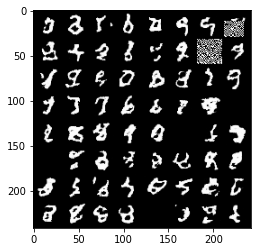

Epoch: [36/500]) Negative Log-Likelihood: -3619.269287109375
Epoch: [37/500]) Batch: [1/75] Negative Log-Likelihood: -3643.42529296875


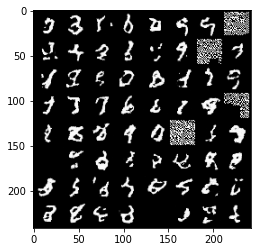

Epoch: [37/500]) Batch: [2/75] Negative Log-Likelihood: -3644.78125
Epoch: [37/500]) Batch: [3/75] Negative Log-Likelihood: -3651.1455078125
Epoch: [37/500]) Batch: [4/75] Negative Log-Likelihood: -3635.4091796875
Epoch: [37/500]) Batch: [5/75] Negative Log-Likelihood: -3647.2236328125
Epoch: [37/500]) Batch: [6/75] Negative Log-Likelihood: -3646.92529296875
Epoch: [37/500]) Batch: [7/75] Negative Log-Likelihood: -3631.9423828125
Epoch: [37/500]) Batch: [8/75] Negative Log-Likelihood: -3641.372314453125
Epoch: [37/500]) Batch: [9/75] Negative Log-Likelihood: -3656.111572265625
Epoch: [37/500]) Batch: [10/75] Negative Log-Likelihood: -3649.994873046875
Epoch: [37/500]) Batch: [11/75] Negative Log-Likelihood: -3644.87060546875
Epoch: [37/500]) Batch: [12/75] Negative Log-Likelihood: -3646.23388671875
Epoch: [37/500]) Batch: [13/75] Negative Log-Likelihood: -3641.244873046875
Epoch: [37/500]) Batch: [14/75] Negative Log-Likelihood: -3638.95458984375
Epoch: [37/500]) Batch: [15/75] Negativ

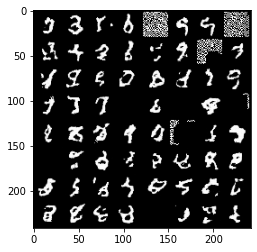

Epoch: [37/500]) Negative Log-Likelihood: -3620.273681640625
Epoch: [38/500]) Batch: [1/75] Negative Log-Likelihood: -3643.704833984375


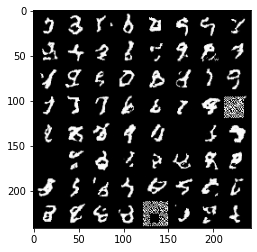

Epoch: [38/500]) Batch: [2/75] Negative Log-Likelihood: -3649.72607421875
Epoch: [38/500]) Batch: [3/75] Negative Log-Likelihood: -3642.4619140625
Epoch: [38/500]) Batch: [4/75] Negative Log-Likelihood: -3625.6787109375
Epoch: [38/500]) Batch: [5/75] Negative Log-Likelihood: -3631.595458984375
Epoch: [38/500]) Batch: [6/75] Negative Log-Likelihood: -3636.245849609375
Epoch: [38/500]) Batch: [7/75] Negative Log-Likelihood: -3633.045654296875
Epoch: [38/500]) Batch: [8/75] Negative Log-Likelihood: -3643.715576171875
Epoch: [38/500]) Batch: [9/75] Negative Log-Likelihood: -3656.5068359375
Epoch: [38/500]) Batch: [10/75] Negative Log-Likelihood: -3650.498046875
Epoch: [38/500]) Batch: [11/75] Negative Log-Likelihood: -3648.966552734375
Epoch: [38/500]) Batch: [12/75] Negative Log-Likelihood: -3641.7744140625
Epoch: [38/500]) Batch: [13/75] Negative Log-Likelihood: -3621.767333984375
Epoch: [38/500]) Batch: [14/75] Negative Log-Likelihood: -3645.375
Epoch: [38/500]) Batch: [15/75] Negative 

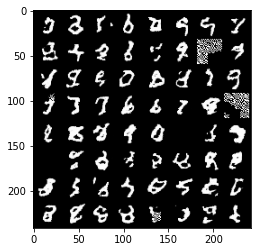

Epoch: [38/500]) Negative Log-Likelihood: -3622.46044921875
Epoch: [39/500]) Batch: [1/75] Negative Log-Likelihood: -3640.1162109375


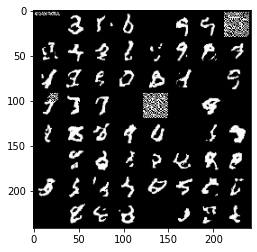

Epoch: [39/500]) Batch: [2/75] Negative Log-Likelihood: -3650.80712890625
Epoch: [39/500]) Batch: [3/75] Negative Log-Likelihood: -3641.2109375
Epoch: [39/500]) Batch: [4/75] Negative Log-Likelihood: -3622.3642578125
Epoch: [39/500]) Batch: [5/75] Negative Log-Likelihood: -3643.212646484375
Epoch: [39/500]) Batch: [6/75] Negative Log-Likelihood: -3636.887451171875
Epoch: [39/500]) Batch: [7/75] Negative Log-Likelihood: -3623.764892578125
Epoch: [39/500]) Batch: [8/75] Negative Log-Likelihood: -3643.038330078125
Epoch: [39/500]) Batch: [9/75] Negative Log-Likelihood: -3652.00732421875
Epoch: [39/500]) Batch: [10/75] Negative Log-Likelihood: -3652.489501953125
Epoch: [39/500]) Batch: [11/75] Negative Log-Likelihood: -3644.340576171875
Epoch: [39/500]) Batch: [12/75] Negative Log-Likelihood: -3647.739990234375
Epoch: [39/500]) Batch: [13/75] Negative Log-Likelihood: -3641.564208984375
Epoch: [39/500]) Batch: [14/75] Negative Log-Likelihood: -3650.439697265625
Epoch: [39/500]) Batch: [15/7

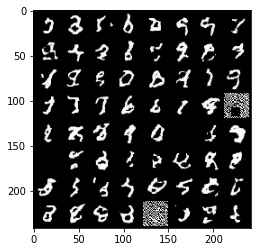

Epoch: [39/500]) Negative Log-Likelihood: -3623.06298828125
Epoch: [40/500]) Batch: [1/75] Negative Log-Likelihood: -3648.72607421875


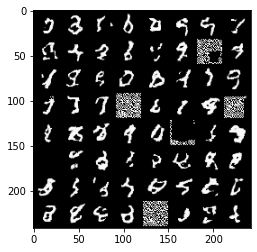

Epoch: [40/500]) Batch: [2/75] Negative Log-Likelihood: -3646.734375
Epoch: [40/500]) Batch: [3/75] Negative Log-Likelihood: -3651.931396484375
Epoch: [40/500]) Batch: [4/75] Negative Log-Likelihood: -3639.800537109375
Epoch: [40/500]) Batch: [5/75] Negative Log-Likelihood: -3650.772216796875
Epoch: [40/500]) Batch: [6/75] Negative Log-Likelihood: -3650.197509765625
Epoch: [40/500]) Batch: [7/75] Negative Log-Likelihood: -3643.3779296875
Epoch: [40/500]) Batch: [8/75] Negative Log-Likelihood: -3651.829833984375
Epoch: [40/500]) Batch: [9/75] Negative Log-Likelihood: -3665.75146484375
Epoch: [40/500]) Batch: [10/75] Negative Log-Likelihood: -3655.943359375
Epoch: [40/500]) Batch: [11/75] Negative Log-Likelihood: -3653.65673828125
Epoch: [40/500]) Batch: [12/75] Negative Log-Likelihood: -3645.712646484375
Epoch: [40/500]) Batch: [13/75] Negative Log-Likelihood: -3632.409912109375
Epoch: [40/500]) Batch: [14/75] Negative Log-Likelihood: -3650.52734375
Epoch: [40/500]) Batch: [15/75] Negat

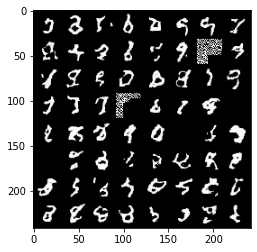

Epoch: [40/500]) Negative Log-Likelihood: -3625.178466796875
Epoch: [41/500]) Batch: [1/75] Negative Log-Likelihood: -3648.923095703125


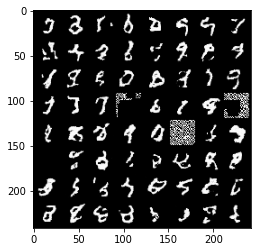

Epoch: [41/500]) Batch: [2/75] Negative Log-Likelihood: -3644.94677734375
Epoch: [41/500]) Batch: [3/75] Negative Log-Likelihood: -3659.070556640625
Epoch: [41/500]) Batch: [4/75] Negative Log-Likelihood: -3636.763671875
Epoch: [41/500]) Batch: [5/75] Negative Log-Likelihood: -3650.38427734375
Epoch: [41/500]) Batch: [6/75] Negative Log-Likelihood: -3650.401123046875
Epoch: [41/500]) Batch: [7/75] Negative Log-Likelihood: -3641.0986328125
Epoch: [41/500]) Batch: [8/75] Negative Log-Likelihood: -3649.26806640625
Epoch: [41/500]) Batch: [9/75] Negative Log-Likelihood: -3657.673095703125
Epoch: [41/500]) Batch: [10/75] Negative Log-Likelihood: -3660.556884765625
Epoch: [41/500]) Batch: [11/75] Negative Log-Likelihood: -3654.048583984375
Epoch: [41/500]) Batch: [12/75] Negative Log-Likelihood: -3650.66748046875
Epoch: [41/500]) Batch: [13/75] Negative Log-Likelihood: -3651.2568359375
Epoch: [41/500]) Batch: [14/75] Negative Log-Likelihood: -3650.72021484375
Epoch: [41/500]) Batch: [15/75] 

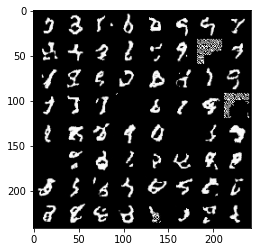

Epoch: [41/500]) Negative Log-Likelihood: -3618.359375
Epoch: [42/500]) Batch: [1/75] Negative Log-Likelihood: -3630.922119140625


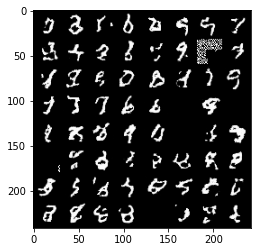

Epoch: [42/500]) Batch: [2/75] Negative Log-Likelihood: -3640.999267578125
Epoch: [42/500]) Batch: [3/75] Negative Log-Likelihood: -3650.078125
Epoch: [42/500]) Batch: [4/75] Negative Log-Likelihood: -3629.22314453125
Epoch: [42/500]) Batch: [5/75] Negative Log-Likelihood: -3645.71240234375
Epoch: [42/500]) Batch: [6/75] Negative Log-Likelihood: -3649.9619140625
Epoch: [42/500]) Batch: [7/75] Negative Log-Likelihood: -3636.014892578125
Epoch: [42/500]) Batch: [8/75] Negative Log-Likelihood: -3648.273681640625
Epoch: [42/500]) Batch: [9/75] Negative Log-Likelihood: -3665.38232421875
Epoch: [42/500]) Batch: [10/75] Negative Log-Likelihood: -3655.767333984375
Epoch: [42/500]) Batch: [11/75] Negative Log-Likelihood: -3646.6572265625
Epoch: [42/500]) Batch: [12/75] Negative Log-Likelihood: -3652.5244140625
Epoch: [42/500]) Batch: [13/75] Negative Log-Likelihood: -3642.17236328125
Epoch: [42/500]) Batch: [14/75] Negative Log-Likelihood: -3646.633056640625
Epoch: [42/500]) Batch: [15/75] Nega

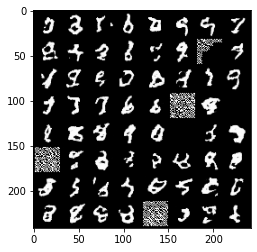

Epoch: [42/500]) Negative Log-Likelihood: -3634.744873046875
Epoch: [43/500]) Batch: [1/75] Negative Log-Likelihood: -3657.1162109375


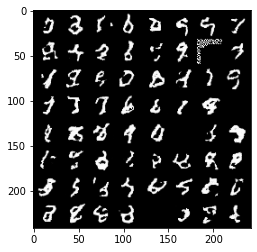

Epoch: [43/500]) Batch: [2/75] Negative Log-Likelihood: -3659.060546875
Epoch: [43/500]) Batch: [3/75] Negative Log-Likelihood: -3662.5439453125
Epoch: [43/500]) Batch: [4/75] Negative Log-Likelihood: -3649.262939453125
Epoch: [43/500]) Batch: [5/75] Negative Log-Likelihood: -3657.387939453125
Epoch: [43/500]) Batch: [6/75] Negative Log-Likelihood: -3657.15771484375
Epoch: [43/500]) Batch: [7/75] Negative Log-Likelihood: -3640.884521484375
Epoch: [43/500]) Batch: [8/75] Negative Log-Likelihood: -3650.96923828125
Epoch: [43/500]) Batch: [9/75] Negative Log-Likelihood: -3661.05859375
Epoch: [43/500]) Batch: [10/75] Negative Log-Likelihood: -3651.293701171875
Epoch: [43/500]) Batch: [11/75] Negative Log-Likelihood: -3656.404541015625
Epoch: [43/500]) Batch: [12/75] Negative Log-Likelihood: -3652.30712890625
Epoch: [43/500]) Batch: [13/75] Negative Log-Likelihood: -3647.21484375
Epoch: [43/500]) Batch: [14/75] Negative Log-Likelihood: -3652.711181640625
Epoch: [43/500]) Batch: [15/75] Nega

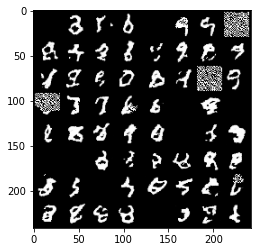

Epoch: [43/500]) Negative Log-Likelihood: -3625.021240234375
Epoch: [44/500]) Batch: [1/75] Negative Log-Likelihood: -3650.610595703125


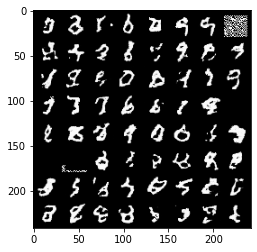

Epoch: [44/500]) Batch: [2/75] Negative Log-Likelihood: -3644.464599609375
Epoch: [44/500]) Batch: [3/75] Negative Log-Likelihood: -3649.0625
Epoch: [44/500]) Batch: [4/75] Negative Log-Likelihood: -3640.826904296875
Epoch: [44/500]) Batch: [5/75] Negative Log-Likelihood: -3646.18359375
Epoch: [44/500]) Batch: [6/75] Negative Log-Likelihood: -3642.818603515625
Epoch: [44/500]) Batch: [7/75] Negative Log-Likelihood: -3638.238037109375
Epoch: [44/500]) Batch: [8/75] Negative Log-Likelihood: -3645.4970703125
Epoch: [44/500]) Batch: [9/75] Negative Log-Likelihood: -3655.302001953125
Epoch: [44/500]) Batch: [10/75] Negative Log-Likelihood: -3655.484619140625
Epoch: [44/500]) Batch: [11/75] Negative Log-Likelihood: -3647.513671875
Epoch: [44/500]) Batch: [12/75] Negative Log-Likelihood: -3653.499267578125
Epoch: [44/500]) Batch: [13/75] Negative Log-Likelihood: -3640.43896484375
Epoch: [44/500]) Batch: [14/75] Negative Log-Likelihood: -3648.2216796875
Epoch: [44/500]) Batch: [15/75] Negative

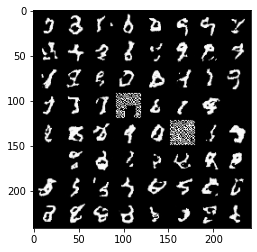

Epoch: [44/500]) Negative Log-Likelihood: -3621.992431640625
Epoch: [45/500]) Batch: [1/75] Negative Log-Likelihood: -3640.12548828125


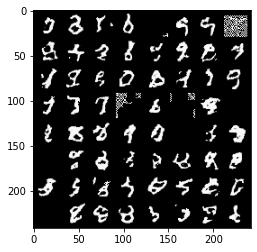

Epoch: [45/500]) Batch: [2/75] Negative Log-Likelihood: -3634.0087890625
Epoch: [45/500]) Batch: [3/75] Negative Log-Likelihood: -3648.11328125
Epoch: [45/500]) Batch: [4/75] Negative Log-Likelihood: -3642.086181640625
Epoch: [45/500]) Batch: [5/75] Negative Log-Likelihood: -3645.103759765625
Epoch: [45/500]) Batch: [6/75] Negative Log-Likelihood: -3646.138671875
Epoch: [45/500]) Batch: [7/75] Negative Log-Likelihood: -3638.697998046875
Epoch: [45/500]) Batch: [8/75] Negative Log-Likelihood: -3650.278076171875
Epoch: [45/500]) Batch: [9/75] Negative Log-Likelihood: -3665.0263671875
Epoch: [45/500]) Batch: [10/75] Negative Log-Likelihood: -3656.273681640625
Epoch: [45/500]) Batch: [11/75] Negative Log-Likelihood: -3653.8369140625
Epoch: [45/500]) Batch: [12/75] Negative Log-Likelihood: -3653.763671875
Epoch: [45/500]) Batch: [13/75] Negative Log-Likelihood: -3637.961181640625
Epoch: [45/500]) Batch: [14/75] Negative Log-Likelihood: -3651.953369140625
Epoch: [45/500]) Batch: [15/75] Nega

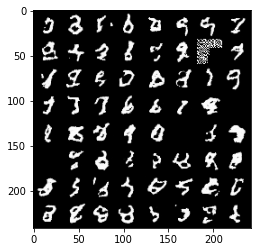

Epoch: [45/500]) Negative Log-Likelihood: -3626.3974609375
Epoch: [46/500]) Batch: [1/75] Negative Log-Likelihood: -3640.403076171875


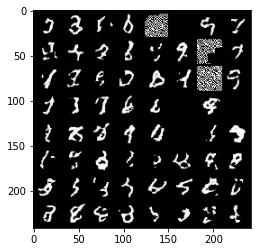

Epoch: [46/500]) Batch: [2/75] Negative Log-Likelihood: -3655.427978515625
Epoch: [46/500]) Batch: [3/75] Negative Log-Likelihood: -3652.03271484375
Epoch: [46/500]) Batch: [4/75] Negative Log-Likelihood: -3634.79931640625
Epoch: [46/500]) Batch: [5/75] Negative Log-Likelihood: -3655.5224609375
Epoch: [46/500]) Batch: [6/75] Negative Log-Likelihood: -3636.577392578125
Epoch: [46/500]) Batch: [7/75] Negative Log-Likelihood: -3607.51171875
Epoch: [46/500]) Batch: [8/75] Negative Log-Likelihood: -3628.155517578125
Epoch: [46/500]) Batch: [9/75] Negative Log-Likelihood: -3652.69140625
Epoch: [46/500]) Batch: [10/75] Negative Log-Likelihood: -3651.777099609375
Epoch: [46/500]) Batch: [11/75] Negative Log-Likelihood: -3641.411865234375
Epoch: [46/500]) Batch: [12/75] Negative Log-Likelihood: -3634.8505859375
Epoch: [46/500]) Batch: [13/75] Negative Log-Likelihood: -3636.950439453125
Epoch: [46/500]) Batch: [14/75] Negative Log-Likelihood: -3646.998779296875
Epoch: [46/500]) Batch: [15/75] Ne

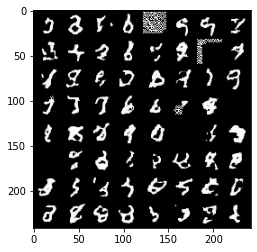

Epoch: [46/500]) Negative Log-Likelihood: -3633.650146484375
Epoch: [47/500]) Batch: [1/75] Negative Log-Likelihood: -3652.703369140625


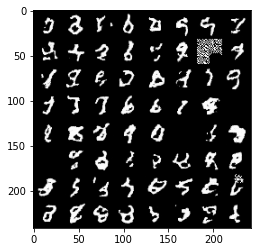

Epoch: [47/500]) Batch: [2/75] Negative Log-Likelihood: -3654.489013671875
Epoch: [47/500]) Batch: [3/75] Negative Log-Likelihood: -3658.916748046875
Epoch: [47/500]) Batch: [4/75] Negative Log-Likelihood: -3646.778076171875
Epoch: [47/500]) Batch: [5/75] Negative Log-Likelihood: -3646.932373046875
Epoch: [47/500]) Batch: [6/75] Negative Log-Likelihood: -3639.137939453125
Epoch: [47/500]) Batch: [7/75] Negative Log-Likelihood: -3642.306396484375
Epoch: [47/500]) Batch: [8/75] Negative Log-Likelihood: -3643.2431640625
Epoch: [47/500]) Batch: [9/75] Negative Log-Likelihood: -3661.513671875
Epoch: [47/500]) Batch: [10/75] Negative Log-Likelihood: -3660.59716796875
Epoch: [47/500]) Batch: [11/75] Negative Log-Likelihood: -3652.604248046875
Epoch: [47/500]) Batch: [12/75] Negative Log-Likelihood: -3656.539306640625
Epoch: [47/500]) Batch: [13/75] Negative Log-Likelihood: -3644.802978515625
Epoch: [47/500]) Batch: [14/75] Negative Log-Likelihood: -3640.15185546875
Epoch: [47/500]) Batch: [15

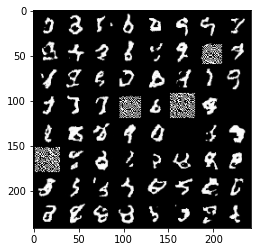

Epoch: [47/500]) Negative Log-Likelihood: -3636.106201171875
Epoch: [48/500]) Batch: [1/75] Negative Log-Likelihood: -3656.4736328125


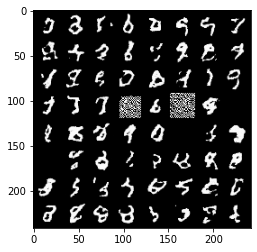

Epoch: [48/500]) Batch: [2/75] Negative Log-Likelihood: -3661.655517578125
Epoch: [48/500]) Batch: [3/75] Negative Log-Likelihood: -3658.349365234375
Epoch: [48/500]) Batch: [4/75] Negative Log-Likelihood: -3643.7119140625
Epoch: [48/500]) Batch: [5/75] Negative Log-Likelihood: -3653.048095703125
Epoch: [48/500]) Batch: [6/75] Negative Log-Likelihood: -3649.90185546875
Epoch: [48/500]) Batch: [7/75] Negative Log-Likelihood: -3642.16064453125
Epoch: [48/500]) Batch: [8/75] Negative Log-Likelihood: -3651.59521484375
Epoch: [48/500]) Batch: [9/75] Negative Log-Likelihood: -3662.382080078125
Epoch: [48/500]) Batch: [10/75] Negative Log-Likelihood: -3659.6904296875
Epoch: [48/500]) Batch: [11/75] Negative Log-Likelihood: -3655.2265625
Epoch: [48/500]) Batch: [12/75] Negative Log-Likelihood: -3658.68994140625
Epoch: [48/500]) Batch: [13/75] Negative Log-Likelihood: -3654.256103515625
Epoch: [48/500]) Batch: [14/75] Negative Log-Likelihood: -3654.897705078125
Epoch: [48/500]) Batch: [15/75] N

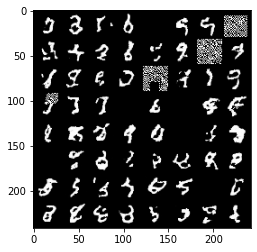

Epoch: [48/500]) Negative Log-Likelihood: -3626.3779296875
Epoch: [49/500]) Batch: [1/75] Negative Log-Likelihood: -3652.86181640625


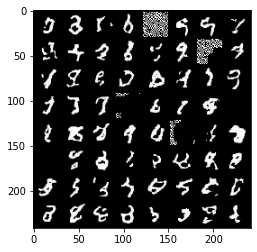

Epoch: [49/500]) Batch: [2/75] Negative Log-Likelihood: -3653.46484375
Epoch: [49/500]) Batch: [3/75] Negative Log-Likelihood: -3654.530029296875
Epoch: [49/500]) Batch: [4/75] Negative Log-Likelihood: -3644.005859375
Epoch: [49/500]) Batch: [5/75] Negative Log-Likelihood: -3656.388671875
Epoch: [49/500]) Batch: [6/75] Negative Log-Likelihood: -3643.752685546875
Epoch: [49/500]) Batch: [7/75] Negative Log-Likelihood: -3643.758056640625
Epoch: [49/500]) Batch: [8/75] Negative Log-Likelihood: -3648.3271484375
Epoch: [49/500]) Batch: [9/75] Negative Log-Likelihood: -3646.962646484375
Epoch: [49/500]) Batch: [10/75] Negative Log-Likelihood: -3655.068115234375
Epoch: [49/500]) Batch: [11/75] Negative Log-Likelihood: -3650.64111328125
Epoch: [49/500]) Batch: [12/75] Negative Log-Likelihood: -3644.014892578125
Epoch: [49/500]) Batch: [13/75] Negative Log-Likelihood: -3635.711181640625
Epoch: [49/500]) Batch: [14/75] Negative Log-Likelihood: -3645.42919921875
Epoch: [49/500]) Batch: [15/75] Ne

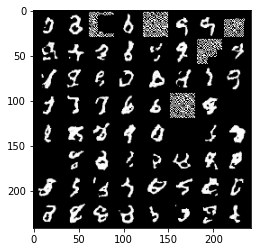

Epoch: [49/500]) Negative Log-Likelihood: -3623.330322265625
Epoch: [50/500]) Batch: [1/75] Negative Log-Likelihood: -3643.552978515625


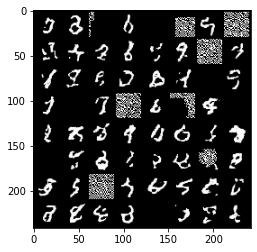

Epoch: [50/500]) Batch: [2/75] Negative Log-Likelihood: -3641.70556640625
Epoch: [50/500]) Batch: [3/75] Negative Log-Likelihood: -3651.86181640625
Epoch: [50/500]) Batch: [4/75] Negative Log-Likelihood: -3642.84814453125
Epoch: [50/500]) Batch: [5/75] Negative Log-Likelihood: -3652.33740234375
Epoch: [50/500]) Batch: [6/75] Negative Log-Likelihood: -3652.962158203125
Epoch: [50/500]) Batch: [7/75] Negative Log-Likelihood: -3640.92626953125
Epoch: [50/500]) Batch: [8/75] Negative Log-Likelihood: -3650.16748046875
Epoch: [50/500]) Batch: [9/75] Negative Log-Likelihood: -3665.65576171875
Epoch: [50/500]) Batch: [10/75] Negative Log-Likelihood: -3661.127197265625
Epoch: [50/500]) Batch: [11/75] Negative Log-Likelihood: -3656.6435546875
Epoch: [50/500]) Batch: [12/75] Negative Log-Likelihood: -3650.67236328125
Epoch: [50/500]) Batch: [13/75] Negative Log-Likelihood: -3648.8125
Epoch: [50/500]) Batch: [14/75] Negative Log-Likelihood: -3652.866455078125
Epoch: [50/500]) Batch: [15/75] Negati

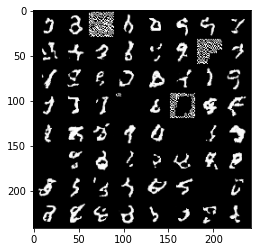

Epoch: [50/500]) Negative Log-Likelihood: -3617.19775390625
Epoch: [51/500]) Batch: [1/75] Negative Log-Likelihood: -3649.97021484375


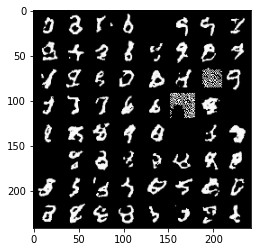

Epoch: [51/500]) Batch: [2/75] Negative Log-Likelihood: -3639.099365234375
Epoch: [51/500]) Batch: [3/75] Negative Log-Likelihood: -3636.85302734375
Epoch: [51/500]) Batch: [4/75] Negative Log-Likelihood: -3630.200439453125
Epoch: [51/500]) Batch: [5/75] Negative Log-Likelihood: -3648.8876953125
Epoch: [51/500]) Batch: [6/75] Negative Log-Likelihood: -3647.724365234375
Epoch: [51/500]) Batch: [7/75] Negative Log-Likelihood: -3640.969970703125
Epoch: [51/500]) Batch: [8/75] Negative Log-Likelihood: -3647.77685546875
Epoch: [51/500]) Batch: [9/75] Negative Log-Likelihood: -3665.283935546875
Epoch: [51/500]) Batch: [10/75] Negative Log-Likelihood: -3663.150634765625
Epoch: [51/500]) Batch: [11/75] Negative Log-Likelihood: -3657.844970703125
Epoch: [51/500]) Batch: [12/75] Negative Log-Likelihood: -3658.23876953125
Epoch: [51/500]) Batch: [13/75] Negative Log-Likelihood: -3656.87451171875
Epoch: [51/500]) Batch: [14/75] Negative Log-Likelihood: -3654.888671875
Epoch: [51/500]) Batch: [15/7

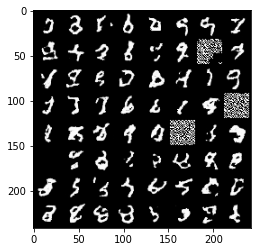

Epoch: [51/500]) Negative Log-Likelihood: -3624.547119140625
Epoch: [52/500]) Batch: [1/75] Negative Log-Likelihood: -3641.155029296875


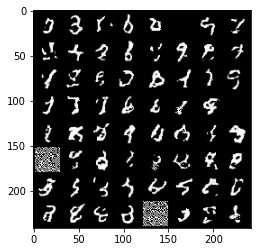

Epoch: [52/500]) Batch: [2/75] Negative Log-Likelihood: -3651.068603515625
Epoch: [52/500]) Batch: [3/75] Negative Log-Likelihood: -3657.52490234375
Epoch: [52/500]) Batch: [4/75] Negative Log-Likelihood: -3646.19482421875
Epoch: [52/500]) Batch: [5/75] Negative Log-Likelihood: -3657.8935546875
Epoch: [52/500]) Batch: [6/75] Negative Log-Likelihood: -3653.97314453125
Epoch: [52/500]) Batch: [7/75] Negative Log-Likelihood: -3649.329345703125
Epoch: [52/500]) Batch: [8/75] Negative Log-Likelihood: -3658.026123046875
Epoch: [52/500]) Batch: [9/75] Negative Log-Likelihood: -3668.15869140625
Epoch: [52/500]) Batch: [10/75] Negative Log-Likelihood: -3659.701904296875
Epoch: [52/500]) Batch: [11/75] Negative Log-Likelihood: -3650.625
Epoch: [52/500]) Batch: [12/75] Negative Log-Likelihood: -3658.849365234375
Epoch: [52/500]) Batch: [13/75] Negative Log-Likelihood: -3649.111083984375
Epoch: [52/500]) Batch: [14/75] Negative Log-Likelihood: -3656.249267578125
Epoch: [52/500]) Batch: [15/75] Neg

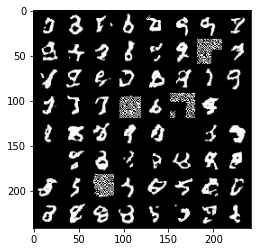

Epoch: [52/500]) Negative Log-Likelihood: -3635.81298828125
Epoch: [53/500]) Batch: [1/75] Negative Log-Likelihood: -3660.4287109375


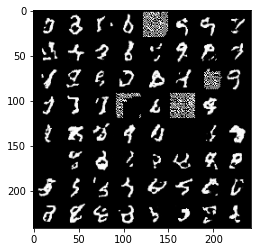

Epoch: [53/500]) Batch: [2/75] Negative Log-Likelihood: -3656.414306640625
Epoch: [53/500]) Batch: [3/75] Negative Log-Likelihood: -3669.35302734375
Epoch: [53/500]) Batch: [4/75] Negative Log-Likelihood: -3648.6103515625
Epoch: [53/500]) Batch: [5/75] Negative Log-Likelihood: -3661.39990234375
Epoch: [53/500]) Batch: [6/75] Negative Log-Likelihood: -3653.2509765625
Epoch: [53/500]) Batch: [7/75] Negative Log-Likelihood: -3631.067138671875
Epoch: [53/500]) Batch: [8/75] Negative Log-Likelihood: -3652.957763671875
Epoch: [53/500]) Batch: [9/75] Negative Log-Likelihood: -3669.35400390625
Epoch: [53/500]) Batch: [10/75] Negative Log-Likelihood: -3662.963134765625
Epoch: [53/500]) Batch: [11/75] Negative Log-Likelihood: -3656.1953125
Epoch: [53/500]) Batch: [12/75] Negative Log-Likelihood: -3661.0712890625
Epoch: [53/500]) Batch: [13/75] Negative Log-Likelihood: -3654.4169921875
Epoch: [53/500]) Batch: [14/75] Negative Log-Likelihood: -3660.5927734375
Epoch: [53/500]) Batch: [15/75] Negati

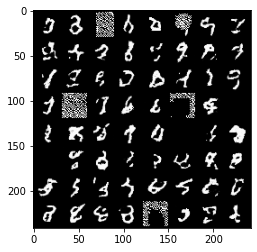

Epoch: [53/500]) Negative Log-Likelihood: -3636.636474609375
Epoch: [54/500]) Batch: [1/75] Negative Log-Likelihood: -3655.93408203125


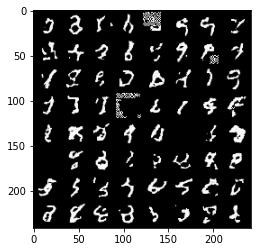

Epoch: [54/500]) Batch: [2/75] Negative Log-Likelihood: -3657.6875
Epoch: [54/500]) Batch: [3/75] Negative Log-Likelihood: -3659.26025390625
Epoch: [54/500]) Batch: [4/75] Negative Log-Likelihood: -3648.3505859375
Epoch: [54/500]) Batch: [5/75] Negative Log-Likelihood: -3659.626708984375
Epoch: [54/500]) Batch: [6/75] Negative Log-Likelihood: -3656.76220703125
Epoch: [54/500]) Batch: [7/75] Negative Log-Likelihood: -3647.138671875
Epoch: [54/500]) Batch: [8/75] Negative Log-Likelihood: -3644.31982421875
Epoch: [54/500]) Batch: [9/75] Negative Log-Likelihood: -3653.31689453125
Epoch: [54/500]) Batch: [10/75] Negative Log-Likelihood: -3654.738037109375
Epoch: [54/500]) Batch: [11/75] Negative Log-Likelihood: -3653.644287109375
Epoch: [54/500]) Batch: [12/75] Negative Log-Likelihood: -3651.091796875
Epoch: [54/500]) Batch: [13/75] Negative Log-Likelihood: -3633.921142578125
Epoch: [54/500]) Batch: [14/75] Negative Log-Likelihood: -3650.3349609375
Epoch: [54/500]) Batch: [15/75] Negative L

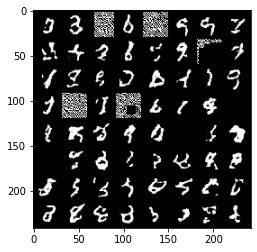

Epoch: [54/500]) Negative Log-Likelihood: -3608.742431640625
Epoch: [55/500]) Batch: [1/75] Negative Log-Likelihood: -3645.38671875


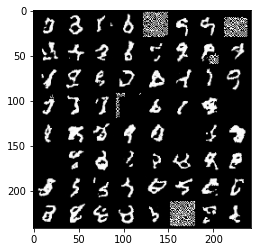

Epoch: [55/500]) Batch: [2/75] Negative Log-Likelihood: -3651.597412109375
Epoch: [55/500]) Batch: [3/75] Negative Log-Likelihood: -3655.279052734375
Epoch: [55/500]) Batch: [4/75] Negative Log-Likelihood: -3642.516845703125
Epoch: [55/500]) Batch: [5/75] Negative Log-Likelihood: -3648.804931640625
Epoch: [55/500]) Batch: [6/75] Negative Log-Likelihood: -3648.047119140625
Epoch: [55/500]) Batch: [7/75] Negative Log-Likelihood: -3643.28369140625
Epoch: [55/500]) Batch: [8/75] Negative Log-Likelihood: -3661.525634765625
Epoch: [55/500]) Batch: [9/75] Negative Log-Likelihood: -3668.831787109375
Epoch: [55/500]) Batch: [10/75] Negative Log-Likelihood: -3660.375
Epoch: [55/500]) Batch: [11/75] Negative Log-Likelihood: -3657.005859375
Epoch: [55/500]) Batch: [12/75] Negative Log-Likelihood: -3664.876708984375
Epoch: [55/500]) Batch: [13/75] Negative Log-Likelihood: -3655.015625
Epoch: [55/500]) Batch: [14/75] Negative Log-Likelihood: -3658.584228515625
Epoch: [55/500]) Batch: [15/75] Negativ

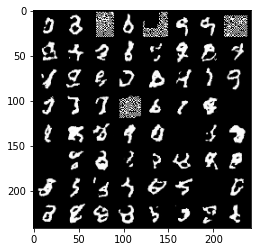

Epoch: [55/500]) Negative Log-Likelihood: -3641.09521484375
Epoch: [56/500]) Batch: [1/75] Negative Log-Likelihood: -3659.41064453125


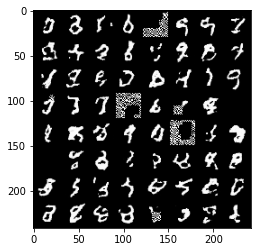

Epoch: [56/500]) Batch: [2/75] Negative Log-Likelihood: -3665.218017578125
Epoch: [56/500]) Batch: [3/75] Negative Log-Likelihood: -3673.310546875
Epoch: [56/500]) Batch: [4/75] Negative Log-Likelihood: -3651.608154296875
Epoch: [56/500]) Batch: [5/75] Negative Log-Likelihood: -3665.486083984375
Epoch: [56/500]) Batch: [6/75] Negative Log-Likelihood: -3663.444580078125
Epoch: [56/500]) Batch: [7/75] Negative Log-Likelihood: -3655.1298828125
Epoch: [56/500]) Batch: [8/75] Negative Log-Likelihood: -3663.133056640625
Epoch: [56/500]) Batch: [9/75] Negative Log-Likelihood: -3678.43359375
Epoch: [56/500]) Batch: [10/75] Negative Log-Likelihood: -3662.912353515625
Epoch: [56/500]) Batch: [11/75] Negative Log-Likelihood: -3656.0234375
Epoch: [56/500]) Batch: [12/75] Negative Log-Likelihood: -3657.33740234375
Epoch: [56/500]) Batch: [13/75] Negative Log-Likelihood: -3653.428466796875
Epoch: [56/500]) Batch: [14/75] Negative Log-Likelihood: -3661.386474609375
Epoch: [56/500]) Batch: [15/75] Neg

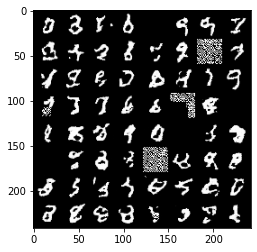

Epoch: [56/500]) Negative Log-Likelihood: -3628.65625
Epoch: [57/500]) Batch: [1/75] Negative Log-Likelihood: -3649.62744140625


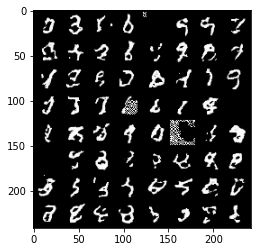

Epoch: [57/500]) Batch: [2/75] Negative Log-Likelihood: -3653.729248046875
Epoch: [57/500]) Batch: [3/75] Negative Log-Likelihood: -3661.4150390625
Epoch: [57/500]) Batch: [4/75] Negative Log-Likelihood: -3650.583740234375
Epoch: [57/500]) Batch: [5/75] Negative Log-Likelihood: -3666.71240234375
Epoch: [57/500]) Batch: [6/75] Negative Log-Likelihood: -3660.303955078125
Epoch: [57/500]) Batch: [7/75] Negative Log-Likelihood: -3651.30615234375
Epoch: [57/500]) Batch: [8/75] Negative Log-Likelihood: -3657.24365234375
Epoch: [57/500]) Batch: [9/75] Negative Log-Likelihood: -3659.639404296875
Epoch: [57/500]) Batch: [10/75] Negative Log-Likelihood: -3654.686767578125
Epoch: [57/500]) Batch: [11/75] Negative Log-Likelihood: -3652.4423828125
Epoch: [57/500]) Batch: [12/75] Negative Log-Likelihood: -3661.942626953125
Epoch: [57/500]) Batch: [13/75] Negative Log-Likelihood: -3649.066162109375
Epoch: [57/500]) Batch: [14/75] Negative Log-Likelihood: -3660.506591796875
Epoch: [57/500]) Batch: [15

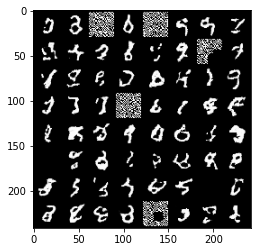

Epoch: [57/500]) Negative Log-Likelihood: -3634.418701171875
Epoch: [58/500]) Batch: [1/75] Negative Log-Likelihood: -3657.78125


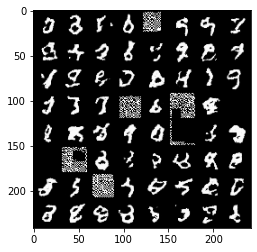

Epoch: [58/500]) Batch: [2/75] Negative Log-Likelihood: -3657.510009765625
Epoch: [58/500]) Batch: [3/75] Negative Log-Likelihood: -3664.379638671875
Epoch: [58/500]) Batch: [4/75] Negative Log-Likelihood: -3645.66064453125
Epoch: [58/500]) Batch: [5/75] Negative Log-Likelihood: -3661.8662109375
Epoch: [58/500]) Batch: [6/75] Negative Log-Likelihood: -3657.468017578125
Epoch: [58/500]) Batch: [7/75] Negative Log-Likelihood: -3649.916748046875
Epoch: [58/500]) Batch: [8/75] Negative Log-Likelihood: -3663.732177734375
Epoch: [58/500]) Batch: [9/75] Negative Log-Likelihood: -3668.590576171875
Epoch: [58/500]) Batch: [10/75] Negative Log-Likelihood: -3653.664306640625
Epoch: [58/500]) Batch: [11/75] Negative Log-Likelihood: -3662.75244140625
Epoch: [58/500]) Batch: [12/75] Negative Log-Likelihood: -3657.921142578125
Epoch: [58/500]) Batch: [13/75] Negative Log-Likelihood: -3658.310546875
Epoch: [58/500]) Batch: [14/75] Negative Log-Likelihood: -3653.814208984375
Epoch: [58/500]) Batch: [15

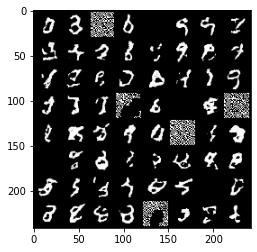

Epoch: [58/500]) Negative Log-Likelihood: -3626.044189453125
Epoch: [59/500]) Batch: [1/75] Negative Log-Likelihood: -3657.815185546875


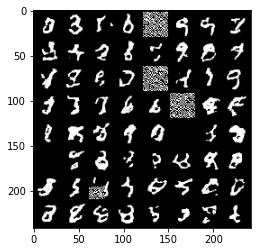

Epoch: [59/500]) Batch: [2/75] Negative Log-Likelihood: -3654.0029296875
Epoch: [59/500]) Batch: [3/75] Negative Log-Likelihood: -3663.701904296875
Epoch: [59/500]) Batch: [4/75] Negative Log-Likelihood: -3648.338623046875
Epoch: [59/500]) Batch: [5/75] Negative Log-Likelihood: -3654.673583984375
Epoch: [59/500]) Batch: [6/75] Negative Log-Likelihood: -3644.890625
Epoch: [59/500]) Batch: [7/75] Negative Log-Likelihood: -3644.1123046875
Epoch: [59/500]) Batch: [8/75] Negative Log-Likelihood: -3651.65576171875
Epoch: [59/500]) Batch: [9/75] Negative Log-Likelihood: -3663.91064453125
Epoch: [59/500]) Batch: [10/75] Negative Log-Likelihood: -3661.517333984375
Epoch: [59/500]) Batch: [11/75] Negative Log-Likelihood: -3661.267333984375
Epoch: [59/500]) Batch: [12/75] Negative Log-Likelihood: -3665.9404296875
Epoch: [59/500]) Batch: [13/75] Negative Log-Likelihood: -3656.5849609375
Epoch: [59/500]) Batch: [14/75] Negative Log-Likelihood: -3661.879638671875
Epoch: [59/500]) Batch: [15/75] Nega

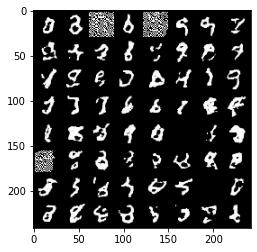

Epoch: [59/500]) Negative Log-Likelihood: -3644.26611328125
Epoch: [60/500]) Batch: [1/75] Negative Log-Likelihood: -3667.88720703125


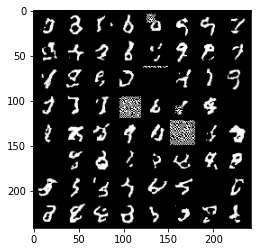

Epoch: [60/500]) Batch: [2/75] Negative Log-Likelihood: -3663.092529296875
Epoch: [60/500]) Batch: [3/75] Negative Log-Likelihood: -3665.94482421875
Epoch: [60/500]) Batch: [4/75] Negative Log-Likelihood: -3653.825439453125
Epoch: [60/500]) Batch: [5/75] Negative Log-Likelihood: -3664.474853515625
Epoch: [60/500]) Batch: [6/75] Negative Log-Likelihood: -3662.747314453125
Epoch: [60/500]) Batch: [7/75] Negative Log-Likelihood: -3654.61669921875
Epoch: [60/500]) Batch: [8/75] Negative Log-Likelihood: -3665.034912109375
Epoch: [60/500]) Batch: [9/75] Negative Log-Likelihood: -3676.669921875
Epoch: [60/500]) Batch: [10/75] Negative Log-Likelihood: -3672.5859375
Epoch: [60/500]) Batch: [11/75] Negative Log-Likelihood: -3667.93994140625
Epoch: [60/500]) Batch: [12/75] Negative Log-Likelihood: -3663.72998046875
Epoch: [60/500]) Batch: [13/75] Negative Log-Likelihood: -3657.45263671875
Epoch: [60/500]) Batch: [14/75] Negative Log-Likelihood: -3653.48486328125
Epoch: [60/500]) Batch: [15/75] Ne

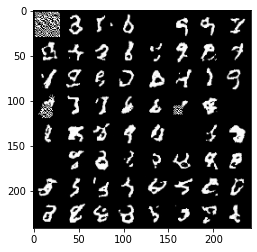

Epoch: [60/500]) Negative Log-Likelihood: -3627.595458984375
Epoch: [61/500]) Batch: [1/75] Negative Log-Likelihood: -3658.5029296875


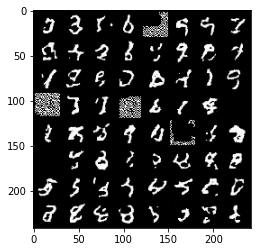

Epoch: [61/500]) Batch: [2/75] Negative Log-Likelihood: -3659.34521484375
Epoch: [61/500]) Batch: [3/75] Negative Log-Likelihood: -3667.28125
Epoch: [61/500]) Batch: [4/75] Negative Log-Likelihood: -3655.179931640625
Epoch: [61/500]) Batch: [5/75] Negative Log-Likelihood: -3662.9228515625
Epoch: [61/500]) Batch: [6/75] Negative Log-Likelihood: -3659.956787109375
Epoch: [61/500]) Batch: [7/75] Negative Log-Likelihood: -3659.850830078125
Epoch: [61/500]) Batch: [8/75] Negative Log-Likelihood: -3662.514892578125
Epoch: [61/500]) Batch: [9/75] Negative Log-Likelihood: -3672.864990234375
Epoch: [61/500]) Batch: [10/75] Negative Log-Likelihood: -3671.069580078125
Epoch: [61/500]) Batch: [11/75] Negative Log-Likelihood: -3661.64892578125
Epoch: [61/500]) Batch: [12/75] Negative Log-Likelihood: -3665.326171875
Epoch: [61/500]) Batch: [13/75] Negative Log-Likelihood: -3663.161376953125
Epoch: [61/500]) Batch: [14/75] Negative Log-Likelihood: -3649.7744140625
Epoch: [61/500]) Batch: [15/75] Nega

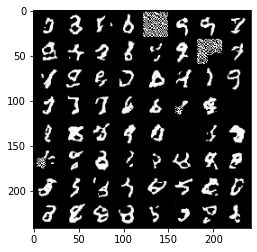

Epoch: [61/500]) Negative Log-Likelihood: -3637.04736328125
Epoch: [62/500]) Batch: [1/75] Negative Log-Likelihood: -3662.58642578125


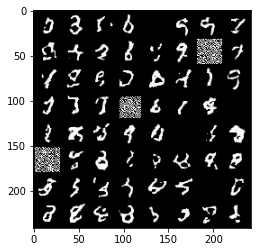

Epoch: [62/500]) Batch: [2/75] Negative Log-Likelihood: -3664.119873046875
Epoch: [62/500]) Batch: [3/75] Negative Log-Likelihood: -3668.10107421875
Epoch: [62/500]) Batch: [4/75] Negative Log-Likelihood: -3656.086181640625
Epoch: [62/500]) Batch: [5/75] Negative Log-Likelihood: -3668.69140625
Epoch: [62/500]) Batch: [6/75] Negative Log-Likelihood: -3666.154052734375
Epoch: [62/500]) Batch: [7/75] Negative Log-Likelihood: -3651.791748046875
Epoch: [62/500]) Batch: [8/75] Negative Log-Likelihood: -3657.239990234375
Epoch: [62/500]) Batch: [9/75] Negative Log-Likelihood: -3675.87109375
Epoch: [62/500]) Batch: [10/75] Negative Log-Likelihood: -3665.05126953125
Epoch: [62/500]) Batch: [11/75] Negative Log-Likelihood: -3664.741455078125
Epoch: [62/500]) Batch: [12/75] Negative Log-Likelihood: -3669.44482421875
Epoch: [62/500]) Batch: [13/75] Negative Log-Likelihood: -3662.93115234375
Epoch: [62/500]) Batch: [14/75] Negative Log-Likelihood: -3669.932373046875
Epoch: [62/500]) Batch: [15/75] 

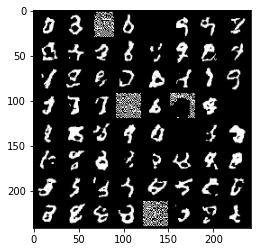

Epoch: [62/500]) Negative Log-Likelihood: -3636.244873046875
Epoch: [63/500]) Batch: [1/75] Negative Log-Likelihood: -3658.1611328125


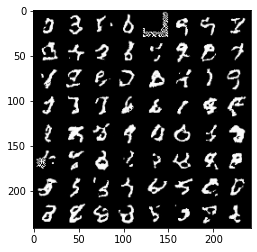

Epoch: [63/500]) Batch: [2/75] Negative Log-Likelihood: -3665.068603515625
Epoch: [63/500]) Batch: [3/75] Negative Log-Likelihood: -3671.693603515625
Epoch: [63/500]) Batch: [4/75] Negative Log-Likelihood: -3653.93701171875
Epoch: [63/500]) Batch: [5/75] Negative Log-Likelihood: -3668.048095703125
Epoch: [63/500]) Batch: [6/75] Negative Log-Likelihood: -3658.22998046875
Epoch: [63/500]) Batch: [7/75] Negative Log-Likelihood: -3651.209228515625
Epoch: [63/500]) Batch: [8/75] Negative Log-Likelihood: -3662.5966796875
Epoch: [63/500]) Batch: [9/75] Negative Log-Likelihood: -3666.044189453125
Epoch: [63/500]) Batch: [10/75] Negative Log-Likelihood: -3656.753662109375
Epoch: [63/500]) Batch: [11/75] Negative Log-Likelihood: -3662.248046875
Epoch: [63/500]) Batch: [12/75] Negative Log-Likelihood: -3662.701904296875
Epoch: [63/500]) Batch: [13/75] Negative Log-Likelihood: -3656.969970703125
Epoch: [63/500]) Batch: [14/75] Negative Log-Likelihood: -3661.276123046875
Epoch: [63/500]) Batch: [15

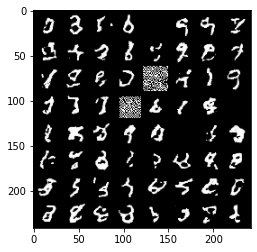

Epoch: [63/500]) Negative Log-Likelihood: -3636.177734375
Epoch: [64/500]) Batch: [1/75] Negative Log-Likelihood: -3650.424072265625


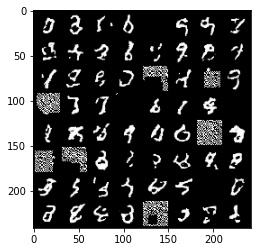

Epoch: [64/500]) Batch: [2/75] Negative Log-Likelihood: -3660.20458984375
Epoch: [64/500]) Batch: [3/75] Negative Log-Likelihood: -3653.954833984375
Epoch: [64/500]) Batch: [4/75] Negative Log-Likelihood: -3638.691162109375
Epoch: [64/500]) Batch: [5/75] Negative Log-Likelihood: -3653.201904296875
Epoch: [64/500]) Batch: [6/75] Negative Log-Likelihood: -3655.436279296875
Epoch: [64/500]) Batch: [7/75] Negative Log-Likelihood: -3648.8955078125
Epoch: [64/500]) Batch: [8/75] Negative Log-Likelihood: -3651.0537109375
Epoch: [64/500]) Batch: [9/75] Negative Log-Likelihood: -3662.99609375
Epoch: [64/500]) Batch: [10/75] Negative Log-Likelihood: -3661.157470703125
Epoch: [64/500]) Batch: [11/75] Negative Log-Likelihood: -3646.052978515625
Epoch: [64/500]) Batch: [12/75] Negative Log-Likelihood: -3658.013671875
Epoch: [64/500]) Batch: [13/75] Negative Log-Likelihood: -3650.579833984375
Epoch: [64/500]) Batch: [14/75] Negative Log-Likelihood: -3659.020751953125
Epoch: [64/500]) Batch: [15/75] 

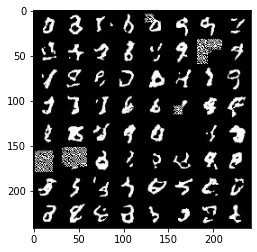

Epoch: [64/500]) Negative Log-Likelihood: -3637.405517578125
Epoch: [65/500]) Batch: [1/75] Negative Log-Likelihood: -3658.5224609375


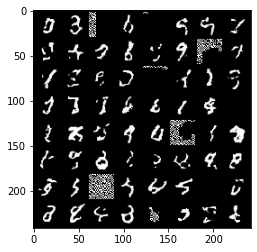

Epoch: [65/500]) Batch: [2/75] Negative Log-Likelihood: -3658.4306640625
Epoch: [65/500]) Batch: [3/75] Negative Log-Likelihood: -3672.33154296875
Epoch: [65/500]) Batch: [4/75] Negative Log-Likelihood: -3651.4619140625
Epoch: [65/500]) Batch: [5/75] Negative Log-Likelihood: -3655.28857421875
Epoch: [65/500]) Batch: [6/75] Negative Log-Likelihood: -3660.303466796875
Epoch: [65/500]) Batch: [7/75] Negative Log-Likelihood: -3648.1318359375
Epoch: [65/500]) Batch: [8/75] Negative Log-Likelihood: -3665.33935546875
Epoch: [65/500]) Batch: [9/75] Negative Log-Likelihood: -3672.85595703125
Epoch: [65/500]) Batch: [10/75] Negative Log-Likelihood: -3667.178466796875
Epoch: [65/500]) Batch: [11/75] Negative Log-Likelihood: -3664.373779296875
Epoch: [65/500]) Batch: [12/75] Negative Log-Likelihood: -3661.49462890625
Epoch: [65/500]) Batch: [13/75] Negative Log-Likelihood: -3660.8955078125
Epoch: [65/500]) Batch: [14/75] Negative Log-Likelihood: -3665.11865234375
Epoch: [65/500]) Batch: [15/75] Ne

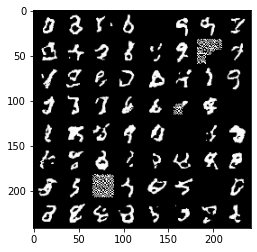

Epoch: [65/500]) Negative Log-Likelihood: -3638.287109375
Epoch: [66/500]) Batch: [1/75] Negative Log-Likelihood: -3657.639892578125


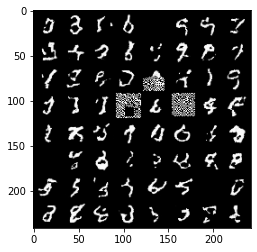

Epoch: [66/500]) Batch: [2/75] Negative Log-Likelihood: -3665.631103515625
Epoch: [66/500]) Batch: [3/75] Negative Log-Likelihood: -3670.796142578125
Epoch: [66/500]) Batch: [4/75] Negative Log-Likelihood: -3655.499267578125
Epoch: [66/500]) Batch: [5/75] Negative Log-Likelihood: -3667.4130859375
Epoch: [66/500]) Batch: [6/75] Negative Log-Likelihood: -3659.1962890625
Epoch: [66/500]) Batch: [7/75] Negative Log-Likelihood: -3654.614990234375
Epoch: [66/500]) Batch: [8/75] Negative Log-Likelihood: -3655.836181640625
Epoch: [66/500]) Batch: [9/75] Negative Log-Likelihood: -3657.610595703125
Epoch: [66/500]) Batch: [10/75] Negative Log-Likelihood: -3662.4794921875
Epoch: [66/500]) Batch: [11/75] Negative Log-Likelihood: -3653.991455078125
Epoch: [66/500]) Batch: [12/75] Negative Log-Likelihood: -3658.154296875
Epoch: [66/500]) Batch: [13/75] Negative Log-Likelihood: -3653.728759765625
Epoch: [66/500]) Batch: [14/75] Negative Log-Likelihood: -3657.420166015625
Epoch: [66/500]) Batch: [15/7

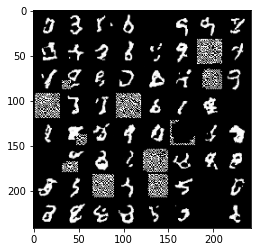

Epoch: [66/500]) Negative Log-Likelihood: -3627.53076171875
Epoch: [67/500]) Batch: [1/75] Negative Log-Likelihood: -3657.841064453125


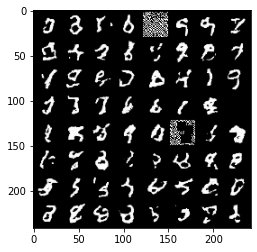

Epoch: [67/500]) Batch: [2/75] Negative Log-Likelihood: -3659.5224609375
Epoch: [67/500]) Batch: [3/75] Negative Log-Likelihood: -3656.08740234375
Epoch: [67/500]) Batch: [4/75] Negative Log-Likelihood: -3654.6181640625
Epoch: [67/500]) Batch: [5/75] Negative Log-Likelihood: -3654.989990234375
Epoch: [67/500]) Batch: [6/75] Negative Log-Likelihood: -3656.67236328125
Epoch: [67/500]) Batch: [7/75] Negative Log-Likelihood: -3654.270263671875
Epoch: [67/500]) Batch: [8/75] Negative Log-Likelihood: -3662.691162109375
Epoch: [67/500]) Batch: [9/75] Negative Log-Likelihood: -3669.3837890625
Epoch: [67/500]) Batch: [10/75] Negative Log-Likelihood: -3671.6005859375
Epoch: [67/500]) Batch: [11/75] Negative Log-Likelihood: -3661.6279296875
Epoch: [67/500]) Batch: [12/75] Negative Log-Likelihood: -3666.69091796875
Epoch: [67/500]) Batch: [13/75] Negative Log-Likelihood: -3656.001708984375
Epoch: [67/500]) Batch: [14/75] Negative Log-Likelihood: -3657.885009765625
Epoch: [67/500]) Batch: [15/75] N

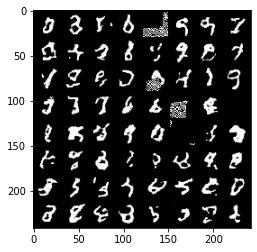

Epoch: [67/500]) Negative Log-Likelihood: -3639.264892578125
Epoch: [68/500]) Batch: [1/75] Negative Log-Likelihood: -3658.357421875


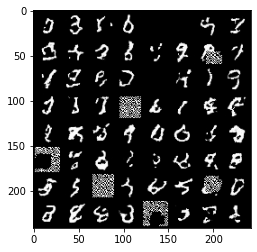

Epoch: [68/500]) Batch: [2/75] Negative Log-Likelihood: -3658.560546875
Epoch: [68/500]) Batch: [3/75] Negative Log-Likelihood: -3666.6591796875
Epoch: [68/500]) Batch: [4/75] Negative Log-Likelihood: -3657.570556640625
Epoch: [68/500]) Batch: [5/75] Negative Log-Likelihood: -3667.067138671875
Epoch: [68/500]) Batch: [6/75] Negative Log-Likelihood: -3665.21875
Epoch: [68/500]) Batch: [7/75] Negative Log-Likelihood: -3659.51806640625
Epoch: [68/500]) Batch: [8/75] Negative Log-Likelihood: -3666.5556640625
Epoch: [68/500]) Batch: [9/75] Negative Log-Likelihood: -3680.01220703125
Epoch: [68/500]) Batch: [10/75] Negative Log-Likelihood: -3669.724365234375
Epoch: [68/500]) Batch: [11/75] Negative Log-Likelihood: -3668.5244140625
Epoch: [68/500]) Batch: [12/75] Negative Log-Likelihood: -3666.666259765625
Epoch: [68/500]) Batch: [13/75] Negative Log-Likelihood: -3663.53564453125
Epoch: [68/500]) Batch: [14/75] Negative Log-Likelihood: -3662.145263671875
Epoch: [68/500]) Batch: [15/75] Negativ

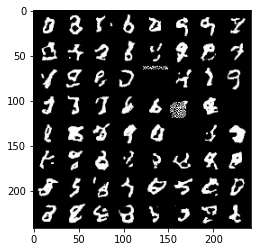

Epoch: [68/500]) Negative Log-Likelihood: -3643.108154296875
Epoch: [69/500]) Batch: [1/75] Negative Log-Likelihood: -3671.7666015625


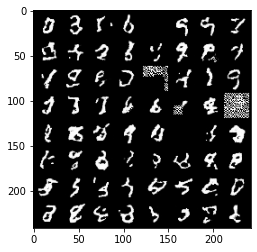

Epoch: [69/500]) Batch: [2/75] Negative Log-Likelihood: -3658.060546875
Epoch: [69/500]) Batch: [3/75] Negative Log-Likelihood: -3651.234375
Epoch: [69/500]) Batch: [4/75] Negative Log-Likelihood: -3648.737060546875
Epoch: [69/500]) Batch: [5/75] Negative Log-Likelihood: -3657.9833984375
Epoch: [69/500]) Batch: [6/75] Negative Log-Likelihood: -3649.674072265625
Epoch: [69/500]) Batch: [7/75] Negative Log-Likelihood: -3647.614501953125
Epoch: [69/500]) Batch: [8/75] Negative Log-Likelihood: -3659.380615234375
Epoch: [69/500]) Batch: [9/75] Negative Log-Likelihood: -3673.716796875
Epoch: [69/500]) Batch: [10/75] Negative Log-Likelihood: -3669.5693359375
Epoch: [69/500]) Batch: [11/75] Negative Log-Likelihood: -3666.813720703125
Epoch: [69/500]) Batch: [12/75] Negative Log-Likelihood: -3671.37744140625
Epoch: [69/500]) Batch: [13/75] Negative Log-Likelihood: -3659.726806640625
Epoch: [69/500]) Batch: [14/75] Negative Log-Likelihood: -3666.224365234375
Epoch: [69/500]) Batch: [15/75] Negat

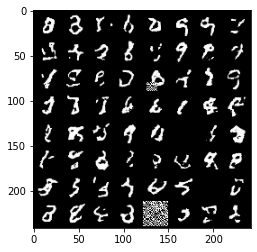

Epoch: [69/500]) Negative Log-Likelihood: -3625.6865234375
Epoch: [70/500]) Batch: [1/75] Negative Log-Likelihood: -3662.208251953125


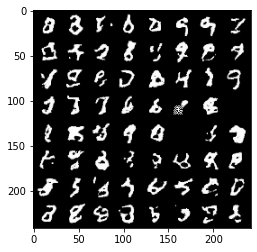

Epoch: [70/500]) Batch: [2/75] Negative Log-Likelihood: -3657.194580078125
Epoch: [70/500]) Batch: [3/75] Negative Log-Likelihood: -3663.8701171875
Epoch: [70/500]) Batch: [4/75] Negative Log-Likelihood: -3652.834716796875
Epoch: [70/500]) Batch: [5/75] Negative Log-Likelihood: -3667.083251953125
Epoch: [70/500]) Batch: [6/75] Negative Log-Likelihood: -3661.60302734375
Epoch: [70/500]) Batch: [7/75] Negative Log-Likelihood: -3648.996826171875
Epoch: [70/500]) Batch: [8/75] Negative Log-Likelihood: -3653.947998046875
Epoch: [70/500]) Batch: [9/75] Negative Log-Likelihood: -3661.479248046875
Epoch: [70/500]) Batch: [10/75] Negative Log-Likelihood: -3657.689208984375
Epoch: [70/500]) Batch: [11/75] Negative Log-Likelihood: -3665.609619140625
Epoch: [70/500]) Batch: [12/75] Negative Log-Likelihood: -3657.361083984375
Epoch: [70/500]) Batch: [13/75] Negative Log-Likelihood: -3643.830810546875
Epoch: [70/500]) Batch: [14/75] Negative Log-Likelihood: -3660.36181640625
Epoch: [70/500]) Batch: 

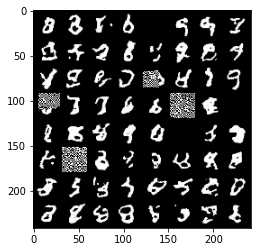

Epoch: [70/500]) Negative Log-Likelihood: -3635.358642578125
Epoch: [71/500]) Batch: [1/75] Negative Log-Likelihood: -3660.93798828125


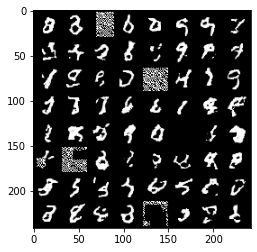

Epoch: [71/500]) Batch: [2/75] Negative Log-Likelihood: -3659.5517578125
Epoch: [71/500]) Batch: [3/75] Negative Log-Likelihood: -3668.5576171875
Epoch: [71/500]) Batch: [4/75] Negative Log-Likelihood: -3650.974853515625
Epoch: [71/500]) Batch: [5/75] Negative Log-Likelihood: -3663.3447265625
Epoch: [71/500]) Batch: [6/75] Negative Log-Likelihood: -3665.671875
Epoch: [71/500]) Batch: [7/75] Negative Log-Likelihood: -3657.391845703125
Epoch: [71/500]) Batch: [8/75] Negative Log-Likelihood: -3669.012939453125
Epoch: [71/500]) Batch: [9/75] Negative Log-Likelihood: -3675.015625
Epoch: [71/500]) Batch: [10/75] Negative Log-Likelihood: -3672.325439453125
Epoch: [71/500]) Batch: [11/75] Negative Log-Likelihood: -3674.649658203125
Epoch: [71/500]) Batch: [12/75] Negative Log-Likelihood: -3672.50732421875
Epoch: [71/500]) Batch: [13/75] Negative Log-Likelihood: -3670.320556640625
Epoch: [71/500]) Batch: [14/75] Negative Log-Likelihood: -3673.87158203125
Epoch: [71/500]) Batch: [15/75] Negative

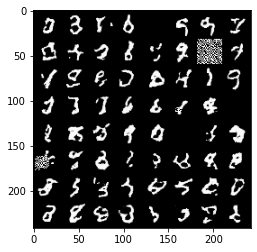

Epoch: [71/500]) Negative Log-Likelihood: -3643.716796875
Epoch: [72/500]) Batch: [1/75] Negative Log-Likelihood: -3662.416748046875


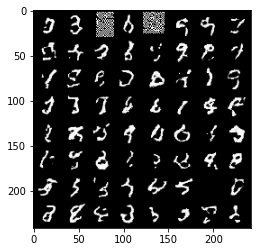

Epoch: [72/500]) Batch: [2/75] Negative Log-Likelihood: -3659.89013671875
Epoch: [72/500]) Batch: [3/75] Negative Log-Likelihood: -3675.717529296875
Epoch: [72/500]) Batch: [4/75] Negative Log-Likelihood: -3653.786865234375
Epoch: [72/500]) Batch: [5/75] Negative Log-Likelihood: -3660.533447265625
Epoch: [72/500]) Batch: [6/75] Negative Log-Likelihood: -3664.35595703125
Epoch: [72/500]) Batch: [7/75] Negative Log-Likelihood: -3653.681884765625
Epoch: [72/500]) Batch: [8/75] Negative Log-Likelihood: -3663.738037109375
Epoch: [72/500]) Batch: [9/75] Negative Log-Likelihood: -3679.4619140625
Epoch: [72/500]) Batch: [10/75] Negative Log-Likelihood: -3676.9833984375
Epoch: [72/500]) Batch: [11/75] Negative Log-Likelihood: -3674.279052734375
Epoch: [72/500]) Batch: [12/75] Negative Log-Likelihood: -3672.51513671875
Epoch: [72/500]) Batch: [13/75] Negative Log-Likelihood: -3672.63671875
Epoch: [72/500]) Batch: [14/75] Negative Log-Likelihood: -3673.2861328125
Epoch: [72/500]) Batch: [15/75] N

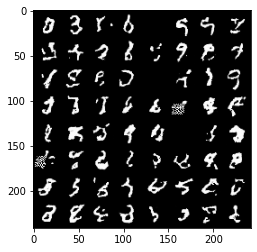

Epoch: [72/500]) Negative Log-Likelihood: -3646.2705078125
Epoch: [73/500]) Batch: [1/75] Negative Log-Likelihood: -3670.989990234375


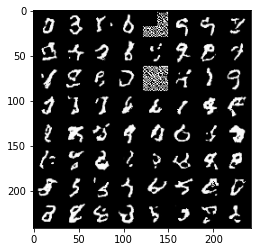

Epoch: [73/500]) Batch: [2/75] Negative Log-Likelihood: -3665.619384765625
Epoch: [73/500]) Batch: [3/75] Negative Log-Likelihood: -3671.659912109375
Epoch: [73/500]) Batch: [4/75] Negative Log-Likelihood: -3659.7373046875
Epoch: [73/500]) Batch: [5/75] Negative Log-Likelihood: -3669.150634765625
Epoch: [73/500]) Batch: [6/75] Negative Log-Likelihood: -3673.868896484375
Epoch: [73/500]) Batch: [7/75] Negative Log-Likelihood: -3650.043701171875
Epoch: [73/500]) Batch: [8/75] Negative Log-Likelihood: -3659.577392578125
Epoch: [73/500]) Batch: [9/75] Negative Log-Likelihood: -3673.856689453125
Epoch: [73/500]) Batch: [10/75] Negative Log-Likelihood: -3666.373779296875
Epoch: [73/500]) Batch: [11/75] Negative Log-Likelihood: -3671.3125
Epoch: [73/500]) Batch: [12/75] Negative Log-Likelihood: -3668.337158203125
Epoch: [73/500]) Batch: [13/75] Negative Log-Likelihood: -3655.97607421875
Epoch: [73/500]) Batch: [14/75] Negative Log-Likelihood: -3671.856689453125
Epoch: [73/500]) Batch: [15/75]

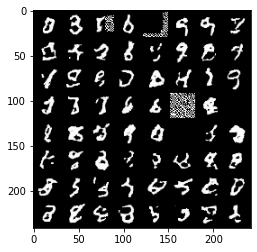

Epoch: [73/500]) Negative Log-Likelihood: -3651.372314453125
Epoch: [74/500]) Batch: [1/75] Negative Log-Likelihood: -3656.756591796875


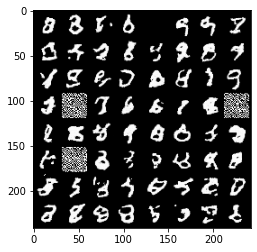

Epoch: [74/500]) Batch: [2/75] Negative Log-Likelihood: -3632.97314453125
Epoch: [74/500]) Batch: [3/75] Negative Log-Likelihood: -3642.98681640625
Epoch: [74/500]) Batch: [4/75] Negative Log-Likelihood: -3642.80859375
Epoch: [74/500]) Batch: [5/75] Negative Log-Likelihood: -3658.826904296875
Epoch: [74/500]) Batch: [6/75] Negative Log-Likelihood: -3654.280029296875
Epoch: [74/500]) Batch: [7/75] Negative Log-Likelihood: -3648.89794921875
Epoch: [74/500]) Batch: [8/75] Negative Log-Likelihood: -3668.78515625
Epoch: [74/500]) Batch: [9/75] Negative Log-Likelihood: -3671.3154296875
Epoch: [74/500]) Batch: [10/75] Negative Log-Likelihood: -3665.25732421875
Epoch: [74/500]) Batch: [11/75] Negative Log-Likelihood: -3666.321533203125
Epoch: [74/500]) Batch: [12/75] Negative Log-Likelihood: -3669.9873046875
Epoch: [74/500]) Batch: [13/75] Negative Log-Likelihood: -3655.320556640625
Epoch: [74/500]) Batch: [14/75] Negative Log-Likelihood: -3656.223388671875
Epoch: [74/500]) Batch: [15/75] Nega

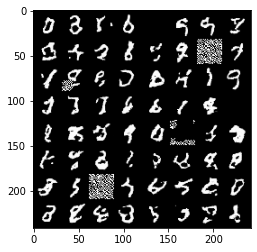

Epoch: [74/500]) Negative Log-Likelihood: -3642.990478515625
Epoch: [75/500]) Batch: [1/75] Negative Log-Likelihood: -3664.03369140625


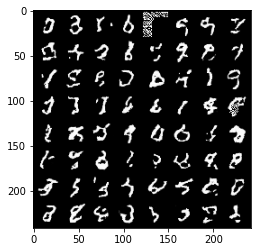

Epoch: [75/500]) Batch: [2/75] Negative Log-Likelihood: -3660.530517578125
Epoch: [75/500]) Batch: [3/75] Negative Log-Likelihood: -3673.5732421875
Epoch: [75/500]) Batch: [4/75] Negative Log-Likelihood: -3660.56494140625
Epoch: [75/500]) Batch: [5/75] Negative Log-Likelihood: -3670.236083984375
Epoch: [75/500]) Batch: [6/75] Negative Log-Likelihood: -3669.849365234375
Epoch: [75/500]) Batch: [7/75] Negative Log-Likelihood: -3661.231201171875
Epoch: [75/500]) Batch: [8/75] Negative Log-Likelihood: -3674.5673828125
Epoch: [75/500]) Batch: [9/75] Negative Log-Likelihood: -3678.458740234375
Epoch: [75/500]) Batch: [10/75] Negative Log-Likelihood: -3668.18701171875
Epoch: [75/500]) Batch: [11/75] Negative Log-Likelihood: -3664.318603515625
Epoch: [75/500]) Batch: [12/75] Negative Log-Likelihood: -3672.79736328125
Epoch: [75/500]) Batch: [13/75] Negative Log-Likelihood: -3666.760498046875
Epoch: [75/500]) Batch: [14/75] Negative Log-Likelihood: -3671.00146484375
Epoch: [75/500]) Batch: [15/

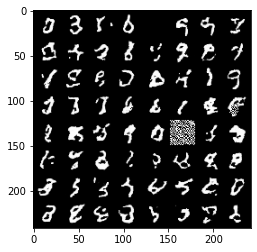

Epoch: [75/500]) Negative Log-Likelihood: -3654.439208984375
Epoch: [76/500]) Batch: [1/75] Negative Log-Likelihood: -3672.2724609375


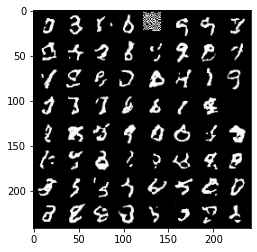

Epoch: [76/500]) Batch: [2/75] Negative Log-Likelihood: -3678.453369140625
Epoch: [76/500]) Batch: [3/75] Negative Log-Likelihood: -3673.97119140625
Epoch: [76/500]) Batch: [4/75] Negative Log-Likelihood: -3658.013916015625
Epoch: [76/500]) Batch: [5/75] Negative Log-Likelihood: -3674.262451171875
Epoch: [76/500]) Batch: [6/75] Negative Log-Likelihood: -3669.431396484375
Epoch: [76/500]) Batch: [7/75] Negative Log-Likelihood: -3663.117431640625
Epoch: [76/500]) Batch: [8/75] Negative Log-Likelihood: -3675.756591796875
Epoch: [76/500]) Batch: [9/75] Negative Log-Likelihood: -3682.07275390625
Epoch: [76/500]) Batch: [10/75] Negative Log-Likelihood: -3678.186767578125
Epoch: [76/500]) Batch: [11/75] Negative Log-Likelihood: -3674.14208984375
Epoch: [76/500]) Batch: [12/75] Negative Log-Likelihood: -3677.79931640625
Epoch: [76/500]) Batch: [13/75] Negative Log-Likelihood: -3667.969970703125
Epoch: [76/500]) Batch: [14/75] Negative Log-Likelihood: -3668.263671875
Epoch: [76/500]) Batch: [15

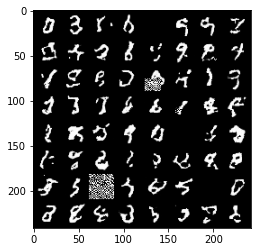

Epoch: [76/500]) Negative Log-Likelihood: -3642.091064453125
Epoch: [77/500]) Batch: [1/75] Negative Log-Likelihood: -3662.669189453125


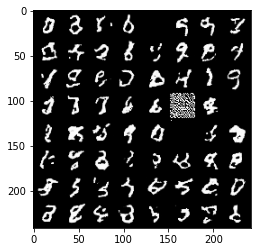

Epoch: [77/500]) Batch: [2/75] Negative Log-Likelihood: -3670.134521484375
Epoch: [77/500]) Batch: [3/75] Negative Log-Likelihood: -3672.165283203125
Epoch: [77/500]) Batch: [4/75] Negative Log-Likelihood: -3657.669921875
Epoch: [77/500]) Batch: [5/75] Negative Log-Likelihood: -3671.1416015625
Epoch: [77/500]) Batch: [6/75] Negative Log-Likelihood: -3671.697998046875
Epoch: [77/500]) Batch: [7/75] Negative Log-Likelihood: -3661.74169921875
Epoch: [77/500]) Batch: [8/75] Negative Log-Likelihood: -3674.948974609375
Epoch: [77/500]) Batch: [9/75] Negative Log-Likelihood: -3681.523681640625
Epoch: [77/500]) Batch: [10/75] Negative Log-Likelihood: -3678.40234375
Epoch: [77/500]) Batch: [11/75] Negative Log-Likelihood: -3675.632080078125
Epoch: [77/500]) Batch: [12/75] Negative Log-Likelihood: -3667.657958984375
Epoch: [77/500]) Batch: [13/75] Negative Log-Likelihood: -3668.5576171875
Epoch: [77/500]) Batch: [14/75] Negative Log-Likelihood: -3674.559326171875
Epoch: [77/500]) Batch: [15/75] 

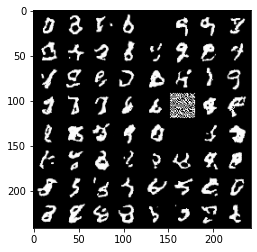

Epoch: [77/500]) Negative Log-Likelihood: -3635.119384765625
Epoch: [78/500]) Batch: [1/75] Negative Log-Likelihood: -3658.67626953125


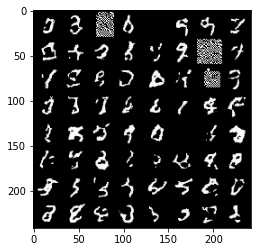

Epoch: [78/500]) Batch: [2/75] Negative Log-Likelihood: -3655.378662109375
Epoch: [78/500]) Batch: [3/75] Negative Log-Likelihood: -3669.869384765625
Epoch: [78/500]) Batch: [4/75] Negative Log-Likelihood: -3651.508056640625
Epoch: [78/500]) Batch: [5/75] Negative Log-Likelihood: -3669.41552734375
Epoch: [78/500]) Batch: [6/75] Negative Log-Likelihood: -3664.3994140625
Epoch: [78/500]) Batch: [7/75] Negative Log-Likelihood: -3643.62744140625
Epoch: [78/500]) Batch: [8/75] Negative Log-Likelihood: -3665.3232421875
Epoch: [78/500]) Batch: [9/75] Negative Log-Likelihood: -3680.900634765625
Epoch: [78/500]) Batch: [10/75] Negative Log-Likelihood: -3670.453125
Epoch: [78/500]) Batch: [11/75] Negative Log-Likelihood: -3657.19921875
Epoch: [78/500]) Batch: [12/75] Negative Log-Likelihood: -3663.01025390625
Epoch: [78/500]) Batch: [13/75] Negative Log-Likelihood: -3653.445556640625
Epoch: [78/500]) Batch: [14/75] Negative Log-Likelihood: -3664.742431640625
Epoch: [78/500]) Batch: [15/75] Negat

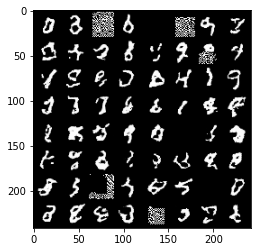

Epoch: [78/500]) Negative Log-Likelihood: -3639.0068359375
Epoch: [79/500]) Batch: [1/75] Negative Log-Likelihood: -3665.52587890625


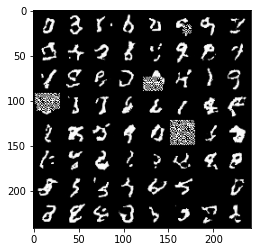

Epoch: [79/500]) Batch: [2/75] Negative Log-Likelihood: -3669.945556640625
Epoch: [79/500]) Batch: [3/75] Negative Log-Likelihood: -3672.81201171875
Epoch: [79/500]) Batch: [4/75] Negative Log-Likelihood: -3659.4541015625
Epoch: [79/500]) Batch: [5/75] Negative Log-Likelihood: -3674.736083984375
Epoch: [79/500]) Batch: [6/75] Negative Log-Likelihood: -3663.939697265625
Epoch: [79/500]) Batch: [7/75] Negative Log-Likelihood: -3659.530029296875
Epoch: [79/500]) Batch: [8/75] Negative Log-Likelihood: -3675.556884765625
Epoch: [79/500]) Batch: [9/75] Negative Log-Likelihood: -3674.738037109375
Epoch: [79/500]) Batch: [10/75] Negative Log-Likelihood: -3674.360595703125
Epoch: [79/500]) Batch: [11/75] Negative Log-Likelihood: -3670.067626953125
Epoch: [79/500]) Batch: [12/75] Negative Log-Likelihood: -3659.06640625
Epoch: [79/500]) Batch: [13/75] Negative Log-Likelihood: -3661.2939453125
Epoch: [79/500]) Batch: [14/75] Negative Log-Likelihood: -3674.424072265625
Epoch: [79/500]) Batch: [15/7

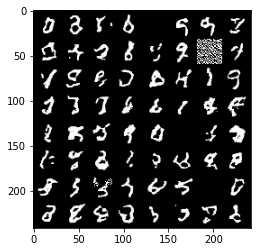

Epoch: [79/500]) Negative Log-Likelihood: -3644.213134765625
Epoch: [80/500]) Batch: [1/75] Negative Log-Likelihood: -3667.318603515625


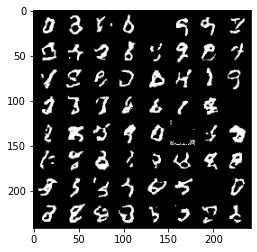

Epoch: [80/500]) Batch: [2/75] Negative Log-Likelihood: -3668.86669921875
Epoch: [80/500]) Batch: [3/75] Negative Log-Likelihood: -3676.782958984375
Epoch: [80/500]) Batch: [4/75] Negative Log-Likelihood: -3662.479248046875
Epoch: [80/500]) Batch: [5/75] Negative Log-Likelihood: -3675.489990234375
Epoch: [80/500]) Batch: [6/75] Negative Log-Likelihood: -3669.809326171875
Epoch: [80/500]) Batch: [7/75] Negative Log-Likelihood: -3667.92919921875
Epoch: [80/500]) Batch: [8/75] Negative Log-Likelihood: -3675.7392578125
Epoch: [80/500]) Batch: [9/75] Negative Log-Likelihood: -3691.093017578125
Epoch: [80/500]) Batch: [10/75] Negative Log-Likelihood: -3666.163330078125
Epoch: [80/500]) Batch: [11/75] Negative Log-Likelihood: -3640.708740234375
Epoch: [80/500]) Batch: [12/75] Negative Log-Likelihood: -3667.42236328125
Epoch: [80/500]) Batch: [13/75] Negative Log-Likelihood: -3657.24658203125
Epoch: [80/500]) Batch: [14/75] Negative Log-Likelihood: -3641.447998046875
Epoch: [80/500]) Batch: [1

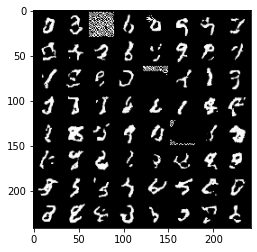

Epoch: [80/500]) Negative Log-Likelihood: -3651.420166015625
Epoch: [81/500]) Batch: [1/75] Negative Log-Likelihood: -3672.212646484375


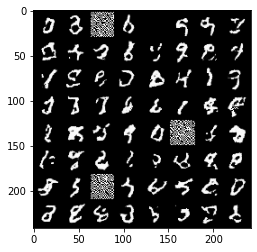

Epoch: [81/500]) Batch: [2/75] Negative Log-Likelihood: -3673.454833984375
Epoch: [81/500]) Batch: [3/75] Negative Log-Likelihood: -3680.12548828125
Epoch: [81/500]) Batch: [4/75] Negative Log-Likelihood: -3662.059814453125
Epoch: [81/500]) Batch: [5/75] Negative Log-Likelihood: -3675.086181640625
Epoch: [81/500]) Batch: [6/75] Negative Log-Likelihood: -3677.043701171875
Epoch: [81/500]) Batch: [7/75] Negative Log-Likelihood: -3660.021728515625
Epoch: [81/500]) Batch: [8/75] Negative Log-Likelihood: -3672.3046875
Epoch: [81/500]) Batch: [9/75] Negative Log-Likelihood: -3671.364013671875
Epoch: [81/500]) Batch: [10/75] Negative Log-Likelihood: -3660.44873046875
Epoch: [81/500]) Batch: [11/75] Negative Log-Likelihood: -3665.462646484375
Epoch: [81/500]) Batch: [12/75] Negative Log-Likelihood: -3667.718017578125
Epoch: [81/500]) Batch: [13/75] Negative Log-Likelihood: -3659.782470703125
Epoch: [81/500]) Batch: [14/75] Negative Log-Likelihood: -3664.82861328125
Epoch: [81/500]) Batch: [15/

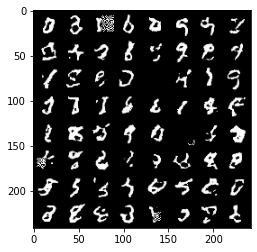

Epoch: [81/500]) Negative Log-Likelihood: -3650.1923828125
Epoch: [82/500]) Batch: [1/75] Negative Log-Likelihood: -3666.7041015625


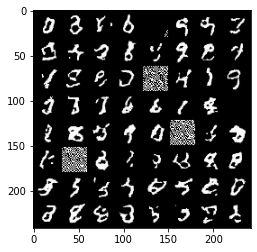

Epoch: [82/500]) Batch: [2/75] Negative Log-Likelihood: -3665.8818359375
Epoch: [82/500]) Batch: [3/75] Negative Log-Likelihood: -3654.843017578125
Epoch: [82/500]) Batch: [4/75] Negative Log-Likelihood: -3657.240966796875
Epoch: [82/500]) Batch: [5/75] Negative Log-Likelihood: -3667.210205078125
Epoch: [82/500]) Batch: [6/75] Negative Log-Likelihood: -3655.574951171875
Epoch: [82/500]) Batch: [7/75] Negative Log-Likelihood: -3663.14990234375
Epoch: [82/500]) Batch: [8/75] Negative Log-Likelihood: -3661.21240234375
Epoch: [82/500]) Batch: [9/75] Negative Log-Likelihood: -3673.169189453125
Epoch: [82/500]) Batch: [10/75] Negative Log-Likelihood: -3677.341064453125
Epoch: [82/500]) Batch: [11/75] Negative Log-Likelihood: -3660.7216796875
Epoch: [82/500]) Batch: [12/75] Negative Log-Likelihood: -3659.762939453125
Epoch: [82/500]) Batch: [13/75] Negative Log-Likelihood: -3669.74560546875
Epoch: [82/500]) Batch: [14/75] Negative Log-Likelihood: -3661.0625
Epoch: [82/500]) Batch: [15/75] Neg

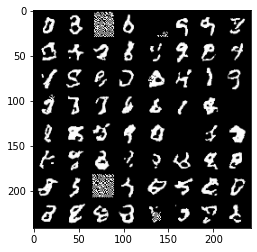

Epoch: [82/500]) Negative Log-Likelihood: -3646.160888671875
Epoch: [83/500]) Batch: [1/75] Negative Log-Likelihood: -3665.79248046875


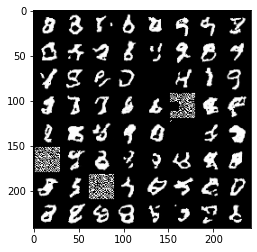

Epoch: [83/500]) Batch: [2/75] Negative Log-Likelihood: -3662.60302734375
Epoch: [83/500]) Batch: [3/75] Negative Log-Likelihood: -3667.225830078125
Epoch: [83/500]) Batch: [4/75] Negative Log-Likelihood: -3655.75048828125
Epoch: [83/500]) Batch: [5/75] Negative Log-Likelihood: -3667.886474609375
Epoch: [83/500]) Batch: [6/75] Negative Log-Likelihood: -3669.032958984375
Epoch: [83/500]) Batch: [7/75] Negative Log-Likelihood: -3660.278076171875
Epoch: [83/500]) Batch: [8/75] Negative Log-Likelihood: -3672.47607421875
Epoch: [83/500]) Batch: [9/75] Negative Log-Likelihood: -3683.604248046875
Epoch: [83/500]) Batch: [10/75] Negative Log-Likelihood: -3675.978759765625
Epoch: [83/500]) Batch: [11/75] Negative Log-Likelihood: -3673.22607421875
Epoch: [83/500]) Batch: [12/75] Negative Log-Likelihood: -3677.265625
Epoch: [83/500]) Batch: [13/75] Negative Log-Likelihood: -3673.641845703125
Epoch: [83/500]) Batch: [14/75] Negative Log-Likelihood: -3677.068115234375
Epoch: [83/500]) Batch: [15/75

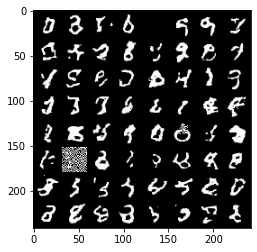

Epoch: [83/500]) Negative Log-Likelihood: -3641.75
Epoch: [84/500]) Batch: [1/75] Negative Log-Likelihood: -3669.09814453125


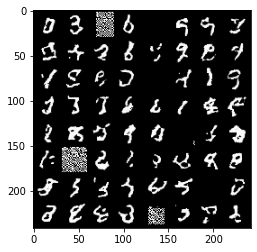

Epoch: [84/500]) Batch: [2/75] Negative Log-Likelihood: -3671.46044921875
Epoch: [84/500]) Batch: [3/75] Negative Log-Likelihood: -3680.443115234375
Epoch: [84/500]) Batch: [4/75] Negative Log-Likelihood: -3663.5029296875
Epoch: [84/500]) Batch: [5/75] Negative Log-Likelihood: -3675.494384765625
Epoch: [84/500]) Batch: [6/75] Negative Log-Likelihood: -3677.54833984375
Epoch: [84/500]) Batch: [7/75] Negative Log-Likelihood: -3659.8271484375
Epoch: [84/500]) Batch: [8/75] Negative Log-Likelihood: -3666.6845703125
Epoch: [84/500]) Batch: [9/75] Negative Log-Likelihood: -3668.8720703125
Epoch: [84/500]) Batch: [10/75] Negative Log-Likelihood: -3664.82177734375
Epoch: [84/500]) Batch: [11/75] Negative Log-Likelihood: -3666.00927734375
Epoch: [84/500]) Batch: [12/75] Negative Log-Likelihood: -3669.682373046875
Epoch: [84/500]) Batch: [13/75] Negative Log-Likelihood: -3665.411376953125
Epoch: [84/500]) Batch: [14/75] Negative Log-Likelihood: -3675.7138671875
Epoch: [84/500]) Batch: [15/75] Ne

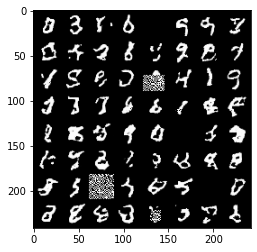

Epoch: [84/500]) Negative Log-Likelihood: -3656.00341796875
Epoch: [85/500]) Batch: [1/75] Negative Log-Likelihood: -3670.047119140625


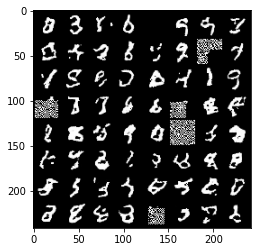

Epoch: [85/500]) Batch: [2/75] Negative Log-Likelihood: -3667.371826171875
Epoch: [85/500]) Batch: [3/75] Negative Log-Likelihood: -3676.412353515625
Epoch: [85/500]) Batch: [4/75] Negative Log-Likelihood: -3665.197998046875
Epoch: [85/500]) Batch: [5/75] Negative Log-Likelihood: -3673.3818359375
Epoch: [85/500]) Batch: [6/75] Negative Log-Likelihood: -3676.989013671875
Epoch: [85/500]) Batch: [7/75] Negative Log-Likelihood: -3660.702392578125
Epoch: [85/500]) Batch: [8/75] Negative Log-Likelihood: -3680.386474609375
Epoch: [85/500]) Batch: [9/75] Negative Log-Likelihood: -3687.359619140625
Epoch: [85/500]) Batch: [10/75] Negative Log-Likelihood: -3686.02294921875
Epoch: [85/500]) Batch: [11/75] Negative Log-Likelihood: -3680.53076171875
Epoch: [85/500]) Batch: [12/75] Negative Log-Likelihood: -3676.7392578125
Epoch: [85/500]) Batch: [13/75] Negative Log-Likelihood: -3676.674560546875
Epoch: [85/500]) Batch: [14/75] Negative Log-Likelihood: -3675.989990234375
Epoch: [85/500]) Batch: [1

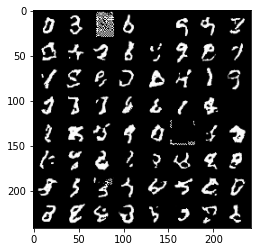

Epoch: [85/500]) Negative Log-Likelihood: -3657.318115234375
Epoch: [86/500]) Batch: [1/75] Negative Log-Likelihood: -3678.13720703125


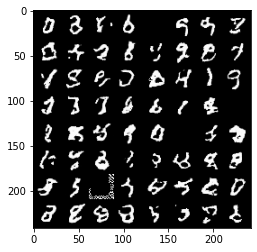

Epoch: [86/500]) Batch: [2/75] Negative Log-Likelihood: -3678.49658203125
Epoch: [86/500]) Batch: [3/75] Negative Log-Likelihood: -3682.543701171875
Epoch: [86/500]) Batch: [4/75] Negative Log-Likelihood: -3670.0
Epoch: [86/500]) Batch: [5/75] Negative Log-Likelihood: -3678.793701171875
Epoch: [86/500]) Batch: [6/75] Negative Log-Likelihood: -3675.4130859375
Epoch: [86/500]) Batch: [7/75] Negative Log-Likelihood: -3669.170166015625
Epoch: [86/500]) Batch: [8/75] Negative Log-Likelihood: -3677.33935546875
Epoch: [86/500]) Batch: [9/75] Negative Log-Likelihood: -3691.177978515625
Epoch: [86/500]) Batch: [10/75] Negative Log-Likelihood: -3671.582763671875
Epoch: [86/500]) Batch: [11/75] Negative Log-Likelihood: -3661.61767578125
Epoch: [86/500]) Batch: [12/75] Negative Log-Likelihood: -3672.20703125
Epoch: [86/500]) Batch: [13/75] Negative Log-Likelihood: -3663.56982421875
Epoch: [86/500]) Batch: [14/75] Negative Log-Likelihood: -3671.809814453125
Epoch: [86/500]) Batch: [15/75] Negative 

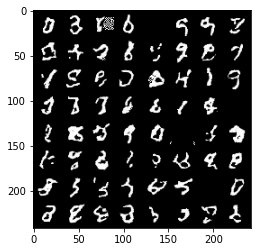

Epoch: [86/500]) Negative Log-Likelihood: -3653.077392578125
Epoch: [87/500]) Batch: [1/75] Negative Log-Likelihood: -3672.29248046875


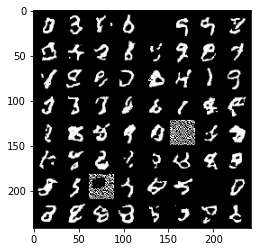

Epoch: [87/500]) Batch: [2/75] Negative Log-Likelihood: -3677.296875
Epoch: [87/500]) Batch: [3/75] Negative Log-Likelihood: -3684.87109375
Epoch: [87/500]) Batch: [4/75] Negative Log-Likelihood: -3666.02783203125
Epoch: [87/500]) Batch: [5/75] Negative Log-Likelihood: -3681.979248046875
Epoch: [87/500]) Batch: [6/75] Negative Log-Likelihood: -3677.2353515625
Epoch: [87/500]) Batch: [7/75] Negative Log-Likelihood: -3667.4404296875
Epoch: [87/500]) Batch: [8/75] Negative Log-Likelihood: -3678.804931640625
Epoch: [87/500]) Batch: [9/75] Negative Log-Likelihood: -3688.373046875
Epoch: [87/500]) Batch: [10/75] Negative Log-Likelihood: -3670.986083984375
Epoch: [87/500]) Batch: [11/75] Negative Log-Likelihood: -3663.203125
Epoch: [87/500]) Batch: [12/75] Negative Log-Likelihood: -3671.673583984375
Epoch: [87/500]) Batch: [13/75] Negative Log-Likelihood: -3670.33984375
Epoch: [87/500]) Batch: [14/75] Negative Log-Likelihood: -3677.770751953125
Epoch: [87/500]) Batch: [15/75] Negative Log-Lik

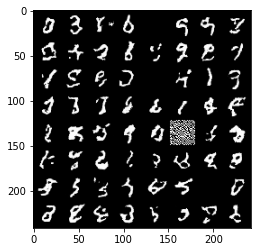

Epoch: [87/500]) Negative Log-Likelihood: -3656.060546875
Epoch: [88/500]) Batch: [1/75] Negative Log-Likelihood: -3668.951416015625


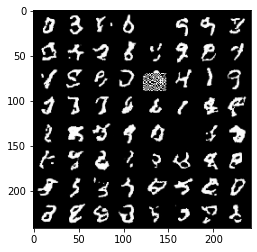

Epoch: [88/500]) Batch: [2/75] Negative Log-Likelihood: -3658.548095703125
Epoch: [88/500]) Batch: [3/75] Negative Log-Likelihood: -3677.0712890625
Epoch: [88/500]) Batch: [4/75] Negative Log-Likelihood: -3664.95751953125
Epoch: [88/500]) Batch: [5/75] Negative Log-Likelihood: -3667.02001953125
Epoch: [88/500]) Batch: [6/75] Negative Log-Likelihood: -3673.26953125
Epoch: [88/500]) Batch: [7/75] Negative Log-Likelihood: -3664.8623046875
Epoch: [88/500]) Batch: [8/75] Negative Log-Likelihood: -3666.6396484375
Epoch: [88/500]) Batch: [9/75] Negative Log-Likelihood: -3681.21923828125
Epoch: [88/500]) Batch: [10/75] Negative Log-Likelihood: -3685.310546875
Epoch: [88/500]) Batch: [11/75] Negative Log-Likelihood: -3669.779541015625
Epoch: [88/500]) Batch: [12/75] Negative Log-Likelihood: -3669.51611328125
Epoch: [88/500]) Batch: [13/75] Negative Log-Likelihood: -3668.24609375
Epoch: [88/500]) Batch: [14/75] Negative Log-Likelihood: -3678.03857421875
Epoch: [88/500]) Batch: [15/75] Negative L

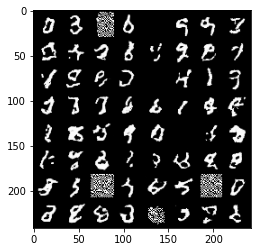

Epoch: [88/500]) Negative Log-Likelihood: -3643.98046875
Epoch: [89/500]) Batch: [1/75] Negative Log-Likelihood: -3655.139404296875


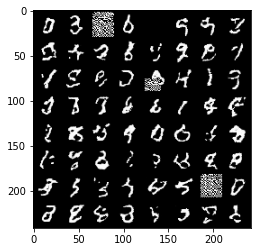

Epoch: [89/500]) Batch: [2/75] Negative Log-Likelihood: -3667.44091796875
Epoch: [89/500]) Batch: [3/75] Negative Log-Likelihood: -3677.186279296875
Epoch: [89/500]) Batch: [4/75] Negative Log-Likelihood: -3662.49169921875
Epoch: [89/500]) Batch: [5/75] Negative Log-Likelihood: -3672.691162109375
Epoch: [89/500]) Batch: [6/75] Negative Log-Likelihood: -3673.33740234375
Epoch: [89/500]) Batch: [7/75] Negative Log-Likelihood: -3664.96484375
Epoch: [89/500]) Batch: [8/75] Negative Log-Likelihood: -3672.7060546875
Epoch: [89/500]) Batch: [9/75] Negative Log-Likelihood: -3688.4130859375
Epoch: [89/500]) Batch: [10/75] Negative Log-Likelihood: -3680.587646484375
Epoch: [89/500]) Batch: [11/75] Negative Log-Likelihood: -3677.843994140625
Epoch: [89/500]) Batch: [12/75] Negative Log-Likelihood: -3671.07763671875
Epoch: [89/500]) Batch: [13/75] Negative Log-Likelihood: -3649.4912109375
Epoch: [89/500]) Batch: [14/75] Negative Log-Likelihood: -3662.5576171875
Epoch: [89/500]) Batch: [15/75] Nega

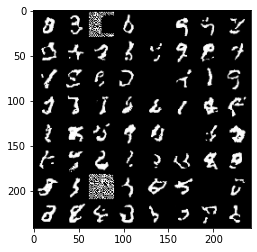

Epoch: [89/500]) Negative Log-Likelihood: -3637.882080078125
Epoch: [90/500]) Batch: [1/75] Negative Log-Likelihood: -3670.33056640625


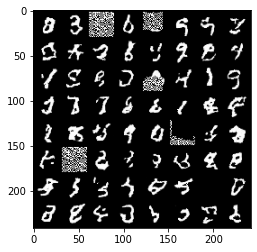

Epoch: [90/500]) Batch: [2/75] Negative Log-Likelihood: -3670.1630859375
Epoch: [90/500]) Batch: [3/75] Negative Log-Likelihood: -3670.999267578125
Epoch: [90/500]) Batch: [4/75] Negative Log-Likelihood: -3665.42919921875
Epoch: [90/500]) Batch: [5/75] Negative Log-Likelihood: -3671.58984375
Epoch: [90/500]) Batch: [6/75] Negative Log-Likelihood: -3674.1328125
Epoch: [90/500]) Batch: [7/75] Negative Log-Likelihood: -3666.873779296875
Epoch: [90/500]) Batch: [8/75] Negative Log-Likelihood: -3674.23876953125
Epoch: [90/500]) Batch: [9/75] Negative Log-Likelihood: -3683.259521484375
Epoch: [90/500]) Batch: [10/75] Negative Log-Likelihood: -3675.92919921875
Epoch: [90/500]) Batch: [11/75] Negative Log-Likelihood: -3673.7548828125
Epoch: [90/500]) Batch: [12/75] Negative Log-Likelihood: -3672.73876953125
Epoch: [90/500]) Batch: [13/75] Negative Log-Likelihood: -3667.418701171875
Epoch: [90/500]) Batch: [14/75] Negative Log-Likelihood: -3678.26953125
Epoch: [90/500]) Batch: [15/75] Negative 

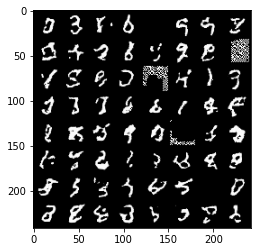

Epoch: [90/500]) Negative Log-Likelihood: -3655.04052734375
Epoch: [91/500]) Batch: [1/75] Negative Log-Likelihood: -3666.276123046875


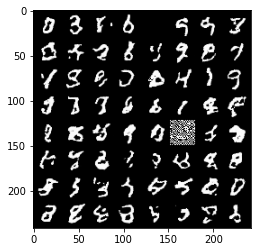

Epoch: [91/500]) Batch: [2/75] Negative Log-Likelihood: -3673.1298828125
Epoch: [91/500]) Batch: [3/75] Negative Log-Likelihood: -3683.60498046875
Epoch: [91/500]) Batch: [4/75] Negative Log-Likelihood: -3666.48876953125
Epoch: [91/500]) Batch: [5/75] Negative Log-Likelihood: -3677.346435546875
Epoch: [91/500]) Batch: [6/75] Negative Log-Likelihood: -3674.514404296875
Epoch: [91/500]) Batch: [7/75] Negative Log-Likelihood: -3668.03125
Epoch: [91/500]) Batch: [8/75] Negative Log-Likelihood: -3674.3681640625
Epoch: [91/500]) Batch: [9/75] Negative Log-Likelihood: -3684.4931640625
Epoch: [91/500]) Batch: [10/75] Negative Log-Likelihood: -3674.92431640625
Epoch: [91/500]) Batch: [11/75] Negative Log-Likelihood: -3672.981689453125
Epoch: [91/500]) Batch: [12/75] Negative Log-Likelihood: -3676.912353515625
Epoch: [91/500]) Batch: [13/75] Negative Log-Likelihood: -3675.992431640625
Epoch: [91/500]) Batch: [14/75] Negative Log-Likelihood: -3668.518310546875
Epoch: [91/500]) Batch: [15/75] Nega

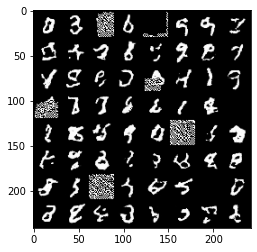

Epoch: [91/500]) Negative Log-Likelihood: -3654.821533203125
Epoch: [92/500]) Batch: [1/75] Negative Log-Likelihood: -3671.126708984375


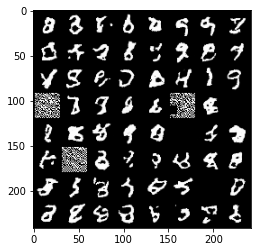

Epoch: [92/500]) Batch: [2/75] Negative Log-Likelihood: -3670.185546875
Epoch: [92/500]) Batch: [3/75] Negative Log-Likelihood: -3678.7978515625
Epoch: [92/500]) Batch: [4/75] Negative Log-Likelihood: -3666.646484375
Epoch: [92/500]) Batch: [5/75] Negative Log-Likelihood: -3677.9228515625
Epoch: [92/500]) Batch: [6/75] Negative Log-Likelihood: -3676.685546875
Epoch: [92/500]) Batch: [7/75] Negative Log-Likelihood: -3664.04150390625
Epoch: [92/500]) Batch: [8/75] Negative Log-Likelihood: -3676.22265625
Epoch: [92/500]) Batch: [9/75] Negative Log-Likelihood: -3685.1494140625
Epoch: [92/500]) Batch: [10/75] Negative Log-Likelihood: -3684.83544921875
Epoch: [92/500]) Batch: [11/75] Negative Log-Likelihood: -3672.00732421875
Epoch: [92/500]) Batch: [12/75] Negative Log-Likelihood: -3674.5986328125
Epoch: [92/500]) Batch: [13/75] Negative Log-Likelihood: -3672.4306640625
Epoch: [92/500]) Batch: [14/75] Negative Log-Likelihood: -3671.0146484375
Epoch: [92/500]) Batch: [15/75] Negative Log-Lik

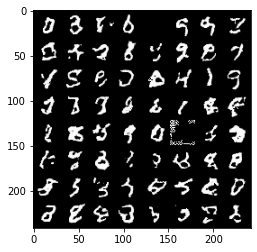

Epoch: [92/500]) Negative Log-Likelihood: -3652.822998046875
Epoch: [93/500]) Batch: [1/75] Negative Log-Likelihood: -3674.70263671875


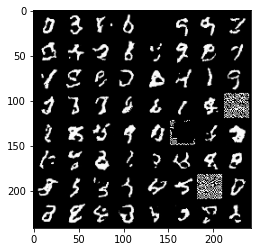

Epoch: [93/500]) Batch: [2/75] Negative Log-Likelihood: -3676.35302734375
Epoch: [93/500]) Batch: [3/75] Negative Log-Likelihood: -3684.9873046875
Epoch: [93/500]) Batch: [4/75] Negative Log-Likelihood: -3668.713134765625
Epoch: [93/500]) Batch: [5/75] Negative Log-Likelihood: -3676.553466796875
Epoch: [93/500]) Batch: [6/75] Negative Log-Likelihood: -3682.0546875
Epoch: [93/500]) Batch: [7/75] Negative Log-Likelihood: -3666.344970703125
Epoch: [93/500]) Batch: [8/75] Negative Log-Likelihood: -3679.97021484375
Epoch: [93/500]) Batch: [9/75] Negative Log-Likelihood: -3683.4912109375
Epoch: [93/500]) Batch: [10/75] Negative Log-Likelihood: -3675.57275390625
Epoch: [93/500]) Batch: [11/75] Negative Log-Likelihood: -3677.9775390625
Epoch: [93/500]) Batch: [12/75] Negative Log-Likelihood: -3679.4384765625
Epoch: [93/500]) Batch: [13/75] Negative Log-Likelihood: -3674.403076171875
Epoch: [93/500]) Batch: [14/75] Negative Log-Likelihood: -3677.213623046875
Epoch: [93/500]) Batch: [15/75] Nega

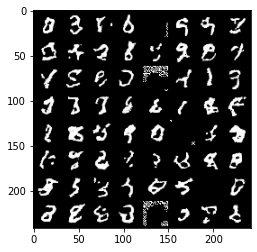

Epoch: [93/500]) Negative Log-Likelihood: -3656.14501953125
Epoch: [94/500]) Batch: [1/75] Negative Log-Likelihood: -3676.265869140625


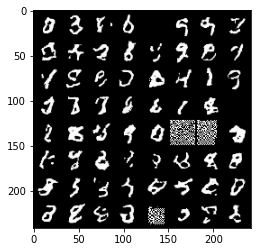

Epoch: [94/500]) Batch: [2/75] Negative Log-Likelihood: -3679.540771484375
Epoch: [94/500]) Batch: [3/75] Negative Log-Likelihood: -3679.820556640625
Epoch: [94/500]) Batch: [4/75] Negative Log-Likelihood: -3655.373779296875
Epoch: [94/500]) Batch: [5/75] Negative Log-Likelihood: -3671.405029296875
Epoch: [94/500]) Batch: [6/75] Negative Log-Likelihood: -3677.783447265625
Epoch: [94/500]) Batch: [7/75] Negative Log-Likelihood: -3665.46826171875
Epoch: [94/500]) Batch: [8/75] Negative Log-Likelihood: -3680.51220703125
Epoch: [94/500]) Batch: [9/75] Negative Log-Likelihood: -3688.2744140625
Epoch: [94/500]) Batch: [10/75] Negative Log-Likelihood: -3684.9599609375
Epoch: [94/500]) Batch: [11/75] Negative Log-Likelihood: -3679.7880859375
Epoch: [94/500]) Batch: [12/75] Negative Log-Likelihood: -3675.5673828125
Epoch: [94/500]) Batch: [13/75] Negative Log-Likelihood: -3672.9794921875
Epoch: [94/500]) Batch: [14/75] Negative Log-Likelihood: -3684.336181640625
Epoch: [94/500]) Batch: [15/75] 

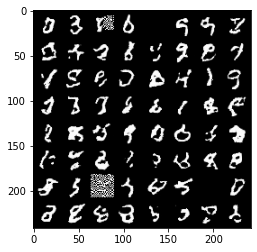

Epoch: [94/500]) Negative Log-Likelihood: -3654.67138671875
Epoch: [95/500]) Batch: [1/75] Negative Log-Likelihood: -3675.232421875


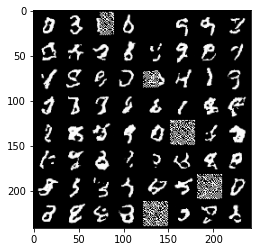

Epoch: [95/500]) Batch: [2/75] Negative Log-Likelihood: -3680.59765625
Epoch: [95/500]) Batch: [3/75] Negative Log-Likelihood: -3686.01513671875
Epoch: [95/500]) Batch: [4/75] Negative Log-Likelihood: -3671.977783203125
Epoch: [95/500]) Batch: [5/75] Negative Log-Likelihood: -3682.65625
Epoch: [95/500]) Batch: [6/75] Negative Log-Likelihood: -3679.94873046875
Epoch: [95/500]) Batch: [7/75] Negative Log-Likelihood: -3673.264404296875
Epoch: [95/500]) Batch: [8/75] Negative Log-Likelihood: -3681.582763671875
Epoch: [95/500]) Batch: [9/75] Negative Log-Likelihood: -3689.013671875
Epoch: [95/500]) Batch: [10/75] Negative Log-Likelihood: -3679.692138671875
Epoch: [95/500]) Batch: [11/75] Negative Log-Likelihood: -3662.563720703125
Epoch: [95/500]) Batch: [12/75] Negative Log-Likelihood: -3670.068603515625
Epoch: [95/500]) Batch: [13/75] Negative Log-Likelihood: -3672.389404296875
Epoch: [95/500]) Batch: [14/75] Negative Log-Likelihood: -3675.7412109375
Epoch: [95/500]) Batch: [15/75] Negati

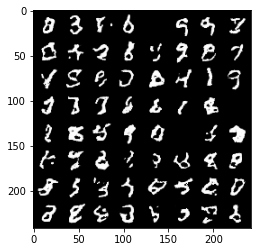

Epoch: [95/500]) Negative Log-Likelihood: -3659.016845703125
Epoch: [96/500]) Batch: [1/75] Negative Log-Likelihood: -3676.778076171875


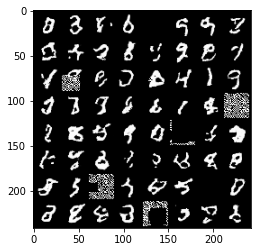

Epoch: [96/500]) Batch: [2/75] Negative Log-Likelihood: -3681.828369140625
Epoch: [96/500]) Batch: [3/75] Negative Log-Likelihood: -3682.5888671875
Epoch: [96/500]) Batch: [4/75] Negative Log-Likelihood: -3665.429931640625
Epoch: [96/500]) Batch: [5/75] Negative Log-Likelihood: -3681.4892578125
Epoch: [96/500]) Batch: [6/75] Negative Log-Likelihood: -3676.934814453125
Epoch: [96/500]) Batch: [7/75] Negative Log-Likelihood: -3668.849609375
Epoch: [96/500]) Batch: [8/75] Negative Log-Likelihood: -3682.4716796875
Epoch: [96/500]) Batch: [9/75] Negative Log-Likelihood: -3693.901123046875
Epoch: [96/500]) Batch: [10/75] Negative Log-Likelihood: -3687.9384765625
Epoch: [96/500]) Batch: [11/75] Negative Log-Likelihood: -3688.0556640625
Epoch: [96/500]) Batch: [12/75] Negative Log-Likelihood: -3688.990478515625
Epoch: [96/500]) Batch: [13/75] Negative Log-Likelihood: -3674.041748046875
Epoch: [96/500]) Batch: [14/75] Negative Log-Likelihood: -3675.83251953125
Epoch: [96/500]) Batch: [15/75] Ne

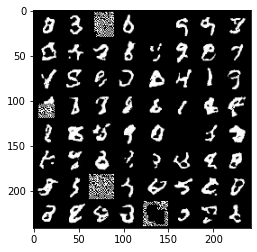

Epoch: [96/500]) Negative Log-Likelihood: -3646.903076171875
Epoch: [97/500]) Batch: [1/75] Negative Log-Likelihood: -3677.459228515625


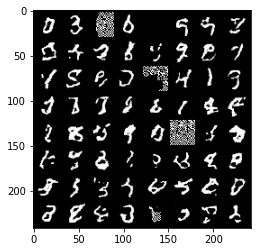

Epoch: [97/500]) Batch: [2/75] Negative Log-Likelihood: -3671.248779296875
Epoch: [97/500]) Batch: [3/75] Negative Log-Likelihood: -3671.144287109375
Epoch: [97/500]) Batch: [4/75] Negative Log-Likelihood: -3660.30810546875
Epoch: [97/500]) Batch: [5/75] Negative Log-Likelihood: -3673.611083984375
Epoch: [97/500]) Batch: [6/75] Negative Log-Likelihood: -3675.25048828125
Epoch: [97/500]) Batch: [7/75] Negative Log-Likelihood: -3664.72607421875
Epoch: [97/500]) Batch: [8/75] Negative Log-Likelihood: -3681.854248046875
Epoch: [97/500]) Batch: [9/75] Negative Log-Likelihood: -3689.666259765625
Epoch: [97/500]) Batch: [10/75] Negative Log-Likelihood: -3684.8203125
Epoch: [97/500]) Batch: [11/75] Negative Log-Likelihood: -3683.433349609375
Epoch: [97/500]) Batch: [12/75] Negative Log-Likelihood: -3682.4814453125
Epoch: [97/500]) Batch: [13/75] Negative Log-Likelihood: -3680.69677734375
Epoch: [97/500]) Batch: [14/75] Negative Log-Likelihood: -3678.051513671875
Epoch: [97/500]) Batch: [15/75]

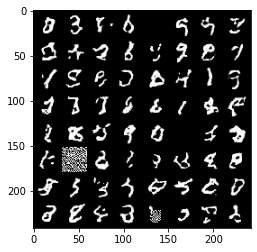

Epoch: [97/500]) Negative Log-Likelihood: -3654.6572265625
Epoch: [98/500]) Batch: [1/75] Negative Log-Likelihood: -3681.373046875


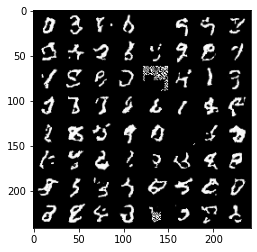

Epoch: [98/500]) Batch: [2/75] Negative Log-Likelihood: -3669.7412109375
Epoch: [98/500]) Batch: [3/75] Negative Log-Likelihood: -3660.644287109375
Epoch: [98/500]) Batch: [4/75] Negative Log-Likelihood: -3657.93115234375
Epoch: [98/500]) Batch: [5/75] Negative Log-Likelihood: -3672.776123046875
Epoch: [98/500]) Batch: [6/75] Negative Log-Likelihood: -3661.596435546875
Epoch: [98/500]) Batch: [7/75] Negative Log-Likelihood: -3643.25244140625
Epoch: [98/500]) Batch: [8/75] Negative Log-Likelihood: -3659.90625
Epoch: [98/500]) Batch: [9/75] Negative Log-Likelihood: -3679.625
Epoch: [98/500]) Batch: [10/75] Negative Log-Likelihood: -3679.135009765625
Epoch: [98/500]) Batch: [11/75] Negative Log-Likelihood: -3669.468017578125
Epoch: [98/500]) Batch: [12/75] Negative Log-Likelihood: -3674.106689453125
Epoch: [98/500]) Batch: [13/75] Negative Log-Likelihood: -3669.5537109375
Epoch: [98/500]) Batch: [14/75] Negative Log-Likelihood: -3673.76123046875
Epoch: [98/500]) Batch: [15/75] Negative Lo

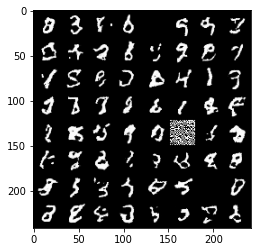

Epoch: [98/500]) Negative Log-Likelihood: -3655.06396484375
Epoch: [99/500]) Batch: [1/75] Negative Log-Likelihood: -3674.8818359375


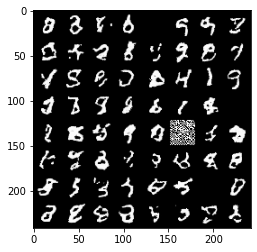

Epoch: [99/500]) Batch: [2/75] Negative Log-Likelihood: -3669.499267578125
Epoch: [99/500]) Batch: [3/75] Negative Log-Likelihood: -3681.123291015625
Epoch: [99/500]) Batch: [4/75] Negative Log-Likelihood: -3671.359375
Epoch: [99/500]) Batch: [5/75] Negative Log-Likelihood: -3680.405517578125
Epoch: [99/500]) Batch: [6/75] Negative Log-Likelihood: -3677.979248046875
Epoch: [99/500]) Batch: [7/75] Negative Log-Likelihood: -3673.677490234375
Epoch: [99/500]) Batch: [8/75] Negative Log-Likelihood: -3679.0556640625
Epoch: [99/500]) Batch: [9/75] Negative Log-Likelihood: -3685.405029296875
Epoch: [99/500]) Batch: [10/75] Negative Log-Likelihood: -3677.818359375
Epoch: [99/500]) Batch: [11/75] Negative Log-Likelihood: -3678.118408203125
Epoch: [99/500]) Batch: [12/75] Negative Log-Likelihood: -3678.052490234375
Epoch: [99/500]) Batch: [13/75] Negative Log-Likelihood: -3676.3056640625
Epoch: [99/500]) Batch: [14/75] Negative Log-Likelihood: -3679.093017578125
Epoch: [99/500]) Batch: [15/75] N

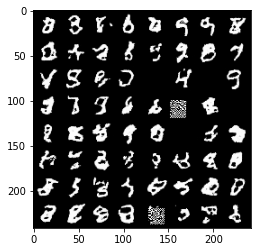

Epoch: [99/500]) Negative Log-Likelihood: -3647.55126953125
Epoch: [100/500]) Batch: [1/75] Negative Log-Likelihood: -3671.9521484375


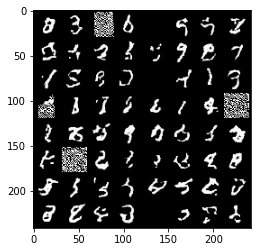

Epoch: [100/500]) Batch: [2/75] Negative Log-Likelihood: -3674.9267578125
Epoch: [100/500]) Batch: [3/75] Negative Log-Likelihood: -3683.832763671875
Epoch: [100/500]) Batch: [4/75] Negative Log-Likelihood: -3667.3017578125
Epoch: [100/500]) Batch: [5/75] Negative Log-Likelihood: -3676.3125
Epoch: [100/500]) Batch: [6/75] Negative Log-Likelihood: -3675.3349609375
Epoch: [100/500]) Batch: [7/75] Negative Log-Likelihood: -3664.5224609375
Epoch: [100/500]) Batch: [8/75] Negative Log-Likelihood: -3676.256591796875
Epoch: [100/500]) Batch: [9/75] Negative Log-Likelihood: -3686.33642578125
Epoch: [100/500]) Batch: [10/75] Negative Log-Likelihood: -3685.310302734375
Epoch: [100/500]) Batch: [11/75] Negative Log-Likelihood: -3673.293701171875
Epoch: [100/500]) Batch: [12/75] Negative Log-Likelihood: -3672.2451171875
Epoch: [100/500]) Batch: [13/75] Negative Log-Likelihood: -3671.367431640625
Epoch: [100/500]) Batch: [14/75] Negative Log-Likelihood: -3680.500244140625
Epoch: [100/500]) Batch: [

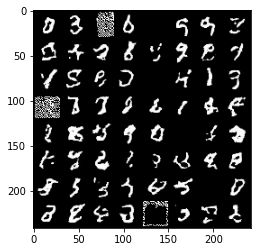

Epoch: [100/500]) Negative Log-Likelihood: -3656.7880859375
Epoch: [101/500]) Batch: [1/75] Negative Log-Likelihood: -3680.20263671875


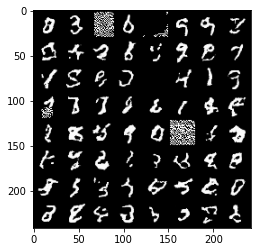

Epoch: [101/500]) Batch: [2/75] Negative Log-Likelihood: -3681.4091796875
Epoch: [101/500]) Batch: [3/75] Negative Log-Likelihood: -3688.60546875
Epoch: [101/500]) Batch: [4/75] Negative Log-Likelihood: -3667.58203125
Epoch: [101/500]) Batch: [5/75] Negative Log-Likelihood: -3682.357177734375
Epoch: [101/500]) Batch: [6/75] Negative Log-Likelihood: -3679.74169921875
Epoch: [101/500]) Batch: [7/75] Negative Log-Likelihood: -3667.9658203125
Epoch: [101/500]) Batch: [8/75] Negative Log-Likelihood: -3685.48876953125
Epoch: [101/500]) Batch: [9/75] Negative Log-Likelihood: -3695.09619140625
Epoch: [101/500]) Batch: [10/75] Negative Log-Likelihood: -3692.4873046875
Epoch: [101/500]) Batch: [11/75] Negative Log-Likelihood: -3691.213623046875
Epoch: [101/500]) Batch: [12/75] Negative Log-Likelihood: -3682.91015625
Epoch: [101/500]) Batch: [13/75] Negative Log-Likelihood: -3677.2744140625
Epoch: [101/500]) Batch: [14/75] Negative Log-Likelihood: -3678.44482421875
Epoch: [101/500]) Batch: [15/75

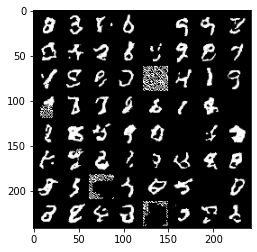

Epoch: [101/500]) Negative Log-Likelihood: -3653.69970703125
Epoch: [102/500]) Batch: [1/75] Negative Log-Likelihood: -3667.622314453125


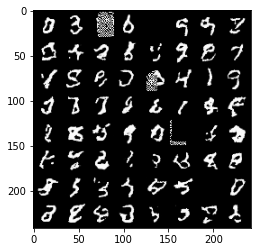

Epoch: [102/500]) Batch: [2/75] Negative Log-Likelihood: -3677.83837890625
Epoch: [102/500]) Batch: [3/75] Negative Log-Likelihood: -3677.154052734375
Epoch: [102/500]) Batch: [4/75] Negative Log-Likelihood: -3657.4560546875
Epoch: [102/500]) Batch: [5/75] Negative Log-Likelihood: -3675.7158203125
Epoch: [102/500]) Batch: [6/75] Negative Log-Likelihood: -3664.1015625
Epoch: [102/500]) Batch: [7/75] Negative Log-Likelihood: -3666.3720703125
Epoch: [102/500]) Batch: [8/75] Negative Log-Likelihood: -3671.944580078125
Epoch: [102/500]) Batch: [9/75] Negative Log-Likelihood: -3684.019287109375
Epoch: [102/500]) Batch: [10/75] Negative Log-Likelihood: -3681.248291015625
Epoch: [102/500]) Batch: [11/75] Negative Log-Likelihood: -3668.0224609375
Epoch: [102/500]) Batch: [12/75] Negative Log-Likelihood: -3678.251220703125
Epoch: [102/500]) Batch: [13/75] Negative Log-Likelihood: -3671.5771484375
Epoch: [102/500]) Batch: [14/75] Negative Log-Likelihood: -3658.1416015625
Epoch: [102/500]) Batch: 

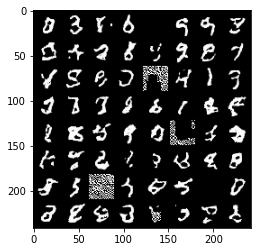

Epoch: [102/500]) Negative Log-Likelihood: -3648.5390625
Epoch: [103/500]) Batch: [1/75] Negative Log-Likelihood: -3677.33056640625


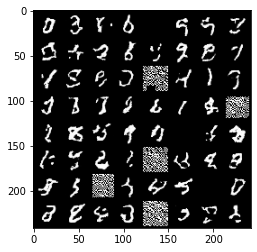

Epoch: [103/500]) Batch: [2/75] Negative Log-Likelihood: -3679.349853515625
Epoch: [103/500]) Batch: [3/75] Negative Log-Likelihood: -3678.34375
Epoch: [103/500]) Batch: [4/75] Negative Log-Likelihood: -3672.42431640625
Epoch: [103/500]) Batch: [5/75] Negative Log-Likelihood: -3678.438720703125
Epoch: [103/500]) Batch: [6/75] Negative Log-Likelihood: -3680.2529296875
Epoch: [103/500]) Batch: [7/75] Negative Log-Likelihood: -3669.98876953125
Epoch: [103/500]) Batch: [8/75] Negative Log-Likelihood: -3672.34423828125
Epoch: [103/500]) Batch: [9/75] Negative Log-Likelihood: -3688.1650390625
Epoch: [103/500]) Batch: [10/75] Negative Log-Likelihood: -3674.30126953125
Epoch: [103/500]) Batch: [11/75] Negative Log-Likelihood: -3670.568115234375
Epoch: [103/500]) Batch: [12/75] Negative Log-Likelihood: -3676.441162109375
Epoch: [103/500]) Batch: [13/75] Negative Log-Likelihood: -3677.388671875
Epoch: [103/500]) Batch: [14/75] Negative Log-Likelihood: -3676.2451171875
Epoch: [103/500]) Batch: [1

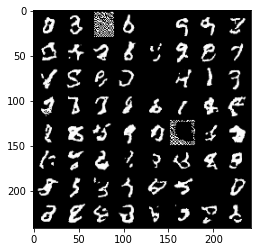

Epoch: [103/500]) Negative Log-Likelihood: -3662.035888671875
Epoch: [104/500]) Batch: [1/75] Negative Log-Likelihood: -3684.92919921875


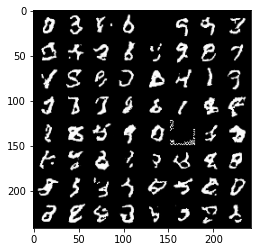

Epoch: [104/500]) Batch: [2/75] Negative Log-Likelihood: -3686.984619140625
Epoch: [104/500]) Batch: [3/75] Negative Log-Likelihood: -3690.638671875
Epoch: [104/500]) Batch: [4/75] Negative Log-Likelihood: -3673.09033203125
Epoch: [104/500]) Batch: [5/75] Negative Log-Likelihood: -3687.05615234375
Epoch: [104/500]) Batch: [6/75] Negative Log-Likelihood: -3687.811279296875
Epoch: [104/500]) Batch: [7/75] Negative Log-Likelihood: -3679.546142578125
Epoch: [104/500]) Batch: [8/75] Negative Log-Likelihood: -3687.414306640625
Epoch: [104/500]) Batch: [9/75] Negative Log-Likelihood: -3693.8369140625
Epoch: [104/500]) Batch: [10/75] Negative Log-Likelihood: -3691.4013671875
Epoch: [104/500]) Batch: [11/75] Negative Log-Likelihood: -3688.535888671875
Epoch: [104/500]) Batch: [12/75] Negative Log-Likelihood: -3687.3369140625
Epoch: [104/500]) Batch: [13/75] Negative Log-Likelihood: -3686.395751953125
Epoch: [104/500]) Batch: [14/75] Negative Log-Likelihood: -3668.92529296875
Epoch: [104/500]) B

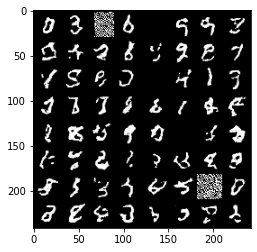

Epoch: [104/500]) Negative Log-Likelihood: -3660.716064453125
Epoch: [105/500]) Batch: [1/75] Negative Log-Likelihood: -3675.140625


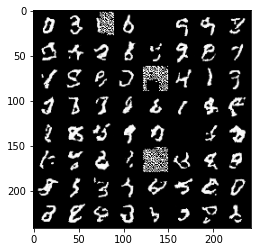

Epoch: [105/500]) Batch: [2/75] Negative Log-Likelihood: -3677.474853515625
Epoch: [105/500]) Batch: [3/75] Negative Log-Likelihood: -3691.458740234375
Epoch: [105/500]) Batch: [4/75] Negative Log-Likelihood: -3672.952392578125
Epoch: [105/500]) Batch: [5/75] Negative Log-Likelihood: -3681.340576171875
Epoch: [105/500]) Batch: [6/75] Negative Log-Likelihood: -3684.59765625
Epoch: [105/500]) Batch: [7/75] Negative Log-Likelihood: -3666.32861328125
Epoch: [105/500]) Batch: [8/75] Negative Log-Likelihood: -3660.93310546875
Epoch: [105/500]) Batch: [9/75] Negative Log-Likelihood: -3681.62890625
Epoch: [105/500]) Batch: [10/75] Negative Log-Likelihood: -3677.84326171875
Epoch: [105/500]) Batch: [11/75] Negative Log-Likelihood: -3671.114990234375
Epoch: [105/500]) Batch: [12/75] Negative Log-Likelihood: -3676.950439453125
Epoch: [105/500]) Batch: [13/75] Negative Log-Likelihood: -3664.882080078125
Epoch: [105/500]) Batch: [14/75] Negative Log-Likelihood: -3666.7900390625
Epoch: [105/500]) Ba

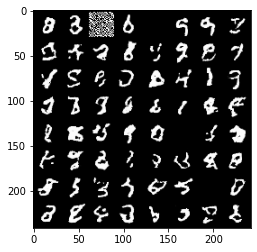

Epoch: [105/500]) Negative Log-Likelihood: -3660.056884765625
Epoch: [106/500]) Batch: [1/75] Negative Log-Likelihood: -3682.4462890625


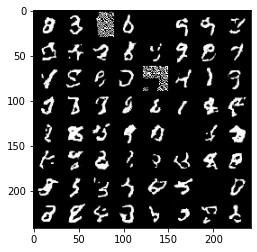

Epoch: [106/500]) Batch: [2/75] Negative Log-Likelihood: -3683.52685546875
Epoch: [106/500]) Batch: [3/75] Negative Log-Likelihood: -3689.911865234375
Epoch: [106/500]) Batch: [4/75] Negative Log-Likelihood: -3670.391845703125
Epoch: [106/500]) Batch: [5/75] Negative Log-Likelihood: -3680.610595703125
Epoch: [106/500]) Batch: [6/75] Negative Log-Likelihood: -3675.133056640625
Epoch: [106/500]) Batch: [7/75] Negative Log-Likelihood: -3655.850341796875
Epoch: [106/500]) Batch: [8/75] Negative Log-Likelihood: -3673.067626953125
Epoch: [106/500]) Batch: [9/75] Negative Log-Likelihood: -3692.54931640625
Epoch: [106/500]) Batch: [10/75] Negative Log-Likelihood: -3683.867431640625
Epoch: [106/500]) Batch: [11/75] Negative Log-Likelihood: -3683.12646484375
Epoch: [106/500]) Batch: [12/75] Negative Log-Likelihood: -3687.36865234375
Epoch: [106/500]) Batch: [13/75] Negative Log-Likelihood: -3680.50927734375
Epoch: [106/500]) Batch: [14/75] Negative Log-Likelihood: -3687.0361328125
Epoch: [106/50

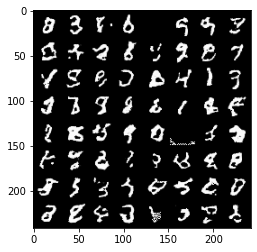

Epoch: [106/500]) Negative Log-Likelihood: -3634.271484375
Epoch: [107/500]) Batch: [1/75] Negative Log-Likelihood: -3666.341796875


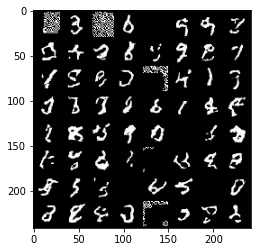

Epoch: [107/500]) Batch: [2/75] Negative Log-Likelihood: -3670.838623046875
Epoch: [107/500]) Batch: [3/75] Negative Log-Likelihood: -3677.295654296875
Epoch: [107/500]) Batch: [4/75] Negative Log-Likelihood: -3659.731201171875
Epoch: [107/500]) Batch: [5/75] Negative Log-Likelihood: -3673.6806640625
Epoch: [107/500]) Batch: [6/75] Negative Log-Likelihood: -3677.5810546875
Epoch: [107/500]) Batch: [7/75] Negative Log-Likelihood: -3664.376220703125
Epoch: [107/500]) Batch: [8/75] Negative Log-Likelihood: -3675.786376953125
Epoch: [107/500]) Batch: [9/75] Negative Log-Likelihood: -3685.56689453125
Epoch: [107/500]) Batch: [10/75] Negative Log-Likelihood: -3675.62158203125
Epoch: [107/500]) Batch: [11/75] Negative Log-Likelihood: -3670.238037109375
Epoch: [107/500]) Batch: [12/75] Negative Log-Likelihood: -3677.8154296875
Epoch: [107/500]) Batch: [13/75] Negative Log-Likelihood: -3674.365966796875
Epoch: [107/500]) Batch: [14/75] Negative Log-Likelihood: -3683.133056640625
Epoch: [107/500

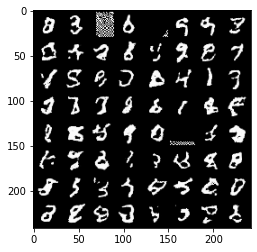

Epoch: [107/500]) Negative Log-Likelihood: -3650.81396484375
Epoch: [108/500]) Batch: [1/75] Negative Log-Likelihood: -3677.2314453125


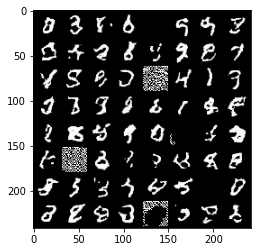

Epoch: [108/500]) Batch: [2/75] Negative Log-Likelihood: -3675.69970703125
Epoch: [108/500]) Batch: [3/75] Negative Log-Likelihood: -3681.537109375
Epoch: [108/500]) Batch: [4/75] Negative Log-Likelihood: -3672.517333984375
Epoch: [108/500]) Batch: [5/75] Negative Log-Likelihood: -3681.6455078125
Epoch: [108/500]) Batch: [6/75] Negative Log-Likelihood: -3683.94873046875
Epoch: [108/500]) Batch: [7/75] Negative Log-Likelihood: -3668.579833984375
Epoch: [108/500]) Batch: [8/75] Negative Log-Likelihood: -3683.637451171875
Epoch: [108/500]) Batch: [9/75] Negative Log-Likelihood: -3686.309814453125
Epoch: [108/500]) Batch: [10/75] Negative Log-Likelihood: -3674.170654296875
Epoch: [108/500]) Batch: [11/75] Negative Log-Likelihood: -3676.822021484375
Epoch: [108/500]) Batch: [12/75] Negative Log-Likelihood: -3677.970458984375
Epoch: [108/500]) Batch: [13/75] Negative Log-Likelihood: -3670.747314453125
Epoch: [108/500]) Batch: [14/75] Negative Log-Likelihood: -3671.146240234375
Epoch: [108/50

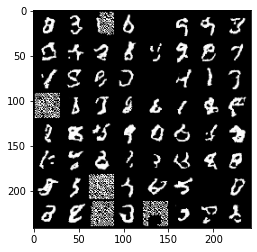

Epoch: [108/500]) Negative Log-Likelihood: -3659.023681640625
Epoch: [109/500]) Batch: [1/75] Negative Log-Likelihood: -3672.02490234375


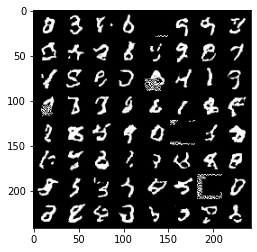

Epoch: [109/500]) Batch: [2/75] Negative Log-Likelihood: -3680.833251953125
Epoch: [109/500]) Batch: [3/75] Negative Log-Likelihood: -3685.816162109375
Epoch: [109/500]) Batch: [4/75] Negative Log-Likelihood: -3671.501708984375
Epoch: [109/500]) Batch: [5/75] Negative Log-Likelihood: -3685.627685546875
Epoch: [109/500]) Batch: [6/75] Negative Log-Likelihood: -3681.956787109375
Epoch: [109/500]) Batch: [7/75] Negative Log-Likelihood: -3675.0419921875
Epoch: [109/500]) Batch: [8/75] Negative Log-Likelihood: -3685.933349609375
Epoch: [109/500]) Batch: [9/75] Negative Log-Likelihood: -3697.68798828125
Epoch: [109/500]) Batch: [10/75] Negative Log-Likelihood: -3688.0986328125
Epoch: [109/500]) Batch: [11/75] Negative Log-Likelihood: -3688.704345703125
Epoch: [109/500]) Batch: [12/75] Negative Log-Likelihood: -3679.052001953125
Epoch: [109/500]) Batch: [13/75] Negative Log-Likelihood: -3654.45703125
Epoch: [109/500]) Batch: [14/75] Negative Log-Likelihood: -3665.227783203125
Epoch: [109/500]

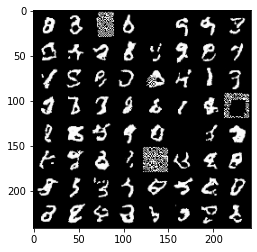

Epoch: [109/500]) Negative Log-Likelihood: -3652.779296875
Epoch: [110/500]) Batch: [1/75] Negative Log-Likelihood: -3677.86376953125


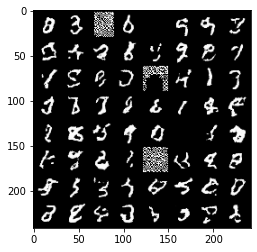

Epoch: [110/500]) Batch: [2/75] Negative Log-Likelihood: -3672.890625
Epoch: [110/500]) Batch: [3/75] Negative Log-Likelihood: -3679.34375
Epoch: [110/500]) Batch: [4/75] Negative Log-Likelihood: -3666.5517578125
Epoch: [110/500]) Batch: [5/75] Negative Log-Likelihood: -3676.82763671875
Epoch: [110/500]) Batch: [6/75] Negative Log-Likelihood: -3681.63330078125
Epoch: [110/500]) Batch: [7/75] Negative Log-Likelihood: -3670.076904296875
Epoch: [110/500]) Batch: [8/75] Negative Log-Likelihood: -3677.103759765625
Epoch: [110/500]) Batch: [9/75] Negative Log-Likelihood: -3687.2880859375
Epoch: [110/500]) Batch: [10/75] Negative Log-Likelihood: -3678.719970703125
Epoch: [110/500]) Batch: [11/75] Negative Log-Likelihood: -3674.75
Epoch: [110/500]) Batch: [12/75] Negative Log-Likelihood: -3678.34375
Epoch: [110/500]) Batch: [13/75] Negative Log-Likelihood: -3676.137451171875
Epoch: [110/500]) Batch: [14/75] Negative Log-Likelihood: -3677.072998046875
Epoch: [110/500]) Batch: [15/75] Negative L

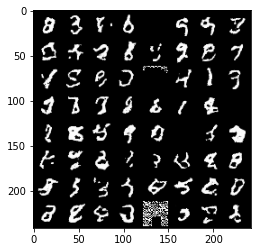

Epoch: [110/500]) Negative Log-Likelihood: -3658.523681640625
Epoch: [111/500]) Batch: [1/75] Negative Log-Likelihood: -3679.0859375


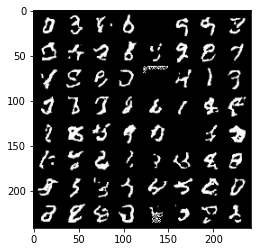

Epoch: [111/500]) Batch: [2/75] Negative Log-Likelihood: -3675.106689453125
Epoch: [111/500]) Batch: [3/75] Negative Log-Likelihood: -3688.903076171875
Epoch: [111/500]) Batch: [4/75] Negative Log-Likelihood: -3667.716796875
Epoch: [111/500]) Batch: [5/75] Negative Log-Likelihood: -3685.137451171875
Epoch: [111/500]) Batch: [6/75] Negative Log-Likelihood: -3680.513427734375
Epoch: [111/500]) Batch: [7/75] Negative Log-Likelihood: -3663.54296875
Epoch: [111/500]) Batch: [8/75] Negative Log-Likelihood: -3683.181396484375
Epoch: [111/500]) Batch: [9/75] Negative Log-Likelihood: -3681.7431640625
Epoch: [111/500]) Batch: [10/75] Negative Log-Likelihood: -3680.796142578125
Epoch: [111/500]) Batch: [11/75] Negative Log-Likelihood: -3683.786865234375
Epoch: [111/500]) Batch: [12/75] Negative Log-Likelihood: -3682.4814453125
Epoch: [111/500]) Batch: [13/75] Negative Log-Likelihood: -3675.014892578125
Epoch: [111/500]) Batch: [14/75] Negative Log-Likelihood: -3683.8525390625
Epoch: [111/500]) Ba

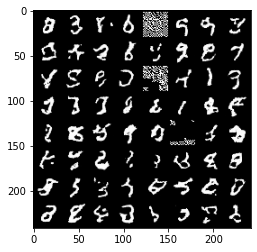

Epoch: [111/500]) Negative Log-Likelihood: -3664.936767578125
Epoch: [112/500]) Batch: [1/75] Negative Log-Likelihood: -3672.106201171875


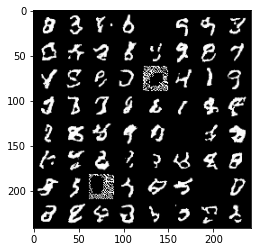

Epoch: [112/500]) Batch: [2/75] Negative Log-Likelihood: -3667.2861328125
Epoch: [112/500]) Batch: [3/75] Negative Log-Likelihood: -3678.146484375
Epoch: [112/500]) Batch: [4/75] Negative Log-Likelihood: -3665.8505859375
Epoch: [112/500]) Batch: [5/75] Negative Log-Likelihood: -3683.2099609375
Epoch: [112/500]) Batch: [6/75] Negative Log-Likelihood: -3676.287353515625
Epoch: [112/500]) Batch: [7/75] Negative Log-Likelihood: -3657.442626953125
Epoch: [112/500]) Batch: [8/75] Negative Log-Likelihood: -3672.0556640625
Epoch: [112/500]) Batch: [9/75] Negative Log-Likelihood: -3684.97314453125
Epoch: [112/500]) Batch: [10/75] Negative Log-Likelihood: -3677.272705078125
Epoch: [112/500]) Batch: [11/75] Negative Log-Likelihood: -3674.2841796875
Epoch: [112/500]) Batch: [12/75] Negative Log-Likelihood: -3684.037353515625
Epoch: [112/500]) Batch: [13/75] Negative Log-Likelihood: -3673.94775390625
Epoch: [112/500]) Batch: [14/75] Negative Log-Likelihood: -3686.5205078125
Epoch: [112/500]) Batch:

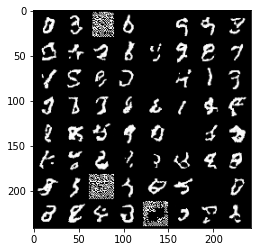

Epoch: [112/500]) Negative Log-Likelihood: -3654.942626953125
Epoch: [113/500]) Batch: [1/75] Negative Log-Likelihood: -3681.322509765625


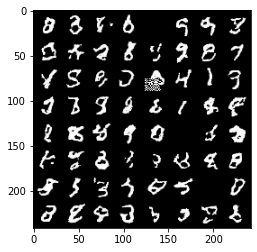

Epoch: [113/500]) Batch: [2/75] Negative Log-Likelihood: -3681.16748046875
Epoch: [113/500]) Batch: [3/75] Negative Log-Likelihood: -3693.35986328125
Epoch: [113/500]) Batch: [4/75] Negative Log-Likelihood: -3670.954833984375
Epoch: [113/500]) Batch: [5/75] Negative Log-Likelihood: -3680.695556640625
Epoch: [113/500]) Batch: [6/75] Negative Log-Likelihood: -3683.100830078125
Epoch: [113/500]) Batch: [7/75] Negative Log-Likelihood: -3671.760009765625
Epoch: [113/500]) Batch: [8/75] Negative Log-Likelihood: -3685.22265625
Epoch: [113/500]) Batch: [9/75] Negative Log-Likelihood: -3698.831787109375
Epoch: [113/500]) Batch: [10/75] Negative Log-Likelihood: -3690.927978515625
Epoch: [113/500]) Batch: [11/75] Negative Log-Likelihood: -3688.1669921875
Epoch: [113/500]) Batch: [12/75] Negative Log-Likelihood: -3688.005615234375
Epoch: [113/500]) Batch: [13/75] Negative Log-Likelihood: -3674.8310546875
Epoch: [113/500]) Batch: [14/75] Negative Log-Likelihood: -3684.170654296875
Epoch: [113/500])

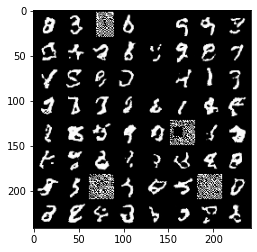

Epoch: [113/500]) Negative Log-Likelihood: -3664.36376953125
Epoch: [114/500]) Batch: [1/75] Negative Log-Likelihood: -3686.326171875


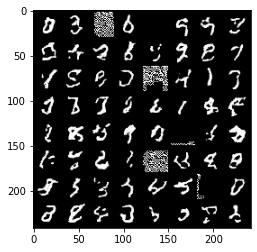

Epoch: [114/500]) Batch: [2/75] Negative Log-Likelihood: -3689.076171875
Epoch: [114/500]) Batch: [3/75] Negative Log-Likelihood: -3695.920654296875
Epoch: [114/500]) Batch: [4/75] Negative Log-Likelihood: -3675.27294921875
Epoch: [114/500]) Batch: [5/75] Negative Log-Likelihood: -3682.744384765625
Epoch: [114/500]) Batch: [6/75] Negative Log-Likelihood: -3688.40625
Epoch: [114/500]) Batch: [7/75] Negative Log-Likelihood: -3671.748291015625
Epoch: [114/500]) Batch: [8/75] Negative Log-Likelihood: -3684.731201171875
Epoch: [114/500]) Batch: [9/75] Negative Log-Likelihood: -3687.100341796875
Epoch: [114/500]) Batch: [10/75] Negative Log-Likelihood: -3688.8447265625
Epoch: [114/500]) Batch: [11/75] Negative Log-Likelihood: -3682.72998046875
Epoch: [114/500]) Batch: [12/75] Negative Log-Likelihood: -3678.1337890625
Epoch: [114/500]) Batch: [13/75] Negative Log-Likelihood: -3678.641845703125
Epoch: [114/500]) Batch: [14/75] Negative Log-Likelihood: -3685.354248046875
Epoch: [114/500]) Batch

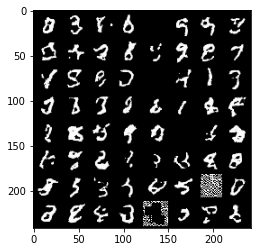

Epoch: [114/500]) Negative Log-Likelihood: -3658.657958984375
Epoch: [115/500]) Batch: [1/75] Negative Log-Likelihood: -3680.956787109375


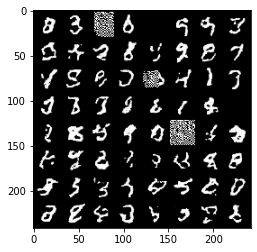

Epoch: [115/500]) Batch: [2/75] Negative Log-Likelihood: -3677.455322265625
Epoch: [115/500]) Batch: [3/75] Negative Log-Likelihood: -3683.931884765625
Epoch: [115/500]) Batch: [4/75] Negative Log-Likelihood: -3674.35107421875
Epoch: [115/500]) Batch: [5/75] Negative Log-Likelihood: -3682.7060546875
Epoch: [115/500]) Batch: [6/75] Negative Log-Likelihood: -3683.079833984375
Epoch: [115/500]) Batch: [7/75] Negative Log-Likelihood: -3672.1123046875
Epoch: [115/500]) Batch: [8/75] Negative Log-Likelihood: -3675.670654296875
Epoch: [115/500]) Batch: [9/75] Negative Log-Likelihood: -3683.896240234375
Epoch: [115/500]) Batch: [10/75] Negative Log-Likelihood: -3680.7177734375
Epoch: [115/500]) Batch: [11/75] Negative Log-Likelihood: -3675.754638671875
Epoch: [115/500]) Batch: [12/75] Negative Log-Likelihood: -3681.822509765625
Epoch: [115/500]) Batch: [13/75] Negative Log-Likelihood: -3678.2763671875
Epoch: [115/500]) Batch: [14/75] Negative Log-Likelihood: -3676.521728515625
Epoch: [115/500]

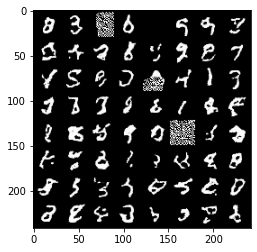

Epoch: [115/500]) Negative Log-Likelihood: -3661.08740234375
Epoch: [116/500]) Batch: [1/75] Negative Log-Likelihood: -3688.306884765625


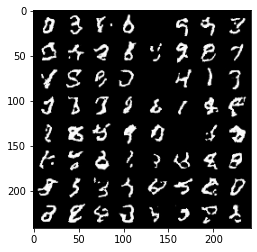

Epoch: [116/500]) Batch: [2/75] Negative Log-Likelihood: -3688.364501953125
Epoch: [116/500]) Batch: [3/75] Negative Log-Likelihood: -3694.963134765625
Epoch: [116/500]) Batch: [4/75] Negative Log-Likelihood: -3675.39453125
Epoch: [116/500]) Batch: [5/75] Negative Log-Likelihood: -3684.770751953125
Epoch: [116/500]) Batch: [6/75] Negative Log-Likelihood: -3686.62939453125
Epoch: [116/500]) Batch: [7/75] Negative Log-Likelihood: -3676.545166015625
Epoch: [116/500]) Batch: [8/75] Negative Log-Likelihood: -3674.071533203125
Epoch: [116/500]) Batch: [9/75] Negative Log-Likelihood: -3681.434814453125
Epoch: [116/500]) Batch: [10/75] Negative Log-Likelihood: -3681.8896484375
Epoch: [116/500]) Batch: [11/75] Negative Log-Likelihood: -3683.859619140625
Epoch: [116/500]) Batch: [12/75] Negative Log-Likelihood: -3680.296142578125
Epoch: [116/500]) Batch: [13/75] Negative Log-Likelihood: -3678.1455078125
Epoch: [116/500]) Batch: [14/75] Negative Log-Likelihood: -3682.0595703125
Epoch: [116/500]) 

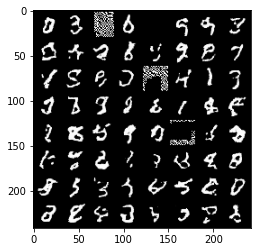

Epoch: [116/500]) Negative Log-Likelihood: -3669.96826171875
Epoch: [117/500]) Batch: [1/75] Negative Log-Likelihood: -3680.583740234375


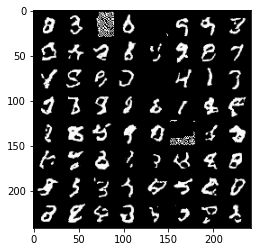

Epoch: [117/500]) Batch: [2/75] Negative Log-Likelihood: -3683.30810546875
Epoch: [117/500]) Batch: [3/75] Negative Log-Likelihood: -3690.9443359375
Epoch: [117/500]) Batch: [4/75] Negative Log-Likelihood: -3674.218017578125
Epoch: [117/500]) Batch: [5/75] Negative Log-Likelihood: -3686.83740234375
Epoch: [117/500]) Batch: [6/75] Negative Log-Likelihood: -3685.780517578125
Epoch: [117/500]) Batch: [7/75] Negative Log-Likelihood: -3677.49609375
Epoch: [117/500]) Batch: [8/75] Negative Log-Likelihood: -3687.7529296875
Epoch: [117/500]) Batch: [9/75] Negative Log-Likelihood: -3697.4267578125
Epoch: [117/500]) Batch: [10/75] Negative Log-Likelihood: -3695.713134765625
Epoch: [117/500]) Batch: [11/75] Negative Log-Likelihood: -3692.17578125
Epoch: [117/500]) Batch: [12/75] Negative Log-Likelihood: -3692.796875
Epoch: [117/500]) Batch: [13/75] Negative Log-Likelihood: -3688.11181640625
Epoch: [117/500]) Batch: [14/75] Negative Log-Likelihood: -3691.9609375
Epoch: [117/500]) Batch: [15/75] Ne

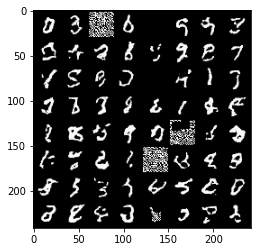

Epoch: [117/500]) Negative Log-Likelihood: -3668.526123046875
Epoch: [118/500]) Batch: [1/75] Negative Log-Likelihood: -3688.31640625


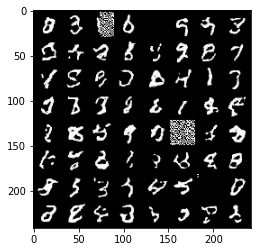

Epoch: [118/500]) Batch: [2/75] Negative Log-Likelihood: -3687.48828125
Epoch: [118/500]) Batch: [3/75] Negative Log-Likelihood: -3695.62939453125
Epoch: [118/500]) Batch: [4/75] Negative Log-Likelihood: -3679.677978515625
Epoch: [118/500]) Batch: [5/75] Negative Log-Likelihood: -3688.70556640625
Epoch: [118/500]) Batch: [6/75] Negative Log-Likelihood: -3686.0380859375
Epoch: [118/500]) Batch: [7/75] Negative Log-Likelihood: -3679.337158203125
Epoch: [118/500]) Batch: [8/75] Negative Log-Likelihood: -3691.10498046875
Epoch: [118/500]) Batch: [9/75] Negative Log-Likelihood: -3697.38671875
Epoch: [118/500]) Batch: [10/75] Negative Log-Likelihood: -3692.475830078125
Epoch: [118/500]) Batch: [11/75] Negative Log-Likelihood: -3689.7744140625
Epoch: [118/500]) Batch: [12/75] Negative Log-Likelihood: -3686.751220703125
Epoch: [118/500]) Batch: [13/75] Negative Log-Likelihood: -3686.962158203125
Epoch: [118/500]) Batch: [14/75] Negative Log-Likelihood: -3685.512939453125
Epoch: [118/500]) Batc

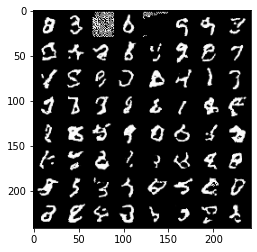

Epoch: [118/500]) Negative Log-Likelihood: -3658.322998046875
Epoch: [119/500]) Batch: [1/75] Negative Log-Likelihood: -3683.21875


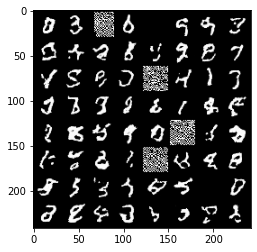

Epoch: [119/500]) Batch: [2/75] Negative Log-Likelihood: -3686.185546875
Epoch: [119/500]) Batch: [3/75] Negative Log-Likelihood: -3693.60986328125
Epoch: [119/500]) Batch: [4/75] Negative Log-Likelihood: -3676.36279296875
Epoch: [119/500]) Batch: [5/75] Negative Log-Likelihood: -3685.57861328125
Epoch: [119/500]) Batch: [6/75] Negative Log-Likelihood: -3685.00927734375
Epoch: [119/500]) Batch: [7/75] Negative Log-Likelihood: -3671.8720703125
Epoch: [119/500]) Batch: [8/75] Negative Log-Likelihood: -3688.9150390625
Epoch: [119/500]) Batch: [9/75] Negative Log-Likelihood: -3694.478271484375
Epoch: [119/500]) Batch: [10/75] Negative Log-Likelihood: -3690.8203125
Epoch: [119/500]) Batch: [11/75] Negative Log-Likelihood: -3693.409912109375
Epoch: [119/500]) Batch: [12/75] Negative Log-Likelihood: -3692.65673828125
Epoch: [119/500]) Batch: [13/75] Negative Log-Likelihood: -3688.220947265625
Epoch: [119/500]) Batch: [14/75] Negative Log-Likelihood: -3692.923583984375
Epoch: [119/500]) Batch:

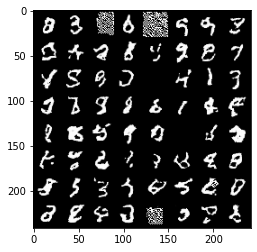

Epoch: [119/500]) Negative Log-Likelihood: -3664.866455078125
Epoch: [120/500]) Batch: [1/75] Negative Log-Likelihood: -3679.936767578125


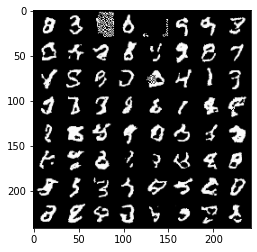

Epoch: [120/500]) Batch: [2/75] Negative Log-Likelihood: -3678.780517578125
Epoch: [120/500]) Batch: [3/75] Negative Log-Likelihood: -3682.470458984375
Epoch: [120/500]) Batch: [4/75] Negative Log-Likelihood: -3660.976806640625
Epoch: [120/500]) Batch: [5/75] Negative Log-Likelihood: -3671.40673828125
Epoch: [120/500]) Batch: [6/75] Negative Log-Likelihood: -3677.302001953125
Epoch: [120/500]) Batch: [7/75] Negative Log-Likelihood: -3673.2734375
Epoch: [120/500]) Batch: [8/75] Negative Log-Likelihood: -3680.637451171875
Epoch: [120/500]) Batch: [9/75] Negative Log-Likelihood: -3688.622314453125
Epoch: [120/500]) Batch: [10/75] Negative Log-Likelihood: -3686.769287109375
Epoch: [120/500]) Batch: [11/75] Negative Log-Likelihood: -3687.812744140625
Epoch: [120/500]) Batch: [12/75] Negative Log-Likelihood: -3686.53564453125
Epoch: [120/500]) Batch: [13/75] Negative Log-Likelihood: -3684.881103515625
Epoch: [120/500]) Batch: [14/75] Negative Log-Likelihood: -3689.204833984375
Epoch: [120/50

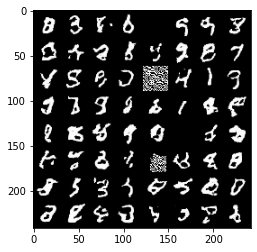

Epoch: [120/500]) Negative Log-Likelihood: -3661.248779296875
Epoch: [121/500]) Batch: [1/75] Negative Log-Likelihood: -3680.186279296875


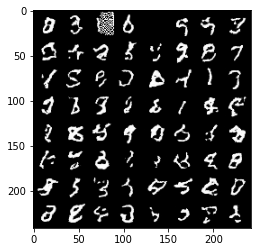

Epoch: [121/500]) Batch: [2/75] Negative Log-Likelihood: -3682.537353515625
Epoch: [121/500]) Batch: [3/75] Negative Log-Likelihood: -3688.08544921875
Epoch: [121/500]) Batch: [4/75] Negative Log-Likelihood: -3670.0986328125
Epoch: [121/500]) Batch: [5/75] Negative Log-Likelihood: -3683.155517578125
Epoch: [121/500]) Batch: [6/75] Negative Log-Likelihood: -3685.15869140625
Epoch: [121/500]) Batch: [7/75] Negative Log-Likelihood: -3680.4326171875
Epoch: [121/500]) Batch: [8/75] Negative Log-Likelihood: -3686.4287109375
Epoch: [121/500]) Batch: [9/75] Negative Log-Likelihood: -3693.34521484375
Epoch: [121/500]) Batch: [10/75] Negative Log-Likelihood: -3687.548095703125
Epoch: [121/500]) Batch: [11/75] Negative Log-Likelihood: -3689.21923828125
Epoch: [121/500]) Batch: [12/75] Negative Log-Likelihood: -3686.388427734375
Epoch: [121/500]) Batch: [13/75] Negative Log-Likelihood: -3677.346435546875
Epoch: [121/500]) Batch: [14/75] Negative Log-Likelihood: -3689.65869140625
Epoch: [121/500]) 

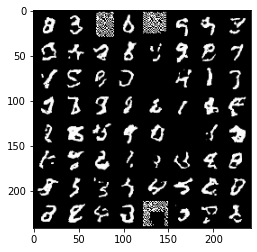

Epoch: [121/500]) Negative Log-Likelihood: -3656.131103515625
Epoch: [122/500]) Batch: [1/75] Negative Log-Likelihood: -3665.0654296875


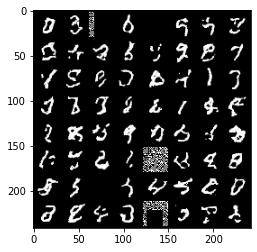

Epoch: [122/500]) Batch: [2/75] Negative Log-Likelihood: -3668.383056640625
Epoch: [122/500]) Batch: [3/75] Negative Log-Likelihood: -3678.914306640625
Epoch: [122/500]) Batch: [4/75] Negative Log-Likelihood: -3668.480224609375
Epoch: [122/500]) Batch: [5/75] Negative Log-Likelihood: -3680.639892578125
Epoch: [122/500]) Batch: [6/75] Negative Log-Likelihood: -3670.41845703125
Epoch: [122/500]) Batch: [7/75] Negative Log-Likelihood: -3666.454833984375
Epoch: [122/500]) Batch: [8/75] Negative Log-Likelihood: -3681.77685546875
Epoch: [122/500]) Batch: [9/75] Negative Log-Likelihood: -3687.329345703125
Epoch: [122/500]) Batch: [10/75] Negative Log-Likelihood: -3681.044189453125
Epoch: [122/500]) Batch: [11/75] Negative Log-Likelihood: -3687.030517578125
Epoch: [122/500]) Batch: [12/75] Negative Log-Likelihood: -3683.900634765625
Epoch: [122/500]) Batch: [13/75] Negative Log-Likelihood: -3675.03125
Epoch: [122/500]) Batch: [14/75] Negative Log-Likelihood: -3676.75390625
Epoch: [122/500]) Ba

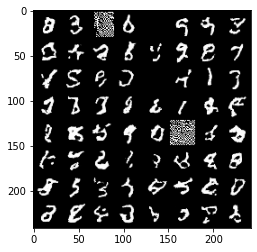

Epoch: [122/500]) Negative Log-Likelihood: -3659.175537109375
Epoch: [123/500]) Batch: [1/75] Negative Log-Likelihood: -3682.09619140625


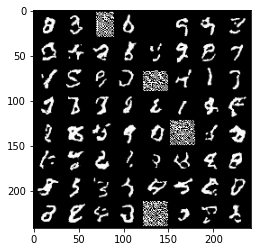

Epoch: [123/500]) Batch: [2/75] Negative Log-Likelihood: -3682.092529296875
Epoch: [123/500]) Batch: [3/75] Negative Log-Likelihood: -3689.5322265625
Epoch: [123/500]) Batch: [4/75] Negative Log-Likelihood: -3679.069580078125
Epoch: [123/500]) Batch: [5/75] Negative Log-Likelihood: -3688.927734375
Epoch: [123/500]) Batch: [6/75] Negative Log-Likelihood: -3687.612060546875
Epoch: [123/500]) Batch: [7/75] Negative Log-Likelihood: -3677.17919921875
Epoch: [123/500]) Batch: [8/75] Negative Log-Likelihood: -3692.38232421875
Epoch: [123/500]) Batch: [9/75] Negative Log-Likelihood: -3692.19140625
Epoch: [123/500]) Batch: [10/75] Negative Log-Likelihood: -3679.09375
Epoch: [123/500]) Batch: [11/75] Negative Log-Likelihood: -3687.033447265625
Epoch: [123/500]) Batch: [12/75] Negative Log-Likelihood: -3683.657470703125
Epoch: [123/500]) Batch: [13/75] Negative Log-Likelihood: -3683.3671875
Epoch: [123/500]) Batch: [14/75] Negative Log-Likelihood: -3686.45361328125
Epoch: [123/500]) Batch: [15/75

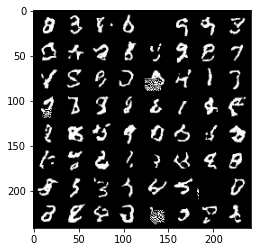

Epoch: [123/500]) Negative Log-Likelihood: -3662.519287109375
Epoch: [124/500]) Batch: [1/75] Negative Log-Likelihood: -3684.3193359375


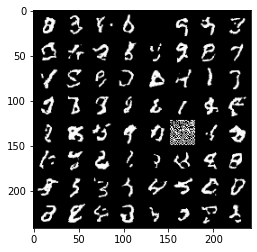

Epoch: [124/500]) Batch: [2/75] Negative Log-Likelihood: -3683.4248046875
Epoch: [124/500]) Batch: [3/75] Negative Log-Likelihood: -3686.279296875
Epoch: [124/500]) Batch: [4/75] Negative Log-Likelihood: -3673.11865234375
Epoch: [124/500]) Batch: [5/75] Negative Log-Likelihood: -3686.216552734375
Epoch: [124/500]) Batch: [6/75] Negative Log-Likelihood: -3684.715576171875
Epoch: [124/500]) Batch: [7/75] Negative Log-Likelihood: -3679.6123046875
Epoch: [124/500]) Batch: [8/75] Negative Log-Likelihood: -3690.47021484375
Epoch: [124/500]) Batch: [9/75] Negative Log-Likelihood: -3696.907958984375
Epoch: [124/500]) Batch: [10/75] Negative Log-Likelihood: -3690.302978515625
Epoch: [124/500]) Batch: [11/75] Negative Log-Likelihood: -3691.278564453125
Epoch: [124/500]) Batch: [12/75] Negative Log-Likelihood: -3692.023681640625
Epoch: [124/500]) Batch: [13/75] Negative Log-Likelihood: -3688.54833984375
Epoch: [124/500]) Batch: [14/75] Negative Log-Likelihood: -3687.37890625
Epoch: [124/500]) Bat

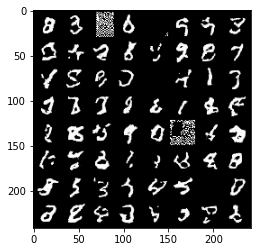

Epoch: [124/500]) Negative Log-Likelihood: -3665.076171875
Epoch: [125/500]) Batch: [1/75] Negative Log-Likelihood: -3681.740966796875


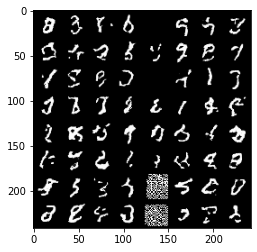

Epoch: [125/500]) Batch: [2/75] Negative Log-Likelihood: -3685.811767578125
Epoch: [125/500]) Batch: [3/75] Negative Log-Likelihood: -3690.455322265625
Epoch: [125/500]) Batch: [4/75] Negative Log-Likelihood: -3671.884033203125
Epoch: [125/500]) Batch: [5/75] Negative Log-Likelihood: -3675.722412109375
Epoch: [125/500]) Batch: [6/75] Negative Log-Likelihood: -3679.48388671875
Epoch: [125/500]) Batch: [7/75] Negative Log-Likelihood: -3673.716796875
Epoch: [125/500]) Batch: [8/75] Negative Log-Likelihood: -3688.944580078125
Epoch: [125/500]) Batch: [9/75] Negative Log-Likelihood: -3697.088623046875
Epoch: [125/500]) Batch: [10/75] Negative Log-Likelihood: -3693.26953125
Epoch: [125/500]) Batch: [11/75] Negative Log-Likelihood: -3693.0078125
Epoch: [125/500]) Batch: [12/75] Negative Log-Likelihood: -3693.264404296875
Epoch: [125/500]) Batch: [13/75] Negative Log-Likelihood: -3683.981201171875
Epoch: [125/500]) Batch: [14/75] Negative Log-Likelihood: -3685.6748046875
Epoch: [125/500]) Batc

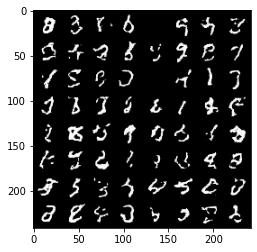

Epoch: [125/500]) Negative Log-Likelihood: -3658.16357421875
Epoch: [126/500]) Batch: [1/75] Negative Log-Likelihood: -3669.7216796875


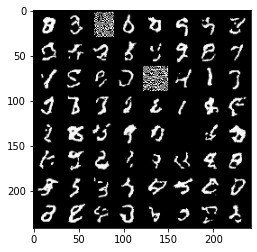

Epoch: [126/500]) Batch: [2/75] Negative Log-Likelihood: -3654.886474609375
Epoch: [126/500]) Batch: [3/75] Negative Log-Likelihood: -3669.0068359375
Epoch: [126/500]) Batch: [4/75] Negative Log-Likelihood: -3663.795654296875
Epoch: [126/500]) Batch: [5/75] Negative Log-Likelihood: -3674.80126953125
Epoch: [126/500]) Batch: [6/75] Negative Log-Likelihood: -3677.62109375
Epoch: [126/500]) Batch: [7/75] Negative Log-Likelihood: -3667.851806640625
Epoch: [126/500]) Batch: [8/75] Negative Log-Likelihood: -3684.1728515625
Epoch: [126/500]) Batch: [9/75] Negative Log-Likelihood: -3694.061767578125
Epoch: [126/500]) Batch: [10/75] Negative Log-Likelihood: -3689.724853515625
Epoch: [126/500]) Batch: [11/75] Negative Log-Likelihood: -3686.5478515625
Epoch: [126/500]) Batch: [12/75] Negative Log-Likelihood: -3683.09423828125
Epoch: [126/500]) Batch: [13/75] Negative Log-Likelihood: -3673.1201171875
Epoch: [126/500]) Batch: [14/75] Negative Log-Likelihood: -3679.87060546875
Epoch: [126/500]) Batc

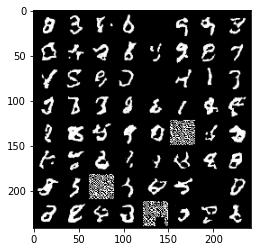

Epoch: [126/500]) Negative Log-Likelihood: -3656.212646484375
Epoch: [127/500]) Batch: [1/75] Negative Log-Likelihood: -3682.08154296875


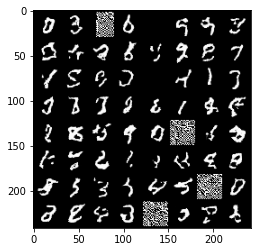

Epoch: [127/500]) Batch: [2/75] Negative Log-Likelihood: -3683.7412109375
Epoch: [127/500]) Batch: [3/75] Negative Log-Likelihood: -3694.52490234375
Epoch: [127/500]) Batch: [4/75] Negative Log-Likelihood: -3675.212646484375
Epoch: [127/500]) Batch: [5/75] Negative Log-Likelihood: -3687.33984375
Epoch: [127/500]) Batch: [6/75] Negative Log-Likelihood: -3688.034912109375
Epoch: [127/500]) Batch: [7/75] Negative Log-Likelihood: -3669.28125
Epoch: [127/500]) Batch: [8/75] Negative Log-Likelihood: -3690.724365234375
Epoch: [127/500]) Batch: [9/75] Negative Log-Likelihood: -3693.0673828125
Epoch: [127/500]) Batch: [10/75] Negative Log-Likelihood: -3686.341064453125
Epoch: [127/500]) Batch: [11/75] Negative Log-Likelihood: -3690.4775390625
Epoch: [127/500]) Batch: [12/75] Negative Log-Likelihood: -3685.4111328125
Epoch: [127/500]) Batch: [13/75] Negative Log-Likelihood: -3679.604248046875
Epoch: [127/500]) Batch: [14/75] Negative Log-Likelihood: -3678.960205078125
Epoch: [127/500]) Batch: [1

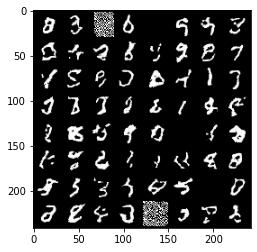

Epoch: [127/500]) Negative Log-Likelihood: -3666.405517578125
Epoch: [128/500]) Batch: [1/75] Negative Log-Likelihood: -3685.33056640625


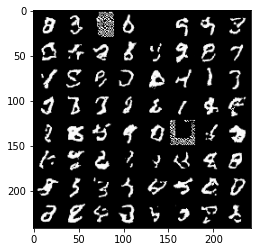

Epoch: [128/500]) Batch: [2/75] Negative Log-Likelihood: -3684.51806640625
Epoch: [128/500]) Batch: [3/75] Negative Log-Likelihood: -3692.152099609375
Epoch: [128/500]) Batch: [4/75] Negative Log-Likelihood: -3675.631103515625
Epoch: [128/500]) Batch: [5/75] Negative Log-Likelihood: -3690.51904296875
Epoch: [128/500]) Batch: [6/75] Negative Log-Likelihood: -3689.709228515625
Epoch: [128/500]) Batch: [7/75] Negative Log-Likelihood: -3678.3515625
Epoch: [128/500]) Batch: [8/75] Negative Log-Likelihood: -3684.175537109375
Epoch: [128/500]) Batch: [9/75] Negative Log-Likelihood: -3698.3466796875
Epoch: [128/500]) Batch: [10/75] Negative Log-Likelihood: -3696.05615234375
Epoch: [128/500]) Batch: [11/75] Negative Log-Likelihood: -3690.47216796875
Epoch: [128/500]) Batch: [12/75] Negative Log-Likelihood: -3695.6123046875
Epoch: [128/500]) Batch: [13/75] Negative Log-Likelihood: -3687.050537109375
Epoch: [128/500]) Batch: [14/75] Negative Log-Likelihood: -3693.403076171875
Epoch: [128/500]) Ba

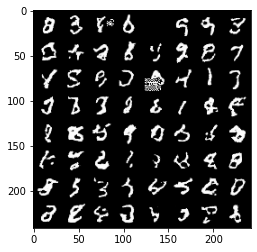

Epoch: [128/500]) Negative Log-Likelihood: -3655.463623046875
Epoch: [129/500]) Batch: [1/75] Negative Log-Likelihood: -3688.925537109375


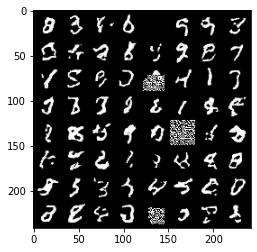

Epoch: [129/500]) Batch: [2/75] Negative Log-Likelihood: -3685.407958984375
Epoch: [129/500]) Batch: [3/75] Negative Log-Likelihood: -3693.31689453125
Epoch: [129/500]) Batch: [4/75] Negative Log-Likelihood: -3679.9951171875
Epoch: [129/500]) Batch: [5/75] Negative Log-Likelihood: -3687.452392578125
Epoch: [129/500]) Batch: [6/75] Negative Log-Likelihood: -3690.065185546875
Epoch: [129/500]) Batch: [7/75] Negative Log-Likelihood: -3679.344970703125
Epoch: [129/500]) Batch: [8/75] Negative Log-Likelihood: -3688.664306640625
Epoch: [129/500]) Batch: [9/75] Negative Log-Likelihood: -3699.530029296875
Epoch: [129/500]) Batch: [10/75] Negative Log-Likelihood: -3694.152099609375
Epoch: [129/500]) Batch: [11/75] Negative Log-Likelihood: -3695.56982421875
Epoch: [129/500]) Batch: [12/75] Negative Log-Likelihood: -3695.1396484375
Epoch: [129/500]) Batch: [13/75] Negative Log-Likelihood: -3690.00048828125
Epoch: [129/500]) Batch: [14/75] Negative Log-Likelihood: -3689.3349609375
Epoch: [129/500]

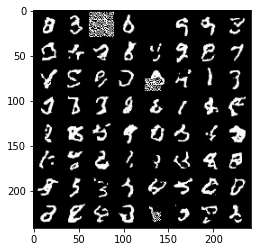

Epoch: [129/500]) Negative Log-Likelihood: -3668.175537109375
Epoch: [130/500]) Batch: [1/75] Negative Log-Likelihood: -3688.836181640625


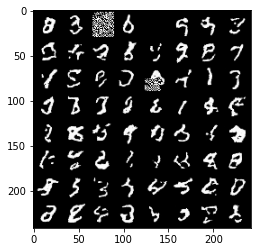

Epoch: [130/500]) Batch: [2/75] Negative Log-Likelihood: -3687.98583984375
Epoch: [130/500]) Batch: [3/75] Negative Log-Likelihood: -3692.3876953125
Epoch: [130/500]) Batch: [4/75] Negative Log-Likelihood: -3681.13427734375
Epoch: [130/500]) Batch: [5/75] Negative Log-Likelihood: -3690.885498046875
Epoch: [130/500]) Batch: [6/75] Negative Log-Likelihood: -3691.693603515625
Epoch: [130/500]) Batch: [7/75] Negative Log-Likelihood: -3683.240234375
Epoch: [130/500]) Batch: [8/75] Negative Log-Likelihood: -3697.47216796875
Epoch: [130/500]) Batch: [9/75] Negative Log-Likelihood: -3700.053955078125
Epoch: [130/500]) Batch: [10/75] Negative Log-Likelihood: -3696.9326171875
Epoch: [130/500]) Batch: [11/75] Negative Log-Likelihood: -3685.65869140625
Epoch: [130/500]) Batch: [12/75] Negative Log-Likelihood: -3683.40185546875
Epoch: [130/500]) Batch: [13/75] Negative Log-Likelihood: -3679.631591796875
Epoch: [130/500]) Batch: [14/75] Negative Log-Likelihood: -3685.18994140625
Epoch: [130/500]) Ba

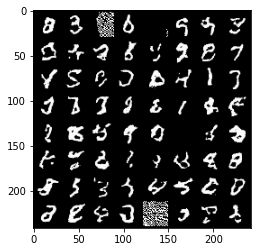

Epoch: [130/500]) Negative Log-Likelihood: -3670.494384765625
Epoch: [131/500]) Batch: [1/75] Negative Log-Likelihood: -3679.218017578125


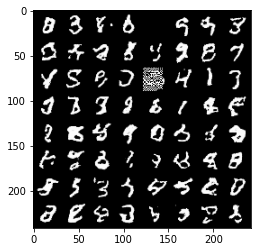

Epoch: [131/500]) Batch: [2/75] Negative Log-Likelihood: -3672.410888671875
Epoch: [131/500]) Batch: [3/75] Negative Log-Likelihood: -3686.3037109375
Epoch: [131/500]) Batch: [4/75] Negative Log-Likelihood: -3674.60986328125
Epoch: [131/500]) Batch: [5/75] Negative Log-Likelihood: -3682.7373046875
Epoch: [131/500]) Batch: [6/75] Negative Log-Likelihood: -3680.945556640625
Epoch: [131/500]) Batch: [7/75] Negative Log-Likelihood: -3678.800537109375
Epoch: [131/500]) Batch: [8/75] Negative Log-Likelihood: -3682.907470703125
Epoch: [131/500]) Batch: [9/75] Negative Log-Likelihood: -3694.608154296875
Epoch: [131/500]) Batch: [10/75] Negative Log-Likelihood: -3688.1318359375
Epoch: [131/500]) Batch: [11/75] Negative Log-Likelihood: -3684.0498046875
Epoch: [131/500]) Batch: [12/75] Negative Log-Likelihood: -3688.984375
Epoch: [131/500]) Batch: [13/75] Negative Log-Likelihood: -3685.941162109375
Epoch: [131/500]) Batch: [14/75] Negative Log-Likelihood: -3686.537353515625
Epoch: [131/500]) Batc

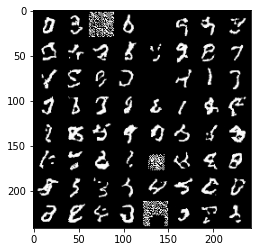

Epoch: [131/500]) Negative Log-Likelihood: -3660.097412109375
Epoch: [132/500]) Batch: [1/75] Negative Log-Likelihood: -3677.423095703125


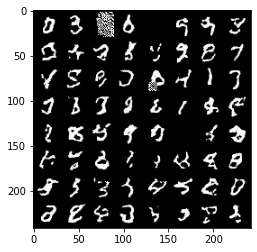

Epoch: [132/500]) Batch: [2/75] Negative Log-Likelihood: -3671.482421875
Epoch: [132/500]) Batch: [3/75] Negative Log-Likelihood: -3686.963623046875
Epoch: [132/500]) Batch: [4/75] Negative Log-Likelihood: -3671.00048828125
Epoch: [132/500]) Batch: [5/75] Negative Log-Likelihood: -3683.861083984375
Epoch: [132/500]) Batch: [6/75] Negative Log-Likelihood: -3678.095458984375
Epoch: [132/500]) Batch: [7/75] Negative Log-Likelihood: -3672.062744140625
Epoch: [132/500]) Batch: [8/75] Negative Log-Likelihood: -3660.90283203125
Epoch: [132/500]) Batch: [9/75] Negative Log-Likelihood: -3666.047119140625
Epoch: [132/500]) Batch: [10/75] Negative Log-Likelihood: -3677.67529296875
Epoch: [132/500]) Batch: [11/75] Negative Log-Likelihood: -3677.113037109375
Epoch: [132/500]) Batch: [12/75] Negative Log-Likelihood: -3674.7255859375
Epoch: [132/500]) Batch: [13/75] Negative Log-Likelihood: -3666.609619140625
Epoch: [132/500]) Batch: [14/75] Negative Log-Likelihood: -3679.5693359375
Epoch: [132/500])

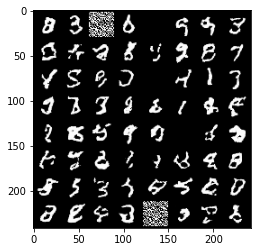

Epoch: [132/500]) Negative Log-Likelihood: -3667.915771484375
Epoch: [133/500]) Batch: [1/75] Negative Log-Likelihood: -3692.93994140625


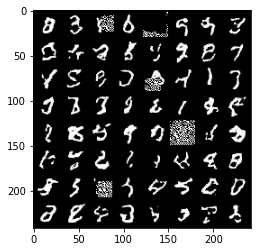

Epoch: [133/500]) Batch: [2/75] Negative Log-Likelihood: -3680.912841796875
Epoch: [133/500]) Batch: [3/75] Negative Log-Likelihood: -3673.16357421875
Epoch: [133/500]) Batch: [4/75] Negative Log-Likelihood: -3666.829345703125
Epoch: [133/500]) Batch: [5/75] Negative Log-Likelihood: -3679.841796875
Epoch: [133/500]) Batch: [6/75] Negative Log-Likelihood: -3671.50244140625
Epoch: [133/500]) Batch: [7/75] Negative Log-Likelihood: -3660.688720703125
Epoch: [133/500]) Batch: [8/75] Negative Log-Likelihood: -3683.20556640625
Epoch: [133/500]) Batch: [9/75] Negative Log-Likelihood: -3697.11865234375
Epoch: [133/500]) Batch: [10/75] Negative Log-Likelihood: -3686.072509765625
Epoch: [133/500]) Batch: [11/75] Negative Log-Likelihood: -3693.0068359375
Epoch: [133/500]) Batch: [12/75] Negative Log-Likelihood: -3686.232666015625
Epoch: [133/500]) Batch: [13/75] Negative Log-Likelihood: -3666.34423828125
Epoch: [133/500]) Batch: [14/75] Negative Log-Likelihood: -3672.3798828125
Epoch: [133/500]) B

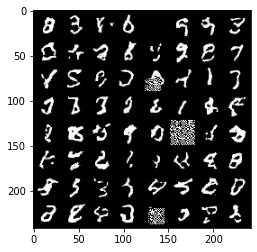

Epoch: [133/500]) Negative Log-Likelihood: -3667.423583984375
Epoch: [134/500]) Batch: [1/75] Negative Log-Likelihood: -3690.758056640625


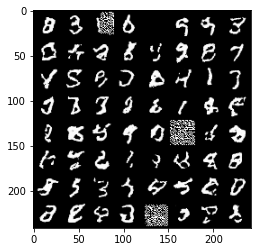

Epoch: [134/500]) Batch: [2/75] Negative Log-Likelihood: -3690.876708984375
Epoch: [134/500]) Batch: [3/75] Negative Log-Likelihood: -3701.397216796875
Epoch: [134/500]) Batch: [4/75] Negative Log-Likelihood: -3680.760009765625
Epoch: [134/500]) Batch: [5/75] Negative Log-Likelihood: -3688.919921875
Epoch: [134/500]) Batch: [6/75] Negative Log-Likelihood: -3689.666259765625
Epoch: [134/500]) Batch: [7/75] Negative Log-Likelihood: -3681.600341796875
Epoch: [134/500]) Batch: [8/75] Negative Log-Likelihood: -3691.421875
Epoch: [134/500]) Batch: [9/75] Negative Log-Likelihood: -3695.522216796875
Epoch: [134/500]) Batch: [10/75] Negative Log-Likelihood: -3682.576904296875
Epoch: [134/500]) Batch: [11/75] Negative Log-Likelihood: -3686.631103515625
Epoch: [134/500]) Batch: [12/75] Negative Log-Likelihood: -3690.510498046875
Epoch: [134/500]) Batch: [13/75] Negative Log-Likelihood: -3681.366455078125
Epoch: [134/500]) Batch: [14/75] Negative Log-Likelihood: -3680.856689453125
Epoch: [134/500]

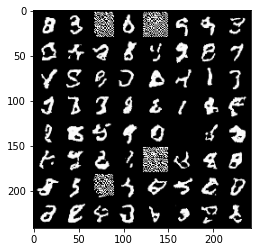

Epoch: [134/500]) Negative Log-Likelihood: -3666.29833984375
Epoch: [135/500]) Batch: [1/75] Negative Log-Likelihood: -3690.583984375


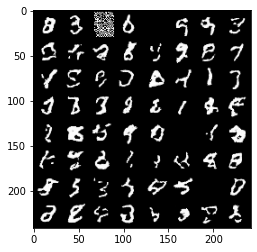

Epoch: [135/500]) Batch: [2/75] Negative Log-Likelihood: -3685.671875
Epoch: [135/500]) Batch: [3/75] Negative Log-Likelihood: -3692.7109375
Epoch: [135/500]) Batch: [4/75] Negative Log-Likelihood: -3674.108642578125
Epoch: [135/500]) Batch: [5/75] Negative Log-Likelihood: -3678.37939453125
Epoch: [135/500]) Batch: [6/75] Negative Log-Likelihood: -3681.072998046875
Epoch: [135/500]) Batch: [7/75] Negative Log-Likelihood: -3671.0986328125
Epoch: [135/500]) Batch: [8/75] Negative Log-Likelihood: -3677.4365234375
Epoch: [135/500]) Batch: [9/75] Negative Log-Likelihood: -3682.974365234375
Epoch: [135/500]) Batch: [10/75] Negative Log-Likelihood: -3689.3115234375
Epoch: [135/500]) Batch: [11/75] Negative Log-Likelihood: -3684.106201171875
Epoch: [135/500]) Batch: [12/75] Negative Log-Likelihood: -3685.552490234375
Epoch: [135/500]) Batch: [13/75] Negative Log-Likelihood: -3685.087158203125
Epoch: [135/500]) Batch: [14/75] Negative Log-Likelihood: -3683.548583984375
Epoch: [135/500]) Batch: 

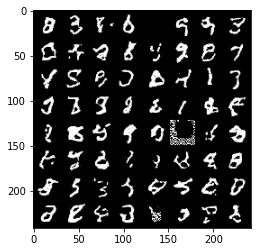

Epoch: [135/500]) Negative Log-Likelihood: -3658.448974609375
Epoch: [136/500]) Batch: [1/75] Negative Log-Likelihood: -3678.186767578125


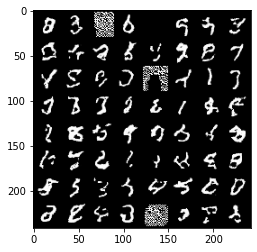

Epoch: [136/500]) Batch: [2/75] Negative Log-Likelihood: -3681.139892578125
Epoch: [136/500]) Batch: [3/75] Negative Log-Likelihood: -3692.9951171875
Epoch: [136/500]) Batch: [4/75] Negative Log-Likelihood: -3679.32177734375
Epoch: [136/500]) Batch: [5/75] Negative Log-Likelihood: -3686.71044921875
Epoch: [136/500]) Batch: [6/75] Negative Log-Likelihood: -3689.693603515625
Epoch: [136/500]) Batch: [7/75] Negative Log-Likelihood: -3682.557373046875
Epoch: [136/500]) Batch: [8/75] Negative Log-Likelihood: -3690.128662109375
Epoch: [136/500]) Batch: [9/75] Negative Log-Likelihood: -3700.8154296875
Epoch: [136/500]) Batch: [10/75] Negative Log-Likelihood: -3696.669921875
Epoch: [136/500]) Batch: [11/75] Negative Log-Likelihood: -3693.53125
Epoch: [136/500]) Batch: [12/75] Negative Log-Likelihood: -3687.95751953125
Epoch: [136/500]) Batch: [13/75] Negative Log-Likelihood: -3682.87060546875
Epoch: [136/500]) Batch: [14/75] Negative Log-Likelihood: -3683.344970703125
Epoch: [136/500]) Batch: 

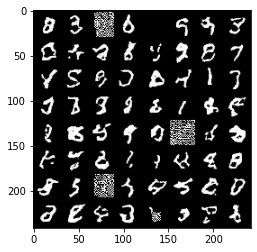

Epoch: [136/500]) Negative Log-Likelihood: -3673.125
Epoch: [137/500]) Batch: [1/75] Negative Log-Likelihood: -3692.9501953125


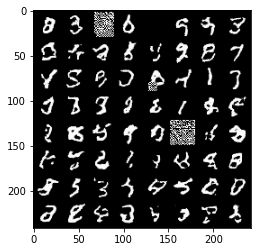

Epoch: [137/500]) Batch: [2/75] Negative Log-Likelihood: -3695.7666015625
Epoch: [137/500]) Batch: [3/75] Negative Log-Likelihood: -3698.146728515625
Epoch: [137/500]) Batch: [4/75] Negative Log-Likelihood: -3684.14013671875
Epoch: [137/500]) Batch: [5/75] Negative Log-Likelihood: -3687.336181640625
Epoch: [137/500]) Batch: [6/75] Negative Log-Likelihood: -3679.48681640625
Epoch: [137/500]) Batch: [7/75] Negative Log-Likelihood: -3680.29931640625
Epoch: [137/500]) Batch: [8/75] Negative Log-Likelihood: -3694.545654296875
Epoch: [137/500]) Batch: [9/75] Negative Log-Likelihood: -3699.55419921875
Epoch: [137/500]) Batch: [10/75] Negative Log-Likelihood: -3700.3056640625
Epoch: [137/500]) Batch: [11/75] Negative Log-Likelihood: -3694.0224609375
Epoch: [137/500]) Batch: [12/75] Negative Log-Likelihood: -3695.38671875
Epoch: [137/500]) Batch: [13/75] Negative Log-Likelihood: -3692.07763671875
Epoch: [137/500]) Batch: [14/75] Negative Log-Likelihood: -3693.65087890625
Epoch: [137/500]) Batch

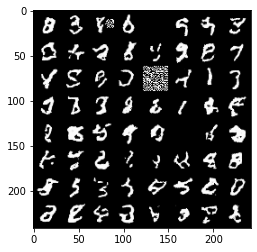

Epoch: [137/500]) Negative Log-Likelihood: -3667.9853515625
Epoch: [138/500]) Batch: [1/75] Negative Log-Likelihood: -3688.41796875


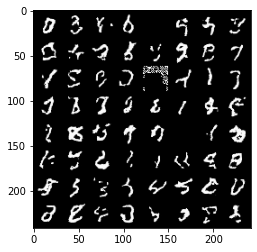

Epoch: [138/500]) Batch: [2/75] Negative Log-Likelihood: -3692.0244140625
Epoch: [138/500]) Batch: [3/75] Negative Log-Likelihood: -3698.484375
Epoch: [138/500]) Batch: [4/75] Negative Log-Likelihood: -3683.905029296875
Epoch: [138/500]) Batch: [5/75] Negative Log-Likelihood: -3688.694580078125
Epoch: [138/500]) Batch: [6/75] Negative Log-Likelihood: -3691.070556640625
Epoch: [138/500]) Batch: [7/75] Negative Log-Likelihood: -3677.00732421875
Epoch: [138/500]) Batch: [8/75] Negative Log-Likelihood: -3683.146240234375
Epoch: [138/500]) Batch: [9/75] Negative Log-Likelihood: -3691.3759765625
Epoch: [138/500]) Batch: [10/75] Negative Log-Likelihood: -3687.2255859375
Epoch: [138/500]) Batch: [11/75] Negative Log-Likelihood: -3689.8525390625
Epoch: [138/500]) Batch: [12/75] Negative Log-Likelihood: -3690.5087890625
Epoch: [138/500]) Batch: [13/75] Negative Log-Likelihood: -3684.890869140625
Epoch: [138/500]) Batch: [14/75] Negative Log-Likelihood: -3690.541748046875
Epoch: [138/500]) Batch:

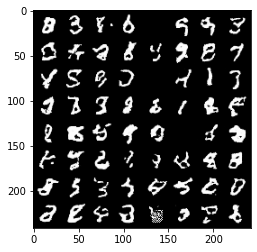

Epoch: [138/500]) Negative Log-Likelihood: -3654.2255859375
Epoch: [139/500]) Batch: [1/75] Negative Log-Likelihood: -3671.640869140625


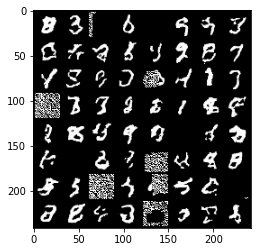

Epoch: [139/500]) Batch: [2/75] Negative Log-Likelihood: -3679.12646484375
Epoch: [139/500]) Batch: [3/75] Negative Log-Likelihood: -3681.751708984375
Epoch: [139/500]) Batch: [4/75] Negative Log-Likelihood: -3666.076904296875
Epoch: [139/500]) Batch: [5/75] Negative Log-Likelihood: -3689.51611328125
Epoch: [139/500]) Batch: [6/75] Negative Log-Likelihood: -3679.50439453125
Epoch: [139/500]) Batch: [7/75] Negative Log-Likelihood: -3665.343017578125
Epoch: [139/500]) Batch: [8/75] Negative Log-Likelihood: -3686.41552734375
Epoch: [139/500]) Batch: [9/75] Negative Log-Likelihood: -3691.861083984375
Epoch: [139/500]) Batch: [10/75] Negative Log-Likelihood: -3685.28857421875
Epoch: [139/500]) Batch: [11/75] Negative Log-Likelihood: -3690.509521484375
Epoch: [139/500]) Batch: [12/75] Negative Log-Likelihood: -3690.726806640625
Epoch: [139/500]) Batch: [13/75] Negative Log-Likelihood: -3679.6337890625
Epoch: [139/500]) Batch: [14/75] Negative Log-Likelihood: -3689.2880859375
Epoch: [139/500]

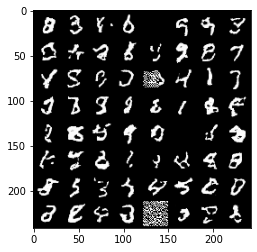

Epoch: [139/500]) Negative Log-Likelihood: -3655.39794921875
Epoch: [140/500]) Batch: [1/75] Negative Log-Likelihood: -3682.451904296875


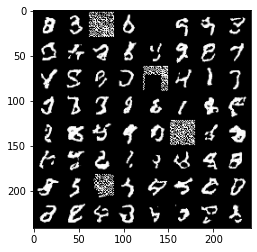

Epoch: [140/500]) Batch: [2/75] Negative Log-Likelihood: -3683.041748046875
Epoch: [140/500]) Batch: [3/75] Negative Log-Likelihood: -3689.58544921875
Epoch: [140/500]) Batch: [4/75] Negative Log-Likelihood: -3668.920166015625
Epoch: [140/500]) Batch: [5/75] Negative Log-Likelihood: -3686.89990234375
Epoch: [140/500]) Batch: [6/75] Negative Log-Likelihood: -3686.682373046875
Epoch: [140/500]) Batch: [7/75] Negative Log-Likelihood: -3677.0244140625
Epoch: [140/500]) Batch: [8/75] Negative Log-Likelihood: -3688.592529296875
Epoch: [140/500]) Batch: [9/75] Negative Log-Likelihood: -3700.262451171875
Epoch: [140/500]) Batch: [10/75] Negative Log-Likelihood: -3691.369873046875
Epoch: [140/500]) Batch: [11/75] Negative Log-Likelihood: -3693.61376953125
Epoch: [140/500]) Batch: [12/75] Negative Log-Likelihood: -3695.2099609375
Epoch: [140/500]) Batch: [13/75] Negative Log-Likelihood: -3686.81982421875
Epoch: [140/500]) Batch: [14/75] Negative Log-Likelihood: -3689.127197265625
Epoch: [140/500

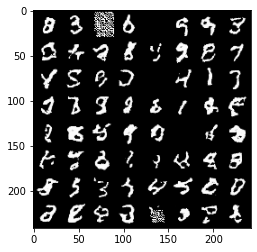

Epoch: [140/500]) Negative Log-Likelihood: -3667.11376953125
Epoch: [141/500]) Batch: [1/75] Negative Log-Likelihood: -3687.6259765625


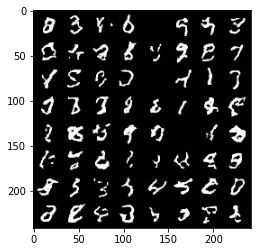

Epoch: [141/500]) Batch: [2/75] Negative Log-Likelihood: -3690.718017578125
Epoch: [141/500]) Batch: [3/75] Negative Log-Likelihood: -3697.809326171875
Epoch: [141/500]) Batch: [4/75] Negative Log-Likelihood: -3681.700439453125
Epoch: [141/500]) Batch: [5/75] Negative Log-Likelihood: -3691.27685546875
Epoch: [141/500]) Batch: [6/75] Negative Log-Likelihood: -3691.556396484375
Epoch: [141/500]) Batch: [7/75] Negative Log-Likelihood: -3684.3857421875
Epoch: [141/500]) Batch: [8/75] Negative Log-Likelihood: -3694.103759765625
Epoch: [141/500]) Batch: [9/75] Negative Log-Likelihood: -3702.91748046875
Epoch: [141/500]) Batch: [10/75] Negative Log-Likelihood: -3700.46923828125
Epoch: [141/500]) Batch: [11/75] Negative Log-Likelihood: -3696.235595703125
Epoch: [141/500]) Batch: [12/75] Negative Log-Likelihood: -3689.786865234375
Epoch: [141/500]) Batch: [13/75] Negative Log-Likelihood: -3685.992431640625
Epoch: [141/500]) Batch: [14/75] Negative Log-Likelihood: -3694.3310546875
Epoch: [141/50

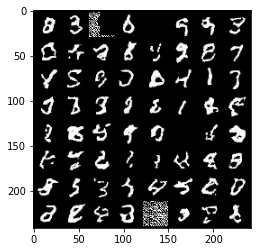

Epoch: [141/500]) Negative Log-Likelihood: -3658.341796875
Epoch: [142/500]) Batch: [1/75] Negative Log-Likelihood: -3679.051513671875


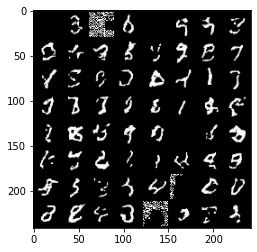

Epoch: [142/500]) Batch: [2/75] Negative Log-Likelihood: -3680.991455078125
Epoch: [142/500]) Batch: [3/75] Negative Log-Likelihood: -3691.64306640625
Epoch: [142/500]) Batch: [4/75] Negative Log-Likelihood: -3674.08984375
Epoch: [142/500]) Batch: [5/75] Negative Log-Likelihood: -3685.078125
Epoch: [142/500]) Batch: [6/75] Negative Log-Likelihood: -3692.117431640625
Epoch: [142/500]) Batch: [7/75] Negative Log-Likelihood: -3673.353759765625
Epoch: [142/500]) Batch: [8/75] Negative Log-Likelihood: -3680.729248046875
Epoch: [142/500]) Batch: [9/75] Negative Log-Likelihood: -3695.052734375
Epoch: [142/500]) Batch: [10/75] Negative Log-Likelihood: -3694.25927734375
Epoch: [142/500]) Batch: [11/75] Negative Log-Likelihood: -3690.557373046875
Epoch: [142/500]) Batch: [12/75] Negative Log-Likelihood: -3689.1435546875
Epoch: [142/500]) Batch: [13/75] Negative Log-Likelihood: -3689.441162109375
Epoch: [142/500]) Batch: [14/75] Negative Log-Likelihood: -3678.4580078125
Epoch: [142/500]) Batch: [

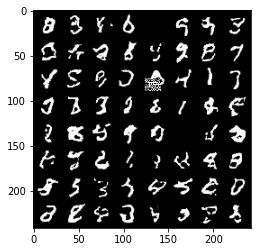

Epoch: [142/500]) Negative Log-Likelihood: -3659.391845703125
Epoch: [143/500]) Batch: [1/75] Negative Log-Likelihood: -3674.260009765625


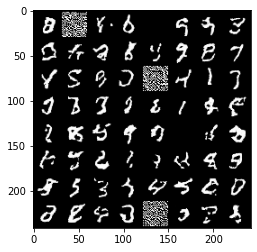

Epoch: [143/500]) Batch: [2/75] Negative Log-Likelihood: -3683.475341796875
Epoch: [143/500]) Batch: [3/75] Negative Log-Likelihood: -3694.30126953125
Epoch: [143/500]) Batch: [4/75] Negative Log-Likelihood: -3674.314208984375
Epoch: [143/500]) Batch: [5/75] Negative Log-Likelihood: -3689.4609375
Epoch: [143/500]) Batch: [6/75] Negative Log-Likelihood: -3691.11962890625
Epoch: [143/500]) Batch: [7/75] Negative Log-Likelihood: -3683.722412109375
Epoch: [143/500]) Batch: [8/75] Negative Log-Likelihood: -3696.381103515625
Epoch: [143/500]) Batch: [9/75] Negative Log-Likelihood: -3703.591552734375
Epoch: [143/500]) Batch: [10/75] Negative Log-Likelihood: -3701.69921875
Epoch: [143/500]) Batch: [11/75] Negative Log-Likelihood: -3696.363037109375
Epoch: [143/500]) Batch: [12/75] Negative Log-Likelihood: -3698.2099609375
Epoch: [143/500]) Batch: [13/75] Negative Log-Likelihood: -3694.945556640625
Epoch: [143/500]) Batch: [14/75] Negative Log-Likelihood: -3696.414306640625
Epoch: [143/500]) Ba

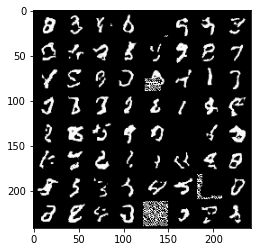

Epoch: [143/500]) Negative Log-Likelihood: -3655.6572265625
Epoch: [144/500]) Batch: [1/75] Negative Log-Likelihood: -3686.206787109375


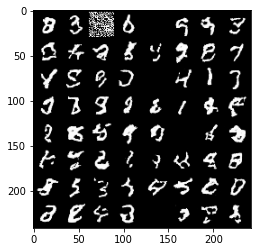

Epoch: [144/500]) Batch: [2/75] Negative Log-Likelihood: -3685.6806640625
Epoch: [144/500]) Batch: [3/75] Negative Log-Likelihood: -3690.612060546875
Epoch: [144/500]) Batch: [4/75] Negative Log-Likelihood: -3678.3740234375
Epoch: [144/500]) Batch: [5/75] Negative Log-Likelihood: -3691.72119140625
Epoch: [144/500]) Batch: [6/75] Negative Log-Likelihood: -3691.40625
Epoch: [144/500]) Batch: [7/75] Negative Log-Likelihood: -3682.93798828125
Epoch: [144/500]) Batch: [8/75] Negative Log-Likelihood: -3693.34423828125
Epoch: [144/500]) Batch: [9/75] Negative Log-Likelihood: -3704.691162109375
Epoch: [144/500]) Batch: [10/75] Negative Log-Likelihood: -3698.041259765625
Epoch: [144/500]) Batch: [11/75] Negative Log-Likelihood: -3686.71337890625
Epoch: [144/500]) Batch: [12/75] Negative Log-Likelihood: -3695.175537109375
Epoch: [144/500]) Batch: [13/75] Negative Log-Likelihood: -3685.07958984375
Epoch: [144/500]) Batch: [14/75] Negative Log-Likelihood: -3680.87744140625
Epoch: [144/500]) Batch:

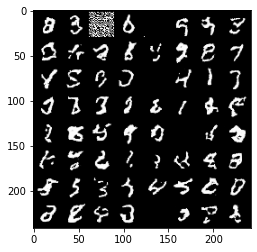

Epoch: [144/500]) Negative Log-Likelihood: -3668.6162109375
Epoch: [145/500]) Batch: [1/75] Negative Log-Likelihood: -3685.1357421875


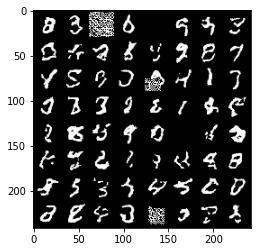

Epoch: [145/500]) Batch: [2/75] Negative Log-Likelihood: -3687.286376953125
Epoch: [145/500]) Batch: [3/75] Negative Log-Likelihood: -3697.631103515625
Epoch: [145/500]) Batch: [4/75] Negative Log-Likelihood: -3681.994384765625
Epoch: [145/500]) Batch: [5/75] Negative Log-Likelihood: -3690.314208984375
Epoch: [145/500]) Batch: [6/75] Negative Log-Likelihood: -3689.829833984375
Epoch: [145/500]) Batch: [7/75] Negative Log-Likelihood: -3688.67919921875
Epoch: [145/500]) Batch: [8/75] Negative Log-Likelihood: -3694.59326171875
Epoch: [145/500]) Batch: [9/75] Negative Log-Likelihood: -3701.343994140625
Epoch: [145/500]) Batch: [10/75] Negative Log-Likelihood: -3696.4111328125
Epoch: [145/500]) Batch: [11/75] Negative Log-Likelihood: -3689.981201171875
Epoch: [145/500]) Batch: [12/75] Negative Log-Likelihood: -3685.99169921875
Epoch: [145/500]) Batch: [13/75] Negative Log-Likelihood: -3682.423095703125
Epoch: [145/500]) Batch: [14/75] Negative Log-Likelihood: -3693.56689453125
Epoch: [145/5

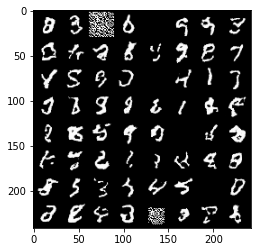

Epoch: [145/500]) Negative Log-Likelihood: -3671.807373046875
Epoch: [146/500]) Batch: [1/75] Negative Log-Likelihood: -3686.802490234375


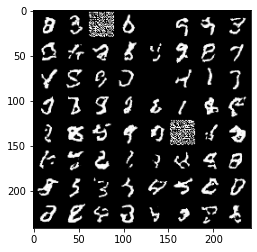

Epoch: [146/500]) Batch: [2/75] Negative Log-Likelihood: -3695.2880859375
Epoch: [146/500]) Batch: [3/75] Negative Log-Likelihood: -3697.61376953125
Epoch: [146/500]) Batch: [4/75] Negative Log-Likelihood: -3683.05810546875
Epoch: [146/500]) Batch: [5/75] Negative Log-Likelihood: -3685.559326171875
Epoch: [146/500]) Batch: [6/75] Negative Log-Likelihood: -3691.8857421875
Epoch: [146/500]) Batch: [7/75] Negative Log-Likelihood: -3684.03173828125
Epoch: [146/500]) Batch: [8/75] Negative Log-Likelihood: -3691.83544921875
Epoch: [146/500]) Batch: [9/75] Negative Log-Likelihood: -3706.721435546875
Epoch: [146/500]) Batch: [10/75] Negative Log-Likelihood: -3698.764404296875
Epoch: [146/500]) Batch: [11/75] Negative Log-Likelihood: -3696.508056640625
Epoch: [146/500]) Batch: [12/75] Negative Log-Likelihood: -3701.021240234375
Epoch: [146/500]) Batch: [13/75] Negative Log-Likelihood: -3691.747314453125
Epoch: [146/500]) Batch: [14/75] Negative Log-Likelihood: -3701.6875
Epoch: [146/500]) Batch

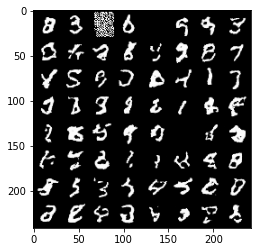

Epoch: [146/500]) Negative Log-Likelihood: -3666.22119140625
Epoch: [147/500]) Batch: [1/75] Negative Log-Likelihood: -3691.139404296875


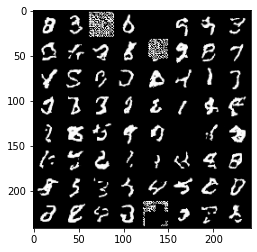

Epoch: [147/500]) Batch: [2/75] Negative Log-Likelihood: -3695.372314453125
Epoch: [147/500]) Batch: [3/75] Negative Log-Likelihood: -3699.387939453125
Epoch: [147/500]) Batch: [4/75] Negative Log-Likelihood: -3684.40576171875
Epoch: [147/500]) Batch: [5/75] Negative Log-Likelihood: -3691.560302734375
Epoch: [147/500]) Batch: [6/75] Negative Log-Likelihood: -3694.53564453125
Epoch: [147/500]) Batch: [7/75] Negative Log-Likelihood: -3681.04296875
Epoch: [147/500]) Batch: [8/75] Negative Log-Likelihood: -3688.860595703125
Epoch: [147/500]) Batch: [9/75] Negative Log-Likelihood: -3701.55615234375
Epoch: [147/500]) Batch: [10/75] Negative Log-Likelihood: -3693.796142578125
Epoch: [147/500]) Batch: [11/75] Negative Log-Likelihood: -3691.6689453125
Epoch: [147/500]) Batch: [12/75] Negative Log-Likelihood: -3690.896240234375
Epoch: [147/500]) Batch: [13/75] Negative Log-Likelihood: -3684.920654296875
Epoch: [147/500]) Batch: [14/75] Negative Log-Likelihood: -3694.40966796875
Epoch: [147/500])

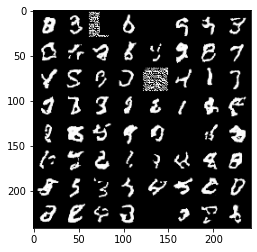

Epoch: [147/500]) Negative Log-Likelihood: -3669.776123046875
Epoch: [148/500]) Batch: [1/75] Negative Log-Likelihood: -3691.686767578125


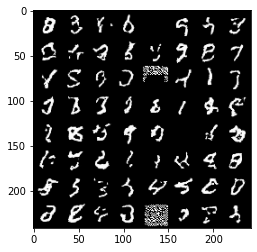

Epoch: [148/500]) Batch: [2/75] Negative Log-Likelihood: -3680.700439453125
Epoch: [148/500]) Batch: [3/75] Negative Log-Likelihood: -3668.156494140625
Epoch: [148/500]) Batch: [4/75] Negative Log-Likelihood: -3669.58984375
Epoch: [148/500]) Batch: [5/75] Negative Log-Likelihood: -3681.03076171875
Epoch: [148/500]) Batch: [6/75] Negative Log-Likelihood: -3675.372314453125
Epoch: [148/500]) Batch: [7/75] Negative Log-Likelihood: -3672.223388671875
Epoch: [148/500]) Batch: [8/75] Negative Log-Likelihood: -3687.175537109375
Epoch: [148/500]) Batch: [9/75] Negative Log-Likelihood: -3696.35107421875
Epoch: [148/500]) Batch: [10/75] Negative Log-Likelihood: -3695.90771484375
Epoch: [148/500]) Batch: [11/75] Negative Log-Likelihood: -3692.718017578125
Epoch: [148/500]) Batch: [12/75] Negative Log-Likelihood: -3691.059814453125
Epoch: [148/500]) Batch: [13/75] Negative Log-Likelihood: -3687.55126953125
Epoch: [148/500]) Batch: [14/75] Negative Log-Likelihood: -3690.80126953125
Epoch: [148/500]

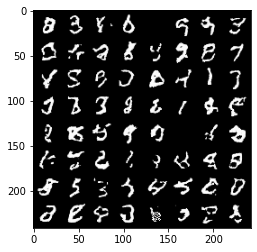

Epoch: [148/500]) Negative Log-Likelihood: -3668.279296875
Epoch: [149/500]) Batch: [1/75] Negative Log-Likelihood: -3692.780029296875


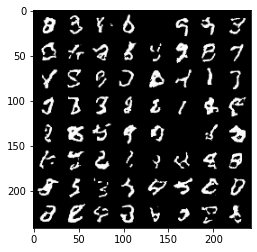

Epoch: [149/500]) Batch: [2/75] Negative Log-Likelihood: -3696.04296875
Epoch: [149/500]) Batch: [3/75] Negative Log-Likelihood: -3703.533447265625
Epoch: [149/500]) Batch: [4/75] Negative Log-Likelihood: -3681.03857421875
Epoch: [149/500]) Batch: [5/75] Negative Log-Likelihood: -3690.4755859375
Epoch: [149/500]) Batch: [6/75] Negative Log-Likelihood: -3694.499267578125
Epoch: [149/500]) Batch: [7/75] Negative Log-Likelihood: -3686.58984375
Epoch: [149/500]) Batch: [8/75] Negative Log-Likelihood: -3699.619873046875
Epoch: [149/500]) Batch: [9/75] Negative Log-Likelihood: -3705.25244140625
Epoch: [149/500]) Batch: [10/75] Negative Log-Likelihood: -3700.046875
Epoch: [149/500]) Batch: [11/75] Negative Log-Likelihood: -3697.73095703125
Epoch: [149/500]) Batch: [12/75] Negative Log-Likelihood: -3696.263427734375
Epoch: [149/500]) Batch: [13/75] Negative Log-Likelihood: -3693.12744140625
Epoch: [149/500]) Batch: [14/75] Negative Log-Likelihood: -3698.56640625
Epoch: [149/500]) Batch: [15/75

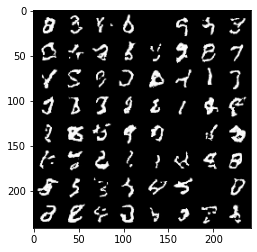

Epoch: [149/500]) Negative Log-Likelihood: -3673.114990234375
Epoch: [150/500]) Batch: [1/75] Negative Log-Likelihood: -3694.830322265625


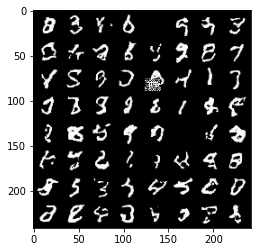

Epoch: [150/500]) Batch: [2/75] Negative Log-Likelihood: -3696.30029296875
Epoch: [150/500]) Batch: [3/75] Negative Log-Likelihood: -3702.3994140625
Epoch: [150/500]) Batch: [4/75] Negative Log-Likelihood: -3685.08984375
Epoch: [150/500]) Batch: [5/75] Negative Log-Likelihood: -3698.138427734375
Epoch: [150/500]) Batch: [6/75] Negative Log-Likelihood: -3692.947998046875
Epoch: [150/500]) Batch: [7/75] Negative Log-Likelihood: -3689.4755859375
Epoch: [150/500]) Batch: [8/75] Negative Log-Likelihood: -3684.217529296875
Epoch: [150/500]) Batch: [9/75] Negative Log-Likelihood: -3681.7392578125
Epoch: [150/500]) Batch: [10/75] Negative Log-Likelihood: -3681.7841796875
Epoch: [150/500]) Batch: [11/75] Negative Log-Likelihood: -3693.436767578125
Epoch: [150/500]) Batch: [12/75] Negative Log-Likelihood: -3686.20361328125
Epoch: [150/500]) Batch: [13/75] Negative Log-Likelihood: -3666.896728515625
Epoch: [150/500]) Batch: [14/75] Negative Log-Likelihood: -3682.05810546875
Epoch: [150/500]) Batc

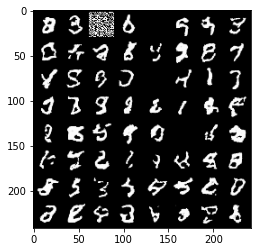

Epoch: [150/500]) Negative Log-Likelihood: -3666.9013671875
Epoch: [151/500]) Batch: [1/75] Negative Log-Likelihood: -3689.548095703125


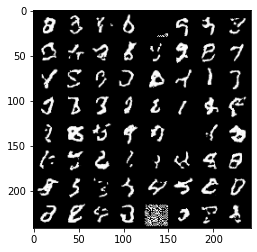

Epoch: [151/500]) Batch: [2/75] Negative Log-Likelihood: -3690.42919921875
Epoch: [151/500]) Batch: [3/75] Negative Log-Likelihood: -3692.184814453125
Epoch: [151/500]) Batch: [4/75] Negative Log-Likelihood: -3681.7099609375
Epoch: [151/500]) Batch: [5/75] Negative Log-Likelihood: -3691.33056640625
Epoch: [151/500]) Batch: [6/75] Negative Log-Likelihood: -3685.091796875
Epoch: [151/500]) Batch: [7/75] Negative Log-Likelihood: -3682.70556640625
Epoch: [151/500]) Batch: [8/75] Negative Log-Likelihood: -3690.654052734375
Epoch: [151/500]) Batch: [9/75] Negative Log-Likelihood: -3698.505859375
Epoch: [151/500]) Batch: [10/75] Negative Log-Likelihood: -3695.46240234375
Epoch: [151/500]) Batch: [11/75] Negative Log-Likelihood: -3695.560791015625
Epoch: [151/500]) Batch: [12/75] Negative Log-Likelihood: -3690.82177734375
Epoch: [151/500]) Batch: [13/75] Negative Log-Likelihood: -3689.378662109375
Epoch: [151/500]) Batch: [14/75] Negative Log-Likelihood: -3696.77734375
Epoch: [151/500]) Batch:

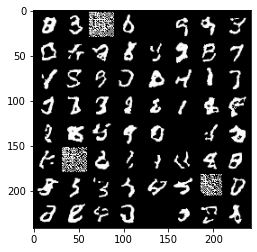

Epoch: [151/500]) Negative Log-Likelihood: -3659.390625
Epoch: [152/500]) Batch: [1/75] Negative Log-Likelihood: -3689.857177734375


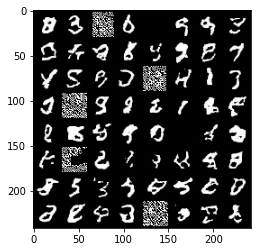

Epoch: [152/500]) Batch: [2/75] Negative Log-Likelihood: -3684.644287109375
Epoch: [152/500]) Batch: [3/75] Negative Log-Likelihood: -3694.3154296875
Epoch: [152/500]) Batch: [4/75] Negative Log-Likelihood: -3677.3681640625
Epoch: [152/500]) Batch: [5/75] Negative Log-Likelihood: -3690.690185546875
Epoch: [152/500]) Batch: [6/75] Negative Log-Likelihood: -3690.5400390625
Epoch: [152/500]) Batch: [7/75] Negative Log-Likelihood: -3681.541748046875
Epoch: [152/500]) Batch: [8/75] Negative Log-Likelihood: -3691.86865234375
Epoch: [152/500]) Batch: [9/75] Negative Log-Likelihood: -3698.78076171875
Epoch: [152/500]) Batch: [10/75] Negative Log-Likelihood: -3694.23583984375
Epoch: [152/500]) Batch: [11/75] Negative Log-Likelihood: -3688.240478515625
Epoch: [152/500]) Batch: [12/75] Negative Log-Likelihood: -3683.84375
Epoch: [152/500]) Batch: [13/75] Negative Log-Likelihood: -3683.59765625
Epoch: [152/500]) Batch: [14/75] Negative Log-Likelihood: -3689.80419921875
Epoch: [152/500]) Batch: [15

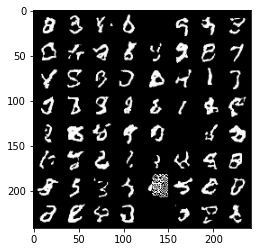

Epoch: [152/500]) Negative Log-Likelihood: -3658.1875
Epoch: [153/500]) Batch: [1/75] Negative Log-Likelihood: -3689.999267578125


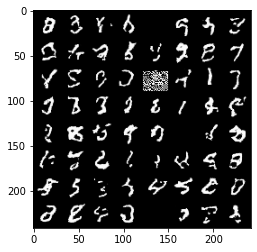

Epoch: [153/500]) Batch: [2/75] Negative Log-Likelihood: -3691.427001953125
Epoch: [153/500]) Batch: [3/75] Negative Log-Likelihood: -3697.997314453125
Epoch: [153/500]) Batch: [4/75] Negative Log-Likelihood: -3676.528076171875
Epoch: [153/500]) Batch: [5/75] Negative Log-Likelihood: -3694.338134765625
Epoch: [153/500]) Batch: [6/75] Negative Log-Likelihood: -3691.79296875
Epoch: [153/500]) Batch: [7/75] Negative Log-Likelihood: -3682.27294921875
Epoch: [153/500]) Batch: [8/75] Negative Log-Likelihood: -3690.13232421875
Epoch: [153/500]) Batch: [9/75] Negative Log-Likelihood: -3706.76025390625
Epoch: [153/500]) Batch: [10/75] Negative Log-Likelihood: -3697.044677734375
Epoch: [153/500]) Batch: [11/75] Negative Log-Likelihood: -3689.8505859375
Epoch: [153/500]) Batch: [12/75] Negative Log-Likelihood: -3689.729248046875
Epoch: [153/500]) Batch: [13/75] Negative Log-Likelihood: -3685.9345703125
Epoch: [153/500]) Batch: [14/75] Negative Log-Likelihood: -3685.804931640625
Epoch: [153/500]) 

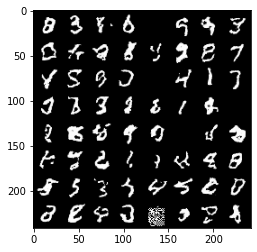

Epoch: [153/500]) Negative Log-Likelihood: -3649.704833984375
Epoch: [154/500]) Batch: [1/75] Negative Log-Likelihood: -3680.41064453125


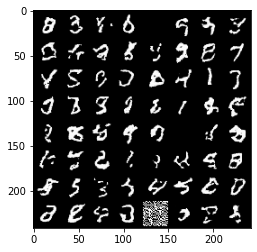

Epoch: [154/500]) Batch: [2/75] Negative Log-Likelihood: -3675.985595703125
Epoch: [154/500]) Batch: [3/75] Negative Log-Likelihood: -3690.326904296875
Epoch: [154/500]) Batch: [4/75] Negative Log-Likelihood: -3675.077392578125
Epoch: [154/500]) Batch: [5/75] Negative Log-Likelihood: -3676.435546875
Epoch: [154/500]) Batch: [6/75] Negative Log-Likelihood: -3687.081787109375
Epoch: [154/500]) Batch: [7/75] Negative Log-Likelihood: -3676.63232421875
Epoch: [154/500]) Batch: [8/75] Negative Log-Likelihood: -3683.328125
Epoch: [154/500]) Batch: [9/75] Negative Log-Likelihood: -3699.621826171875
Epoch: [154/500]) Batch: [10/75] Negative Log-Likelihood: -3695.8828125
Epoch: [154/500]) Batch: [11/75] Negative Log-Likelihood: -3689.784912109375
Epoch: [154/500]) Batch: [12/75] Negative Log-Likelihood: -3690.9384765625
Epoch: [154/500]) Batch: [13/75] Negative Log-Likelihood: -3684.531494140625
Epoch: [154/500]) Batch: [14/75] Negative Log-Likelihood: -3683.8935546875
Epoch: [154/500]) Batch: [

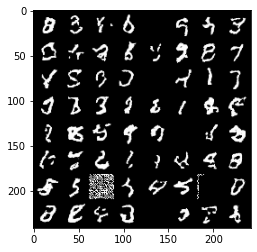

Epoch: [154/500]) Negative Log-Likelihood: -3667.47119140625
Epoch: [155/500]) Batch: [1/75] Negative Log-Likelihood: -3692.30908203125


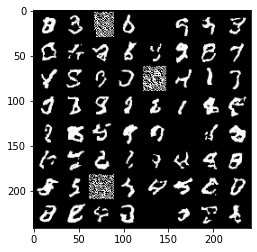

Epoch: [155/500]) Batch: [2/75] Negative Log-Likelihood: -3688.232421875
Epoch: [155/500]) Batch: [3/75] Negative Log-Likelihood: -3696.3662109375
Epoch: [155/500]) Batch: [4/75] Negative Log-Likelihood: -3680.6865234375
Epoch: [155/500]) Batch: [5/75] Negative Log-Likelihood: -3689.172119140625
Epoch: [155/500]) Batch: [6/75] Negative Log-Likelihood: -3678.72998046875
Epoch: [155/500]) Batch: [7/75] Negative Log-Likelihood: -3681.72998046875
Epoch: [155/500]) Batch: [8/75] Negative Log-Likelihood: -3686.00927734375
Epoch: [155/500]) Batch: [9/75] Negative Log-Likelihood: -3691.973876953125
Epoch: [155/500]) Batch: [10/75] Negative Log-Likelihood: -3691.915283203125
Epoch: [155/500]) Batch: [11/75] Negative Log-Likelihood: -3681.748046875
Epoch: [155/500]) Batch: [12/75] Negative Log-Likelihood: -3686.658447265625
Epoch: [155/500]) Batch: [13/75] Negative Log-Likelihood: -3688.536865234375
Epoch: [155/500]) Batch: [14/75] Negative Log-Likelihood: -3682.637939453125
Epoch: [155/500]) Ba

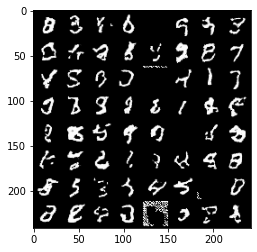

Epoch: [155/500]) Negative Log-Likelihood: -3656.36865234375
Epoch: [156/500]) Batch: [1/75] Negative Log-Likelihood: -3689.657470703125


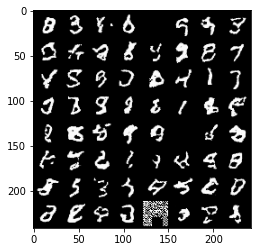

Epoch: [156/500]) Batch: [2/75] Negative Log-Likelihood: -3683.561279296875
Epoch: [156/500]) Batch: [3/75] Negative Log-Likelihood: -3689.883056640625
Epoch: [156/500]) Batch: [4/75] Negative Log-Likelihood: -3679.969970703125
Epoch: [156/500]) Batch: [5/75] Negative Log-Likelihood: -3681.858642578125
Epoch: [156/500]) Batch: [6/75] Negative Log-Likelihood: -3683.65625
Epoch: [156/500]) Batch: [7/75] Negative Log-Likelihood: -3682.35546875
Epoch: [156/500]) Batch: [8/75] Negative Log-Likelihood: -3688.924072265625
Epoch: [156/500]) Batch: [9/75] Negative Log-Likelihood: -3699.138916015625
Epoch: [156/500]) Batch: [10/75] Negative Log-Likelihood: -3695.7802734375
Epoch: [156/500]) Batch: [11/75] Negative Log-Likelihood: -3694.604248046875
Epoch: [156/500]) Batch: [12/75] Negative Log-Likelihood: -3690.473876953125
Epoch: [156/500]) Batch: [13/75] Negative Log-Likelihood: -3678.6787109375
Epoch: [156/500]) Batch: [14/75] Negative Log-Likelihood: -3693.143310546875
Epoch: [156/500]) Batc

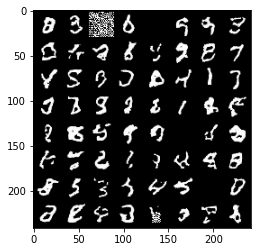

Epoch: [156/500]) Negative Log-Likelihood: -3661.592529296875
Epoch: [157/500]) Batch: [1/75] Negative Log-Likelihood: -3680.560546875


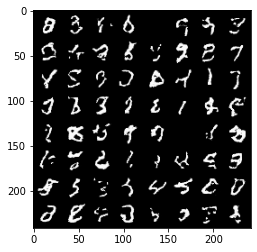

Epoch: [157/500]) Batch: [2/75] Negative Log-Likelihood: -3688.143310546875
Epoch: [157/500]) Batch: [3/75] Negative Log-Likelihood: -3694.22021484375
Epoch: [157/500]) Batch: [4/75] Negative Log-Likelihood: -3672.454833984375
Epoch: [157/500]) Batch: [5/75] Negative Log-Likelihood: -3688.929931640625
Epoch: [157/500]) Batch: [6/75] Negative Log-Likelihood: -3696.1142578125
Epoch: [157/500]) Batch: [7/75] Negative Log-Likelihood: -3680.4755859375
Epoch: [157/500]) Batch: [8/75] Negative Log-Likelihood: -3691.857666015625
Epoch: [157/500]) Batch: [9/75] Negative Log-Likelihood: -3705.0751953125
Epoch: [157/500]) Batch: [10/75] Negative Log-Likelihood: -3700.263427734375
Epoch: [157/500]) Batch: [11/75] Negative Log-Likelihood: -3697.427001953125
Epoch: [157/500]) Batch: [12/75] Negative Log-Likelihood: -3701.0068359375
Epoch: [157/500]) Batch: [13/75] Negative Log-Likelihood: -3690.619873046875
Epoch: [157/500]) Batch: [14/75] Negative Log-Likelihood: -3692.661865234375
Epoch: [157/500]

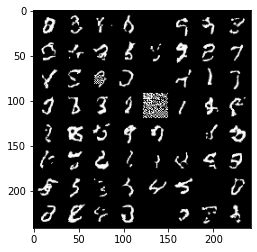

Epoch: [157/500]) Negative Log-Likelihood: -3660.75048828125
Epoch: [158/500]) Batch: [1/75] Negative Log-Likelihood: -3665.205322265625


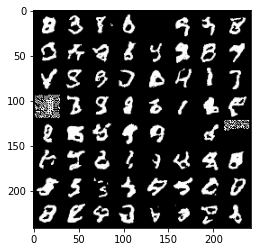

Epoch: [158/500]) Batch: [2/75] Negative Log-Likelihood: -3661.289306640625
Epoch: [158/500]) Batch: [3/75] Negative Log-Likelihood: -3679.159912109375
Epoch: [158/500]) Batch: [4/75] Negative Log-Likelihood: -3666.17138671875
Epoch: [158/500]) Batch: [5/75] Negative Log-Likelihood: -3667.54931640625
Epoch: [158/500]) Batch: [6/75] Negative Log-Likelihood: -3662.450439453125
Epoch: [158/500]) Batch: [7/75] Negative Log-Likelihood: -3664.1279296875
Epoch: [158/500]) Batch: [8/75] Negative Log-Likelihood: -3675.61376953125
Epoch: [158/500]) Batch: [9/75] Negative Log-Likelihood: -3688.591552734375
Epoch: [158/500]) Batch: [10/75] Negative Log-Likelihood: -3686.838134765625
Epoch: [158/500]) Batch: [11/75] Negative Log-Likelihood: -3684.84619140625
Epoch: [158/500]) Batch: [12/75] Negative Log-Likelihood: -3685.3291015625
Epoch: [158/500]) Batch: [13/75] Negative Log-Likelihood: -3682.3818359375
Epoch: [158/500]) Batch: [14/75] Negative Log-Likelihood: -3687.4072265625
Epoch: [158/500]) B

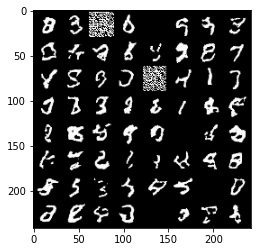

Epoch: [158/500]) Negative Log-Likelihood: -3666.629638671875
Epoch: [159/500]) Batch: [1/75] Negative Log-Likelihood: -3692.153564453125


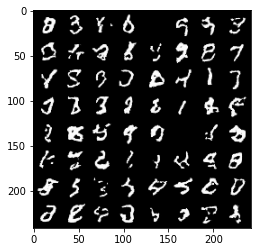

Epoch: [159/500]) Batch: [2/75] Negative Log-Likelihood: -3695.4521484375
Epoch: [159/500]) Batch: [3/75] Negative Log-Likelihood: -3697.3408203125
Epoch: [159/500]) Batch: [4/75] Negative Log-Likelihood: -3680.153076171875
Epoch: [159/500]) Batch: [5/75] Negative Log-Likelihood: -3693.552490234375
Epoch: [159/500]) Batch: [6/75] Negative Log-Likelihood: -3688.536865234375
Epoch: [159/500]) Batch: [7/75] Negative Log-Likelihood: -3687.94921875
Epoch: [159/500]) Batch: [8/75] Negative Log-Likelihood: -3686.105224609375
Epoch: [159/500]) Batch: [9/75] Negative Log-Likelihood: -3687.00927734375
Epoch: [159/500]) Batch: [10/75] Negative Log-Likelihood: -3693.3505859375
Epoch: [159/500]) Batch: [11/75] Negative Log-Likelihood: -3686.239501953125
Epoch: [159/500]) Batch: [12/75] Negative Log-Likelihood: -3681.298095703125
Epoch: [159/500]) Batch: [13/75] Negative Log-Likelihood: -3684.09619140625
Epoch: [159/500]) Batch: [14/75] Negative Log-Likelihood: -3693.864501953125
Epoch: [159/500]) B

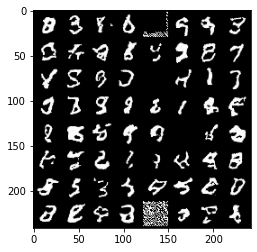

Epoch: [159/500]) Negative Log-Likelihood: -3667.78857421875
Epoch: [160/500]) Batch: [1/75] Negative Log-Likelihood: -3683.49169921875


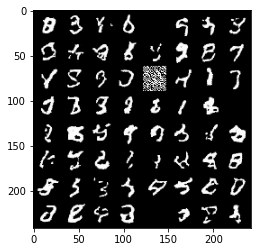

Epoch: [160/500]) Batch: [2/75] Negative Log-Likelihood: -3686.421875
Epoch: [160/500]) Batch: [3/75] Negative Log-Likelihood: -3690.586181640625
Epoch: [160/500]) Batch: [4/75] Negative Log-Likelihood: -3674.545654296875
Epoch: [160/500]) Batch: [5/75] Negative Log-Likelihood: -3688.1337890625
Epoch: [160/500]) Batch: [6/75] Negative Log-Likelihood: -3684.527099609375
Epoch: [160/500]) Batch: [7/75] Negative Log-Likelihood: -3679.95703125
Epoch: [160/500]) Batch: [8/75] Negative Log-Likelihood: -3696.54296875
Epoch: [160/500]) Batch: [9/75] Negative Log-Likelihood: -3702.0625
Epoch: [160/500]) Batch: [10/75] Negative Log-Likelihood: -3697.126220703125
Epoch: [160/500]) Batch: [11/75] Negative Log-Likelihood: -3696.02001953125
Epoch: [160/500]) Batch: [12/75] Negative Log-Likelihood: -3696.57177734375
Epoch: [160/500]) Batch: [13/75] Negative Log-Likelihood: -3685.919189453125
Epoch: [160/500]) Batch: [14/75] Negative Log-Likelihood: -3692.80078125
Epoch: [160/500]) Batch: [15/75] Nega

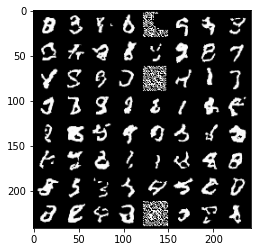

Epoch: [160/500]) Negative Log-Likelihood: -3673.54296875
Epoch: [161/500]) Batch: [1/75] Negative Log-Likelihood: -3690.434326171875


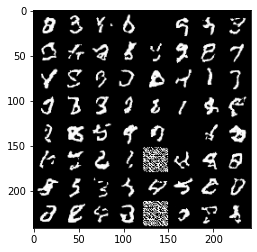

Epoch: [161/500]) Batch: [2/75] Negative Log-Likelihood: -3693.482421875
Epoch: [161/500]) Batch: [3/75] Negative Log-Likelihood: -3694.355224609375
Epoch: [161/500]) Batch: [4/75] Negative Log-Likelihood: -3670.9228515625
Epoch: [161/500]) Batch: [5/75] Negative Log-Likelihood: -3692.86181640625
Epoch: [161/500]) Batch: [6/75] Negative Log-Likelihood: -3687.421142578125
Epoch: [161/500]) Batch: [7/75] Negative Log-Likelihood: -3678.331787109375
Epoch: [161/500]) Batch: [8/75] Negative Log-Likelihood: -3695.0341796875
Epoch: [161/500]) Batch: [9/75] Negative Log-Likelihood: -3699.6875
Epoch: [161/500]) Batch: [10/75] Negative Log-Likelihood: -3698.576904296875
Epoch: [161/500]) Batch: [11/75] Negative Log-Likelihood: -3688.44482421875
Epoch: [161/500]) Batch: [12/75] Negative Log-Likelihood: -3665.701416015625
Epoch: [161/500]) Batch: [13/75] Negative Log-Likelihood: -3673.350341796875
Epoch: [161/500]) Batch: [14/75] Negative Log-Likelihood: -3686.645263671875
Epoch: [161/500]) Batch:

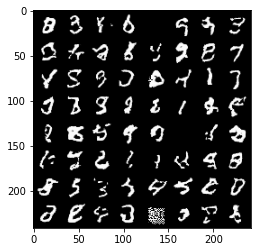

Epoch: [161/500]) Negative Log-Likelihood: -3679.368896484375
Epoch: [162/500]) Batch: [1/75] Negative Log-Likelihood: -3696.021240234375


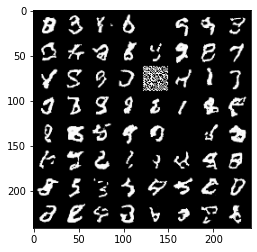

Epoch: [162/500]) Batch: [2/75] Negative Log-Likelihood: -3699.1875
Epoch: [162/500]) Batch: [3/75] Negative Log-Likelihood: -3703.94677734375
Epoch: [162/500]) Batch: [4/75] Negative Log-Likelihood: -3687.531494140625
Epoch: [162/500]) Batch: [5/75] Negative Log-Likelihood: -3698.90625
Epoch: [162/500]) Batch: [6/75] Negative Log-Likelihood: -3698.1044921875
Epoch: [162/500]) Batch: [7/75] Negative Log-Likelihood: -3693.0830078125
Epoch: [162/500]) Batch: [8/75] Negative Log-Likelihood: -3703.18701171875
Epoch: [162/500]) Batch: [9/75] Negative Log-Likelihood: -3710.59375
Epoch: [162/500]) Batch: [10/75] Negative Log-Likelihood: -3705.405029296875
Epoch: [162/500]) Batch: [11/75] Negative Log-Likelihood: -3703.412353515625
Epoch: [162/500]) Batch: [12/75] Negative Log-Likelihood: -3703.47802734375
Epoch: [162/500]) Batch: [13/75] Negative Log-Likelihood: -3693.68994140625
Epoch: [162/500]) Batch: [14/75] Negative Log-Likelihood: -3695.64111328125
Epoch: [162/500]) Batch: [15/75] Negat

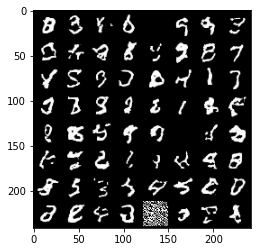

Epoch: [162/500]) Negative Log-Likelihood: -3672.605224609375
Epoch: [163/500]) Batch: [1/75] Negative Log-Likelihood: -3690.782958984375


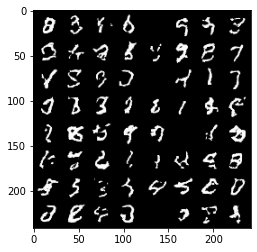

Epoch: [163/500]) Batch: [2/75] Negative Log-Likelihood: -3680.791259765625
Epoch: [163/500]) Batch: [3/75] Negative Log-Likelihood: -3679.73779296875
Epoch: [163/500]) Batch: [4/75] Negative Log-Likelihood: -3673.302490234375
Epoch: [163/500]) Batch: [5/75] Negative Log-Likelihood: -3684.750244140625
Epoch: [163/500]) Batch: [6/75] Negative Log-Likelihood: -3684.560546875
Epoch: [163/500]) Batch: [7/75] Negative Log-Likelihood: -3682.387939453125
Epoch: [163/500]) Batch: [8/75] Negative Log-Likelihood: -3695.559814453125
Epoch: [163/500]) Batch: [9/75] Negative Log-Likelihood: -3702.8603515625
Epoch: [163/500]) Batch: [10/75] Negative Log-Likelihood: -3702.782958984375
Epoch: [163/500]) Batch: [11/75] Negative Log-Likelihood: -3697.673095703125
Epoch: [163/500]) Batch: [12/75] Negative Log-Likelihood: -3698.568359375
Epoch: [163/500]) Batch: [13/75] Negative Log-Likelihood: -3693.984619140625
Epoch: [163/500]) Batch: [14/75] Negative Log-Likelihood: -3695.31396484375
Epoch: [163/500])

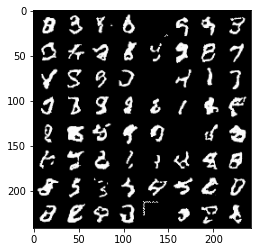

Epoch: [163/500]) Negative Log-Likelihood: -3669.8369140625
Epoch: [164/500]) Batch: [1/75] Negative Log-Likelihood: -3691.41015625


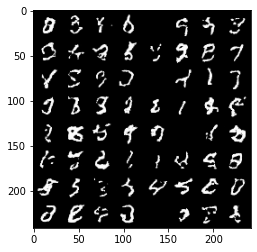

Epoch: [164/500]) Batch: [2/75] Negative Log-Likelihood: -3693.95654296875
Epoch: [164/500]) Batch: [3/75] Negative Log-Likelihood: -3700.617431640625
Epoch: [164/500]) Batch: [4/75] Negative Log-Likelihood: -3686.907470703125
Epoch: [164/500]) Batch: [5/75] Negative Log-Likelihood: -3689.729248046875
Epoch: [164/500]) Batch: [6/75] Negative Log-Likelihood: -3678.532470703125
Epoch: [164/500]) Batch: [7/75] Negative Log-Likelihood: -3682.38525390625
Epoch: [164/500]) Batch: [8/75] Negative Log-Likelihood: -3694.3935546875
Epoch: [164/500]) Batch: [9/75] Negative Log-Likelihood: -3702.2626953125
Epoch: [164/500]) Batch: [10/75] Negative Log-Likelihood: -3702.542724609375
Epoch: [164/500]) Batch: [11/75] Negative Log-Likelihood: -3700.201904296875
Epoch: [164/500]) Batch: [12/75] Negative Log-Likelihood: -3695.16015625
Epoch: [164/500]) Batch: [13/75] Negative Log-Likelihood: -3691.685791015625
Epoch: [164/500]) Batch: [14/75] Negative Log-Likelihood: -3688.725830078125
Epoch: [164/500])

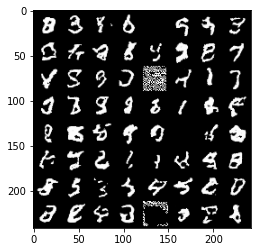

Epoch: [164/500]) Negative Log-Likelihood: -3669.667724609375
Epoch: [165/500]) Batch: [1/75] Negative Log-Likelihood: -3690.447998046875


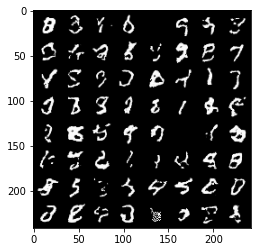

Epoch: [165/500]) Batch: [2/75] Negative Log-Likelihood: -3697.3154296875
Epoch: [165/500]) Batch: [3/75] Negative Log-Likelihood: -3703.358642578125
Epoch: [165/500]) Batch: [4/75] Negative Log-Likelihood: -3687.810302734375
Epoch: [165/500]) Batch: [5/75] Negative Log-Likelihood: -3698.0
Epoch: [165/500]) Batch: [6/75] Negative Log-Likelihood: -3696.6708984375
Epoch: [165/500]) Batch: [7/75] Negative Log-Likelihood: -3688.8955078125
Epoch: [165/500]) Batch: [8/75] Negative Log-Likelihood: -3701.5341796875
Epoch: [165/500]) Batch: [9/75] Negative Log-Likelihood: -3709.34619140625
Epoch: [165/500]) Batch: [10/75] Negative Log-Likelihood: -3706.15869140625
Epoch: [165/500]) Batch: [11/75] Negative Log-Likelihood: -3706.014892578125
Epoch: [165/500]) Batch: [12/75] Negative Log-Likelihood: -3701.8623046875
Epoch: [165/500]) Batch: [13/75] Negative Log-Likelihood: -3695.11328125
Epoch: [165/500]) Batch: [14/75] Negative Log-Likelihood: -3696.3359375
Epoch: [165/500]) Batch: [15/75] Negati

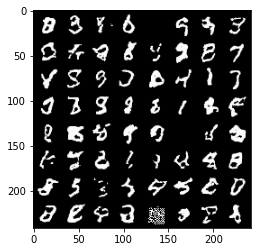

Epoch: [165/500]) Negative Log-Likelihood: -3673.9990234375
Epoch: [166/500]) Batch: [1/75] Negative Log-Likelihood: -3696.7880859375


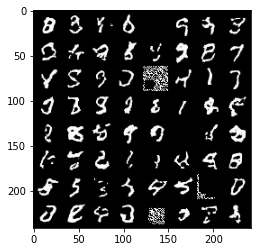

Epoch: [166/500]) Batch: [2/75] Negative Log-Likelihood: -3700.806884765625
Epoch: [166/500]) Batch: [3/75] Negative Log-Likelihood: -3705.37744140625
Epoch: [166/500]) Batch: [4/75] Negative Log-Likelihood: -3685.999267578125
Epoch: [166/500]) Batch: [5/75] Negative Log-Likelihood: -3701.8017578125
Epoch: [166/500]) Batch: [6/75] Negative Log-Likelihood: -3698.642822265625
Epoch: [166/500]) Batch: [7/75] Negative Log-Likelihood: -3690.6845703125
Epoch: [166/500]) Batch: [8/75] Negative Log-Likelihood: -3704.109375
Epoch: [166/500]) Batch: [9/75] Negative Log-Likelihood: -3712.484375
Epoch: [166/500]) Batch: [10/75] Negative Log-Likelihood: -3707.2919921875
Epoch: [166/500]) Batch: [11/75] Negative Log-Likelihood: -3707.63671875
Epoch: [166/500]) Batch: [12/75] Negative Log-Likelihood: -3694.04052734375
Epoch: [166/500]) Batch: [13/75] Negative Log-Likelihood: -3670.845947265625
Epoch: [166/500]) Batch: [14/75] Negative Log-Likelihood: -3692.6650390625
Epoch: [166/500]) Batch: [15/75] 

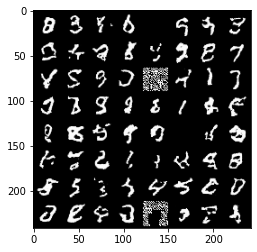

Epoch: [166/500]) Negative Log-Likelihood: -3674.84765625
Epoch: [167/500]) Batch: [1/75] Negative Log-Likelihood: -3691.2060546875


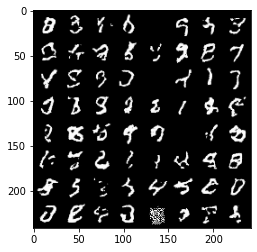

Epoch: [167/500]) Batch: [2/75] Negative Log-Likelihood: -3695.78369140625
Epoch: [167/500]) Batch: [3/75] Negative Log-Likelihood: -3700.684326171875
Epoch: [167/500]) Batch: [4/75] Negative Log-Likelihood: -3684.802490234375
Epoch: [167/500]) Batch: [5/75] Negative Log-Likelihood: -3694.361083984375
Epoch: [167/500]) Batch: [6/75] Negative Log-Likelihood: -3689.5498046875
Epoch: [167/500]) Batch: [7/75] Negative Log-Likelihood: -3687.07421875
Epoch: [167/500]) Batch: [8/75] Negative Log-Likelihood: -3690.575439453125
Epoch: [167/500]) Batch: [9/75] Negative Log-Likelihood: -3708.341796875
Epoch: [167/500]) Batch: [10/75] Negative Log-Likelihood: -3694.494873046875
Epoch: [167/500]) Batch: [11/75] Negative Log-Likelihood: -3671.929931640625
Epoch: [167/500]) Batch: [12/75] Negative Log-Likelihood: -3685.946533203125
Epoch: [167/500]) Batch: [13/75] Negative Log-Likelihood: -3689.529541015625
Epoch: [167/500]) Batch: [14/75] Negative Log-Likelihood: -3685.78857421875
Epoch: [167/500]) 

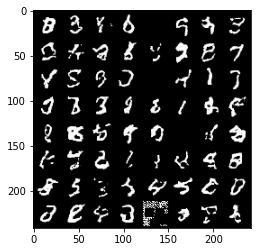

Epoch: [167/500]) Negative Log-Likelihood: -3664.924560546875
Epoch: [168/500]) Batch: [1/75] Negative Log-Likelihood: -3690.557373046875


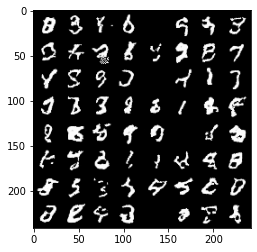

Epoch: [168/500]) Batch: [2/75] Negative Log-Likelihood: -3689.013427734375
Epoch: [168/500]) Batch: [3/75] Negative Log-Likelihood: -3699.302490234375
Epoch: [168/500]) Batch: [4/75] Negative Log-Likelihood: -3685.1455078125
Epoch: [168/500]) Batch: [5/75] Negative Log-Likelihood: -3695.029296875
Epoch: [168/500]) Batch: [6/75] Negative Log-Likelihood: -3695.60302734375
Epoch: [168/500]) Batch: [7/75] Negative Log-Likelihood: -3686.619873046875
Epoch: [168/500]) Batch: [8/75] Negative Log-Likelihood: -3687.31494140625
Epoch: [168/500]) Batch: [9/75] Negative Log-Likelihood: -3691.41552734375
Epoch: [168/500]) Batch: [10/75] Negative Log-Likelihood: -3698.934814453125
Epoch: [168/500]) Batch: [11/75] Negative Log-Likelihood: -3683.242431640625
Epoch: [168/500]) Batch: [12/75] Negative Log-Likelihood: -3682.421142578125
Epoch: [168/500]) Batch: [13/75] Negative Log-Likelihood: -3683.826416015625
Epoch: [168/500]) Batch: [14/75] Negative Log-Likelihood: -3682.106201171875
Epoch: [168/500

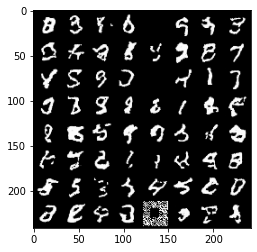

Epoch: [168/500]) Negative Log-Likelihood: -3666.5869140625
Epoch: [169/500]) Batch: [1/75] Negative Log-Likelihood: -3686.58251953125


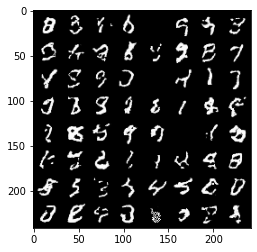

Epoch: [169/500]) Batch: [2/75] Negative Log-Likelihood: -3691.543701171875
Epoch: [169/500]) Batch: [3/75] Negative Log-Likelihood: -3703.263916015625
Epoch: [169/500]) Batch: [4/75] Negative Log-Likelihood: -3683.5390625
Epoch: [169/500]) Batch: [5/75] Negative Log-Likelihood: -3696.89013671875
Epoch: [169/500]) Batch: [6/75] Negative Log-Likelihood: -3694.39501953125
Epoch: [169/500]) Batch: [7/75] Negative Log-Likelihood: -3687.270263671875
Epoch: [169/500]) Batch: [8/75] Negative Log-Likelihood: -3699.396240234375
Epoch: [169/500]) Batch: [9/75] Negative Log-Likelihood: -3709.474853515625
Epoch: [169/500]) Batch: [10/75] Negative Log-Likelihood: -3706.5029296875
Epoch: [169/500]) Batch: [11/75] Negative Log-Likelihood: -3699.792724609375
Epoch: [169/500]) Batch: [12/75] Negative Log-Likelihood: -3701.0498046875
Epoch: [169/500]) Batch: [13/75] Negative Log-Likelihood: -3699.231201171875
Epoch: [169/500]) Batch: [14/75] Negative Log-Likelihood: -3703.69921875
Epoch: [169/500]) Batc

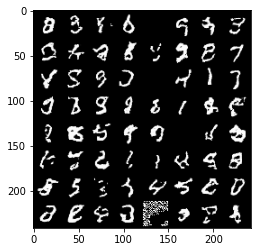

Epoch: [169/500]) Negative Log-Likelihood: -3666.177001953125
Epoch: [170/500]) Batch: [1/75] Negative Log-Likelihood: -3684.5361328125


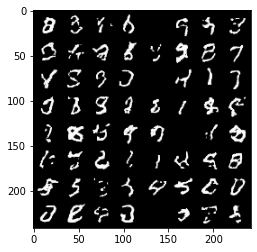

Epoch: [170/500]) Batch: [2/75] Negative Log-Likelihood: -3685.155517578125
Epoch: [170/500]) Batch: [3/75] Negative Log-Likelihood: -3691.363037109375
Epoch: [170/500]) Batch: [4/75] Negative Log-Likelihood: -3682.20703125
Epoch: [170/500]) Batch: [5/75] Negative Log-Likelihood: -3690.62548828125
Epoch: [170/500]) Batch: [6/75] Negative Log-Likelihood: -3697.954345703125
Epoch: [170/500]) Batch: [7/75] Negative Log-Likelihood: -3684.331787109375
Epoch: [170/500]) Batch: [8/75] Negative Log-Likelihood: -3695.219970703125
Epoch: [170/500]) Batch: [9/75] Negative Log-Likelihood: -3704.6962890625
Epoch: [170/500]) Batch: [10/75] Negative Log-Likelihood: -3697.89013671875
Epoch: [170/500]) Batch: [11/75] Negative Log-Likelihood: -3703.20361328125
Epoch: [170/500]) Batch: [12/75] Negative Log-Likelihood: -3701.19677734375
Epoch: [170/500]) Batch: [13/75] Negative Log-Likelihood: -3693.733154296875
Epoch: [170/500]) Batch: [14/75] Negative Log-Likelihood: -3698.287109375
Epoch: [170/500]) Ba

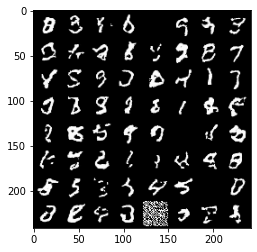

Epoch: [170/500]) Negative Log-Likelihood: -3669.657958984375
Epoch: [171/500]) Batch: [1/75] Negative Log-Likelihood: -3689.1865234375


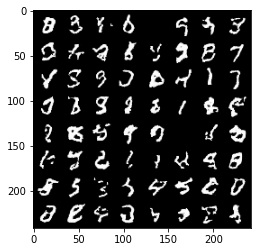

Epoch: [171/500]) Batch: [2/75] Negative Log-Likelihood: -3690.341064453125
Epoch: [171/500]) Batch: [3/75] Negative Log-Likelihood: -3700.84326171875
Epoch: [171/500]) Batch: [4/75] Negative Log-Likelihood: -3688.40673828125
Epoch: [171/500]) Batch: [5/75] Negative Log-Likelihood: -3694.3515625
Epoch: [171/500]) Batch: [6/75] Negative Log-Likelihood: -3694.2294921875
Epoch: [171/500]) Batch: [7/75] Negative Log-Likelihood: -3689.39111328125
Epoch: [171/500]) Batch: [8/75] Negative Log-Likelihood: -3703.5419921875
Epoch: [171/500]) Batch: [9/75] Negative Log-Likelihood: -3709.5498046875
Epoch: [171/500]) Batch: [10/75] Negative Log-Likelihood: -3706.27734375
Epoch: [171/500]) Batch: [11/75] Negative Log-Likelihood: -3705.344970703125
Epoch: [171/500]) Batch: [12/75] Negative Log-Likelihood: -3705.269287109375
Epoch: [171/500]) Batch: [13/75] Negative Log-Likelihood: -3690.552001953125
Epoch: [171/500]) Batch: [14/75] Negative Log-Likelihood: -3690.243408203125
Epoch: [171/500]) Batch: 

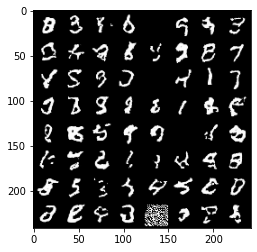

Epoch: [171/500]) Negative Log-Likelihood: -3670.279541015625
Epoch: [172/500]) Batch: [1/75] Negative Log-Likelihood: -3696.40087890625


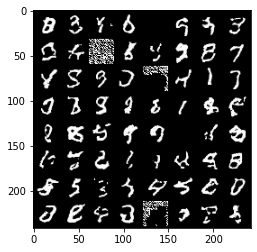

Epoch: [172/500]) Batch: [2/75] Negative Log-Likelihood: -3696.805908203125
Epoch: [172/500]) Batch: [3/75] Negative Log-Likelihood: -3702.55859375
Epoch: [172/500]) Batch: [4/75] Negative Log-Likelihood: -3690.224609375
Epoch: [172/500]) Batch: [5/75] Negative Log-Likelihood: -3697.5830078125
Epoch: [172/500]) Batch: [6/75] Negative Log-Likelihood: -3700.35986328125
Epoch: [172/500]) Batch: [7/75] Negative Log-Likelihood: -3688.744384765625
Epoch: [172/500]) Batch: [8/75] Negative Log-Likelihood: -3706.045654296875
Epoch: [172/500]) Batch: [9/75] Negative Log-Likelihood: -3709.13623046875
Epoch: [172/500]) Batch: [10/75] Negative Log-Likelihood: -3706.595458984375
Epoch: [172/500]) Batch: [11/75] Negative Log-Likelihood: -3699.19921875
Epoch: [172/500]) Batch: [12/75] Negative Log-Likelihood: -3696.583984375
Epoch: [172/500]) Batch: [13/75] Negative Log-Likelihood: -3695.155029296875
Epoch: [172/500]) Batch: [14/75] Negative Log-Likelihood: -3698.44677734375
Epoch: [172/500]) Batch: [

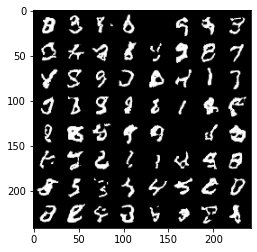

Epoch: [172/500]) Negative Log-Likelihood: -3671.85546875
Epoch: [173/500]) Batch: [1/75] Negative Log-Likelihood: -3699.256103515625


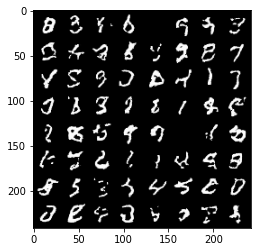

Epoch: [173/500]) Batch: [2/75] Negative Log-Likelihood: -3698.28955078125
Epoch: [173/500]) Batch: [3/75] Negative Log-Likelihood: -3703.639404296875
Epoch: [173/500]) Batch: [4/75] Negative Log-Likelihood: -3685.271240234375
Epoch: [173/500]) Batch: [5/75] Negative Log-Likelihood: -3688.8056640625
Epoch: [173/500]) Batch: [6/75] Negative Log-Likelihood: -3697.888427734375
Epoch: [173/500]) Batch: [7/75] Negative Log-Likelihood: -3684.028076171875
Epoch: [173/500]) Batch: [8/75] Negative Log-Likelihood: -3697.00341796875
Epoch: [173/500]) Batch: [9/75] Negative Log-Likelihood: -3708.666259765625
Epoch: [173/500]) Batch: [10/75] Negative Log-Likelihood: -3698.0869140625
Epoch: [173/500]) Batch: [11/75] Negative Log-Likelihood: -3694.13671875
Epoch: [173/500]) Batch: [12/75] Negative Log-Likelihood: -3703.293701171875
Epoch: [173/500]) Batch: [13/75] Negative Log-Likelihood: -3689.147705078125
Epoch: [173/500]) Batch: [14/75] Negative Log-Likelihood: -3697.35302734375
Epoch: [173/500]) 

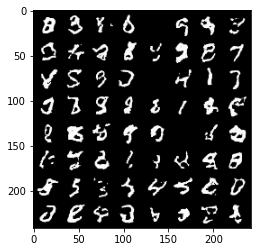

Epoch: [173/500]) Negative Log-Likelihood: -3677.847412109375
Epoch: [174/500]) Batch: [1/75] Negative Log-Likelihood: -3698.204833984375


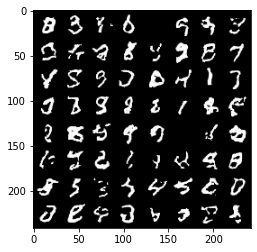

Epoch: [174/500]) Batch: [2/75] Negative Log-Likelihood: -3696.212158203125
Epoch: [174/500]) Batch: [3/75] Negative Log-Likelihood: -3700.736083984375
Epoch: [174/500]) Batch: [4/75] Negative Log-Likelihood: -3684.49169921875
Epoch: [174/500]) Batch: [5/75] Negative Log-Likelihood: -3698.04736328125
Epoch: [174/500]) Batch: [6/75] Negative Log-Likelihood: -3694.919921875
Epoch: [174/500]) Batch: [7/75] Negative Log-Likelihood: -3689.57177734375
Epoch: [174/500]) Batch: [8/75] Negative Log-Likelihood: -3696.4580078125
Epoch: [174/500]) Batch: [9/75] Negative Log-Likelihood: -3708.806884765625
Epoch: [174/500]) Batch: [10/75] Negative Log-Likelihood: -3705.040771484375
Epoch: [174/500]) Batch: [11/75] Negative Log-Likelihood: -3705.2998046875
Epoch: [174/500]) Batch: [12/75] Negative Log-Likelihood: -3703.298095703125
Epoch: [174/500]) Batch: [13/75] Negative Log-Likelihood: -3688.330810546875
Epoch: [174/500]) Batch: [14/75] Negative Log-Likelihood: -3691.85498046875
Epoch: [174/500]) 

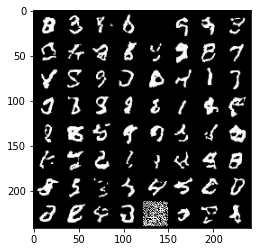

Epoch: [174/500]) Negative Log-Likelihood: -3675.50439453125
Epoch: [175/500]) Batch: [1/75] Negative Log-Likelihood: -3697.772216796875


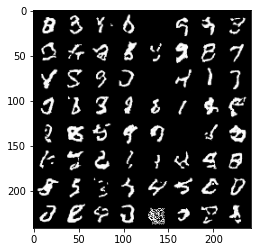

Epoch: [175/500]) Batch: [2/75] Negative Log-Likelihood: -3693.94140625
Epoch: [175/500]) Batch: [3/75] Negative Log-Likelihood: -3700.724609375
Epoch: [175/500]) Batch: [4/75] Negative Log-Likelihood: -3687.5556640625
Epoch: [175/500]) Batch: [5/75] Negative Log-Likelihood: -3695.41650390625
Epoch: [175/500]) Batch: [6/75] Negative Log-Likelihood: -3697.9736328125
Epoch: [175/500]) Batch: [7/75] Negative Log-Likelihood: -3687.23681640625
Epoch: [175/500]) Batch: [8/75] Negative Log-Likelihood: -3698.091552734375
Epoch: [175/500]) Batch: [9/75] Negative Log-Likelihood: -3706.032470703125
Epoch: [175/500]) Batch: [10/75] Negative Log-Likelihood: -3701.86376953125
Epoch: [175/500]) Batch: [11/75] Negative Log-Likelihood: -3696.9599609375
Epoch: [175/500]) Batch: [12/75] Negative Log-Likelihood: -3703.283935546875
Epoch: [175/500]) Batch: [13/75] Negative Log-Likelihood: -3692.725830078125
Epoch: [175/500]) Batch: [14/75] Negative Log-Likelihood: -3703.159912109375
Epoch: [175/500]) Batch

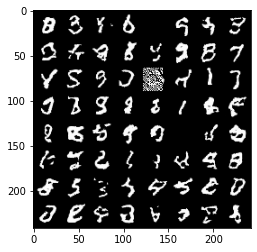

Epoch: [175/500]) Negative Log-Likelihood: -3666.52685546875
Epoch: [176/500]) Batch: [1/75] Negative Log-Likelihood: -3690.24560546875


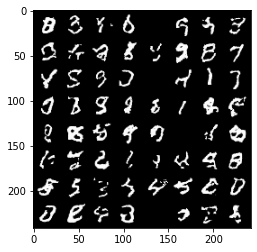

Epoch: [176/500]) Batch: [2/75] Negative Log-Likelihood: -3694.443603515625
Epoch: [176/500]) Batch: [3/75] Negative Log-Likelihood: -3697.447509765625
Epoch: [176/500]) Batch: [4/75] Negative Log-Likelihood: -3678.94970703125
Epoch: [176/500]) Batch: [5/75] Negative Log-Likelihood: -3693.3974609375
Epoch: [176/500]) Batch: [6/75] Negative Log-Likelihood: -3697.482177734375
Epoch: [176/500]) Batch: [7/75] Negative Log-Likelihood: -3686.521484375
Epoch: [176/500]) Batch: [8/75] Negative Log-Likelihood: -3699.06494140625
Epoch: [176/500]) Batch: [9/75] Negative Log-Likelihood: -3705.242431640625
Epoch: [176/500]) Batch: [10/75] Negative Log-Likelihood: -3703.234375
Epoch: [176/500]) Batch: [11/75] Negative Log-Likelihood: -3703.0400390625
Epoch: [176/500]) Batch: [12/75] Negative Log-Likelihood: -3701.467529296875
Epoch: [176/500]) Batch: [13/75] Negative Log-Likelihood: -3696.59619140625
Epoch: [176/500]) Batch: [14/75] Negative Log-Likelihood: -3703.1123046875
Epoch: [176/500]) Batch: 

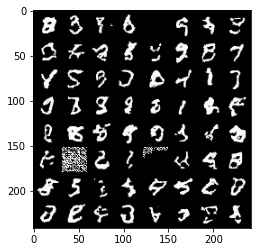

Epoch: [176/500]) Negative Log-Likelihood: -3657.778076171875
Epoch: [177/500]) Batch: [1/75] Negative Log-Likelihood: -3684.260498046875


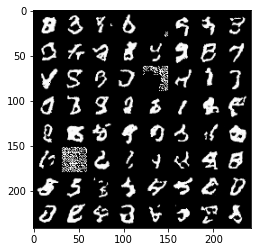

Epoch: [177/500]) Batch: [2/75] Negative Log-Likelihood: -3687.505859375
Epoch: [177/500]) Batch: [3/75] Negative Log-Likelihood: -3694.09033203125
Epoch: [177/500]) Batch: [4/75] Negative Log-Likelihood: -3680.42138671875
Epoch: [177/500]) Batch: [5/75] Negative Log-Likelihood: -3687.64990234375
Epoch: [177/500]) Batch: [6/75] Negative Log-Likelihood: -3693.931884765625
Epoch: [177/500]) Batch: [7/75] Negative Log-Likelihood: -3677.184814453125
Epoch: [177/500]) Batch: [8/75] Negative Log-Likelihood: -3692.091796875
Epoch: [177/500]) Batch: [9/75] Negative Log-Likelihood: -3700.90869140625
Epoch: [177/500]) Batch: [10/75] Negative Log-Likelihood: -3689.820556640625
Epoch: [177/500]) Batch: [11/75] Negative Log-Likelihood: -3688.9794921875
Epoch: [177/500]) Batch: [12/75] Negative Log-Likelihood: -3699.36669921875
Epoch: [177/500]) Batch: [13/75] Negative Log-Likelihood: -3678.130859375
Epoch: [177/500]) Batch: [14/75] Negative Log-Likelihood: -3664.93994140625
Epoch: [177/500]) Batch:

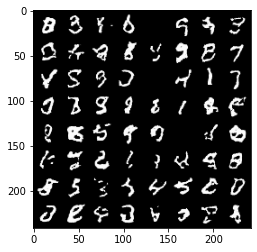

Epoch: [177/500]) Negative Log-Likelihood: -3679.477783203125
Epoch: [178/500]) Batch: [1/75] Negative Log-Likelihood: -3704.504638671875


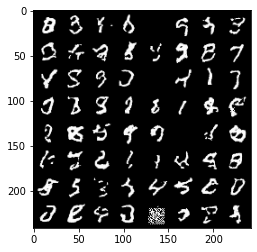

Epoch: [178/500]) Batch: [2/75] Negative Log-Likelihood: -3701.09375
Epoch: [178/500]) Batch: [3/75] Negative Log-Likelihood: -3708.074951171875
Epoch: [178/500]) Batch: [4/75] Negative Log-Likelihood: -3689.859375
Epoch: [178/500]) Batch: [5/75] Negative Log-Likelihood: -3700.318115234375
Epoch: [178/500]) Batch: [6/75] Negative Log-Likelihood: -3700.89501953125
Epoch: [178/500]) Batch: [7/75] Negative Log-Likelihood: -3694.822998046875
Epoch: [178/500]) Batch: [8/75] Negative Log-Likelihood: -3705.924560546875
Epoch: [178/500]) Batch: [9/75] Negative Log-Likelihood: -3714.29248046875
Epoch: [178/500]) Batch: [10/75] Negative Log-Likelihood: -3708.92138671875
Epoch: [178/500]) Batch: [11/75] Negative Log-Likelihood: -3710.30078125
Epoch: [178/500]) Batch: [12/75] Negative Log-Likelihood: -3702.135498046875
Epoch: [178/500]) Batch: [13/75] Negative Log-Likelihood: -3698.1162109375
Epoch: [178/500]) Batch: [14/75] Negative Log-Likelihood: -3701.140869140625
Epoch: [178/500]) Batch: [15/

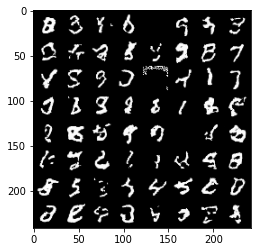

Epoch: [178/500]) Negative Log-Likelihood: -3671.212158203125
Epoch: [179/500]) Batch: [1/75] Negative Log-Likelihood: -3698.1572265625


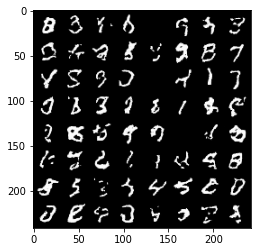

Epoch: [179/500]) Batch: [2/75] Negative Log-Likelihood: -3699.638671875
Epoch: [179/500]) Batch: [3/75] Negative Log-Likelihood: -3705.106201171875
Epoch: [179/500]) Batch: [4/75] Negative Log-Likelihood: -3685.978271484375
Epoch: [179/500]) Batch: [5/75] Negative Log-Likelihood: -3701.970458984375
Epoch: [179/500]) Batch: [6/75] Negative Log-Likelihood: -3688.183349609375
Epoch: [179/500]) Batch: [7/75] Negative Log-Likelihood: -3664.666748046875
Epoch: [179/500]) Batch: [8/75] Negative Log-Likelihood: -3680.1611328125
Epoch: [179/500]) Batch: [9/75] Negative Log-Likelihood: -3699.72607421875
Epoch: [179/500]) Batch: [10/75] Negative Log-Likelihood: -3697.6875
Epoch: [179/500]) Batch: [11/75] Negative Log-Likelihood: -3690.22216796875
Epoch: [179/500]) Batch: [12/75] Negative Log-Likelihood: -3692.01123046875
Epoch: [179/500]) Batch: [13/75] Negative Log-Likelihood: -3693.009033203125
Epoch: [179/500]) Batch: [14/75] Negative Log-Likelihood: -3697.591552734375
Epoch: [179/500]) Batch

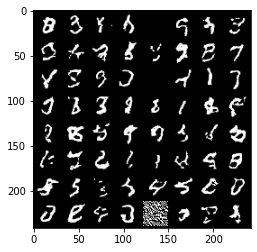

Epoch: [179/500]) Negative Log-Likelihood: -3675.859375
Epoch: [180/500]) Batch: [1/75] Negative Log-Likelihood: -3688.990966796875


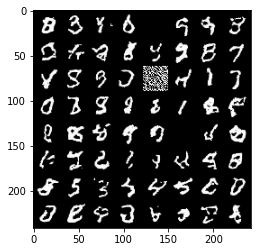

Epoch: [180/500]) Batch: [2/75] Negative Log-Likelihood: -3684.87890625
Epoch: [180/500]) Batch: [3/75] Negative Log-Likelihood: -3695.9853515625
Epoch: [180/500]) Batch: [4/75] Negative Log-Likelihood: -3678.02734375
Epoch: [180/500]) Batch: [5/75] Negative Log-Likelihood: -3690.0263671875
Epoch: [180/500]) Batch: [6/75] Negative Log-Likelihood: -3691.041259765625
Epoch: [180/500]) Batch: [7/75] Negative Log-Likelihood: -3680.247802734375
Epoch: [180/500]) Batch: [8/75] Negative Log-Likelihood: -3697.36669921875
Epoch: [180/500]) Batch: [9/75] Negative Log-Likelihood: -3706.09619140625
Epoch: [180/500]) Batch: [10/75] Negative Log-Likelihood: -3701.840576171875
Epoch: [180/500]) Batch: [11/75] Negative Log-Likelihood: -3702.714599609375
Epoch: [180/500]) Batch: [12/75] Negative Log-Likelihood: -3700.381103515625
Epoch: [180/500]) Batch: [13/75] Negative Log-Likelihood: -3696.40966796875
Epoch: [180/500]) Batch: [14/75] Negative Log-Likelihood: -3693.62060546875
Epoch: [180/500]) Batch

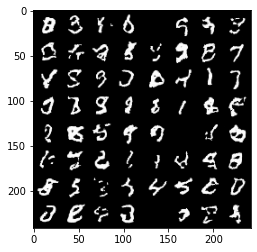

Epoch: [180/500]) Negative Log-Likelihood: -3682.411865234375
Epoch: [181/500]) Batch: [1/75] Negative Log-Likelihood: -3700.4775390625


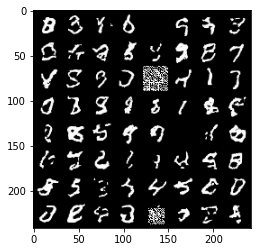

Epoch: [181/500]) Batch: [2/75] Negative Log-Likelihood: -3699.91748046875
Epoch: [181/500]) Batch: [3/75] Negative Log-Likelihood: -3707.097412109375
Epoch: [181/500]) Batch: [4/75] Negative Log-Likelihood: -3688.53125
Epoch: [181/500]) Batch: [5/75] Negative Log-Likelihood: -3700.623046875
Epoch: [181/500]) Batch: [6/75] Negative Log-Likelihood: -3701.633056640625
Epoch: [181/500]) Batch: [7/75] Negative Log-Likelihood: -3693.753662109375
Epoch: [181/500]) Batch: [8/75] Negative Log-Likelihood: -3696.37939453125
Epoch: [181/500]) Batch: [9/75] Negative Log-Likelihood: -3698.2529296875
Epoch: [181/500]) Batch: [10/75] Negative Log-Likelihood: -3700.1982421875
Epoch: [181/500]) Batch: [11/75] Negative Log-Likelihood: -3709.171142578125
Epoch: [181/500]) Batch: [12/75] Negative Log-Likelihood: -3697.999267578125
Epoch: [181/500]) Batch: [13/75] Negative Log-Likelihood: -3691.2568359375
Epoch: [181/500]) Batch: [14/75] Negative Log-Likelihood: -3699.193603515625
Epoch: [181/500]) Batch: 

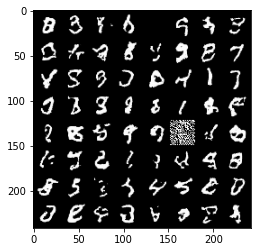

Epoch: [181/500]) Negative Log-Likelihood: -3664.6298828125
Epoch: [182/500]) Batch: [1/75] Negative Log-Likelihood: -3686.0654296875


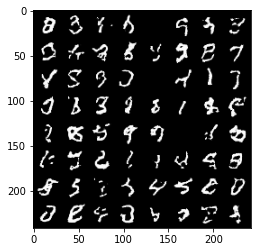

Epoch: [182/500]) Batch: [2/75] Negative Log-Likelihood: -3696.408447265625
Epoch: [182/500]) Batch: [3/75] Negative Log-Likelihood: -3699.904296875
Epoch: [182/500]) Batch: [4/75] Negative Log-Likelihood: -3675.98876953125
Epoch: [182/500]) Batch: [5/75] Negative Log-Likelihood: -3692.536865234375
Epoch: [182/500]) Batch: [6/75] Negative Log-Likelihood: -3693.619873046875
Epoch: [182/500]) Batch: [7/75] Negative Log-Likelihood: -3677.62548828125
Epoch: [182/500]) Batch: [8/75] Negative Log-Likelihood: -3697.026123046875
Epoch: [182/500]) Batch: [9/75] Negative Log-Likelihood: -3700.25146484375
Epoch: [182/500]) Batch: [10/75] Negative Log-Likelihood: -3691.5693359375
Epoch: [182/500]) Batch: [11/75] Negative Log-Likelihood: -3692.58984375
Epoch: [182/500]) Batch: [12/75] Negative Log-Likelihood: -3694.809814453125
Epoch: [182/500]) Batch: [13/75] Negative Log-Likelihood: -3692.219970703125
Epoch: [182/500]) Batch: [14/75] Negative Log-Likelihood: -3694.049560546875
Epoch: [182/500]) B

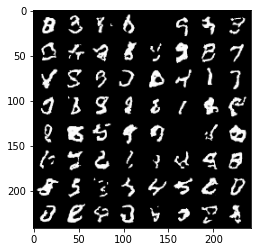

Epoch: [182/500]) Negative Log-Likelihood: -3674.67529296875
Epoch: [183/500]) Batch: [1/75] Negative Log-Likelihood: -3683.49560546875


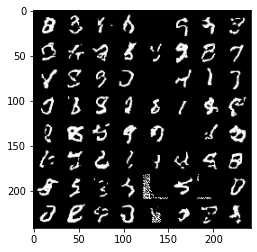

Epoch: [183/500]) Batch: [2/75] Negative Log-Likelihood: -3696.412353515625
Epoch: [183/500]) Batch: [3/75] Negative Log-Likelihood: -3697.700927734375
Epoch: [183/500]) Batch: [4/75] Negative Log-Likelihood: -3678.35205078125
Epoch: [183/500]) Batch: [5/75] Negative Log-Likelihood: -3696.367431640625
Epoch: [183/500]) Batch: [6/75] Negative Log-Likelihood: -3689.51953125
Epoch: [183/500]) Batch: [7/75] Negative Log-Likelihood: -3683.4404296875
Epoch: [183/500]) Batch: [8/75] Negative Log-Likelihood: -3689.973388671875
Epoch: [183/500]) Batch: [9/75] Negative Log-Likelihood: -3689.88720703125
Epoch: [183/500]) Batch: [10/75] Negative Log-Likelihood: -3685.3466796875
Epoch: [183/500]) Batch: [11/75] Negative Log-Likelihood: -3695.581787109375
Epoch: [183/500]) Batch: [12/75] Negative Log-Likelihood: -3694.088623046875
Epoch: [183/500]) Batch: [13/75] Negative Log-Likelihood: -3688.15625
Epoch: [183/500]) Batch: [14/75] Negative Log-Likelihood: -3698.158447265625
Epoch: [183/500]) Batch:

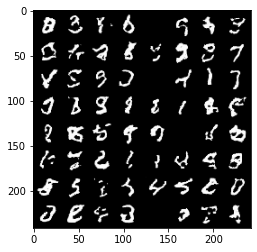

Epoch: [183/500]) Negative Log-Likelihood: -3659.90673828125
Epoch: [184/500]) Batch: [1/75] Negative Log-Likelihood: -3688.07373046875


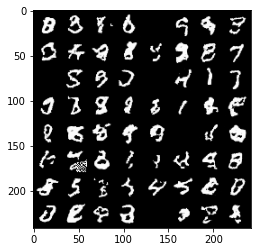

Epoch: [184/500]) Batch: [2/75] Negative Log-Likelihood: -3682.02685546875
Epoch: [184/500]) Batch: [3/75] Negative Log-Likelihood: -3691.95556640625
Epoch: [184/500]) Batch: [4/75] Negative Log-Likelihood: -3677.56982421875
Epoch: [184/500]) Batch: [5/75] Negative Log-Likelihood: -3684.262939453125
Epoch: [184/500]) Batch: [6/75] Negative Log-Likelihood: -3686.732666015625
Epoch: [184/500]) Batch: [7/75] Negative Log-Likelihood: -3688.70361328125
Epoch: [184/500]) Batch: [8/75] Negative Log-Likelihood: -3689.489501953125
Epoch: [184/500]) Batch: [9/75] Negative Log-Likelihood: -3700.262451171875
Epoch: [184/500]) Batch: [10/75] Negative Log-Likelihood: -3699.876708984375
Epoch: [184/500]) Batch: [11/75] Negative Log-Likelihood: -3682.028076171875
Epoch: [184/500]) Batch: [12/75] Negative Log-Likelihood: -3691.75439453125
Epoch: [184/500]) Batch: [13/75] Negative Log-Likelihood: -3688.18896484375
Epoch: [184/500]) Batch: [14/75] Negative Log-Likelihood: -3689.0986328125
Epoch: [184/500

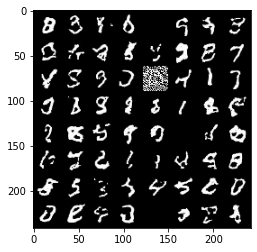

Epoch: [184/500]) Negative Log-Likelihood: -3673.992431640625
Epoch: [185/500]) Batch: [1/75] Negative Log-Likelihood: -3697.3017578125


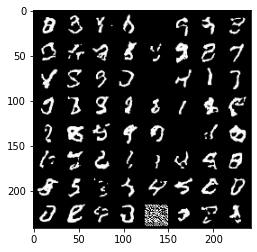

Epoch: [185/500]) Batch: [2/75] Negative Log-Likelihood: -3697.1181640625
Epoch: [185/500]) Batch: [3/75] Negative Log-Likelihood: -3705.880126953125
Epoch: [185/500]) Batch: [4/75] Negative Log-Likelihood: -3689.33740234375
Epoch: [185/500]) Batch: [5/75] Negative Log-Likelihood: -3699.173095703125
Epoch: [185/500]) Batch: [6/75] Negative Log-Likelihood: -3703.08984375
Epoch: [185/500]) Batch: [7/75] Negative Log-Likelihood: -3683.6630859375
Epoch: [185/500]) Batch: [8/75] Negative Log-Likelihood: -3687.844970703125
Epoch: [185/500]) Batch: [9/75] Negative Log-Likelihood: -3708.253662109375
Epoch: [185/500]) Batch: [10/75] Negative Log-Likelihood: -3700.71435546875
Epoch: [185/500]) Batch: [11/75] Negative Log-Likelihood: -3700.16552734375
Epoch: [185/500]) Batch: [12/75] Negative Log-Likelihood: -3703.7802734375
Epoch: [185/500]) Batch: [13/75] Negative Log-Likelihood: -3694.712158203125
Epoch: [185/500]) Batch: [14/75] Negative Log-Likelihood: -3699.91845703125
Epoch: [185/500]) Bat

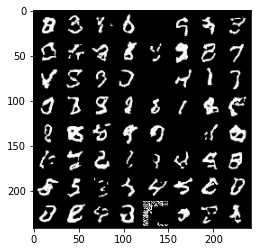

Epoch: [185/500]) Negative Log-Likelihood: -3678.6240234375
Epoch: [186/500]) Batch: [1/75] Negative Log-Likelihood: -3693.7685546875


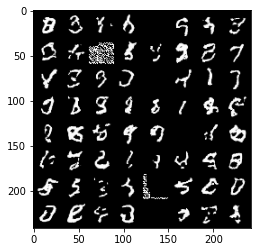

Epoch: [186/500]) Batch: [2/75] Negative Log-Likelihood: -3692.01123046875
Epoch: [186/500]) Batch: [3/75] Negative Log-Likelihood: -3706.510009765625
Epoch: [186/500]) Batch: [4/75] Negative Log-Likelihood: -3687.0517578125
Epoch: [186/500]) Batch: [5/75] Negative Log-Likelihood: -3696.233642578125
Epoch: [186/500]) Batch: [6/75] Negative Log-Likelihood: -3699.939208984375
Epoch: [186/500]) Batch: [7/75] Negative Log-Likelihood: -3687.983642578125
Epoch: [186/500]) Batch: [8/75] Negative Log-Likelihood: -3698.979248046875
Epoch: [186/500]) Batch: [9/75] Negative Log-Likelihood: -3709.44189453125
Epoch: [186/500]) Batch: [10/75] Negative Log-Likelihood: -3705.389892578125
Epoch: [186/500]) Batch: [11/75] Negative Log-Likelihood: -3696.96044921875
Epoch: [186/500]) Batch: [12/75] Negative Log-Likelihood: -3698.5283203125
Epoch: [186/500]) Batch: [13/75] Negative Log-Likelihood: -3697.03564453125
Epoch: [186/500]) Batch: [14/75] Negative Log-Likelihood: -3697.130859375
Epoch: [186/500]) 

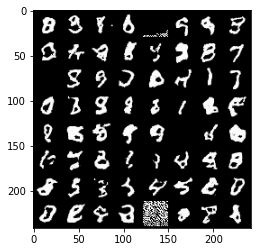

Epoch: [186/500]) Negative Log-Likelihood: -3663.09375
Epoch: [187/500]) Batch: [1/75] Negative Log-Likelihood: -3688.212646484375


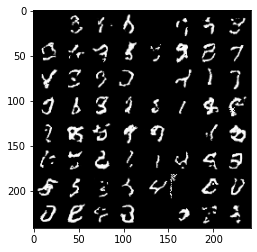

Epoch: [187/500]) Batch: [2/75] Negative Log-Likelihood: -3688.4736328125
Epoch: [187/500]) Batch: [3/75] Negative Log-Likelihood: -3700.2705078125
Epoch: [187/500]) Batch: [4/75] Negative Log-Likelihood: -3686.123291015625
Epoch: [187/500]) Batch: [5/75] Negative Log-Likelihood: -3691.311279296875
Epoch: [187/500]) Batch: [6/75] Negative Log-Likelihood: -3693.6142578125
Epoch: [187/500]) Batch: [7/75] Negative Log-Likelihood: -3686.54736328125
Epoch: [187/500]) Batch: [8/75] Negative Log-Likelihood: -3693.298583984375
Epoch: [187/500]) Batch: [9/75] Negative Log-Likelihood: -3701.108642578125
Epoch: [187/500]) Batch: [10/75] Negative Log-Likelihood: -3700.0751953125
Epoch: [187/500]) Batch: [11/75] Negative Log-Likelihood: -3700.35986328125
Epoch: [187/500]) Batch: [12/75] Negative Log-Likelihood: -3701.75048828125
Epoch: [187/500]) Batch: [13/75] Negative Log-Likelihood: -3699.704833984375
Epoch: [187/500]) Batch: [14/75] Negative Log-Likelihood: -3701.905517578125
Epoch: [187/500]) 

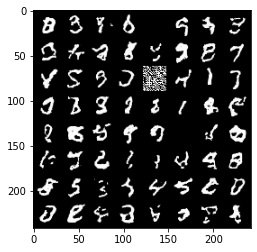

Epoch: [187/500]) Negative Log-Likelihood: -3654.87939453125
Epoch: [188/500]) Batch: [1/75] Negative Log-Likelihood: -3690.37939453125


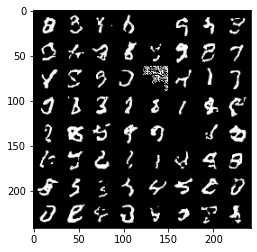

Epoch: [188/500]) Batch: [2/75] Negative Log-Likelihood: -3690.752685546875
Epoch: [188/500]) Batch: [3/75] Negative Log-Likelihood: -3696.6201171875
Epoch: [188/500]) Batch: [4/75] Negative Log-Likelihood: -3687.654052734375
Epoch: [188/500]) Batch: [5/75] Negative Log-Likelihood: -3694.929931640625
Epoch: [188/500]) Batch: [6/75] Negative Log-Likelihood: -3697.0322265625
Epoch: [188/500]) Batch: [7/75] Negative Log-Likelihood: -3692.494384765625
Epoch: [188/500]) Batch: [8/75] Negative Log-Likelihood: -3700.709228515625
Epoch: [188/500]) Batch: [9/75] Negative Log-Likelihood: -3712.50732421875
Epoch: [188/500]) Batch: [10/75] Negative Log-Likelihood: -3701.346435546875
Epoch: [188/500]) Batch: [11/75] Negative Log-Likelihood: -3706.45556640625
Epoch: [188/500]) Batch: [12/75] Negative Log-Likelihood: -3700.003662109375
Epoch: [188/500]) Batch: [13/75] Negative Log-Likelihood: -3695.222412109375
Epoch: [188/500]) Batch: [14/75] Negative Log-Likelihood: -3697.6630859375
Epoch: [188/500

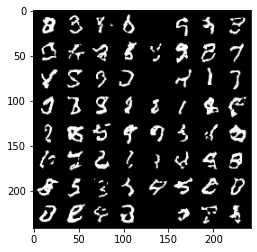

Epoch: [188/500]) Negative Log-Likelihood: -3675.24365234375
Epoch: [189/500]) Batch: [1/75] Negative Log-Likelihood: -3691.655517578125


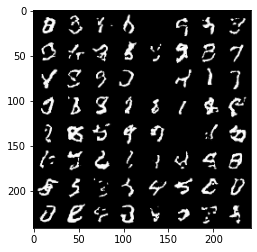

Epoch: [189/500]) Batch: [2/75] Negative Log-Likelihood: -3693.17919921875
Epoch: [189/500]) Batch: [3/75] Negative Log-Likelihood: -3700.408447265625
Epoch: [189/500]) Batch: [4/75] Negative Log-Likelihood: -3688.38232421875
Epoch: [189/500]) Batch: [5/75] Negative Log-Likelihood: -3698.064208984375
Epoch: [189/500]) Batch: [6/75] Negative Log-Likelihood: -3692.990966796875
Epoch: [189/500]) Batch: [7/75] Negative Log-Likelihood: -3687.79248046875
Epoch: [189/500]) Batch: [8/75] Negative Log-Likelihood: -3704.280029296875
Epoch: [189/500]) Batch: [9/75] Negative Log-Likelihood: -3710.074951171875
Epoch: [189/500]) Batch: [10/75] Negative Log-Likelihood: -3704.7236328125
Epoch: [189/500]) Batch: [11/75] Negative Log-Likelihood: -3708.467041015625
Epoch: [189/500]) Batch: [12/75] Negative Log-Likelihood: -3699.907470703125
Epoch: [189/500]) Batch: [13/75] Negative Log-Likelihood: -3695.140625
Epoch: [189/500]) Batch: [14/75] Negative Log-Likelihood: -3703.956787109375
Epoch: [189/500]) 

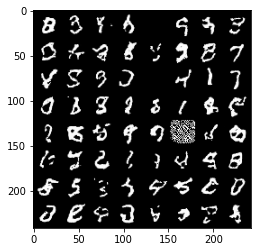

Epoch: [189/500]) Negative Log-Likelihood: -3673.919189453125
Epoch: [190/500]) Batch: [1/75] Negative Log-Likelihood: -3694.07470703125


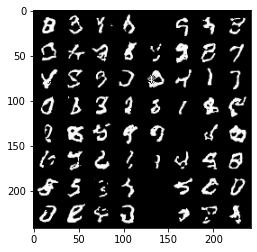

Epoch: [190/500]) Batch: [2/75] Negative Log-Likelihood: -3697.18359375
Epoch: [190/500]) Batch: [3/75] Negative Log-Likelihood: -3701.326171875
Epoch: [190/500]) Batch: [4/75] Negative Log-Likelihood: -3686.708251953125
Epoch: [190/500]) Batch: [5/75] Negative Log-Likelihood: -3697.6767578125
Epoch: [190/500]) Batch: [6/75] Negative Log-Likelihood: -3699.905517578125
Epoch: [190/500]) Batch: [7/75] Negative Log-Likelihood: -3690.638671875
Epoch: [190/500]) Batch: [8/75] Negative Log-Likelihood: -3700.86962890625
Epoch: [190/500]) Batch: [9/75] Negative Log-Likelihood: -3710.4384765625
Epoch: [190/500]) Batch: [10/75] Negative Log-Likelihood: -3703.568603515625
Epoch: [190/500]) Batch: [11/75] Negative Log-Likelihood: -3692.984375
Epoch: [190/500]) Batch: [12/75] Negative Log-Likelihood: -3692.41796875
Epoch: [190/500]) Batch: [13/75] Negative Log-Likelihood: -3690.724609375
Epoch: [190/500]) Batch: [14/75] Negative Log-Likelihood: -3702.581787109375
Epoch: [190/500]) Batch: [15/75] Ne

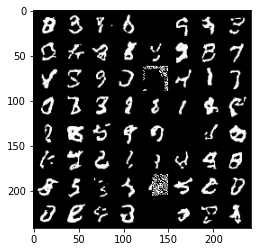

Epoch: [190/500]) Negative Log-Likelihood: -3675.611083984375
Epoch: [191/500]) Batch: [1/75] Negative Log-Likelihood: -3694.829833984375


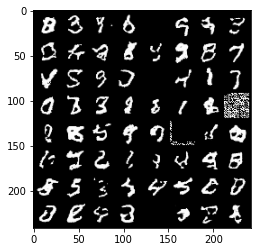

Epoch: [191/500]) Batch: [2/75] Negative Log-Likelihood: -3695.96435546875
Epoch: [191/500]) Batch: [3/75] Negative Log-Likelihood: -3703.6044921875
Epoch: [191/500]) Batch: [4/75] Negative Log-Likelihood: -3690.27294921875
Epoch: [191/500]) Batch: [5/75] Negative Log-Likelihood: -3698.14990234375
Epoch: [191/500]) Batch: [6/75] Negative Log-Likelihood: -3699.0009765625
Epoch: [191/500]) Batch: [7/75] Negative Log-Likelihood: -3692.300537109375
Epoch: [191/500]) Batch: [8/75] Negative Log-Likelihood: -3697.826904296875
Epoch: [191/500]) Batch: [9/75] Negative Log-Likelihood: -3701.14208984375
Epoch: [191/500]) Batch: [10/75] Negative Log-Likelihood: -3704.10546875
Epoch: [191/500]) Batch: [11/75] Negative Log-Likelihood: -3704.901123046875
Epoch: [191/500]) Batch: [12/75] Negative Log-Likelihood: -3701.545166015625
Epoch: [191/500]) Batch: [13/75] Negative Log-Likelihood: -3697.7626953125
Epoch: [191/500]) Batch: [14/75] Negative Log-Likelihood: -3705.061279296875
Epoch: [191/500]) Bat

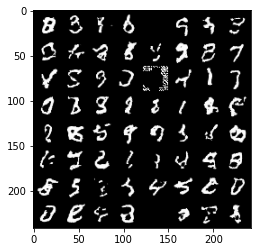

Epoch: [191/500]) Negative Log-Likelihood: -3667.007080078125
Epoch: [192/500]) Batch: [1/75] Negative Log-Likelihood: -3691.373779296875


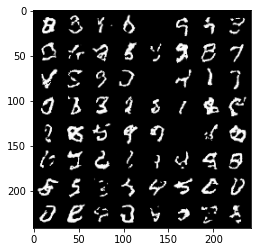

Epoch: [192/500]) Batch: [2/75] Negative Log-Likelihood: -3684.041748046875
Epoch: [192/500]) Batch: [3/75] Negative Log-Likelihood: -3693.213623046875
Epoch: [192/500]) Batch: [4/75] Negative Log-Likelihood: -3681.724365234375
Epoch: [192/500]) Batch: [5/75] Negative Log-Likelihood: -3692.9912109375
Epoch: [192/500]) Batch: [6/75] Negative Log-Likelihood: -3687.947998046875
Epoch: [192/500]) Batch: [7/75] Negative Log-Likelihood: -3681.099853515625
Epoch: [192/500]) Batch: [8/75] Negative Log-Likelihood: -3695.978759765625
Epoch: [192/500]) Batch: [9/75] Negative Log-Likelihood: -3705.075439453125
Epoch: [192/500]) Batch: [10/75] Negative Log-Likelihood: -3700.226806640625
Epoch: [192/500]) Batch: [11/75] Negative Log-Likelihood: -3701.239013671875
Epoch: [192/500]) Batch: [12/75] Negative Log-Likelihood: -3702.64990234375
Epoch: [192/500]) Batch: [13/75] Negative Log-Likelihood: -3700.033447265625
Epoch: [192/500]) Batch: [14/75] Negative Log-Likelihood: -3700.186279296875
Epoch: [19

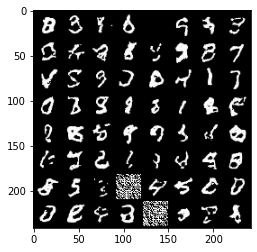

Epoch: [192/500]) Negative Log-Likelihood: -3680.888916015625
Epoch: [193/500]) Batch: [1/75] Negative Log-Likelihood: -3694.79345703125


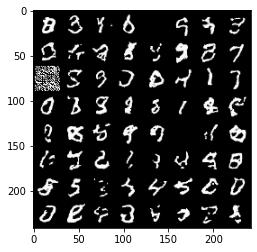

Epoch: [193/500]) Batch: [2/75] Negative Log-Likelihood: -3700.858642578125
Epoch: [193/500]) Batch: [3/75] Negative Log-Likelihood: -3706.61083984375
Epoch: [193/500]) Batch: [4/75] Negative Log-Likelihood: -3691.459228515625
Epoch: [193/500]) Batch: [5/75] Negative Log-Likelihood: -3704.802001953125
Epoch: [193/500]) Batch: [6/75] Negative Log-Likelihood: -3692.59375
Epoch: [193/500]) Batch: [7/75] Negative Log-Likelihood: -3672.954345703125
Epoch: [193/500]) Batch: [8/75] Negative Log-Likelihood: -3682.769287109375
Epoch: [193/500]) Batch: [9/75] Negative Log-Likelihood: -3710.1279296875
Epoch: [193/500]) Batch: [10/75] Negative Log-Likelihood: -3703.1220703125
Epoch: [193/500]) Batch: [11/75] Negative Log-Likelihood: -3685.06982421875
Epoch: [193/500]) Batch: [12/75] Negative Log-Likelihood: -3695.97900390625
Epoch: [193/500]) Batch: [13/75] Negative Log-Likelihood: -3693.193359375
Epoch: [193/500]) Batch: [14/75] Negative Log-Likelihood: -3688.429931640625
Epoch: [193/500]) Batch:

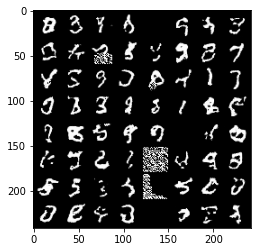

Epoch: [193/500]) Negative Log-Likelihood: -3666.9013671875
Epoch: [194/500]) Batch: [1/75] Negative Log-Likelihood: -3684.013916015625


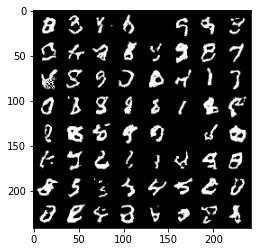

Epoch: [194/500]) Batch: [2/75] Negative Log-Likelihood: -3680.713134765625
Epoch: [194/500]) Batch: [3/75] Negative Log-Likelihood: -3694.59375
Epoch: [194/500]) Batch: [4/75] Negative Log-Likelihood: -3677.245849609375
Epoch: [194/500]) Batch: [5/75] Negative Log-Likelihood: -3694.424072265625
Epoch: [194/500]) Batch: [6/75] Negative Log-Likelihood: -3690.173095703125
Epoch: [194/500]) Batch: [7/75] Negative Log-Likelihood: -3670.38330078125
Epoch: [194/500]) Batch: [8/75] Negative Log-Likelihood: -3683.477783203125
Epoch: [194/500]) Batch: [9/75] Negative Log-Likelihood: -3693.6845703125
Epoch: [194/500]) Batch: [10/75] Negative Log-Likelihood: -3691.4091796875
Epoch: [194/500]) Batch: [11/75] Negative Log-Likelihood: -3692.705322265625
Epoch: [194/500]) Batch: [12/75] Negative Log-Likelihood: -3696.244384765625
Epoch: [194/500]) Batch: [13/75] Negative Log-Likelihood: -3693.33935546875
Epoch: [194/500]) Batch: [14/75] Negative Log-Likelihood: -3697.435546875
Epoch: [194/500]) Batch

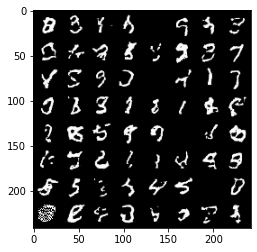

Epoch: [194/500]) Negative Log-Likelihood: -3677.99169921875
Epoch: [195/500]) Batch: [1/75] Negative Log-Likelihood: -3699.90185546875


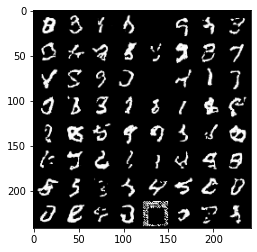

Epoch: [195/500]) Batch: [2/75] Negative Log-Likelihood: -3696.40185546875
Epoch: [195/500]) Batch: [3/75] Negative Log-Likelihood: -3706.166259765625
Epoch: [195/500]) Batch: [4/75] Negative Log-Likelihood: -3682.520263671875
Epoch: [195/500]) Batch: [5/75] Negative Log-Likelihood: -3691.240966796875
Epoch: [195/500]) Batch: [6/75] Negative Log-Likelihood: -3692.74560546875
Epoch: [195/500]) Batch: [7/75] Negative Log-Likelihood: -3686.749267578125
Epoch: [195/500]) Batch: [8/75] Negative Log-Likelihood: -3702.6904296875
Epoch: [195/500]) Batch: [9/75] Negative Log-Likelihood: -3711.506103515625
Epoch: [195/500]) Batch: [10/75] Negative Log-Likelihood: -3704.9912109375
Epoch: [195/500]) Batch: [11/75] Negative Log-Likelihood: -3704.06982421875
Epoch: [195/500]) Batch: [12/75] Negative Log-Likelihood: -3705.57861328125
Epoch: [195/500]) Batch: [13/75] Negative Log-Likelihood: -3698.806884765625
Epoch: [195/500]) Batch: [14/75] Negative Log-Likelihood: -3701.811767578125
Epoch: [195/500

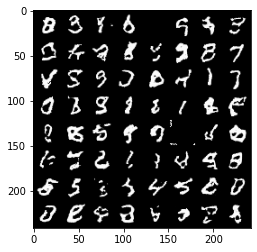

Epoch: [195/500]) Negative Log-Likelihood: -3679.28369140625
Epoch: [196/500]) Batch: [1/75] Negative Log-Likelihood: -3698.685791015625


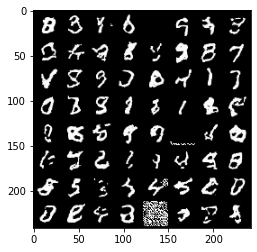

Epoch: [196/500]) Batch: [2/75] Negative Log-Likelihood: -3700.678466796875
Epoch: [196/500]) Batch: [3/75] Negative Log-Likelihood: -3712.154296875
Epoch: [196/500]) Batch: [4/75] Negative Log-Likelihood: -3691.9208984375
Epoch: [196/500]) Batch: [5/75] Negative Log-Likelihood: -3705.5712890625
Epoch: [196/500]) Batch: [6/75] Negative Log-Likelihood: -3703.495849609375
Epoch: [196/500]) Batch: [7/75] Negative Log-Likelihood: -3696.041259765625
Epoch: [196/500]) Batch: [8/75] Negative Log-Likelihood: -3696.742431640625
Epoch: [196/500]) Batch: [9/75] Negative Log-Likelihood: -3696.911865234375
Epoch: [196/500]) Batch: [10/75] Negative Log-Likelihood: -3698.58056640625
Epoch: [196/500]) Batch: [11/75] Negative Log-Likelihood: -3702.80859375
Epoch: [196/500]) Batch: [12/75] Negative Log-Likelihood: -3696.6142578125
Epoch: [196/500]) Batch: [13/75] Negative Log-Likelihood: -3692.5654296875
Epoch: [196/500]) Batch: [14/75] Negative Log-Likelihood: -3703.46435546875
Epoch: [196/500]) Batch:

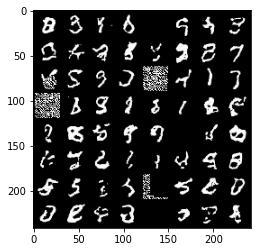

Epoch: [196/500]) Negative Log-Likelihood: -3679.423095703125
Epoch: [197/500]) Batch: [1/75] Negative Log-Likelihood: -3698.853759765625


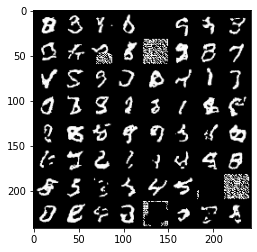

Epoch: [197/500]) Batch: [2/75] Negative Log-Likelihood: -3698.476806640625
Epoch: [197/500]) Batch: [3/75] Negative Log-Likelihood: -3706.42431640625
Epoch: [197/500]) Batch: [4/75] Negative Log-Likelihood: -3681.82421875
Epoch: [197/500]) Batch: [5/75] Negative Log-Likelihood: -3692.6767578125
Epoch: [197/500]) Batch: [6/75] Negative Log-Likelihood: -3694.949951171875
Epoch: [197/500]) Batch: [7/75] Negative Log-Likelihood: -3683.434814453125
Epoch: [197/500]) Batch: [8/75] Negative Log-Likelihood: -3694.27001953125
Epoch: [197/500]) Batch: [9/75] Negative Log-Likelihood: -3702.869384765625
Epoch: [197/500]) Batch: [10/75] Negative Log-Likelihood: -3701.60400390625
Epoch: [197/500]) Batch: [11/75] Negative Log-Likelihood: -3701.444580078125
Epoch: [197/500]) Batch: [12/75] Negative Log-Likelihood: -3701.0751953125
Epoch: [197/500]) Batch: [13/75] Negative Log-Likelihood: -3690.07421875
Epoch: [197/500]) Batch: [14/75] Negative Log-Likelihood: -3697.4091796875
Epoch: [197/500]) Batch:

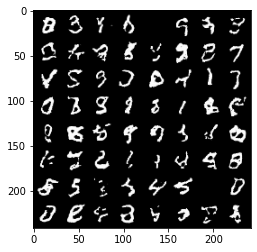

Epoch: [197/500]) Negative Log-Likelihood: -3685.314208984375
Epoch: [198/500]) Batch: [1/75] Negative Log-Likelihood: -3707.74169921875


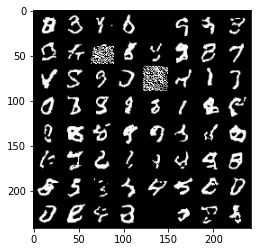

Epoch: [198/500]) Batch: [2/75] Negative Log-Likelihood: -3706.70361328125
Epoch: [198/500]) Batch: [3/75] Negative Log-Likelihood: -3714.1787109375
Epoch: [198/500]) Batch: [4/75] Negative Log-Likelihood: -3697.42626953125
Epoch: [198/500]) Batch: [5/75] Negative Log-Likelihood: -3707.11767578125
Epoch: [198/500]) Batch: [6/75] Negative Log-Likelihood: -3707.89990234375
Epoch: [198/500]) Batch: [7/75] Negative Log-Likelihood: -3699.156494140625
Epoch: [198/500]) Batch: [8/75] Negative Log-Likelihood: -3711.732421875
Epoch: [198/500]) Batch: [9/75] Negative Log-Likelihood: -3713.934814453125
Epoch: [198/500]) Batch: [10/75] Negative Log-Likelihood: -3711.5380859375
Epoch: [198/500]) Batch: [11/75] Negative Log-Likelihood: -3704.962158203125
Epoch: [198/500]) Batch: [12/75] Negative Log-Likelihood: -3704.4873046875
Epoch: [198/500]) Batch: [13/75] Negative Log-Likelihood: -3702.52294921875
Epoch: [198/500]) Batch: [14/75] Negative Log-Likelihood: -3703.978759765625
Epoch: [198/500]) Bat

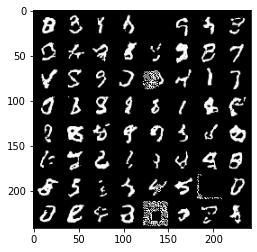

Epoch: [198/500]) Negative Log-Likelihood: -3670.556884765625
Epoch: [199/500]) Batch: [1/75] Negative Log-Likelihood: -3692.579345703125


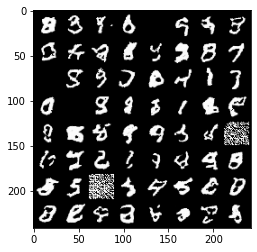

Epoch: [199/500]) Batch: [2/75] Negative Log-Likelihood: -3675.96337890625
Epoch: [199/500]) Batch: [3/75] Negative Log-Likelihood: -3690.05615234375
Epoch: [199/500]) Batch: [4/75] Negative Log-Likelihood: -3677.907470703125
Epoch: [199/500]) Batch: [5/75] Negative Log-Likelihood: -3694.256103515625
Epoch: [199/500]) Batch: [6/75] Negative Log-Likelihood: -3689.7001953125
Epoch: [199/500]) Batch: [7/75] Negative Log-Likelihood: -3683.512451171875
Epoch: [199/500]) Batch: [8/75] Negative Log-Likelihood: -3698.503662109375
Epoch: [199/500]) Batch: [9/75] Negative Log-Likelihood: -3704.40771484375
Epoch: [199/500]) Batch: [10/75] Negative Log-Likelihood: -3702.0849609375
Epoch: [199/500]) Batch: [11/75] Negative Log-Likelihood: -3694.657470703125
Epoch: [199/500]) Batch: [12/75] Negative Log-Likelihood: -3702.06494140625
Epoch: [199/500]) Batch: [13/75] Negative Log-Likelihood: -3699.771240234375
Epoch: [199/500]) Batch: [14/75] Negative Log-Likelihood: -3698.927490234375
Epoch: [199/500

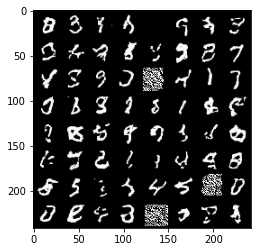

Epoch: [199/500]) Negative Log-Likelihood: -3673.54052734375
Epoch: [200/500]) Batch: [1/75] Negative Log-Likelihood: -3691.81689453125


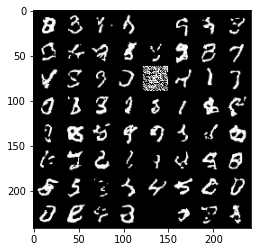

Epoch: [200/500]) Batch: [2/75] Negative Log-Likelihood: -3695.304931640625
Epoch: [200/500]) Batch: [3/75] Negative Log-Likelihood: -3702.264892578125
Epoch: [200/500]) Batch: [4/75] Negative Log-Likelihood: -3686.0537109375
Epoch: [200/500]) Batch: [5/75] Negative Log-Likelihood: -3700.639404296875
Epoch: [200/500]) Batch: [6/75] Negative Log-Likelihood: -3700.6259765625
Epoch: [200/500]) Batch: [7/75] Negative Log-Likelihood: -3690.976806640625
Epoch: [200/500]) Batch: [8/75] Negative Log-Likelihood: -3699.4267578125
Epoch: [200/500]) Batch: [9/75] Negative Log-Likelihood: -3709.892333984375
Epoch: [200/500]) Batch: [10/75] Negative Log-Likelihood: -3709.030517578125
Epoch: [200/500]) Batch: [11/75] Negative Log-Likelihood: -3705.833740234375
Epoch: [200/500]) Batch: [12/75] Negative Log-Likelihood: -3708.68212890625
Epoch: [200/500]) Batch: [13/75] Negative Log-Likelihood: -3700.602783203125
Epoch: [200/500]) Batch: [14/75] Negative Log-Likelihood: -3709.813720703125
Epoch: [200/50

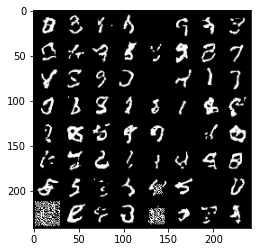

Epoch: [200/500]) Negative Log-Likelihood: -3682.0107421875
Epoch: [201/500]) Batch: [1/75] Negative Log-Likelihood: -3701.989501953125


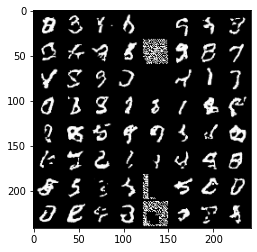

Epoch: [201/500]) Batch: [2/75] Negative Log-Likelihood: -3699.975830078125
Epoch: [201/500]) Batch: [3/75] Negative Log-Likelihood: -3707.80517578125
Epoch: [201/500]) Batch: [4/75] Negative Log-Likelihood: -3683.62060546875
Epoch: [201/500]) Batch: [5/75] Negative Log-Likelihood: -3681.572998046875
Epoch: [201/500]) Batch: [6/75] Negative Log-Likelihood: -3689.1201171875
Epoch: [201/500]) Batch: [7/75] Negative Log-Likelihood: -3685.720458984375
Epoch: [201/500]) Batch: [8/75] Negative Log-Likelihood: -3685.10107421875
Epoch: [201/500]) Batch: [9/75] Negative Log-Likelihood: -3702.14404296875
Epoch: [201/500]) Batch: [10/75] Negative Log-Likelihood: -3700.72802734375
Epoch: [201/500]) Batch: [11/75] Negative Log-Likelihood: -3682.36865234375
Epoch: [201/500]) Batch: [12/75] Negative Log-Likelihood: -3683.2734375
Epoch: [201/500]) Batch: [13/75] Negative Log-Likelihood: -3694.6552734375
Epoch: [201/500]) Batch: [14/75] Negative Log-Likelihood: -3697.975830078125
Epoch: [201/500]) Batc

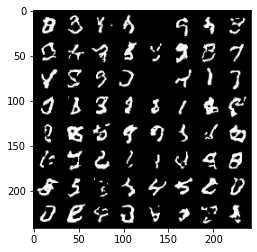

Epoch: [201/500]) Negative Log-Likelihood: -3681.708740234375
Epoch: [202/500]) Batch: [1/75] Negative Log-Likelihood: -3700.447021484375


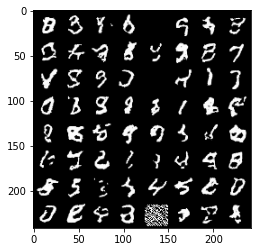

Epoch: [202/500]) Batch: [2/75] Negative Log-Likelihood: -3700.109375
Epoch: [202/500]) Batch: [3/75] Negative Log-Likelihood: -3708.219970703125
Epoch: [202/500]) Batch: [4/75] Negative Log-Likelihood: -3694.04296875
Epoch: [202/500]) Batch: [5/75] Negative Log-Likelihood: -3699.368408203125
Epoch: [202/500]) Batch: [6/75] Negative Log-Likelihood: -3702.603271484375
Epoch: [202/500]) Batch: [7/75] Negative Log-Likelihood: -3694.4423828125
Epoch: [202/500]) Batch: [8/75] Negative Log-Likelihood: -3707.954345703125
Epoch: [202/500]) Batch: [9/75] Negative Log-Likelihood: -3712.8525390625
Epoch: [202/500]) Batch: [10/75] Negative Log-Likelihood: -3708.484375
Epoch: [202/500]) Batch: [11/75] Negative Log-Likelihood: -3704.72607421875
Epoch: [202/500]) Batch: [12/75] Negative Log-Likelihood: -3699.171142578125
Epoch: [202/500]) Batch: [13/75] Negative Log-Likelihood: -3697.0224609375
Epoch: [202/500]) Batch: [14/75] Negative Log-Likelihood: -3704.249267578125
Epoch: [202/500]) Batch: [15/7

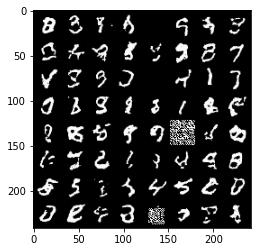

Epoch: [202/500]) Negative Log-Likelihood: -3675.407958984375
Epoch: [203/500]) Batch: [1/75] Negative Log-Likelihood: -3691.59765625


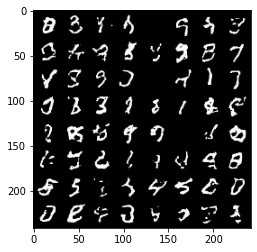

Epoch: [203/500]) Batch: [2/75] Negative Log-Likelihood: -3701.83251953125
Epoch: [203/500]) Batch: [3/75] Negative Log-Likelihood: -3705.447509765625
Epoch: [203/500]) Batch: [4/75] Negative Log-Likelihood: -3689.96923828125
Epoch: [203/500]) Batch: [5/75] Negative Log-Likelihood: -3697.307373046875
Epoch: [203/500]) Batch: [6/75] Negative Log-Likelihood: -3692.58056640625
Epoch: [203/500]) Batch: [7/75] Negative Log-Likelihood: -3690.324951171875
Epoch: [203/500]) Batch: [8/75] Negative Log-Likelihood: -3705.6005859375
Epoch: [203/500]) Batch: [9/75] Negative Log-Likelihood: -3709.59814453125
Epoch: [203/500]) Batch: [10/75] Negative Log-Likelihood: -3708.6767578125
Epoch: [203/500]) Batch: [11/75] Negative Log-Likelihood: -3710.41552734375
Epoch: [203/500]) Batch: [12/75] Negative Log-Likelihood: -3708.291748046875
Epoch: [203/500]) Batch: [13/75] Negative Log-Likelihood: -3701.189697265625
Epoch: [203/500]) Batch: [14/75] Negative Log-Likelihood: -3706.80712890625
Epoch: [203/500])

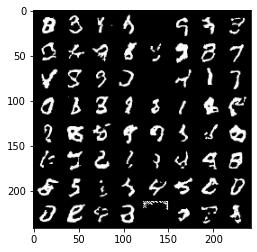

Epoch: [203/500]) Negative Log-Likelihood: -3680.217529296875
Epoch: [204/500]) Batch: [1/75] Negative Log-Likelihood: -3697.640625


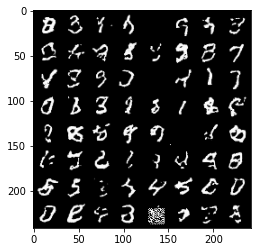

Epoch: [204/500]) Batch: [2/75] Negative Log-Likelihood: -3704.3017578125
Epoch: [204/500]) Batch: [3/75] Negative Log-Likelihood: -3710.864501953125
Epoch: [204/500]) Batch: [4/75] Negative Log-Likelihood: -3689.83935546875
Epoch: [204/500]) Batch: [5/75] Negative Log-Likelihood: -3697.08984375
Epoch: [204/500]) Batch: [6/75] Negative Log-Likelihood: -3701.338623046875
Epoch: [204/500]) Batch: [7/75] Negative Log-Likelihood: -3695.9306640625
Epoch: [204/500]) Batch: [8/75] Negative Log-Likelihood: -3704.177001953125
Epoch: [204/500]) Batch: [9/75] Negative Log-Likelihood: -3706.38525390625
Epoch: [204/500]) Batch: [10/75] Negative Log-Likelihood: -3704.5380859375
Epoch: [204/500]) Batch: [11/75] Negative Log-Likelihood: -3702.5400390625
Epoch: [204/500]) Batch: [12/75] Negative Log-Likelihood: -3699.84814453125
Epoch: [204/500]) Batch: [13/75] Negative Log-Likelihood: -3693.40625
Epoch: [204/500]) Batch: [14/75] Negative Log-Likelihood: -3700.239501953125
Epoch: [204/500]) Batch: [15/

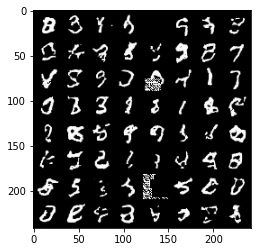

Epoch: [204/500]) Negative Log-Likelihood: -3680.08935546875
Epoch: [205/500]) Batch: [1/75] Negative Log-Likelihood: -3697.733154296875


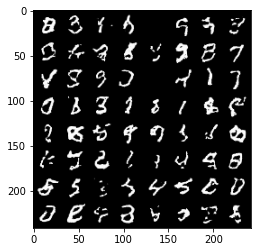

Epoch: [205/500]) Batch: [2/75] Negative Log-Likelihood: -3700.2744140625
Epoch: [205/500]) Batch: [3/75] Negative Log-Likelihood: -3707.16796875
Epoch: [205/500]) Batch: [4/75] Negative Log-Likelihood: -3693.412841796875
Epoch: [205/500]) Batch: [5/75] Negative Log-Likelihood: -3698.505615234375
Epoch: [205/500]) Batch: [6/75] Negative Log-Likelihood: -3692.89111328125
Epoch: [205/500]) Batch: [7/75] Negative Log-Likelihood: -3693.6943359375
Epoch: [205/500]) Batch: [8/75] Negative Log-Likelihood: -3700.7568359375
Epoch: [205/500]) Batch: [9/75] Negative Log-Likelihood: -3712.28173828125
Epoch: [205/500]) Batch: [10/75] Negative Log-Likelihood: -3708.0087890625
Epoch: [205/500]) Batch: [11/75] Negative Log-Likelihood: -3705.164306640625
Epoch: [205/500]) Batch: [12/75] Negative Log-Likelihood: -3708.974853515625
Epoch: [205/500]) Batch: [13/75] Negative Log-Likelihood: -3696.731689453125
Epoch: [205/500]) Batch: [14/75] Negative Log-Likelihood: -3708.58251953125
Epoch: [205/500]) Batc

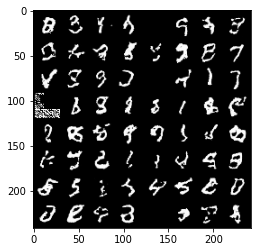

Epoch: [205/500]) Negative Log-Likelihood: -3679.627197265625
Epoch: [206/500]) Batch: [1/75] Negative Log-Likelihood: -3702.6494140625


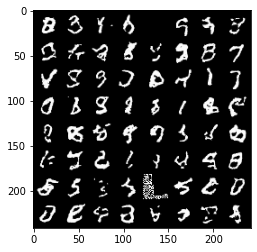

Epoch: [206/500]) Batch: [2/75] Negative Log-Likelihood: -3705.923095703125
Epoch: [206/500]) Batch: [3/75] Negative Log-Likelihood: -3706.114013671875
Epoch: [206/500]) Batch: [4/75] Negative Log-Likelihood: -3689.296142578125
Epoch: [206/500]) Batch: [5/75] Negative Log-Likelihood: -3698.41552734375
Epoch: [206/500]) Batch: [6/75] Negative Log-Likelihood: -3696.43212890625
Epoch: [206/500]) Batch: [7/75] Negative Log-Likelihood: -3693.20361328125
Epoch: [206/500]) Batch: [8/75] Negative Log-Likelihood: -3704.488037109375
Epoch: [206/500]) Batch: [9/75] Negative Log-Likelihood: -3714.47265625
Epoch: [206/500]) Batch: [10/75] Negative Log-Likelihood: -3703.68310546875
Epoch: [206/500]) Batch: [11/75] Negative Log-Likelihood: -3705.98046875
Epoch: [206/500]) Batch: [12/75] Negative Log-Likelihood: -3701.79931640625
Epoch: [206/500]) Batch: [13/75] Negative Log-Likelihood: -3684.66650390625
Epoch: [206/500]) Batch: [14/75] Negative Log-Likelihood: -3699.06298828125
Epoch: [206/500]) Batc

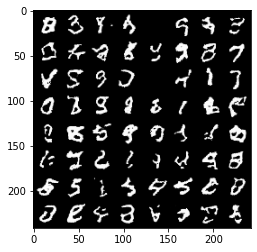

Epoch: [206/500]) Negative Log-Likelihood: -3671.982177734375
Epoch: [207/500]) Batch: [1/75] Negative Log-Likelihood: -3696.203125


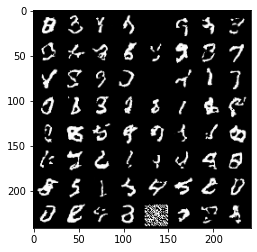

Epoch: [207/500]) Batch: [2/75] Negative Log-Likelihood: -3701.302978515625
Epoch: [207/500]) Batch: [3/75] Negative Log-Likelihood: -3701.153564453125
Epoch: [207/500]) Batch: [4/75] Negative Log-Likelihood: -3683.84521484375
Epoch: [207/500]) Batch: [5/75] Negative Log-Likelihood: -3689.48779296875
Epoch: [207/500]) Batch: [6/75] Negative Log-Likelihood: -3687.618896484375
Epoch: [207/500]) Batch: [7/75] Negative Log-Likelihood: -3683.17431640625
Epoch: [207/500]) Batch: [8/75] Negative Log-Likelihood: -3695.75244140625
Epoch: [207/500]) Batch: [9/75] Negative Log-Likelihood: -3702.796142578125
Epoch: [207/500]) Batch: [10/75] Negative Log-Likelihood: -3701.952392578125
Epoch: [207/500]) Batch: [11/75] Negative Log-Likelihood: -3693.789306640625
Epoch: [207/500]) Batch: [12/75] Negative Log-Likelihood: -3680.650146484375
Epoch: [207/500]) Batch: [13/75] Negative Log-Likelihood: -3684.8193359375
Epoch: [207/500]) Batch: [14/75] Negative Log-Likelihood: -3689.670654296875
Epoch: [207/5

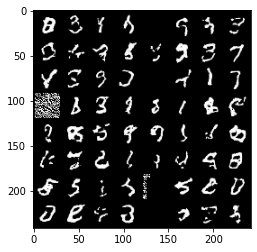

Epoch: [207/500]) Negative Log-Likelihood: -3678.108642578125
Epoch: [208/500]) Batch: [1/75] Negative Log-Likelihood: -3693.00048828125


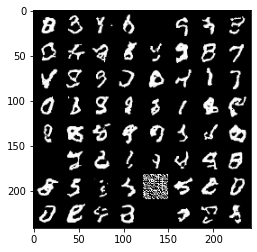

Epoch: [208/500]) Batch: [2/75] Negative Log-Likelihood: -3696.741455078125
Epoch: [208/500]) Batch: [3/75] Negative Log-Likelihood: -3701.108642578125
Epoch: [208/500]) Batch: [4/75] Negative Log-Likelihood: -3675.2138671875
Epoch: [208/500]) Batch: [5/75] Negative Log-Likelihood: -3695.961181640625
Epoch: [208/500]) Batch: [6/75] Negative Log-Likelihood: -3694.680908203125
Epoch: [208/500]) Batch: [7/75] Negative Log-Likelihood: -3679.6904296875
Epoch: [208/500]) Batch: [8/75] Negative Log-Likelihood: -3701.2705078125
Epoch: [208/500]) Batch: [9/75] Negative Log-Likelihood: -3703.847412109375
Epoch: [208/500]) Batch: [10/75] Negative Log-Likelihood: -3679.901123046875
Epoch: [208/500]) Batch: [11/75] Negative Log-Likelihood: -3695.0380859375
Epoch: [208/500]) Batch: [12/75] Negative Log-Likelihood: -3697.31982421875
Epoch: [208/500]) Batch: [13/75] Negative Log-Likelihood: -3692.536376953125
Epoch: [208/500]) Batch: [14/75] Negative Log-Likelihood: -3693.27001953125
Epoch: [208/500])

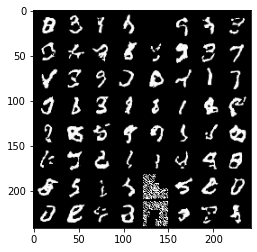

Epoch: [208/500]) Negative Log-Likelihood: -3677.65673828125
Epoch: [209/500]) Batch: [1/75] Negative Log-Likelihood: -3698.763671875


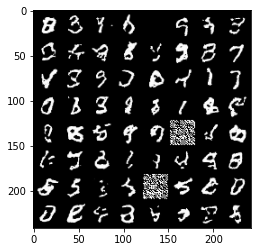

Epoch: [209/500]) Batch: [2/75] Negative Log-Likelihood: -3701.421875
Epoch: [209/500]) Batch: [3/75] Negative Log-Likelihood: -3709.606689453125
Epoch: [209/500]) Batch: [4/75] Negative Log-Likelihood: -3691.588134765625
Epoch: [209/500]) Batch: [5/75] Negative Log-Likelihood: -3706.28466796875
Epoch: [209/500]) Batch: [6/75] Negative Log-Likelihood: -3702.895751953125
Epoch: [209/500]) Batch: [7/75] Negative Log-Likelihood: -3696.244873046875
Epoch: [209/500]) Batch: [8/75] Negative Log-Likelihood: -3702.010498046875
Epoch: [209/500]) Batch: [9/75] Negative Log-Likelihood: -3707.418701171875
Epoch: [209/500]) Batch: [10/75] Negative Log-Likelihood: -3709.311767578125
Epoch: [209/500]) Batch: [11/75] Negative Log-Likelihood: -3708.4765625
Epoch: [209/500]) Batch: [12/75] Negative Log-Likelihood: -3707.482177734375
Epoch: [209/500]) Batch: [13/75] Negative Log-Likelihood: -3701.79150390625
Epoch: [209/500]) Batch: [14/75] Negative Log-Likelihood: -3705.0546875
Epoch: [209/500]) Batch: 

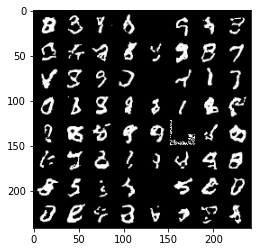

Epoch: [209/500]) Negative Log-Likelihood: -3683.791748046875
Epoch: [210/500]) Batch: [1/75] Negative Log-Likelihood: -3694.925537109375


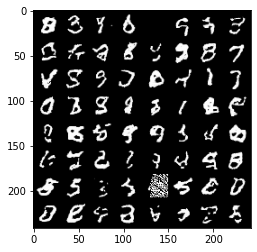

Epoch: [210/500]) Batch: [2/75] Negative Log-Likelihood: -3687.942138671875
Epoch: [210/500]) Batch: [3/75] Negative Log-Likelihood: -3702.258056640625
Epoch: [210/500]) Batch: [4/75] Negative Log-Likelihood: -3691.71875
Epoch: [210/500]) Batch: [5/75] Negative Log-Likelihood: -3696.4375
Epoch: [210/500]) Batch: [6/75] Negative Log-Likelihood: -3698.506103515625
Epoch: [210/500]) Batch: [7/75] Negative Log-Likelihood: -3692.84375
Epoch: [210/500]) Batch: [8/75] Negative Log-Likelihood: -3707.438720703125
Epoch: [210/500]) Batch: [9/75] Negative Log-Likelihood: -3711.725341796875
Epoch: [210/500]) Batch: [10/75] Negative Log-Likelihood: -3707.860595703125
Epoch: [210/500]) Batch: [11/75] Negative Log-Likelihood: -3708.572998046875
Epoch: [210/500]) Batch: [12/75] Negative Log-Likelihood: -3709.43310546875
Epoch: [210/500]) Batch: [13/75] Negative Log-Likelihood: -3698.228759765625
Epoch: [210/500]) Batch: [14/75] Negative Log-Likelihood: -3702.228759765625
Epoch: [210/500]) Batch: [15/7

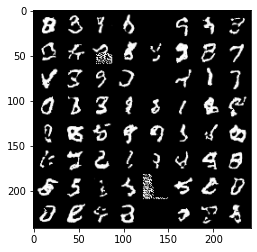

Epoch: [210/500]) Negative Log-Likelihood: -3683.927490234375
Epoch: [211/500]) Batch: [1/75] Negative Log-Likelihood: -3705.9599609375


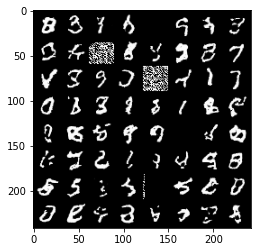

Epoch: [211/500]) Batch: [2/75] Negative Log-Likelihood: -3701.69970703125
Epoch: [211/500]) Batch: [3/75] Negative Log-Likelihood: -3711.34619140625
Epoch: [211/500]) Batch: [4/75] Negative Log-Likelihood: -3694.159912109375
Epoch: [211/500]) Batch: [5/75] Negative Log-Likelihood: -3704.8837890625
Epoch: [211/500]) Batch: [6/75] Negative Log-Likelihood: -3707.736083984375
Epoch: [211/500]) Batch: [7/75] Negative Log-Likelihood: -3695.85205078125
Epoch: [211/500]) Batch: [8/75] Negative Log-Likelihood: -3705.552978515625
Epoch: [211/500]) Batch: [9/75] Negative Log-Likelihood: -3714.68896484375
Epoch: [211/500]) Batch: [10/75] Negative Log-Likelihood: -3714.76171875
Epoch: [211/500]) Batch: [11/75] Negative Log-Likelihood: -3694.514404296875
Epoch: [211/500]) Batch: [12/75] Negative Log-Likelihood: -3680.419921875
Epoch: [211/500]) Batch: [13/75] Negative Log-Likelihood: -3693.30419921875
Epoch: [211/500]) Batch: [14/75] Negative Log-Likelihood: -3683.40185546875
Epoch: [211/500]) Batc

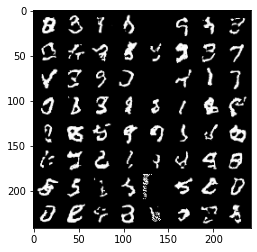

Epoch: [211/500]) Negative Log-Likelihood: -3680.38720703125
Epoch: [212/500]) Batch: [1/75] Negative Log-Likelihood: -3704.171142578125


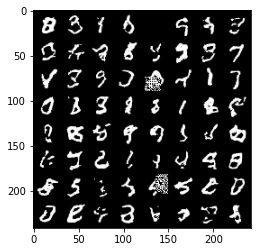

Epoch: [212/500]) Batch: [2/75] Negative Log-Likelihood: -3700.99462890625
Epoch: [212/500]) Batch: [3/75] Negative Log-Likelihood: -3709.569091796875
Epoch: [212/500]) Batch: [4/75] Negative Log-Likelihood: -3689.009033203125
Epoch: [212/500]) Batch: [5/75] Negative Log-Likelihood: -3702.1171875
Epoch: [212/500]) Batch: [6/75] Negative Log-Likelihood: -3703.601806640625
Epoch: [212/500]) Batch: [7/75] Negative Log-Likelihood: -3697.7890625
Epoch: [212/500]) Batch: [8/75] Negative Log-Likelihood: -3709.6640625
Epoch: [212/500]) Batch: [9/75] Negative Log-Likelihood: -3717.681396484375
Epoch: [212/500]) Batch: [10/75] Negative Log-Likelihood: -3711.8173828125
Epoch: [212/500]) Batch: [11/75] Negative Log-Likelihood: -3713.619873046875
Epoch: [212/500]) Batch: [12/75] Negative Log-Likelihood: -3707.330810546875
Epoch: [212/500]) Batch: [13/75] Negative Log-Likelihood: -3701.498779296875
Epoch: [212/500]) Batch: [14/75] Negative Log-Likelihood: -3704.306396484375
Epoch: [212/500]) Batch: 

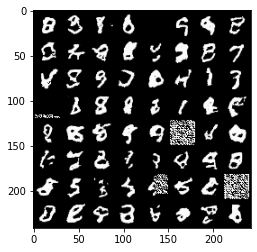

Epoch: [212/500]) Negative Log-Likelihood: -3671.48681640625
Epoch: [213/500]) Batch: [1/75] Negative Log-Likelihood: -3685.064208984375


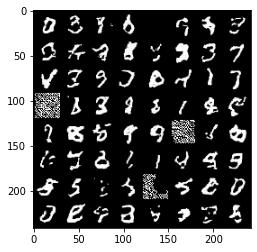

Epoch: [213/500]) Batch: [2/75] Negative Log-Likelihood: -3668.6005859375
Epoch: [213/500]) Batch: [3/75] Negative Log-Likelihood: -3687.140869140625
Epoch: [213/500]) Batch: [4/75] Negative Log-Likelihood: -3674.392333984375
Epoch: [213/500]) Batch: [5/75] Negative Log-Likelihood: -3684.7734375
Epoch: [213/500]) Batch: [6/75] Negative Log-Likelihood: -3693.1279296875
Epoch: [213/500]) Batch: [7/75] Negative Log-Likelihood: -3680.472412109375
Epoch: [213/500]) Batch: [8/75] Negative Log-Likelihood: -3693.75
Epoch: [213/500]) Batch: [9/75] Negative Log-Likelihood: -3705.43994140625
Epoch: [213/500]) Batch: [10/75] Negative Log-Likelihood: -3694.21826171875
Epoch: [213/500]) Batch: [11/75] Negative Log-Likelihood: -3702.64501953125
Epoch: [213/500]) Batch: [12/75] Negative Log-Likelihood: -3698.53173828125
Epoch: [213/500]) Batch: [13/75] Negative Log-Likelihood: -3684.349365234375
Epoch: [213/500]) Batch: [14/75] Negative Log-Likelihood: -3698.119873046875
Epoch: [213/500]) Batch: [15/7

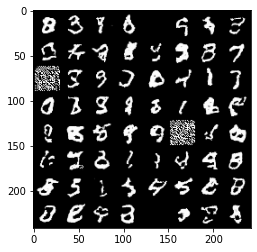

Epoch: [213/500]) Negative Log-Likelihood: -3675.207763671875
Epoch: [214/500]) Batch: [1/75] Negative Log-Likelihood: -3688.74560546875


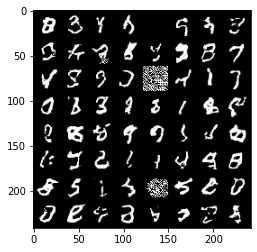

Epoch: [214/500]) Batch: [2/75] Negative Log-Likelihood: -3687.2177734375
Epoch: [214/500]) Batch: [3/75] Negative Log-Likelihood: -3697.67431640625
Epoch: [214/500]) Batch: [4/75] Negative Log-Likelihood: -3687.35302734375
Epoch: [214/500]) Batch: [5/75] Negative Log-Likelihood: -3699.996826171875
Epoch: [214/500]) Batch: [6/75] Negative Log-Likelihood: -3697.0556640625
Epoch: [214/500]) Batch: [7/75] Negative Log-Likelihood: -3695.186767578125
Epoch: [214/500]) Batch: [8/75] Negative Log-Likelihood: -3689.5234375
Epoch: [214/500]) Batch: [9/75] Negative Log-Likelihood: -3684.961181640625
Epoch: [214/500]) Batch: [10/75] Negative Log-Likelihood: -3684.222412109375
Epoch: [214/500]) Batch: [11/75] Negative Log-Likelihood: -3690.65966796875
Epoch: [214/500]) Batch: [12/75] Negative Log-Likelihood: -3697.590576171875
Epoch: [214/500]) Batch: [13/75] Negative Log-Likelihood: -3693.789306640625
Epoch: [214/500]) Batch: [14/75] Negative Log-Likelihood: -3694.997802734375
Epoch: [214/500]) B

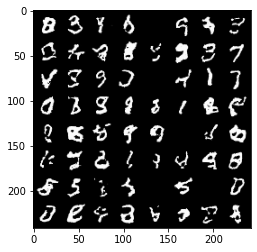

Epoch: [214/500]) Negative Log-Likelihood: -3677.96240234375
Epoch: [215/500]) Batch: [1/75] Negative Log-Likelihood: -3689.0048828125


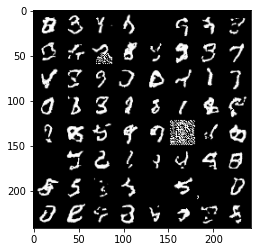

Epoch: [215/500]) Batch: [2/75] Negative Log-Likelihood: -3702.59814453125
Epoch: [215/500]) Batch: [3/75] Negative Log-Likelihood: -3702.47998046875
Epoch: [215/500]) Batch: [4/75] Negative Log-Likelihood: -3678.576171875
Epoch: [215/500]) Batch: [5/75] Negative Log-Likelihood: -3695.49365234375
Epoch: [215/500]) Batch: [6/75] Negative Log-Likelihood: -3700.410888671875
Epoch: [215/500]) Batch: [7/75] Negative Log-Likelihood: -3683.180908203125
Epoch: [215/500]) Batch: [8/75] Negative Log-Likelihood: -3694.458740234375
Epoch: [215/500]) Batch: [9/75] Negative Log-Likelihood: -3708.6591796875
Epoch: [215/500]) Batch: [10/75] Negative Log-Likelihood: -3709.335205078125
Epoch: [215/500]) Batch: [11/75] Negative Log-Likelihood: -3702.0244140625
Epoch: [215/500]) Batch: [12/75] Negative Log-Likelihood: -3700.33056640625
Epoch: [215/500]) Batch: [13/75] Negative Log-Likelihood: -3695.242431640625
Epoch: [215/500]) Batch: [14/75] Negative Log-Likelihood: -3704.831787109375
Epoch: [215/500]) 

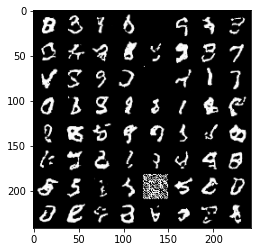

Epoch: [215/500]) Negative Log-Likelihood: -3652.860595703125
Epoch: [216/500]) Batch: [1/75] Negative Log-Likelihood: -3693.83740234375


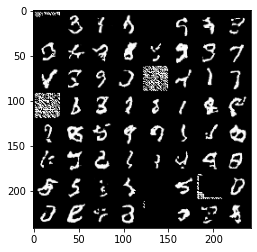

Epoch: [216/500]) Batch: [2/75] Negative Log-Likelihood: -3691.809326171875
Epoch: [216/500]) Batch: [3/75] Negative Log-Likelihood: -3692.851806640625
Epoch: [216/500]) Batch: [4/75] Negative Log-Likelihood: -3684.935546875
Epoch: [216/500]) Batch: [5/75] Negative Log-Likelihood: -3699.5341796875
Epoch: [216/500]) Batch: [6/75] Negative Log-Likelihood: -3698.20263671875
Epoch: [216/500]) Batch: [7/75] Negative Log-Likelihood: -3689.579345703125
Epoch: [216/500]) Batch: [8/75] Negative Log-Likelihood: -3704.29248046875
Epoch: [216/500]) Batch: [9/75] Negative Log-Likelihood: -3710.825439453125
Epoch: [216/500]) Batch: [10/75] Negative Log-Likelihood: -3706.521240234375
Epoch: [216/500]) Batch: [11/75] Negative Log-Likelihood: -3706.813720703125
Epoch: [216/500]) Batch: [12/75] Negative Log-Likelihood: -3705.75390625
Epoch: [216/500]) Batch: [13/75] Negative Log-Likelihood: -3700.483154296875
Epoch: [216/500]) Batch: [14/75] Negative Log-Likelihood: -3704.590576171875
Epoch: [216/500]) 

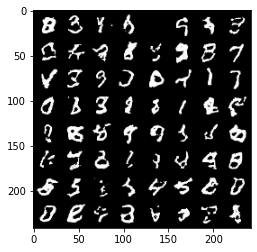

Epoch: [216/500]) Negative Log-Likelihood: -3680.650634765625
Epoch: [217/500]) Batch: [1/75] Negative Log-Likelihood: -3697.00048828125


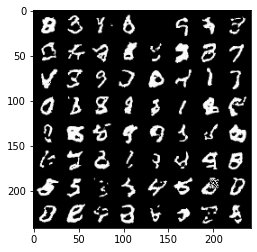

Epoch: [217/500]) Batch: [2/75] Negative Log-Likelihood: -3686.8671875
Epoch: [217/500]) Batch: [3/75] Negative Log-Likelihood: -3702.271728515625
Epoch: [217/500]) Batch: [4/75] Negative Log-Likelihood: -3684.239013671875
Epoch: [217/500]) Batch: [5/75] Negative Log-Likelihood: -3683.6748046875
Epoch: [217/500]) Batch: [6/75] Negative Log-Likelihood: -3691.7734375
Epoch: [217/500]) Batch: [7/75] Negative Log-Likelihood: -3688.356201171875
Epoch: [217/500]) Batch: [8/75] Negative Log-Likelihood: -3689.75341796875
Epoch: [217/500]) Batch: [9/75] Negative Log-Likelihood: -3703.7880859375
Epoch: [217/500]) Batch: [10/75] Negative Log-Likelihood: -3706.154052734375
Epoch: [217/500]) Batch: [11/75] Negative Log-Likelihood: -3699.064697265625
Epoch: [217/500]) Batch: [12/75] Negative Log-Likelihood: -3700.5263671875
Epoch: [217/500]) Batch: [13/75] Negative Log-Likelihood: -3686.613037109375
Epoch: [217/500]) Batch: [14/75] Negative Log-Likelihood: -3695.1669921875
Epoch: [217/500]) Batch: [

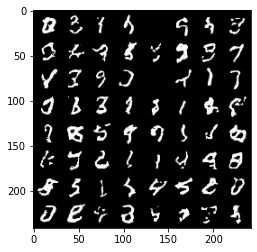

Epoch: [217/500]) Negative Log-Likelihood: -3677.043701171875
Epoch: [218/500]) Batch: [1/75] Negative Log-Likelihood: -3699.168701171875


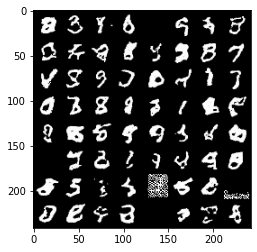

Epoch: [218/500]) Batch: [2/75] Negative Log-Likelihood: -3694.324951171875
Epoch: [218/500]) Batch: [3/75] Negative Log-Likelihood: -3700.623046875
Epoch: [218/500]) Batch: [4/75] Negative Log-Likelihood: -3680.40673828125
Epoch: [218/500]) Batch: [5/75] Negative Log-Likelihood: -3688.463623046875
Epoch: [218/500]) Batch: [6/75] Negative Log-Likelihood: -3684.8125
Epoch: [218/500]) Batch: [7/75] Negative Log-Likelihood: -3673.204833984375
Epoch: [218/500]) Batch: [8/75] Negative Log-Likelihood: -3690.6962890625
Epoch: [218/500]) Batch: [9/75] Negative Log-Likelihood: -3706.8525390625
Epoch: [218/500]) Batch: [10/75] Negative Log-Likelihood: -3699.84765625
Epoch: [218/500]) Batch: [11/75] Negative Log-Likelihood: -3698.409912109375
Epoch: [218/500]) Batch: [12/75] Negative Log-Likelihood: -3700.74169921875
Epoch: [218/500]) Batch: [13/75] Negative Log-Likelihood: -3695.15234375
Epoch: [218/500]) Batch: [14/75] Negative Log-Likelihood: -3704.494384765625
Epoch: [218/500]) Batch: [15/75]

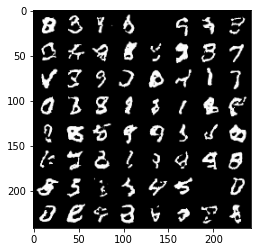

Epoch: [218/500]) Negative Log-Likelihood: -3675.338134765625
Epoch: [219/500]) Batch: [1/75] Negative Log-Likelihood: -3691.37841796875


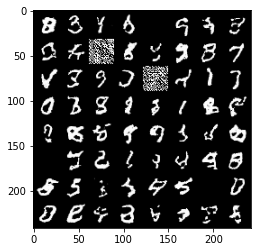

Epoch: [219/500]) Batch: [2/75] Negative Log-Likelihood: -3694.076171875
Epoch: [219/500]) Batch: [3/75] Negative Log-Likelihood: -3690.88232421875
Epoch: [219/500]) Batch: [4/75] Negative Log-Likelihood: -3681.532958984375
Epoch: [219/500]) Batch: [5/75] Negative Log-Likelihood: -3694.69873046875
Epoch: [219/500]) Batch: [6/75] Negative Log-Likelihood: -3693.8984375
Epoch: [219/500]) Batch: [7/75] Negative Log-Likelihood: -3681.7607421875
Epoch: [219/500]) Batch: [8/75] Negative Log-Likelihood: -3698.561279296875
Epoch: [219/500]) Batch: [9/75] Negative Log-Likelihood: -3704.666748046875
Epoch: [219/500]) Batch: [10/75] Negative Log-Likelihood: -3705.24609375
Epoch: [219/500]) Batch: [11/75] Negative Log-Likelihood: -3703.02294921875
Epoch: [219/500]) Batch: [12/75] Negative Log-Likelihood: -3699.2578125
Epoch: [219/500]) Batch: [13/75] Negative Log-Likelihood: -3694.928955078125
Epoch: [219/500]) Batch: [14/75] Negative Log-Likelihood: -3689.9619140625
Epoch: [219/500]) Batch: [15/75

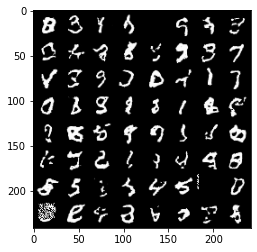

Epoch: [219/500]) Negative Log-Likelihood: -3685.804931640625
Epoch: [220/500]) Batch: [1/75] Negative Log-Likelihood: -3705.669921875


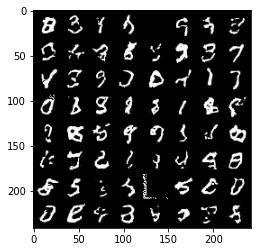

Epoch: [220/500]) Batch: [2/75] Negative Log-Likelihood: -3706.3369140625
Epoch: [220/500]) Batch: [3/75] Negative Log-Likelihood: -3715.196044921875
Epoch: [220/500]) Batch: [4/75] Negative Log-Likelihood: -3697.8935546875
Epoch: [220/500]) Batch: [5/75] Negative Log-Likelihood: -3709.9404296875
Epoch: [220/500]) Batch: [6/75] Negative Log-Likelihood: -3707.722412109375
Epoch: [220/500]) Batch: [7/75] Negative Log-Likelihood: -3699.760498046875
Epoch: [220/500]) Batch: [8/75] Negative Log-Likelihood: -3707.720458984375
Epoch: [220/500]) Batch: [9/75] Negative Log-Likelihood: -3713.33642578125
Epoch: [220/500]) Batch: [10/75] Negative Log-Likelihood: -3714.02294921875
Epoch: [220/500]) Batch: [11/75] Negative Log-Likelihood: -3708.89990234375
Epoch: [220/500]) Batch: [12/75] Negative Log-Likelihood: -3709.715576171875
Epoch: [220/500]) Batch: [13/75] Negative Log-Likelihood: -3703.992431640625
Epoch: [220/500]) Batch: [14/75] Negative Log-Likelihood: -3702.657470703125
Epoch: [220/500]

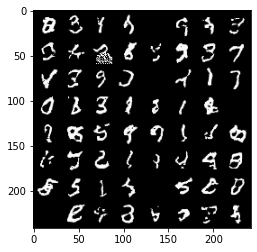

Epoch: [220/500]) Negative Log-Likelihood: -3678.33251953125
Epoch: [221/500]) Batch: [1/75] Negative Log-Likelihood: -3704.82470703125


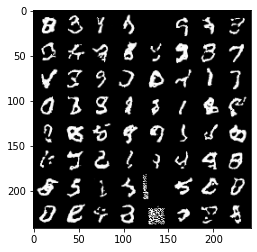

Epoch: [221/500]) Batch: [2/75] Negative Log-Likelihood: -3703.478759765625
Epoch: [221/500]) Batch: [3/75] Negative Log-Likelihood: -3711.4111328125
Epoch: [221/500]) Batch: [4/75] Negative Log-Likelihood: -3692.615478515625
Epoch: [221/500]) Batch: [5/75] Negative Log-Likelihood: -3702.409912109375
Epoch: [221/500]) Batch: [6/75] Negative Log-Likelihood: -3700.75732421875
Epoch: [221/500]) Batch: [7/75] Negative Log-Likelihood: -3682.92236328125
Epoch: [221/500]) Batch: [8/75] Negative Log-Likelihood: -3699.201904296875
Epoch: [221/500]) Batch: [9/75] Negative Log-Likelihood: -3711.8857421875
Epoch: [221/500]) Batch: [10/75] Negative Log-Likelihood: -3708.9560546875
Epoch: [221/500]) Batch: [11/75] Negative Log-Likelihood: -3708.6611328125
Epoch: [221/500]) Batch: [12/75] Negative Log-Likelihood: -3708.197509765625
Epoch: [221/500]) Batch: [13/75] Negative Log-Likelihood: -3706.85595703125
Epoch: [221/500]) Batch: [14/75] Negative Log-Likelihood: -3708.991455078125
Epoch: [221/500]) 

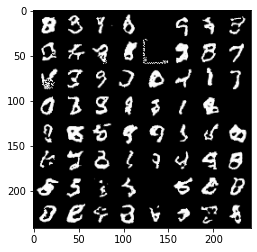

Epoch: [221/500]) Negative Log-Likelihood: -3664.43798828125
Epoch: [222/500]) Batch: [1/75] Negative Log-Likelihood: -3694.29052734375


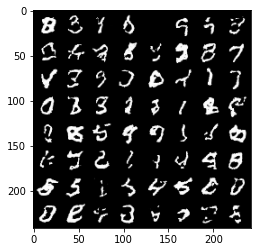

Epoch: [222/500]) Batch: [2/75] Negative Log-Likelihood: -3698.07421875
Epoch: [222/500]) Batch: [3/75] Negative Log-Likelihood: -3701.63330078125
Epoch: [222/500]) Batch: [4/75] Negative Log-Likelihood: -3689.905029296875
Epoch: [222/500]) Batch: [5/75] Negative Log-Likelihood: -3702.51220703125
Epoch: [222/500]) Batch: [6/75] Negative Log-Likelihood: -3699.764404296875
Epoch: [222/500]) Batch: [7/75] Negative Log-Likelihood: -3687.916748046875
Epoch: [222/500]) Batch: [8/75] Negative Log-Likelihood: -3706.147705078125
Epoch: [222/500]) Batch: [9/75] Negative Log-Likelihood: -3712.89794921875
Epoch: [222/500]) Batch: [10/75] Negative Log-Likelihood: -3704.80810546875
Epoch: [222/500]) Batch: [11/75] Negative Log-Likelihood: -3698.01220703125
Epoch: [222/500]) Batch: [12/75] Negative Log-Likelihood: -3704.04248046875
Epoch: [222/500]) Batch: [13/75] Negative Log-Likelihood: -3691.309326171875
Epoch: [222/500]) Batch: [14/75] Negative Log-Likelihood: -3688.12548828125
Epoch: [222/500]) 

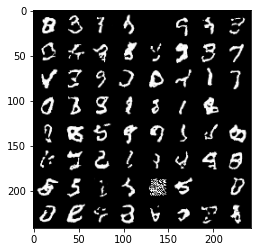

Epoch: [222/500]) Negative Log-Likelihood: -3681.653564453125
Epoch: [223/500]) Batch: [1/75] Negative Log-Likelihood: -3701.54736328125


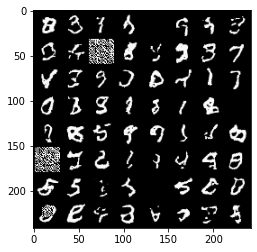

Epoch: [223/500]) Batch: [2/75] Negative Log-Likelihood: -3697.6591796875
Epoch: [223/500]) Batch: [3/75] Negative Log-Likelihood: -3709.40869140625
Epoch: [223/500]) Batch: [4/75] Negative Log-Likelihood: -3691.552978515625
Epoch: [223/500]) Batch: [5/75] Negative Log-Likelihood: -3703.82958984375
Epoch: [223/500]) Batch: [6/75] Negative Log-Likelihood: -3707.643310546875
Epoch: [223/500]) Batch: [7/75] Negative Log-Likelihood: -3697.12109375
Epoch: [223/500]) Batch: [8/75] Negative Log-Likelihood: -3706.8017578125
Epoch: [223/500]) Batch: [9/75] Negative Log-Likelihood: -3717.00927734375
Epoch: [223/500]) Batch: [10/75] Negative Log-Likelihood: -3710.958740234375
Epoch: [223/500]) Batch: [11/75] Negative Log-Likelihood: -3711.449951171875
Epoch: [223/500]) Batch: [12/75] Negative Log-Likelihood: -3713.407470703125
Epoch: [223/500]) Batch: [13/75] Negative Log-Likelihood: -3703.298095703125
Epoch: [223/500]) Batch: [14/75] Negative Log-Likelihood: -3709.444091796875
Epoch: [223/500]) 

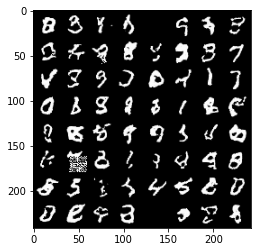

Epoch: [223/500]) Negative Log-Likelihood: -3681.2021484375
Epoch: [224/500]) Batch: [1/75] Negative Log-Likelihood: -3699.4091796875


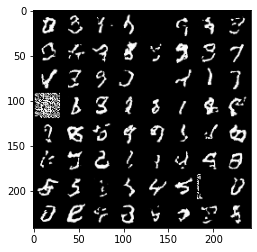

Epoch: [224/500]) Batch: [2/75] Negative Log-Likelihood: -3699.65673828125
Epoch: [224/500]) Batch: [3/75] Negative Log-Likelihood: -3709.832763671875
Epoch: [224/500]) Batch: [4/75] Negative Log-Likelihood: -3692.885498046875
Epoch: [224/500]) Batch: [5/75] Negative Log-Likelihood: -3704.14501953125
Epoch: [224/500]) Batch: [6/75] Negative Log-Likelihood: -3707.5859375
Epoch: [224/500]) Batch: [7/75] Negative Log-Likelihood: -3695.17333984375
Epoch: [224/500]) Batch: [8/75] Negative Log-Likelihood: -3702.677978515625
Epoch: [224/500]) Batch: [9/75] Negative Log-Likelihood: -3713.002197265625
Epoch: [224/500]) Batch: [10/75] Negative Log-Likelihood: -3708.123779296875
Epoch: [224/500]) Batch: [11/75] Negative Log-Likelihood: -3709.473876953125
Epoch: [224/500]) Batch: [12/75] Negative Log-Likelihood: -3704.49462890625
Epoch: [224/500]) Batch: [13/75] Negative Log-Likelihood: -3696.965576171875
Epoch: [224/500]) Batch: [14/75] Negative Log-Likelihood: -3704.220458984375
Epoch: [224/500]

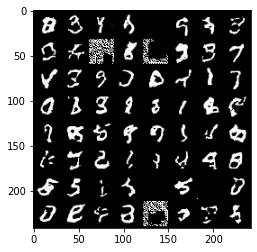

Epoch: [224/500]) Negative Log-Likelihood: -3678.091796875
Epoch: [225/500]) Batch: [1/75] Negative Log-Likelihood: -3700.45751953125


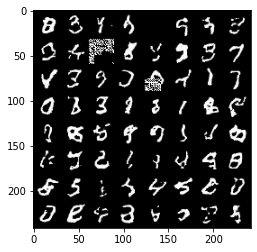

Epoch: [225/500]) Batch: [2/75] Negative Log-Likelihood: -3701.824951171875
Epoch: [225/500]) Batch: [3/75] Negative Log-Likelihood: -3707.919677734375
Epoch: [225/500]) Batch: [4/75] Negative Log-Likelihood: -3694.28515625
Epoch: [225/500]) Batch: [5/75] Negative Log-Likelihood: -3709.02001953125
Epoch: [225/500]) Batch: [6/75] Negative Log-Likelihood: -3704.2373046875
Epoch: [225/500]) Batch: [7/75] Negative Log-Likelihood: -3697.141845703125
Epoch: [225/500]) Batch: [8/75] Negative Log-Likelihood: -3706.6923828125
Epoch: [225/500]) Batch: [9/75] Negative Log-Likelihood: -3717.280029296875
Epoch: [225/500]) Batch: [10/75] Negative Log-Likelihood: -3711.265869140625
Epoch: [225/500]) Batch: [11/75] Negative Log-Likelihood: -3709.89111328125
Epoch: [225/500]) Batch: [12/75] Negative Log-Likelihood: -3707.51123046875
Epoch: [225/500]) Batch: [13/75] Negative Log-Likelihood: -3706.06689453125
Epoch: [225/500]) Batch: [14/75] Negative Log-Likelihood: -3705.409912109375
Epoch: [225/500]) B

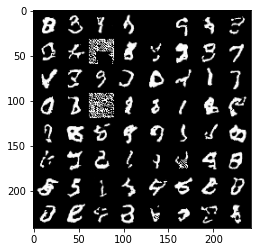

Epoch: [225/500]) Negative Log-Likelihood: -3679.510498046875
Epoch: [226/500]) Batch: [1/75] Negative Log-Likelihood: -3703.0146484375


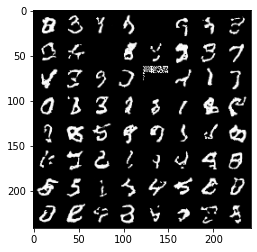

Epoch: [226/500]) Batch: [2/75] Negative Log-Likelihood: -3703.5849609375
Epoch: [226/500]) Batch: [3/75] Negative Log-Likelihood: -3713.1318359375
Epoch: [226/500]) Batch: [4/75] Negative Log-Likelihood: -3696.67236328125
Epoch: [226/500]) Batch: [5/75] Negative Log-Likelihood: -3706.96875
Epoch: [226/500]) Batch: [6/75] Negative Log-Likelihood: -3709.4716796875
Epoch: [226/500]) Batch: [7/75] Negative Log-Likelihood: -3701.449951171875
Epoch: [226/500]) Batch: [8/75] Negative Log-Likelihood: -3712.3798828125
Epoch: [226/500]) Batch: [9/75] Negative Log-Likelihood: -3719.653076171875
Epoch: [226/500]) Batch: [10/75] Negative Log-Likelihood: -3716.0
Epoch: [226/500]) Batch: [11/75] Negative Log-Likelihood: -3709.086181640625
Epoch: [226/500]) Batch: [12/75] Negative Log-Likelihood: -3713.3798828125
Epoch: [226/500]) Batch: [13/75] Negative Log-Likelihood: -3697.662109375
Epoch: [226/500]) Batch: [14/75] Negative Log-Likelihood: -3696.166748046875
Epoch: [226/500]) Batch: [15/75] Negati

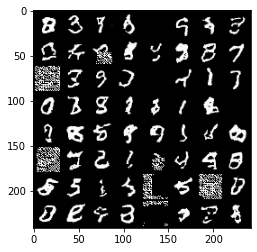

Epoch: [226/500]) Negative Log-Likelihood: -3675.046142578125
Epoch: [227/500]) Batch: [1/75] Negative Log-Likelihood: -3700.608154296875


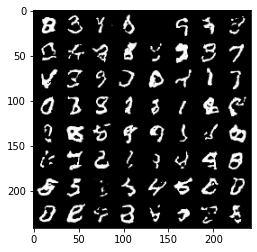

Epoch: [227/500]) Batch: [2/75] Negative Log-Likelihood: -3699.376708984375
Epoch: [227/500]) Batch: [3/75] Negative Log-Likelihood: -3709.4345703125
Epoch: [227/500]) Batch: [4/75] Negative Log-Likelihood: -3695.5634765625
Epoch: [227/500]) Batch: [5/75] Negative Log-Likelihood: -3700.91552734375
Epoch: [227/500]) Batch: [6/75] Negative Log-Likelihood: -3705.035888671875
Epoch: [227/500]) Batch: [7/75] Negative Log-Likelihood: -3675.952392578125
Epoch: [227/500]) Batch: [8/75] Negative Log-Likelihood: -3653.14111328125
Epoch: [227/500]) Batch: [9/75] Negative Log-Likelihood: -3676.0234375
Epoch: [227/500]) Batch: [10/75] Negative Log-Likelihood: -3686.396484375
Epoch: [227/500]) Batch: [11/75] Negative Log-Likelihood: -3689.802978515625
Epoch: [227/500]) Batch: [12/75] Negative Log-Likelihood: -3693.489501953125
Epoch: [227/500]) Batch: [13/75] Negative Log-Likelihood: -3683.242431640625
Epoch: [227/500]) Batch: [14/75] Negative Log-Likelihood: -3691.488037109375
Epoch: [227/500]) Bat

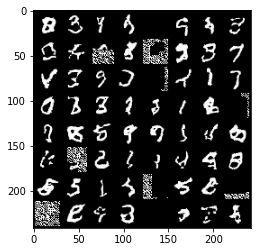

Epoch: [227/500]) Negative Log-Likelihood: -3677.7861328125
Epoch: [228/500]) Batch: [1/75] Negative Log-Likelihood: -3696.396728515625


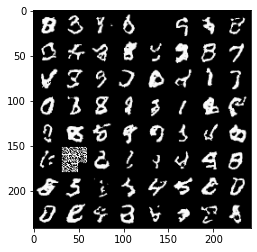

Epoch: [228/500]) Batch: [2/75] Negative Log-Likelihood: -3695.103271484375
Epoch: [228/500]) Batch: [3/75] Negative Log-Likelihood: -3704.796142578125
Epoch: [228/500]) Batch: [4/75] Negative Log-Likelihood: -3686.677978515625
Epoch: [228/500]) Batch: [5/75] Negative Log-Likelihood: -3699.32080078125
Epoch: [228/500]) Batch: [6/75] Negative Log-Likelihood: -3690.54833984375
Epoch: [228/500]) Batch: [7/75] Negative Log-Likelihood: -3687.6015625
Epoch: [228/500]) Batch: [8/75] Negative Log-Likelihood: -3698.613037109375
Epoch: [228/500]) Batch: [9/75] Negative Log-Likelihood: -3711.412841796875
Epoch: [228/500]) Batch: [10/75] Negative Log-Likelihood: -3705.44970703125
Epoch: [228/500]) Batch: [11/75] Negative Log-Likelihood: -3705.3681640625
Epoch: [228/500]) Batch: [12/75] Negative Log-Likelihood: -3704.903564453125
Epoch: [228/500]) Batch: [13/75] Negative Log-Likelihood: -3689.949951171875
Epoch: [228/500]) Batch: [14/75] Negative Log-Likelihood: -3704.2578125
Epoch: [228/500]) Batc

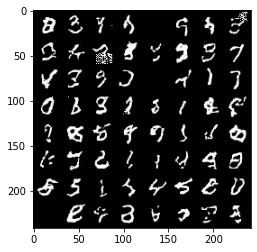

Epoch: [228/500]) Negative Log-Likelihood: -3665.30126953125
Epoch: [229/500]) Batch: [1/75] Negative Log-Likelihood: -3679.520751953125


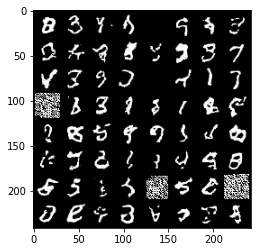

Epoch: [229/500]) Batch: [2/75] Negative Log-Likelihood: -3690.5869140625
Epoch: [229/500]) Batch: [3/75] Negative Log-Likelihood: -3704.39990234375
Epoch: [229/500]) Batch: [4/75] Negative Log-Likelihood: -3690.086181640625
Epoch: [229/500]) Batch: [5/75] Negative Log-Likelihood: -3699.814208984375
Epoch: [229/500]) Batch: [6/75] Negative Log-Likelihood: -3696.4208984375
Epoch: [229/500]) Batch: [7/75] Negative Log-Likelihood: -3693.084228515625
Epoch: [229/500]) Batch: [8/75] Negative Log-Likelihood: -3702.646484375
Epoch: [229/500]) Batch: [9/75] Negative Log-Likelihood: -3707.693115234375
Epoch: [229/500]) Batch: [10/75] Negative Log-Likelihood: -3702.71142578125
Epoch: [229/500]) Batch: [11/75] Negative Log-Likelihood: -3705.683349609375
Epoch: [229/500]) Batch: [12/75] Negative Log-Likelihood: -3705.699951171875
Epoch: [229/500]) Batch: [13/75] Negative Log-Likelihood: -3699.86865234375
Epoch: [229/500]) Batch: [14/75] Negative Log-Likelihood: -3703.936279296875
Epoch: [229/500])

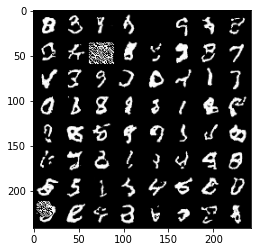

Epoch: [229/500]) Negative Log-Likelihood: -3677.9248046875
Epoch: [230/500]) Batch: [1/75] Negative Log-Likelihood: -3692.510498046875


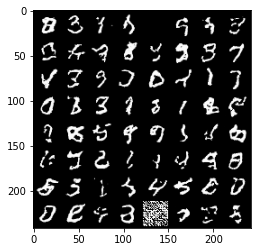

Epoch: [230/500]) Batch: [2/75] Negative Log-Likelihood: -3695.081787109375
Epoch: [230/500]) Batch: [3/75] Negative Log-Likelihood: -3710.281494140625
Epoch: [230/500]) Batch: [4/75] Negative Log-Likelihood: -3687.364501953125
Epoch: [230/500]) Batch: [5/75] Negative Log-Likelihood: -3689.057373046875
Epoch: [230/500]) Batch: [6/75] Negative Log-Likelihood: -3697.640625
Epoch: [230/500]) Batch: [7/75] Negative Log-Likelihood: -3693.092529296875
Epoch: [230/500]) Batch: [8/75] Negative Log-Likelihood: -3697.84423828125
Epoch: [230/500]) Batch: [9/75] Negative Log-Likelihood: -3705.162353515625
Epoch: [230/500]) Batch: [10/75] Negative Log-Likelihood: -3712.17626953125
Epoch: [230/500]) Batch: [11/75] Negative Log-Likelihood: -3706.548583984375
Epoch: [230/500]) Batch: [12/75] Negative Log-Likelihood: -3695.963623046875
Epoch: [230/500]) Batch: [13/75] Negative Log-Likelihood: -3699.48876953125
Epoch: [230/500]) Batch: [14/75] Negative Log-Likelihood: -3704.036865234375
Epoch: [230/500]

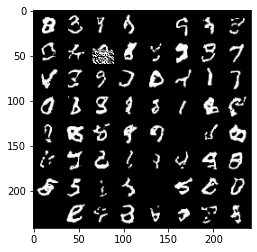

Epoch: [230/500]) Negative Log-Likelihood: -3687.813720703125
Epoch: [231/500]) Batch: [1/75] Negative Log-Likelihood: -3707.404541015625


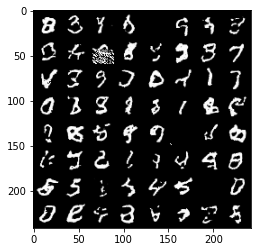

Epoch: [231/500]) Batch: [2/75] Negative Log-Likelihood: -3710.850341796875
Epoch: [231/500]) Batch: [3/75] Negative Log-Likelihood: -3705.30419921875
Epoch: [231/500]) Batch: [4/75] Negative Log-Likelihood: -3687.7744140625
Epoch: [231/500]) Batch: [5/75] Negative Log-Likelihood: -3701.0
Epoch: [231/500]) Batch: [6/75] Negative Log-Likelihood: -3701.609375
Epoch: [231/500]) Batch: [7/75] Negative Log-Likelihood: -3695.897705078125
Epoch: [231/500]) Batch: [8/75] Negative Log-Likelihood: -3706.137939453125
Epoch: [231/500]) Batch: [9/75] Negative Log-Likelihood: -3715.356689453125
Epoch: [231/500]) Batch: [10/75] Negative Log-Likelihood: -3713.713623046875
Epoch: [231/500]) Batch: [11/75] Negative Log-Likelihood: -3713.59423828125
Epoch: [231/500]) Batch: [12/75] Negative Log-Likelihood: -3709.17919921875
Epoch: [231/500]) Batch: [13/75] Negative Log-Likelihood: -3698.338623046875
Epoch: [231/500]) Batch: [14/75] Negative Log-Likelihood: -3710.983154296875
Epoch: [231/500]) Batch: [15/

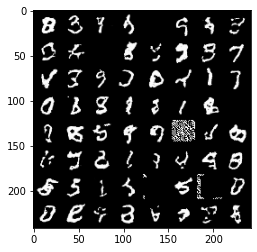

Epoch: [231/500]) Negative Log-Likelihood: -3682.30126953125
Epoch: [232/500]) Batch: [1/75] Negative Log-Likelihood: -3701.734375


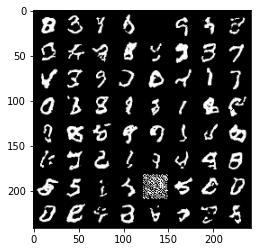

Epoch: [232/500]) Batch: [2/75] Negative Log-Likelihood: -3703.6650390625
Epoch: [232/500]) Batch: [3/75] Negative Log-Likelihood: -3710.664306640625
Epoch: [232/500]) Batch: [4/75] Negative Log-Likelihood: -3694.661865234375
Epoch: [232/500]) Batch: [5/75] Negative Log-Likelihood: -3705.701416015625
Epoch: [232/500]) Batch: [6/75] Negative Log-Likelihood: -3709.0205078125
Epoch: [232/500]) Batch: [7/75] Negative Log-Likelihood: -3695.7626953125
Epoch: [232/500]) Batch: [8/75] Negative Log-Likelihood: -3712.405029296875
Epoch: [232/500]) Batch: [9/75] Negative Log-Likelihood: -3717.93310546875
Epoch: [232/500]) Batch: [10/75] Negative Log-Likelihood: -3712.583740234375
Epoch: [232/500]) Batch: [11/75] Negative Log-Likelihood: -3714.966064453125
Epoch: [232/500]) Batch: [12/75] Negative Log-Likelihood: -3712.551513671875
Epoch: [232/500]) Batch: [13/75] Negative Log-Likelihood: -3705.082763671875
Epoch: [232/500]) Batch: [14/75] Negative Log-Likelihood: -3712.25244140625
Epoch: [232/500

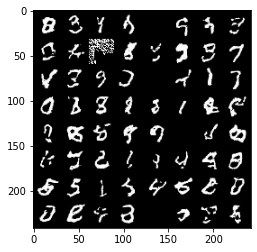

Epoch: [232/500]) Negative Log-Likelihood: -3672.171875
Epoch: [233/500]) Batch: [1/75] Negative Log-Likelihood: -3697.944580078125


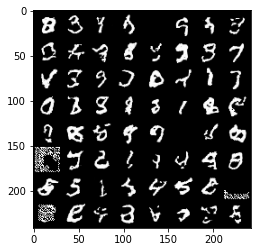

Epoch: [233/500]) Batch: [2/75] Negative Log-Likelihood: -3700.0849609375
Epoch: [233/500]) Batch: [3/75] Negative Log-Likelihood: -3705.41357421875
Epoch: [233/500]) Batch: [4/75] Negative Log-Likelihood: -3691.943603515625
Epoch: [233/500]) Batch: [5/75] Negative Log-Likelihood: -3703.65869140625
Epoch: [233/500]) Batch: [6/75] Negative Log-Likelihood: -3702.014892578125
Epoch: [233/500]) Batch: [7/75] Negative Log-Likelihood: -3693.69921875
Epoch: [233/500]) Batch: [8/75] Negative Log-Likelihood: -3708.833740234375
Epoch: [233/500]) Batch: [9/75] Negative Log-Likelihood: -3714.106201171875
Epoch: [233/500]) Batch: [10/75] Negative Log-Likelihood: -3710.133056640625
Epoch: [233/500]) Batch: [11/75] Negative Log-Likelihood: -3707.8203125
Epoch: [233/500]) Batch: [12/75] Negative Log-Likelihood: -3703.339599609375
Epoch: [233/500]) Batch: [13/75] Negative Log-Likelihood: -3695.947998046875
Epoch: [233/500]) Batch: [14/75] Negative Log-Likelihood: -3704.954833984375
Epoch: [233/500]) Ba

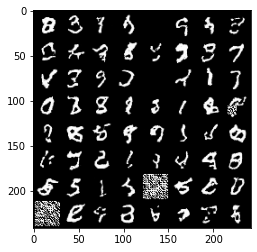

Epoch: [233/500]) Negative Log-Likelihood: -3677.8505859375
Epoch: [234/500]) Batch: [1/75] Negative Log-Likelihood: -3697.37060546875


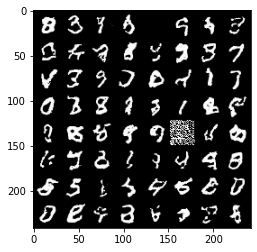

Epoch: [234/500]) Batch: [2/75] Negative Log-Likelihood: -3698.0966796875
Epoch: [234/500]) Batch: [3/75] Negative Log-Likelihood: -3710.5654296875
Epoch: [234/500]) Batch: [4/75] Negative Log-Likelihood: -3695.833740234375
Epoch: [234/500]) Batch: [5/75] Negative Log-Likelihood: -3703.075439453125
Epoch: [234/500]) Batch: [6/75] Negative Log-Likelihood: -3697.9609375
Epoch: [234/500]) Batch: [7/75] Negative Log-Likelihood: -3696.68994140625
Epoch: [234/500]) Batch: [8/75] Negative Log-Likelihood: -3706.6162109375
Epoch: [234/500]) Batch: [9/75] Negative Log-Likelihood: -3714.23681640625
Epoch: [234/500]) Batch: [10/75] Negative Log-Likelihood: -3712.2978515625
Epoch: [234/500]) Batch: [11/75] Negative Log-Likelihood: -3711.50048828125
Epoch: [234/500]) Batch: [12/75] Negative Log-Likelihood: -3703.79248046875
Epoch: [234/500]) Batch: [13/75] Negative Log-Likelihood: -3688.7998046875
Epoch: [234/500]) Batch: [14/75] Negative Log-Likelihood: -3700.29736328125
Epoch: [234/500]) Batch: [1

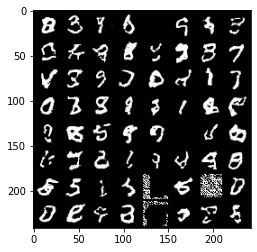

Epoch: [234/500]) Negative Log-Likelihood: -3688.36669921875
Epoch: [235/500]) Batch: [1/75] Negative Log-Likelihood: -3702.68017578125


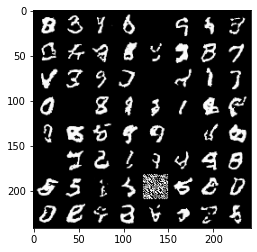

Epoch: [235/500]) Batch: [2/75] Negative Log-Likelihood: -3695.08935546875
Epoch: [235/500]) Batch: [3/75] Negative Log-Likelihood: -3711.044189453125
Epoch: [235/500]) Batch: [4/75] Negative Log-Likelihood: -3691.713134765625
Epoch: [235/500]) Batch: [5/75] Negative Log-Likelihood: -3696.759521484375
Epoch: [235/500]) Batch: [6/75] Negative Log-Likelihood: -3704.24365234375
Epoch: [235/500]) Batch: [7/75] Negative Log-Likelihood: -3691.9716796875
Epoch: [235/500]) Batch: [8/75] Negative Log-Likelihood: -3704.489501953125
Epoch: [235/500]) Batch: [9/75] Negative Log-Likelihood: -3713.9912109375
Epoch: [235/500]) Batch: [10/75] Negative Log-Likelihood: -3705.983642578125
Epoch: [235/500]) Batch: [11/75] Negative Log-Likelihood: -3700.814697265625
Epoch: [235/500]) Batch: [12/75] Negative Log-Likelihood: -3708.40625
Epoch: [235/500]) Batch: [13/75] Negative Log-Likelihood: -3698.179931640625
Epoch: [235/500]) Batch: [14/75] Negative Log-Likelihood: -3701.052734375
Epoch: [235/500]) Batch

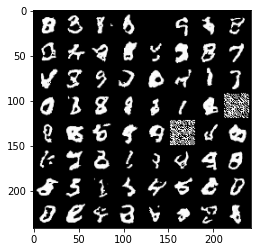

Epoch: [235/500]) Negative Log-Likelihood: -3675.959228515625
Epoch: [236/500]) Batch: [1/75] Negative Log-Likelihood: -3689.177978515625


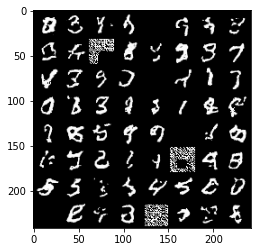

Epoch: [236/500]) Batch: [2/75] Negative Log-Likelihood: -3700.25732421875
Epoch: [236/500]) Batch: [3/75] Negative Log-Likelihood: -3701.00830078125
Epoch: [236/500]) Batch: [4/75] Negative Log-Likelihood: -3690.072509765625
Epoch: [236/500]) Batch: [5/75] Negative Log-Likelihood: -3703.2275390625
Epoch: [236/500]) Batch: [6/75] Negative Log-Likelihood: -3702.723876953125
Epoch: [236/500]) Batch: [7/75] Negative Log-Likelihood: -3693.7900390625
Epoch: [236/500]) Batch: [8/75] Negative Log-Likelihood: -3706.0673828125
Epoch: [236/500]) Batch: [9/75] Negative Log-Likelihood: -3715.21826171875
Epoch: [236/500]) Batch: [10/75] Negative Log-Likelihood: -3710.8720703125
Epoch: [236/500]) Batch: [11/75] Negative Log-Likelihood: -3704.324951171875
Epoch: [236/500]) Batch: [12/75] Negative Log-Likelihood: -3707.831787109375
Epoch: [236/500]) Batch: [13/75] Negative Log-Likelihood: -3700.044189453125
Epoch: [236/500]) Batch: [14/75] Negative Log-Likelihood: -3707.56982421875
Epoch: [236/500]) B

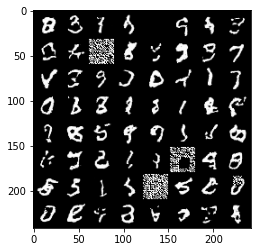

Epoch: [236/500]) Negative Log-Likelihood: -3679.2001953125
Epoch: [237/500]) Batch: [1/75] Negative Log-Likelihood: -3696.6298828125


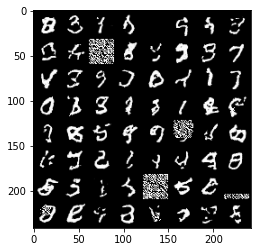

Epoch: [237/500]) Batch: [2/75] Negative Log-Likelihood: -3702.193115234375
Epoch: [237/500]) Batch: [3/75] Negative Log-Likelihood: -3702.992431640625
Epoch: [237/500]) Batch: [4/75] Negative Log-Likelihood: -3687.46484375
Epoch: [237/500]) Batch: [5/75] Negative Log-Likelihood: -3702.550537109375
Epoch: [237/500]) Batch: [6/75] Negative Log-Likelihood: -3702.030517578125
Epoch: [237/500]) Batch: [7/75] Negative Log-Likelihood: -3692.381591796875
Epoch: [237/500]) Batch: [8/75] Negative Log-Likelihood: -3706.5341796875
Epoch: [237/500]) Batch: [9/75] Negative Log-Likelihood: -3714.367919921875
Epoch: [237/500]) Batch: [10/75] Negative Log-Likelihood: -3708.468017578125
Epoch: [237/500]) Batch: [11/75] Negative Log-Likelihood: -3711.573974609375
Epoch: [237/500]) Batch: [12/75] Negative Log-Likelihood: -3706.68896484375
Epoch: [237/500]) Batch: [13/75] Negative Log-Likelihood: -3703.903076171875
Epoch: [237/500]) Batch: [14/75] Negative Log-Likelihood: -3706.646484375
Epoch: [237/500])

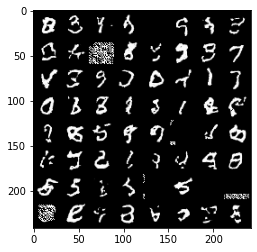

Epoch: [237/500]) Negative Log-Likelihood: -3684.00439453125
Epoch: [238/500]) Batch: [1/75] Negative Log-Likelihood: -3704.291259765625


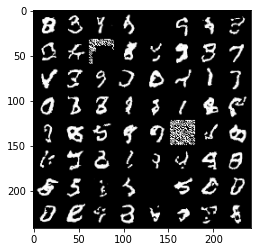

Epoch: [238/500]) Batch: [2/75] Negative Log-Likelihood: -3706.778564453125
Epoch: [238/500]) Batch: [3/75] Negative Log-Likelihood: -3710.648681640625
Epoch: [238/500]) Batch: [4/75] Negative Log-Likelihood: -3694.008056640625
Epoch: [238/500]) Batch: [5/75] Negative Log-Likelihood: -3703.8984375
Epoch: [238/500]) Batch: [6/75] Negative Log-Likelihood: -3702.260009765625
Epoch: [238/500]) Batch: [7/75] Negative Log-Likelihood: -3696.2861328125
Epoch: [238/500]) Batch: [8/75] Negative Log-Likelihood: -3711.352783203125
Epoch: [238/500]) Batch: [9/75] Negative Log-Likelihood: -3711.4423828125
Epoch: [238/500]) Batch: [10/75] Negative Log-Likelihood: -3706.77001953125
Epoch: [238/500]) Batch: [11/75] Negative Log-Likelihood: -3709.633056640625
Epoch: [238/500]) Batch: [12/75] Negative Log-Likelihood: -3709.6357421875
Epoch: [238/500]) Batch: [13/75] Negative Log-Likelihood: -3705.606689453125
Epoch: [238/500]) Batch: [14/75] Negative Log-Likelihood: -3702.759033203125
Epoch: [238/500]) B

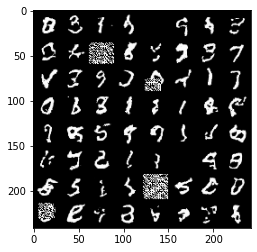

Epoch: [238/500]) Negative Log-Likelihood: -3682.11181640625
Epoch: [239/500]) Batch: [1/75] Negative Log-Likelihood: -3699.647705078125


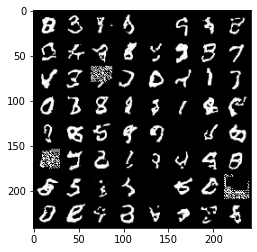

Epoch: [239/500]) Batch: [2/75] Negative Log-Likelihood: -3698.39208984375
Epoch: [239/500]) Batch: [3/75] Negative Log-Likelihood: -3707.8876953125
Epoch: [239/500]) Batch: [4/75] Negative Log-Likelihood: -3698.67919921875
Epoch: [239/500]) Batch: [5/75] Negative Log-Likelihood: -3699.291259765625
Epoch: [239/500]) Batch: [6/75] Negative Log-Likelihood: -3694.889404296875
Epoch: [239/500]) Batch: [7/75] Negative Log-Likelihood: -3691.351806640625
Epoch: [239/500]) Batch: [8/75] Negative Log-Likelihood: -3709.58251953125
Epoch: [239/500]) Batch: [9/75] Negative Log-Likelihood: -3712.96044921875
Epoch: [239/500]) Batch: [10/75] Negative Log-Likelihood: -3706.028076171875
Epoch: [239/500]) Batch: [11/75] Negative Log-Likelihood: -3707.155029296875
Epoch: [239/500]) Batch: [12/75] Negative Log-Likelihood: -3710.56494140625
Epoch: [239/500]) Batch: [13/75] Negative Log-Likelihood: -3695.294677734375
Epoch: [239/500]) Batch: [14/75] Negative Log-Likelihood: -3695.80517578125
Epoch: [239/500

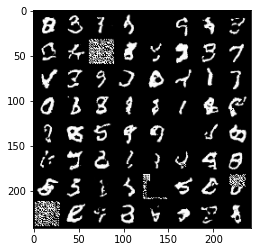

Epoch: [239/500]) Negative Log-Likelihood: -3687.605224609375
Epoch: [240/500]) Batch: [1/75] Negative Log-Likelihood: -3700.799072265625


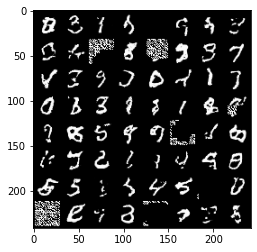

Epoch: [240/500]) Batch: [2/75] Negative Log-Likelihood: -3704.8896484375
Epoch: [240/500]) Batch: [3/75] Negative Log-Likelihood: -3717.04345703125
Epoch: [240/500]) Batch: [4/75] Negative Log-Likelihood: -3694.78125
Epoch: [240/500]) Batch: [5/75] Negative Log-Likelihood: -3709.370849609375
Epoch: [240/500]) Batch: [6/75] Negative Log-Likelihood: -3713.081787109375
Epoch: [240/500]) Batch: [7/75] Negative Log-Likelihood: -3698.763671875
Epoch: [240/500]) Batch: [8/75] Negative Log-Likelihood: -3712.1962890625
Epoch: [240/500]) Batch: [9/75] Negative Log-Likelihood: -3719.552978515625
Epoch: [240/500]) Batch: [10/75] Negative Log-Likelihood: -3714.5673828125
Epoch: [240/500]) Batch: [11/75] Negative Log-Likelihood: -3711.02490234375
Epoch: [240/500]) Batch: [12/75] Negative Log-Likelihood: -3708.312744140625
Epoch: [240/500]) Batch: [13/75] Negative Log-Likelihood: -3704.595458984375
Epoch: [240/500]) Batch: [14/75] Negative Log-Likelihood: -3706.59375
Epoch: [240/500]) Batch: [15/75]

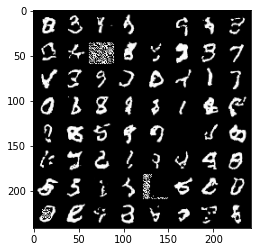

Epoch: [240/500]) Negative Log-Likelihood: -3682.060546875
Epoch: [241/500]) Batch: [1/75] Negative Log-Likelihood: -3701.25244140625


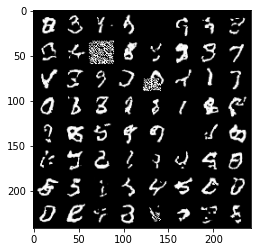

Epoch: [241/500]) Batch: [2/75] Negative Log-Likelihood: -3704.17626953125
Epoch: [241/500]) Batch: [3/75] Negative Log-Likelihood: -3710.09619140625
Epoch: [241/500]) Batch: [4/75] Negative Log-Likelihood: -3694.1357421875
Epoch: [241/500]) Batch: [5/75] Negative Log-Likelihood: -3702.536376953125
Epoch: [241/500]) Batch: [6/75] Negative Log-Likelihood: -3701.927490234375
Epoch: [241/500]) Batch: [7/75] Negative Log-Likelihood: -3696.82763671875
Epoch: [241/500]) Batch: [8/75] Negative Log-Likelihood: -3711.983154296875
Epoch: [241/500]) Batch: [9/75] Negative Log-Likelihood: -3716.75732421875
Epoch: [241/500]) Batch: [10/75] Negative Log-Likelihood: -3716.088623046875
Epoch: [241/500]) Batch: [11/75] Negative Log-Likelihood: -3712.859619140625
Epoch: [241/500]) Batch: [12/75] Negative Log-Likelihood: -3714.66015625
Epoch: [241/500]) Batch: [13/75] Negative Log-Likelihood: -3706.489990234375
Epoch: [241/500]) Batch: [14/75] Negative Log-Likelihood: -3707.322998046875
Epoch: [241/500])

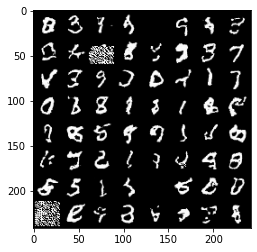

Epoch: [241/500]) Negative Log-Likelihood: -3684.4169921875
Epoch: [242/500]) Batch: [1/75] Negative Log-Likelihood: -3707.2529296875


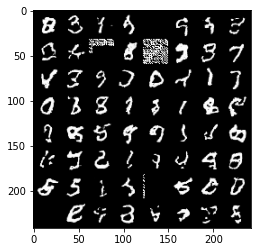

Epoch: [242/500]) Batch: [2/75] Negative Log-Likelihood: -3707.438720703125
Epoch: [242/500]) Batch: [3/75] Negative Log-Likelihood: -3719.262939453125
Epoch: [242/500]) Batch: [4/75] Negative Log-Likelihood: -3698.94140625
Epoch: [242/500]) Batch: [5/75] Negative Log-Likelihood: -3709.2060546875
Epoch: [242/500]) Batch: [6/75] Negative Log-Likelihood: -3705.536865234375
Epoch: [242/500]) Batch: [7/75] Negative Log-Likelihood: -3698.887451171875
Epoch: [242/500]) Batch: [8/75] Negative Log-Likelihood: -3705.731201171875
Epoch: [242/500]) Batch: [9/75] Negative Log-Likelihood: -3720.876708984375
Epoch: [242/500]) Batch: [10/75] Negative Log-Likelihood: -3710.2978515625
Epoch: [242/500]) Batch: [11/75] Negative Log-Likelihood: -3704.731689453125
Epoch: [242/500]) Batch: [12/75] Negative Log-Likelihood: -3708.868896484375
Epoch: [242/500]) Batch: [13/75] Negative Log-Likelihood: -3701.329345703125
Epoch: [242/500]) Batch: [14/75] Negative Log-Likelihood: -3702.798583984375
Epoch: [242/500

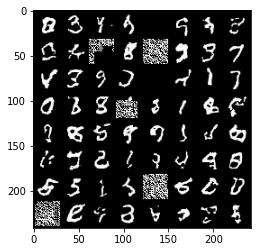

Epoch: [242/500]) Negative Log-Likelihood: -3683.138671875
Epoch: [243/500]) Batch: [1/75] Negative Log-Likelihood: -3697.72998046875


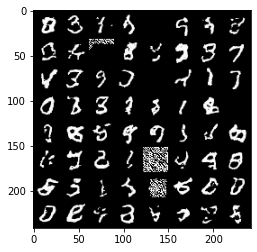

Epoch: [243/500]) Batch: [2/75] Negative Log-Likelihood: -3700.3935546875
Epoch: [243/500]) Batch: [3/75] Negative Log-Likelihood: -3711.42919921875
Epoch: [243/500]) Batch: [4/75] Negative Log-Likelihood: -3694.919677734375
Epoch: [243/500]) Batch: [5/75] Negative Log-Likelihood: -3702.27392578125
Epoch: [243/500]) Batch: [6/75] Negative Log-Likelihood: -3687.2998046875
Epoch: [243/500]) Batch: [7/75] Negative Log-Likelihood: -3691.81396484375
Epoch: [243/500]) Batch: [8/75] Negative Log-Likelihood: -3707.2333984375
Epoch: [243/500]) Batch: [9/75] Negative Log-Likelihood: -3711.223876953125
Epoch: [243/500]) Batch: [10/75] Negative Log-Likelihood: -3711.5478515625
Epoch: [243/500]) Batch: [11/75] Negative Log-Likelihood: -3711.7412109375
Epoch: [243/500]) Batch: [12/75] Negative Log-Likelihood: -3705.88720703125
Epoch: [243/500]) Batch: [13/75] Negative Log-Likelihood: -3704.62841796875
Epoch: [243/500]) Batch: [14/75] Negative Log-Likelihood: -3701.902099609375
Epoch: [243/500]) Batc

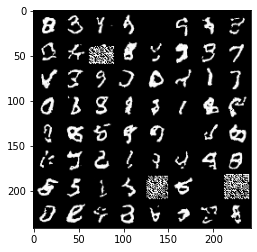

Epoch: [243/500]) Negative Log-Likelihood: -3682.577392578125
Epoch: [244/500]) Batch: [1/75] Negative Log-Likelihood: -3702.555908203125


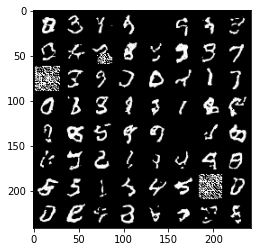

Epoch: [244/500]) Batch: [2/75] Negative Log-Likelihood: -3705.015625
Epoch: [244/500]) Batch: [3/75] Negative Log-Likelihood: -3703.5
Epoch: [244/500]) Batch: [4/75] Negative Log-Likelihood: -3693.423583984375
Epoch: [244/500]) Batch: [5/75] Negative Log-Likelihood: -3696.932373046875
Epoch: [244/500]) Batch: [6/75] Negative Log-Likelihood: -3673.497314453125
Epoch: [244/500]) Batch: [7/75] Negative Log-Likelihood: -3685.57861328125
Epoch: [244/500]) Batch: [8/75] Negative Log-Likelihood: -3699.769287109375
Epoch: [244/500]) Batch: [9/75] Negative Log-Likelihood: -3710.465576171875
Epoch: [244/500]) Batch: [10/75] Negative Log-Likelihood: -3705.155517578125
Epoch: [244/500]) Batch: [11/75] Negative Log-Likelihood: -3708.513427734375
Epoch: [244/500]) Batch: [12/75] Negative Log-Likelihood: -3707.407470703125
Epoch: [244/500]) Batch: [13/75] Negative Log-Likelihood: -3697.01904296875
Epoch: [244/500]) Batch: [14/75] Negative Log-Likelihood: -3705.424072265625
Epoch: [244/500]) Batch: [

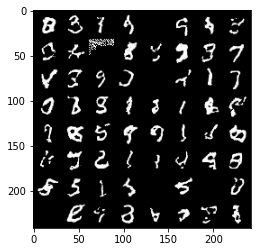

Epoch: [244/500]) Negative Log-Likelihood: -3685.83544921875
Epoch: [245/500]) Batch: [1/75] Negative Log-Likelihood: -3707.113037109375


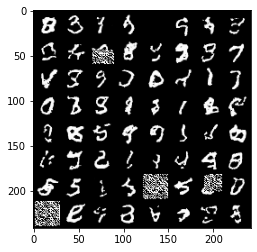

Epoch: [245/500]) Batch: [2/75] Negative Log-Likelihood: -3709.75048828125
Epoch: [245/500]) Batch: [3/75] Negative Log-Likelihood: -3716.987060546875
Epoch: [245/500]) Batch: [4/75] Negative Log-Likelihood: -3696.0234375
Epoch: [245/500]) Batch: [5/75] Negative Log-Likelihood: -3705.27734375
Epoch: [245/500]) Batch: [6/75] Negative Log-Likelihood: -3702.254638671875
Epoch: [245/500]) Batch: [7/75] Negative Log-Likelihood: -3683.117431640625
Epoch: [245/500]) Batch: [8/75] Negative Log-Likelihood: -3705.019287109375
Epoch: [245/500]) Batch: [9/75] Negative Log-Likelihood: -3712.928955078125
Epoch: [245/500]) Batch: [10/75] Negative Log-Likelihood: -3704.325439453125
Epoch: [245/500]) Batch: [11/75] Negative Log-Likelihood: -3710.1630859375
Epoch: [245/500]) Batch: [12/75] Negative Log-Likelihood: -3700.863037109375
Epoch: [245/500]) Batch: [13/75] Negative Log-Likelihood: -3702.931884765625
Epoch: [245/500]) Batch: [14/75] Negative Log-Likelihood: -3708.39404296875
Epoch: [245/500]) Ba

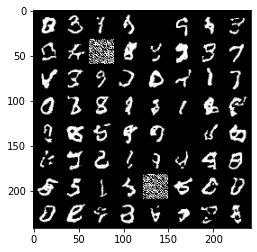

Epoch: [245/500]) Negative Log-Likelihood: -3686.91845703125
Epoch: [246/500]) Batch: [1/75] Negative Log-Likelihood: -3704.940185546875


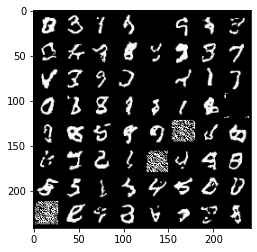

Epoch: [246/500]) Batch: [2/75] Negative Log-Likelihood: -3705.946533203125
Epoch: [246/500]) Batch: [3/75] Negative Log-Likelihood: -3710.2529296875
Epoch: [246/500]) Batch: [4/75] Negative Log-Likelihood: -3687.52734375
Epoch: [246/500]) Batch: [5/75] Negative Log-Likelihood: -3710.15234375
Epoch: [246/500]) Batch: [6/75] Negative Log-Likelihood: -3700.047119140625
Epoch: [246/500]) Batch: [7/75] Negative Log-Likelihood: -3683.64453125
Epoch: [246/500]) Batch: [8/75] Negative Log-Likelihood: -3704.546875
Epoch: [246/500]) Batch: [9/75] Negative Log-Likelihood: -3714.843017578125
Epoch: [246/500]) Batch: [10/75] Negative Log-Likelihood: -3697.1748046875
Epoch: [246/500]) Batch: [11/75] Negative Log-Likelihood: -3691.18994140625
Epoch: [246/500]) Batch: [12/75] Negative Log-Likelihood: -3703.92529296875
Epoch: [246/500]) Batch: [13/75] Negative Log-Likelihood: -3703.33935546875
Epoch: [246/500]) Batch: [14/75] Negative Log-Likelihood: -3703.213134765625
Epoch: [246/500]) Batch: [15/75]

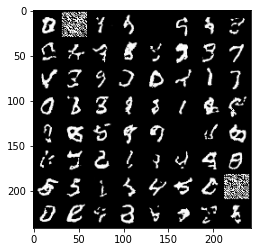

Epoch: [246/500]) Negative Log-Likelihood: -3681.6337890625
Epoch: [247/500]) Batch: [1/75] Negative Log-Likelihood: -3697.717529296875


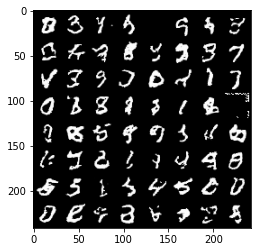

Epoch: [247/500]) Batch: [2/75] Negative Log-Likelihood: -3701.0234375
Epoch: [247/500]) Batch: [3/75] Negative Log-Likelihood: -3708.35986328125
Epoch: [247/500]) Batch: [4/75] Negative Log-Likelihood: -3687.80126953125
Epoch: [247/500]) Batch: [5/75] Negative Log-Likelihood: -3701.6328125
Epoch: [247/500]) Batch: [6/75] Negative Log-Likelihood: -3697.772216796875
Epoch: [247/500]) Batch: [7/75] Negative Log-Likelihood: -3691.19921875
Epoch: [247/500]) Batch: [8/75] Negative Log-Likelihood: -3705.499267578125
Epoch: [247/500]) Batch: [9/75] Negative Log-Likelihood: -3713.762451171875
Epoch: [247/500]) Batch: [10/75] Negative Log-Likelihood: -3704.521240234375
Epoch: [247/500]) Batch: [11/75] Negative Log-Likelihood: -3707.1962890625
Epoch: [247/500]) Batch: [12/75] Negative Log-Likelihood: -3706.881591796875
Epoch: [247/500]) Batch: [13/75] Negative Log-Likelihood: -3702.57861328125
Epoch: [247/500]) Batch: [14/75] Negative Log-Likelihood: -3708.530517578125
Epoch: [247/500]) Batch: [

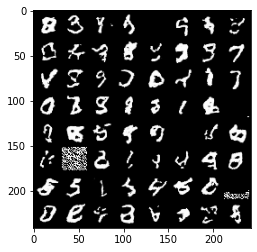

Epoch: [247/500]) Negative Log-Likelihood: -3681.275634765625
Epoch: [248/500]) Batch: [1/75] Negative Log-Likelihood: -3696.459228515625


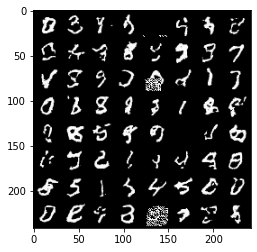

Epoch: [248/500]) Batch: [2/75] Negative Log-Likelihood: -3701.89501953125
Epoch: [248/500]) Batch: [3/75] Negative Log-Likelihood: -3706.7705078125
Epoch: [248/500]) Batch: [4/75] Negative Log-Likelihood: -3692.71044921875
Epoch: [248/500]) Batch: [5/75] Negative Log-Likelihood: -3702.101806640625
Epoch: [248/500]) Batch: [6/75] Negative Log-Likelihood: -3703.934814453125
Epoch: [248/500]) Batch: [7/75] Negative Log-Likelihood: -3694.9990234375
Epoch: [248/500]) Batch: [8/75] Negative Log-Likelihood: -3704.55810546875
Epoch: [248/500]) Batch: [9/75] Negative Log-Likelihood: -3710.4619140625
Epoch: [248/500]) Batch: [10/75] Negative Log-Likelihood: -3711.724853515625
Epoch: [248/500]) Batch: [11/75] Negative Log-Likelihood: -3703.404052734375
Epoch: [248/500]) Batch: [12/75] Negative Log-Likelihood: -3704.5205078125
Epoch: [248/500]) Batch: [13/75] Negative Log-Likelihood: -3702.6484375
Epoch: [248/500]) Batch: [14/75] Negative Log-Likelihood: -3705.2880859375
Epoch: [248/500]) Batch: 

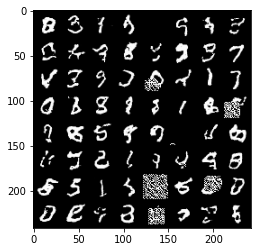

Epoch: [248/500]) Negative Log-Likelihood: -3679.429931640625
Epoch: [249/500]) Batch: [1/75] Negative Log-Likelihood: -3703.65576171875


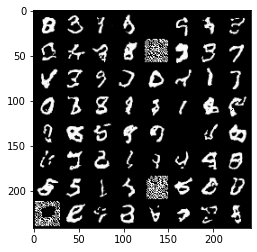

Epoch: [249/500]) Batch: [2/75] Negative Log-Likelihood: -3702.62744140625
Epoch: [249/500]) Batch: [3/75] Negative Log-Likelihood: -3709.626220703125
Epoch: [249/500]) Batch: [4/75] Negative Log-Likelihood: -3691.856201171875
Epoch: [249/500]) Batch: [5/75] Negative Log-Likelihood: -3701.361083984375
Epoch: [249/500]) Batch: [6/75] Negative Log-Likelihood: -3704.635498046875
Epoch: [249/500]) Batch: [7/75] Negative Log-Likelihood: -3694.582763671875
Epoch: [249/500]) Batch: [8/75] Negative Log-Likelihood: -3708.193115234375
Epoch: [249/500]) Batch: [9/75] Negative Log-Likelihood: -3718.41357421875
Epoch: [249/500]) Batch: [10/75] Negative Log-Likelihood: -3716.472412109375
Epoch: [249/500]) Batch: [11/75] Negative Log-Likelihood: -3710.332763671875
Epoch: [249/500]) Batch: [12/75] Negative Log-Likelihood: -3705.18994140625
Epoch: [249/500]) Batch: [13/75] Negative Log-Likelihood: -3704.9619140625
Epoch: [249/500]) Batch: [14/75] Negative Log-Likelihood: -3712.964599609375
Epoch: [249/

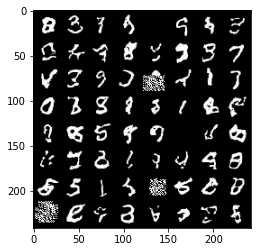

Epoch: [249/500]) Negative Log-Likelihood: -3689.108642578125
Epoch: [250/500]) Batch: [1/75] Negative Log-Likelihood: -3702.177001953125


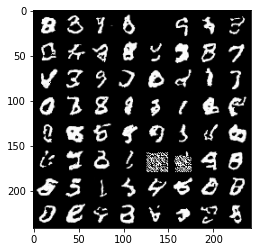

Epoch: [250/500]) Batch: [2/75] Negative Log-Likelihood: -3696.041259765625
Epoch: [250/500]) Batch: [3/75] Negative Log-Likelihood: -3713.818603515625
Epoch: [250/500]) Batch: [4/75] Negative Log-Likelihood: -3696.052490234375
Epoch: [250/500]) Batch: [5/75] Negative Log-Likelihood: -3706.567626953125
Epoch: [250/500]) Batch: [6/75] Negative Log-Likelihood: -3707.030029296875
Epoch: [250/500]) Batch: [7/75] Negative Log-Likelihood: -3698.7255859375
Epoch: [250/500]) Batch: [8/75] Negative Log-Likelihood: -3711.3564453125
Epoch: [250/500]) Batch: [9/75] Negative Log-Likelihood: -3717.60107421875
Epoch: [250/500]) Batch: [10/75] Negative Log-Likelihood: -3711.36279296875
Epoch: [250/500]) Batch: [11/75] Negative Log-Likelihood: -3716.1689453125
Epoch: [250/500]) Batch: [12/75] Negative Log-Likelihood: -3704.015869140625
Epoch: [250/500]) Batch: [13/75] Negative Log-Likelihood: -3699.18994140625
Epoch: [250/500]) Batch: [14/75] Negative Log-Likelihood: -3687.927978515625
Epoch: [250/500]

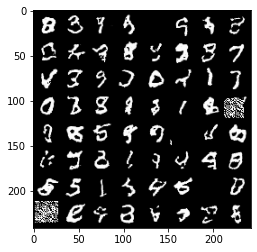

Epoch: [250/500]) Negative Log-Likelihood: -3688.6162109375
Epoch: [251/500]) Batch: [1/75] Negative Log-Likelihood: -3710.169921875


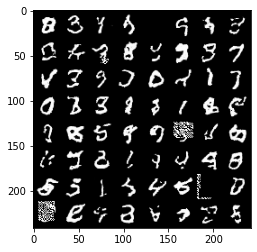

Epoch: [251/500]) Batch: [2/75] Negative Log-Likelihood: -3710.177734375
Epoch: [251/500]) Batch: [3/75] Negative Log-Likelihood: -3715.4716796875
Epoch: [251/500]) Batch: [4/75] Negative Log-Likelihood: -3694.06494140625
Epoch: [251/500]) Batch: [5/75] Negative Log-Likelihood: -3706.4931640625
Epoch: [251/500]) Batch: [6/75] Negative Log-Likelihood: -3698.7255859375
Epoch: [251/500]) Batch: [7/75] Negative Log-Likelihood: -3693.534912109375
Epoch: [251/500]) Batch: [8/75] Negative Log-Likelihood: -3708.943115234375
Epoch: [251/500]) Batch: [9/75] Negative Log-Likelihood: -3715.773681640625
Epoch: [251/500]) Batch: [10/75] Negative Log-Likelihood: -3709.89794921875
Epoch: [251/500]) Batch: [11/75] Negative Log-Likelihood: -3709.9658203125
Epoch: [251/500]) Batch: [12/75] Negative Log-Likelihood: -3708.342529296875
Epoch: [251/500]) Batch: [13/75] Negative Log-Likelihood: -3705.121826171875
Epoch: [251/500]) Batch: [14/75] Negative Log-Likelihood: -3710.72607421875
Epoch: [251/500]) Bat

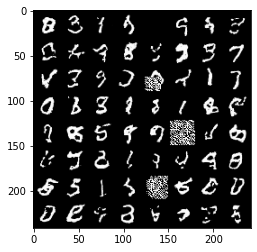

Epoch: [251/500]) Negative Log-Likelihood: -3686.11962890625
Epoch: [252/500]) Batch: [1/75] Negative Log-Likelihood: -3705.90185546875


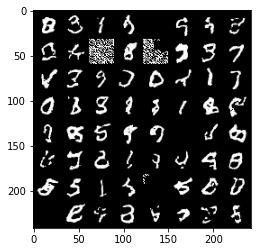

Epoch: [252/500]) Batch: [2/75] Negative Log-Likelihood: -3710.4716796875
Epoch: [252/500]) Batch: [3/75] Negative Log-Likelihood: -3714.94677734375
Epoch: [252/500]) Batch: [4/75] Negative Log-Likelihood: -3701.23876953125
Epoch: [252/500]) Batch: [5/75] Negative Log-Likelihood: -3711.698974609375
Epoch: [252/500]) Batch: [6/75] Negative Log-Likelihood: -3707.1005859375
Epoch: [252/500]) Batch: [7/75] Negative Log-Likelihood: -3698.94921875
Epoch: [252/500]) Batch: [8/75] Negative Log-Likelihood: -3710.89111328125
Epoch: [252/500]) Batch: [9/75] Negative Log-Likelihood: -3716.05810546875
Epoch: [252/500]) Batch: [10/75] Negative Log-Likelihood: -3715.199951171875
Epoch: [252/500]) Batch: [11/75] Negative Log-Likelihood: -3715.732666015625
Epoch: [252/500]) Batch: [12/75] Negative Log-Likelihood: -3713.994384765625
Epoch: [252/500]) Batch: [13/75] Negative Log-Likelihood: -3708.724365234375
Epoch: [252/500]) Batch: [14/75] Negative Log-Likelihood: -3712.834716796875
Epoch: [252/500]) B

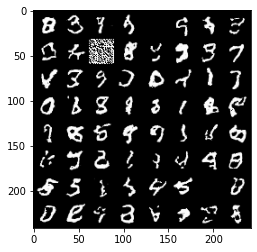

Epoch: [252/500]) Negative Log-Likelihood: -3691.598388671875
Epoch: [253/500]) Batch: [1/75] Negative Log-Likelihood: -3713.621826171875


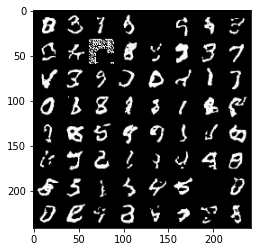

Epoch: [253/500]) Batch: [2/75] Negative Log-Likelihood: -3706.2373046875
Epoch: [253/500]) Batch: [3/75] Negative Log-Likelihood: -3708.67919921875
Epoch: [253/500]) Batch: [4/75] Negative Log-Likelihood: -3696.5205078125
Epoch: [253/500]) Batch: [5/75] Negative Log-Likelihood: -3704.576416015625
Epoch: [253/500]) Batch: [6/75] Negative Log-Likelihood: -3709.225341796875
Epoch: [253/500]) Batch: [7/75] Negative Log-Likelihood: -3698.099853515625
Epoch: [253/500]) Batch: [8/75] Negative Log-Likelihood: -3709.177978515625
Epoch: [253/500]) Batch: [9/75] Negative Log-Likelihood: -3719.68115234375
Epoch: [253/500]) Batch: [10/75] Negative Log-Likelihood: -3711.510498046875
Epoch: [253/500]) Batch: [11/75] Negative Log-Likelihood: -3713.98486328125
Epoch: [253/500]) Batch: [12/75] Negative Log-Likelihood: -3707.1591796875
Epoch: [253/500]) Batch: [13/75] Negative Log-Likelihood: -3695.0693359375
Epoch: [253/500]) Batch: [14/75] Negative Log-Likelihood: -3704.40673828125
Epoch: [253/500]) B

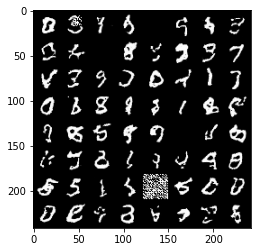

Epoch: [253/500]) Negative Log-Likelihood: -3671.15234375
Epoch: [254/500]) Batch: [1/75] Negative Log-Likelihood: -3700.41064453125


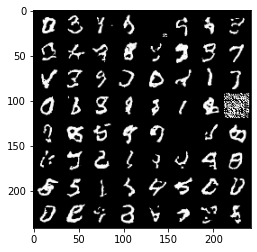

Epoch: [254/500]) Batch: [2/75] Negative Log-Likelihood: -3702.936279296875
Epoch: [254/500]) Batch: [3/75] Negative Log-Likelihood: -3706.382080078125
Epoch: [254/500]) Batch: [4/75] Negative Log-Likelihood: -3695.2666015625
Epoch: [254/500]) Batch: [5/75] Negative Log-Likelihood: -3704.099609375
Epoch: [254/500]) Batch: [6/75] Negative Log-Likelihood: -3702.83056640625
Epoch: [254/500]) Batch: [7/75] Negative Log-Likelihood: -3698.0546875
Epoch: [254/500]) Batch: [8/75] Negative Log-Likelihood: -3708.1552734375
Epoch: [254/500]) Batch: [9/75] Negative Log-Likelihood: -3713.7783203125
Epoch: [254/500]) Batch: [10/75] Negative Log-Likelihood: -3705.44091796875
Epoch: [254/500]) Batch: [11/75] Negative Log-Likelihood: -3708.076171875
Epoch: [254/500]) Batch: [12/75] Negative Log-Likelihood: -3707.280029296875
Epoch: [254/500]) Batch: [13/75] Negative Log-Likelihood: -3701.905517578125
Epoch: [254/500]) Batch: [14/75] Negative Log-Likelihood: -3708.1015625
Epoch: [254/500]) Batch: [15/75

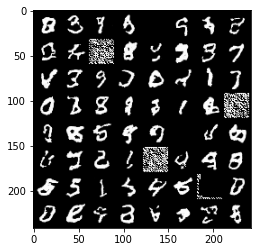

Epoch: [254/500]) Negative Log-Likelihood: -3684.233642578125
Epoch: [255/500]) Batch: [1/75] Negative Log-Likelihood: -3702.6630859375


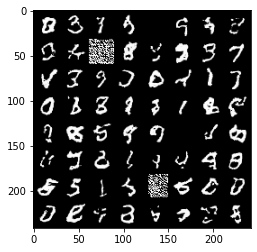

Epoch: [255/500]) Batch: [2/75] Negative Log-Likelihood: -3703.244873046875
Epoch: [255/500]) Batch: [3/75] Negative Log-Likelihood: -3709.46484375
Epoch: [255/500]) Batch: [4/75] Negative Log-Likelihood: -3695.704345703125
Epoch: [255/500]) Batch: [5/75] Negative Log-Likelihood: -3707.171142578125
Epoch: [255/500]) Batch: [6/75] Negative Log-Likelihood: -3711.700439453125
Epoch: [255/500]) Batch: [7/75] Negative Log-Likelihood: -3697.51513671875
Epoch: [255/500]) Batch: [8/75] Negative Log-Likelihood: -3712.376220703125
Epoch: [255/500]) Batch: [9/75] Negative Log-Likelihood: -3715.2861328125
Epoch: [255/500]) Batch: [10/75] Negative Log-Likelihood: -3707.7451171875
Epoch: [255/500]) Batch: [11/75] Negative Log-Likelihood: -3714.197509765625
Epoch: [255/500]) Batch: [12/75] Negative Log-Likelihood: -3707.246826171875
Epoch: [255/500]) Batch: [13/75] Negative Log-Likelihood: -3706.068603515625
Epoch: [255/500]) Batch: [14/75] Negative Log-Likelihood: -3711.96875
Epoch: [255/500]) Batch

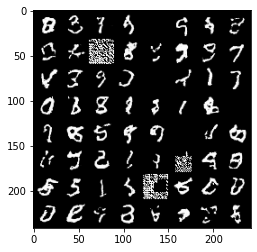

Epoch: [255/500]) Negative Log-Likelihood: -3683.57861328125
Epoch: [256/500]) Batch: [1/75] Negative Log-Likelihood: -3696.742431640625


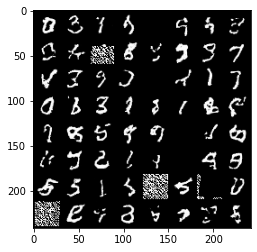

Epoch: [256/500]) Batch: [2/75] Negative Log-Likelihood: -3705.51123046875
Epoch: [256/500]) Batch: [3/75] Negative Log-Likelihood: -3710.03369140625
Epoch: [256/500]) Batch: [4/75] Negative Log-Likelihood: -3696.3125
Epoch: [256/500]) Batch: [5/75] Negative Log-Likelihood: -3705.365234375
Epoch: [256/500]) Batch: [6/75] Negative Log-Likelihood: -3705.9931640625
Epoch: [256/500]) Batch: [7/75] Negative Log-Likelihood: -3698.703125
Epoch: [256/500]) Batch: [8/75] Negative Log-Likelihood: -3708.779296875
Epoch: [256/500]) Batch: [9/75] Negative Log-Likelihood: -3715.215576171875
Epoch: [256/500]) Batch: [10/75] Negative Log-Likelihood: -3713.494873046875
Epoch: [256/500]) Batch: [11/75] Negative Log-Likelihood: -3710.3310546875
Epoch: [256/500]) Batch: [12/75] Negative Log-Likelihood: -3715.9443359375
Epoch: [256/500]) Batch: [13/75] Negative Log-Likelihood: -3695.12548828125
Epoch: [256/500]) Batch: [14/75] Negative Log-Likelihood: -3686.2861328125
Epoch: [256/500]) Batch: [15/75] Negat

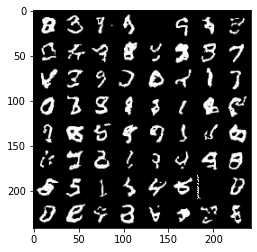

Epoch: [256/500]) Negative Log-Likelihood: -3677.8212890625
Epoch: [257/500]) Batch: [1/75] Negative Log-Likelihood: -3703.614990234375


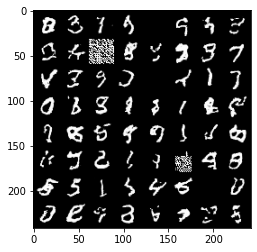

Epoch: [257/500]) Batch: [2/75] Negative Log-Likelihood: -3706.73779296875
Epoch: [257/500]) Batch: [3/75] Negative Log-Likelihood: -3712.61279296875
Epoch: [257/500]) Batch: [4/75] Negative Log-Likelihood: -3696.619873046875
Epoch: [257/500]) Batch: [5/75] Negative Log-Likelihood: -3708.404052734375
Epoch: [257/500]) Batch: [6/75] Negative Log-Likelihood: -3711.409912109375
Epoch: [257/500]) Batch: [7/75] Negative Log-Likelihood: -3700.3076171875
Epoch: [257/500]) Batch: [8/75] Negative Log-Likelihood: -3710.03173828125
Epoch: [257/500]) Batch: [9/75] Negative Log-Likelihood: -3720.4287109375
Epoch: [257/500]) Batch: [10/75] Negative Log-Likelihood: -3711.343017578125
Epoch: [257/500]) Batch: [11/75] Negative Log-Likelihood: -3707.682373046875
Epoch: [257/500]) Batch: [12/75] Negative Log-Likelihood: -3710.41796875
Epoch: [257/500]) Batch: [13/75] Negative Log-Likelihood: -3704.104248046875
Epoch: [257/500]) Batch: [14/75] Negative Log-Likelihood: -3706.412353515625
Epoch: [257/500]) 

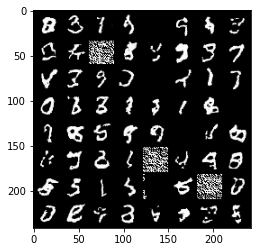

Epoch: [257/500]) Negative Log-Likelihood: -3677.9423828125
Epoch: [258/500]) Batch: [1/75] Negative Log-Likelihood: -3692.4248046875


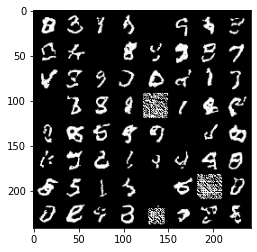

Epoch: [258/500]) Batch: [2/75] Negative Log-Likelihood: -3685.735595703125
Epoch: [258/500]) Batch: [3/75] Negative Log-Likelihood: -3702.984619140625
Epoch: [258/500]) Batch: [4/75] Negative Log-Likelihood: -3694.838134765625
Epoch: [258/500]) Batch: [5/75] Negative Log-Likelihood: -3701.217041015625
Epoch: [258/500]) Batch: [6/75] Negative Log-Likelihood: -3694.349365234375
Epoch: [258/500]) Batch: [7/75] Negative Log-Likelihood: -3691.048095703125
Epoch: [258/500]) Batch: [8/75] Negative Log-Likelihood: -3710.22314453125
Epoch: [258/500]) Batch: [9/75] Negative Log-Likelihood: -3715.367431640625
Epoch: [258/500]) Batch: [10/75] Negative Log-Likelihood: -3709.03515625
Epoch: [258/500]) Batch: [11/75] Negative Log-Likelihood: -3710.76806640625
Epoch: [258/500]) Batch: [12/75] Negative Log-Likelihood: -3712.8837890625
Epoch: [258/500]) Batch: [13/75] Negative Log-Likelihood: -3706.81982421875
Epoch: [258/500]) Batch: [14/75] Negative Log-Likelihood: -3709.072509765625
Epoch: [258/500]

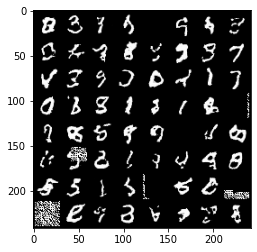

Epoch: [258/500]) Negative Log-Likelihood: -3685.7158203125
Epoch: [259/500]) Batch: [1/75] Negative Log-Likelihood: -3704.375


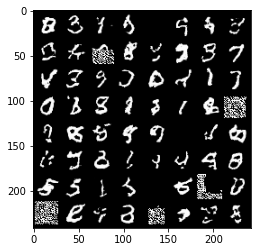

Epoch: [259/500]) Batch: [2/75] Negative Log-Likelihood: -3706.720458984375
Epoch: [259/500]) Batch: [3/75] Negative Log-Likelihood: -3714.8642578125
Epoch: [259/500]) Batch: [4/75] Negative Log-Likelihood: -3690.381103515625
Epoch: [259/500]) Batch: [5/75] Negative Log-Likelihood: -3698.3720703125
Epoch: [259/500]) Batch: [6/75] Negative Log-Likelihood: -3705.753662109375
Epoch: [259/500]) Batch: [7/75] Negative Log-Likelihood: -3696.46337890625
Epoch: [259/500]) Batch: [8/75] Negative Log-Likelihood: -3709.54736328125
Epoch: [259/500]) Batch: [9/75] Negative Log-Likelihood: -3712.75146484375
Epoch: [259/500]) Batch: [10/75] Negative Log-Likelihood: -3702.015625
Epoch: [259/500]) Batch: [11/75] Negative Log-Likelihood: -3709.825439453125
Epoch: [259/500]) Batch: [12/75] Negative Log-Likelihood: -3707.748779296875
Epoch: [259/500]) Batch: [13/75] Negative Log-Likelihood: -3704.25732421875
Epoch: [259/500]) Batch: [14/75] Negative Log-Likelihood: -3709.2353515625
Epoch: [259/500]) Batch

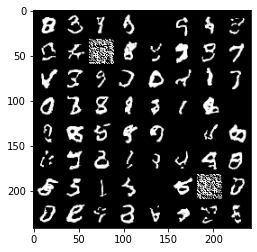

Epoch: [259/500]) Negative Log-Likelihood: -3683.938720703125
Epoch: [260/500]) Batch: [1/75] Negative Log-Likelihood: -3706.46240234375


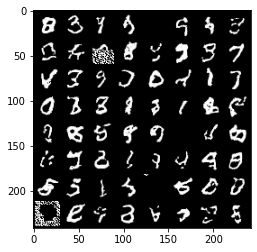

Epoch: [260/500]) Batch: [2/75] Negative Log-Likelihood: -3709.6396484375
Epoch: [260/500]) Batch: [3/75] Negative Log-Likelihood: -3714.287841796875
Epoch: [260/500]) Batch: [4/75] Negative Log-Likelihood: -3699.6455078125
Epoch: [260/500]) Batch: [5/75] Negative Log-Likelihood: -3712.35302734375
Epoch: [260/500]) Batch: [6/75] Negative Log-Likelihood: -3704.841064453125
Epoch: [260/500]) Batch: [7/75] Negative Log-Likelihood: -3690.31689453125
Epoch: [260/500]) Batch: [8/75] Negative Log-Likelihood: -3709.95263671875
Epoch: [260/500]) Batch: [9/75] Negative Log-Likelihood: -3712.078125
Epoch: [260/500]) Batch: [10/75] Negative Log-Likelihood: -3709.15673828125
Epoch: [260/500]) Batch: [11/75] Negative Log-Likelihood: -3714.65966796875
Epoch: [260/500]) Batch: [12/75] Negative Log-Likelihood: -3707.967041015625
Epoch: [260/500]) Batch: [13/75] Negative Log-Likelihood: -3704.4091796875
Epoch: [260/500]) Batch: [14/75] Negative Log-Likelihood: -3705.23046875
Epoch: [260/500]) Batch: [15

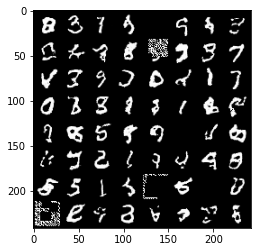

Epoch: [260/500]) Negative Log-Likelihood: -3691.7099609375
Epoch: [261/500]) Batch: [1/75] Negative Log-Likelihood: -3711.177978515625


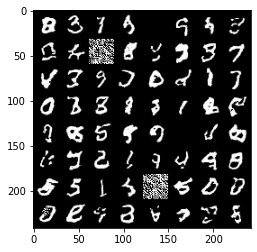

Epoch: [261/500]) Batch: [2/75] Negative Log-Likelihood: -3709.684814453125
Epoch: [261/500]) Batch: [3/75] Negative Log-Likelihood: -3718.029541015625
Epoch: [261/500]) Batch: [4/75] Negative Log-Likelihood: -3703.251708984375
Epoch: [261/500]) Batch: [5/75] Negative Log-Likelihood: -3710.38623046875
Epoch: [261/500]) Batch: [6/75] Negative Log-Likelihood: -3712.391845703125
Epoch: [261/500]) Batch: [7/75] Negative Log-Likelihood: -3704.604248046875
Epoch: [261/500]) Batch: [8/75] Negative Log-Likelihood: -3714.333740234375
Epoch: [261/500]) Batch: [9/75] Negative Log-Likelihood: -3722.683349609375
Epoch: [261/500]) Batch: [10/75] Negative Log-Likelihood: -3717.249267578125
Epoch: [261/500]) Batch: [11/75] Negative Log-Likelihood: -3719.46484375
Epoch: [261/500]) Batch: [12/75] Negative Log-Likelihood: -3715.872802734375
Epoch: [261/500]) Batch: [13/75] Negative Log-Likelihood: -3712.83544921875
Epoch: [261/500]) Batch: [14/75] Negative Log-Likelihood: -3717.018310546875
Epoch: [261/5

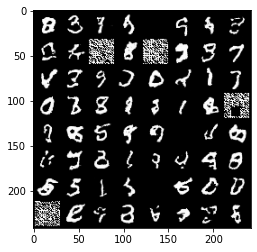

Epoch: [261/500]) Negative Log-Likelihood: -3687.089599609375
Epoch: [262/500]) Batch: [1/75] Negative Log-Likelihood: -3706.862060546875


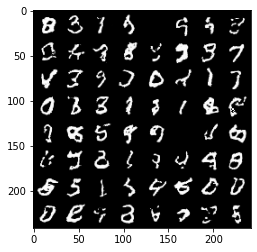

Epoch: [262/500]) Batch: [2/75] Negative Log-Likelihood: -3708.89306640625
Epoch: [262/500]) Batch: [3/75] Negative Log-Likelihood: -3712.69677734375
Epoch: [262/500]) Batch: [4/75] Negative Log-Likelihood: -3699.384521484375
Epoch: [262/500]) Batch: [5/75] Negative Log-Likelihood: -3708.31591796875
Epoch: [262/500]) Batch: [6/75] Negative Log-Likelihood: -3707.799560546875
Epoch: [262/500]) Batch: [7/75] Negative Log-Likelihood: -3702.9248046875
Epoch: [262/500]) Batch: [8/75] Negative Log-Likelihood: -3712.0302734375
Epoch: [262/500]) Batch: [9/75] Negative Log-Likelihood: -3722.86376953125
Epoch: [262/500]) Batch: [10/75] Negative Log-Likelihood: -3713.7392578125
Epoch: [262/500]) Batch: [11/75] Negative Log-Likelihood: -3714.460205078125
Epoch: [262/500]) Batch: [12/75] Negative Log-Likelihood: -3709.6611328125
Epoch: [262/500]) Batch: [13/75] Negative Log-Likelihood: -3697.476806640625
Epoch: [262/500]) Batch: [14/75] Negative Log-Likelihood: -3710.885009765625
Epoch: [262/500]) B

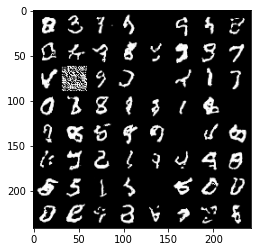

Epoch: [262/500]) Negative Log-Likelihood: -3689.7236328125
Epoch: [263/500]) Batch: [1/75] Negative Log-Likelihood: -3708.77294921875


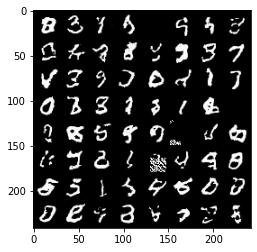

Epoch: [263/500]) Batch: [2/75] Negative Log-Likelihood: -3711.155517578125
Epoch: [263/500]) Batch: [3/75] Negative Log-Likelihood: -3716.405029296875
Epoch: [263/500]) Batch: [4/75] Negative Log-Likelihood: -3698.469970703125
Epoch: [263/500]) Batch: [5/75] Negative Log-Likelihood: -3703.527099609375
Epoch: [263/500]) Batch: [6/75] Negative Log-Likelihood: -3697.6962890625
Epoch: [263/500]) Batch: [7/75] Negative Log-Likelihood: -3689.82421875
Epoch: [263/500]) Batch: [8/75] Negative Log-Likelihood: -3706.58203125
Epoch: [263/500]) Batch: [9/75] Negative Log-Likelihood: -3716.278564453125
Epoch: [263/500]) Batch: [10/75] Negative Log-Likelihood: -3711.6474609375
Epoch: [263/500]) Batch: [11/75] Negative Log-Likelihood: -3715.342529296875
Epoch: [263/500]) Batch: [12/75] Negative Log-Likelihood: -3708.981201171875
Epoch: [263/500]) Batch: [13/75] Negative Log-Likelihood: -3707.23046875
Epoch: [263/500]) Batch: [14/75] Negative Log-Likelihood: -3713.367431640625
Epoch: [263/500]) Batch

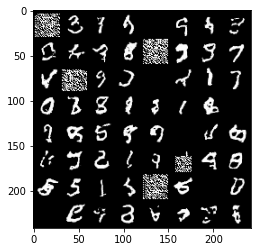

Epoch: [263/500]) Negative Log-Likelihood: -3684.50341796875
Epoch: [264/500]) Batch: [1/75] Negative Log-Likelihood: -3702.075927734375


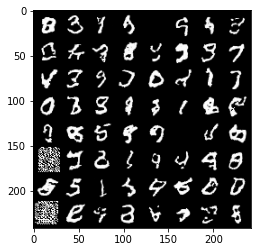

Epoch: [264/500]) Batch: [2/75] Negative Log-Likelihood: -3707.25
Epoch: [264/500]) Batch: [3/75] Negative Log-Likelihood: -3715.264404296875
Epoch: [264/500]) Batch: [4/75] Negative Log-Likelihood: -3701.335205078125
Epoch: [264/500]) Batch: [5/75] Negative Log-Likelihood: -3709.779541015625
Epoch: [264/500]) Batch: [6/75] Negative Log-Likelihood: -3704.6962890625
Epoch: [264/500]) Batch: [7/75] Negative Log-Likelihood: -3704.192138671875
Epoch: [264/500]) Batch: [8/75] Negative Log-Likelihood: -3713.3154296875
Epoch: [264/500]) Batch: [9/75] Negative Log-Likelihood: -3723.71142578125
Epoch: [264/500]) Batch: [10/75] Negative Log-Likelihood: -3715.67431640625
Epoch: [264/500]) Batch: [11/75] Negative Log-Likelihood: -3714.883544921875
Epoch: [264/500]) Batch: [12/75] Negative Log-Likelihood: -3707.713623046875
Epoch: [264/500]) Batch: [13/75] Negative Log-Likelihood: -3694.029052734375
Epoch: [264/500]) Batch: [14/75] Negative Log-Likelihood: -3702.6142578125
Epoch: [264/500]) Batch: 

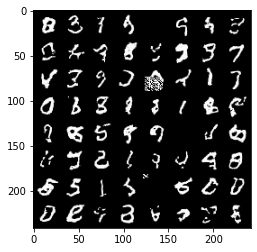

Epoch: [264/500]) Negative Log-Likelihood: -3689.233642578125
Epoch: [265/500]) Batch: [1/75] Negative Log-Likelihood: -3706.204345703125


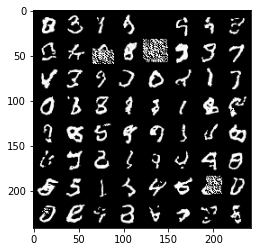

Epoch: [265/500]) Batch: [2/75] Negative Log-Likelihood: -3708.122314453125
Epoch: [265/500]) Batch: [3/75] Negative Log-Likelihood: -3713.530029296875
Epoch: [265/500]) Batch: [4/75] Negative Log-Likelihood: -3696.94873046875
Epoch: [265/500]) Batch: [5/75] Negative Log-Likelihood: -3711.9873046875
Epoch: [265/500]) Batch: [6/75] Negative Log-Likelihood: -3707.820556640625
Epoch: [265/500]) Batch: [7/75] Negative Log-Likelihood: -3702.06494140625
Epoch: [265/500]) Batch: [8/75] Negative Log-Likelihood: -3715.0205078125
Epoch: [265/500]) Batch: [9/75] Negative Log-Likelihood: -3722.74658203125
Epoch: [265/500]) Batch: [10/75] Negative Log-Likelihood: -3717.809326171875
Epoch: [265/500]) Batch: [11/75] Negative Log-Likelihood: -3721.853759765625
Epoch: [265/500]) Batch: [12/75] Negative Log-Likelihood: -3712.00390625
Epoch: [265/500]) Batch: [13/75] Negative Log-Likelihood: -3710.49609375
Epoch: [265/500]) Batch: [14/75] Negative Log-Likelihood: -3716.852294921875
Epoch: [265/500]) Batc

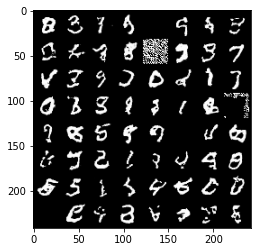

Epoch: [265/500]) Negative Log-Likelihood: -3688.341064453125
Epoch: [266/500]) Batch: [1/75] Negative Log-Likelihood: -3701.224853515625


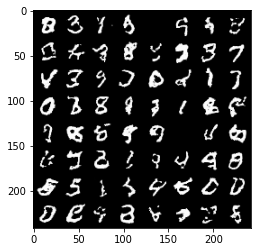

Epoch: [266/500]) Batch: [2/75] Negative Log-Likelihood: -3700.73779296875
Epoch: [266/500]) Batch: [3/75] Negative Log-Likelihood: -3701.80126953125
Epoch: [266/500]) Batch: [4/75] Negative Log-Likelihood: -3675.67919921875
Epoch: [266/500]) Batch: [5/75] Negative Log-Likelihood: -3696.0537109375
Epoch: [266/500]) Batch: [6/75] Negative Log-Likelihood: -3694.25244140625
Epoch: [266/500]) Batch: [7/75] Negative Log-Likelihood: -3688.058349609375
Epoch: [266/500]) Batch: [8/75] Negative Log-Likelihood: -3699.731201171875
Epoch: [266/500]) Batch: [9/75] Negative Log-Likelihood: -3706.787841796875
Epoch: [266/500]) Batch: [10/75] Negative Log-Likelihood: -3696.583740234375
Epoch: [266/500]) Batch: [11/75] Negative Log-Likelihood: -3695.0107421875
Epoch: [266/500]) Batch: [12/75] Negative Log-Likelihood: -3697.085205078125
Epoch: [266/500]) Batch: [13/75] Negative Log-Likelihood: -3696.939208984375
Epoch: [266/500]) Batch: [14/75] Negative Log-Likelihood: -3700.786865234375
Epoch: [266/500

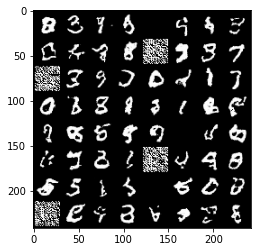

Epoch: [266/500]) Negative Log-Likelihood: -3675.083740234375
Epoch: [267/500]) Batch: [1/75] Negative Log-Likelihood: -3702.71142578125


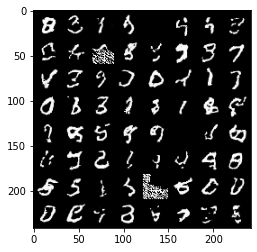

Epoch: [267/500]) Batch: [2/75] Negative Log-Likelihood: -3697.828369140625
Epoch: [267/500]) Batch: [3/75] Negative Log-Likelihood: -3706.901123046875
Epoch: [267/500]) Batch: [4/75] Negative Log-Likelihood: -3696.33056640625
Epoch: [267/500]) Batch: [5/75] Negative Log-Likelihood: -3704.3935546875
Epoch: [267/500]) Batch: [6/75] Negative Log-Likelihood: -3709.5107421875
Epoch: [267/500]) Batch: [7/75] Negative Log-Likelihood: -3695.421142578125
Epoch: [267/500]) Batch: [8/75] Negative Log-Likelihood: -3697.092529296875
Epoch: [267/500]) Batch: [9/75] Negative Log-Likelihood: -3712.7724609375
Epoch: [267/500]) Batch: [10/75] Negative Log-Likelihood: -3712.56298828125
Epoch: [267/500]) Batch: [11/75] Negative Log-Likelihood: -3713.33935546875
Epoch: [267/500]) Batch: [12/75] Negative Log-Likelihood: -3708.53369140625
Epoch: [267/500]) Batch: [13/75] Negative Log-Likelihood: -3707.068115234375
Epoch: [267/500]) Batch: [14/75] Negative Log-Likelihood: -3707.359619140625
Epoch: [267/500])

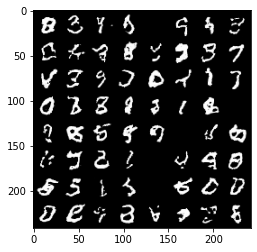

Epoch: [267/500]) Negative Log-Likelihood: -3683.45361328125
Epoch: [268/500]) Batch: [1/75] Negative Log-Likelihood: -3706.080810546875


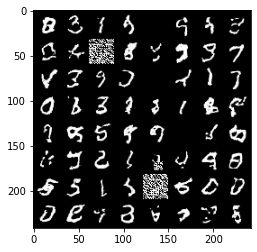

Epoch: [268/500]) Batch: [2/75] Negative Log-Likelihood: -3709.0966796875
Epoch: [268/500]) Batch: [3/75] Negative Log-Likelihood: -3716.26171875
Epoch: [268/500]) Batch: [4/75] Negative Log-Likelihood: -3700.04833984375
Epoch: [268/500]) Batch: [5/75] Negative Log-Likelihood: -3711.512939453125
Epoch: [268/500]) Batch: [6/75] Negative Log-Likelihood: -3713.830810546875
Epoch: [268/500]) Batch: [7/75] Negative Log-Likelihood: -3703.8984375
Epoch: [268/500]) Batch: [8/75] Negative Log-Likelihood: -3716.825439453125
Epoch: [268/500]) Batch: [9/75] Negative Log-Likelihood: -3720.689208984375
Epoch: [268/500]) Batch: [10/75] Negative Log-Likelihood: -3716.6318359375
Epoch: [268/500]) Batch: [11/75] Negative Log-Likelihood: -3710.36767578125
Epoch: [268/500]) Batch: [12/75] Negative Log-Likelihood: -3706.118896484375
Epoch: [268/500]) Batch: [13/75] Negative Log-Likelihood: -3705.657958984375
Epoch: [268/500]) Batch: [14/75] Negative Log-Likelihood: -3709.755615234375
Epoch: [268/500]) Batc

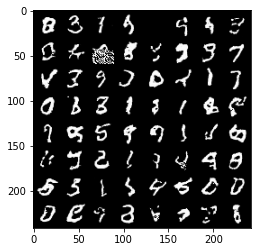

Epoch: [268/500]) Negative Log-Likelihood: -3685.56201171875
Epoch: [269/500]) Batch: [1/75] Negative Log-Likelihood: -3708.618896484375


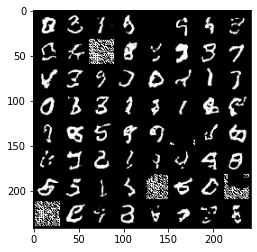

Epoch: [269/500]) Batch: [2/75] Negative Log-Likelihood: -3711.4443359375
Epoch: [269/500]) Batch: [3/75] Negative Log-Likelihood: -3714.671875
Epoch: [269/500]) Batch: [4/75] Negative Log-Likelihood: -3701.666748046875
Epoch: [269/500]) Batch: [5/75] Negative Log-Likelihood: -3712.6630859375
Epoch: [269/500]) Batch: [6/75] Negative Log-Likelihood: -3711.132080078125
Epoch: [269/500]) Batch: [7/75] Negative Log-Likelihood: -3705.12841796875
Epoch: [269/500]) Batch: [8/75] Negative Log-Likelihood: -3715.1875
Epoch: [269/500]) Batch: [9/75] Negative Log-Likelihood: -3721.43310546875
Epoch: [269/500]) Batch: [10/75] Negative Log-Likelihood: -3718.756103515625
Epoch: [269/500]) Batch: [11/75] Negative Log-Likelihood: -3713.704345703125
Epoch: [269/500]) Batch: [12/75] Negative Log-Likelihood: -3704.724853515625
Epoch: [269/500]) Batch: [13/75] Negative Log-Likelihood: -3701.9501953125
Epoch: [269/500]) Batch: [14/75] Negative Log-Likelihood: -3713.66064453125
Epoch: [269/500]) Batch: [15/7

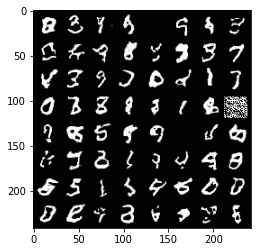

Epoch: [269/500]) Negative Log-Likelihood: -3666.204345703125
Epoch: [270/500]) Batch: [1/75] Negative Log-Likelihood: -3697.8330078125


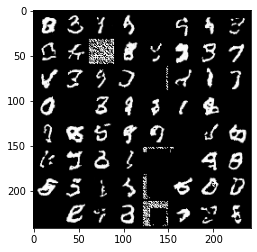

Epoch: [270/500]) Batch: [2/75] Negative Log-Likelihood: -3686.407470703125
Epoch: [270/500]) Batch: [3/75] Negative Log-Likelihood: -3695.8916015625
Epoch: [270/500]) Batch: [4/75] Negative Log-Likelihood: -3691.588623046875
Epoch: [270/500]) Batch: [5/75] Negative Log-Likelihood: -3700.83935546875
Epoch: [270/500]) Batch: [6/75] Negative Log-Likelihood: -3698.447509765625
Epoch: [270/500]) Batch: [7/75] Negative Log-Likelihood: -3692.11083984375
Epoch: [270/500]) Batch: [8/75] Negative Log-Likelihood: -3705.861083984375
Epoch: [270/500]) Batch: [9/75] Negative Log-Likelihood: -3712.506103515625
Epoch: [270/500]) Batch: [10/75] Negative Log-Likelihood: -3707.387451171875
Epoch: [270/500]) Batch: [11/75] Negative Log-Likelihood: -3714.476806640625
Epoch: [270/500]) Batch: [12/75] Negative Log-Likelihood: -3704.700439453125
Epoch: [270/500]) Batch: [13/75] Negative Log-Likelihood: -3688.771728515625
Epoch: [270/500]) Batch: [14/75] Negative Log-Likelihood: -3698.074951171875
Epoch: [270

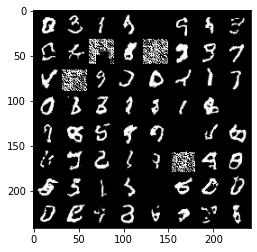

Epoch: [270/500]) Negative Log-Likelihood: -3683.5498046875
Epoch: [271/500]) Batch: [1/75] Negative Log-Likelihood: -3701.63720703125


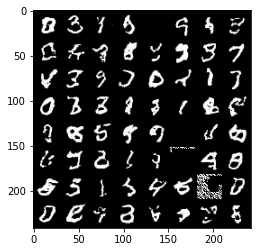

Epoch: [271/500]) Batch: [2/75] Negative Log-Likelihood: -3704.6982421875
Epoch: [271/500]) Batch: [3/75] Negative Log-Likelihood: -3711.95556640625
Epoch: [271/500]) Batch: [4/75] Negative Log-Likelihood: -3693.767333984375
Epoch: [271/500]) Batch: [5/75] Negative Log-Likelihood: -3704.27490234375
Epoch: [271/500]) Batch: [6/75] Negative Log-Likelihood: -3707.216796875
Epoch: [271/500]) Batch: [7/75] Negative Log-Likelihood: -3694.577392578125
Epoch: [271/500]) Batch: [8/75] Negative Log-Likelihood: -3704.910888671875
Epoch: [271/500]) Batch: [9/75] Negative Log-Likelihood: -3710.320556640625
Epoch: [271/500]) Batch: [10/75] Negative Log-Likelihood: -3707.476806640625
Epoch: [271/500]) Batch: [11/75] Negative Log-Likelihood: -3711.1962890625
Epoch: [271/500]) Batch: [12/75] Negative Log-Likelihood: -3708.0380859375
Epoch: [271/500]) Batch: [13/75] Negative Log-Likelihood: -3706.231201171875
Epoch: [271/500]) Batch: [14/75] Negative Log-Likelihood: -3710.595458984375
Epoch: [271/500]) 

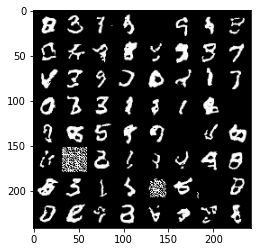

Epoch: [271/500]) Negative Log-Likelihood: -3681.514892578125
Epoch: [272/500]) Batch: [1/75] Negative Log-Likelihood: -3706.0859375


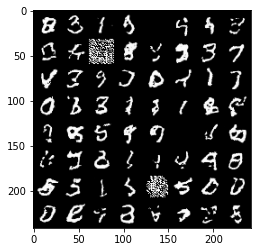

Epoch: [272/500]) Batch: [2/75] Negative Log-Likelihood: -3704.109375
Epoch: [272/500]) Batch: [3/75] Negative Log-Likelihood: -3712.76220703125
Epoch: [272/500]) Batch: [4/75] Negative Log-Likelihood: -3693.79052734375
Epoch: [272/500]) Batch: [5/75] Negative Log-Likelihood: -3699.47998046875
Epoch: [272/500]) Batch: [6/75] Negative Log-Likelihood: -3700.8173828125
Epoch: [272/500]) Batch: [7/75] Negative Log-Likelihood: -3697.129638671875
Epoch: [272/500]) Batch: [8/75] Negative Log-Likelihood: -3705.769287109375
Epoch: [272/500]) Batch: [9/75] Negative Log-Likelihood: -3716.290283203125
Epoch: [272/500]) Batch: [10/75] Negative Log-Likelihood: -3712.494873046875
Epoch: [272/500]) Batch: [11/75] Negative Log-Likelihood: -3711.6689453125
Epoch: [272/500]) Batch: [12/75] Negative Log-Likelihood: -3708.057373046875
Epoch: [272/500]) Batch: [13/75] Negative Log-Likelihood: -3704.265625
Epoch: [272/500]) Batch: [14/75] Negative Log-Likelihood: -3708.036376953125
Epoch: [272/500]) Batch: [

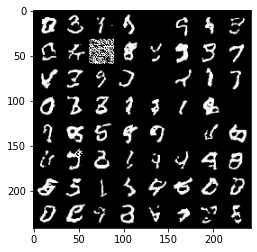

Epoch: [272/500]) Negative Log-Likelihood: -3687.490478515625
Epoch: [273/500]) Batch: [1/75] Negative Log-Likelihood: -3708.864501953125


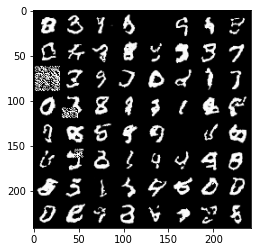

Epoch: [273/500]) Batch: [2/75] Negative Log-Likelihood: -3704.67578125
Epoch: [273/500]) Batch: [3/75] Negative Log-Likelihood: -3706.6943359375
Epoch: [273/500]) Batch: [4/75] Negative Log-Likelihood: -3687.936767578125
Epoch: [273/500]) Batch: [5/75] Negative Log-Likelihood: -3701.537353515625
Epoch: [273/500]) Batch: [6/75] Negative Log-Likelihood: -3701.468994140625
Epoch: [273/500]) Batch: [7/75] Negative Log-Likelihood: -3699.49169921875
Epoch: [273/500]) Batch: [8/75] Negative Log-Likelihood: -3705.498779296875
Epoch: [273/500]) Batch: [9/75] Negative Log-Likelihood: -3715.015625
Epoch: [273/500]) Batch: [10/75] Negative Log-Likelihood: -3713.40185546875
Epoch: [273/500]) Batch: [11/75] Negative Log-Likelihood: -3709.27490234375
Epoch: [273/500]) Batch: [12/75] Negative Log-Likelihood: -3710.856201171875
Epoch: [273/500]) Batch: [13/75] Negative Log-Likelihood: -3707.218017578125
Epoch: [273/500]) Batch: [14/75] Negative Log-Likelihood: -3709.1123046875
Epoch: [273/500]) Batch:

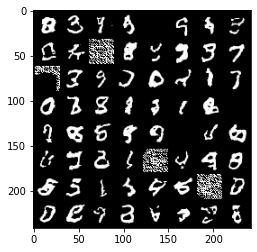

Epoch: [273/500]) Negative Log-Likelihood: -3686.961181640625
Epoch: [274/500]) Batch: [1/75] Negative Log-Likelihood: -3709.2314453125


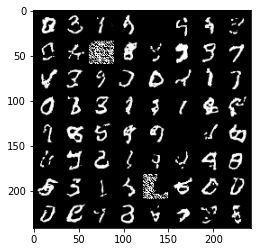

Epoch: [274/500]) Batch: [2/75] Negative Log-Likelihood: -3705.80908203125
Epoch: [274/500]) Batch: [3/75] Negative Log-Likelihood: -3715.94970703125
Epoch: [274/500]) Batch: [4/75] Negative Log-Likelihood: -3695.798583984375
Epoch: [274/500]) Batch: [5/75] Negative Log-Likelihood: -3702.7412109375
Epoch: [274/500]) Batch: [6/75] Negative Log-Likelihood: -3710.502197265625
Epoch: [274/500]) Batch: [7/75] Negative Log-Likelihood: -3699.359375
Epoch: [274/500]) Batch: [8/75] Negative Log-Likelihood: -3706.1455078125
Epoch: [274/500]) Batch: [9/75] Negative Log-Likelihood: -3721.8955078125
Epoch: [274/500]) Batch: [10/75] Negative Log-Likelihood: -3707.68359375
Epoch: [274/500]) Batch: [11/75] Negative Log-Likelihood: -3690.475830078125
Epoch: [274/500]) Batch: [12/75] Negative Log-Likelihood: -3697.29248046875
Epoch: [274/500]) Batch: [13/75] Negative Log-Likelihood: -3701.474365234375
Epoch: [274/500]) Batch: [14/75] Negative Log-Likelihood: -3702.657470703125
Epoch: [274/500]) Batch: [

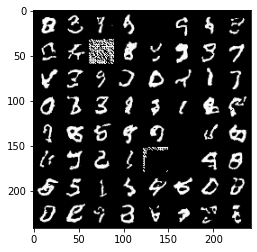

Epoch: [274/500]) Negative Log-Likelihood: -3689.66796875
Epoch: [275/500]) Batch: [1/75] Negative Log-Likelihood: -3712.044921875


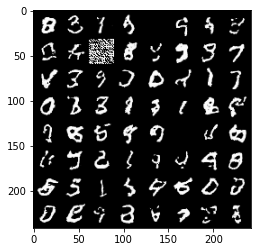

Epoch: [275/500]) Batch: [2/75] Negative Log-Likelihood: -3712.77685546875
Epoch: [275/500]) Batch: [3/75] Negative Log-Likelihood: -3720.85546875
Epoch: [275/500]) Batch: [4/75] Negative Log-Likelihood: -3705.24609375
Epoch: [275/500]) Batch: [5/75] Negative Log-Likelihood: -3709.896728515625
Epoch: [275/500]) Batch: [6/75] Negative Log-Likelihood: -3709.11376953125
Epoch: [275/500]) Batch: [7/75] Negative Log-Likelihood: -3695.796142578125
Epoch: [275/500]) Batch: [8/75] Negative Log-Likelihood: -3699.92626953125
Epoch: [275/500]) Batch: [9/75] Negative Log-Likelihood: -3719.2373046875
Epoch: [275/500]) Batch: [10/75] Negative Log-Likelihood: -3707.793701171875
Epoch: [275/500]) Batch: [11/75] Negative Log-Likelihood: -3711.924072265625
Epoch: [275/500]) Batch: [12/75] Negative Log-Likelihood: -3712.651123046875
Epoch: [275/500]) Batch: [13/75] Negative Log-Likelihood: -3706.782958984375
Epoch: [275/500]) Batch: [14/75] Negative Log-Likelihood: -3707.874267578125
Epoch: [275/500]) Ba

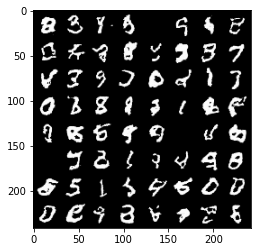

Epoch: [275/500]) Negative Log-Likelihood: -3682.431884765625
Epoch: [276/500]) Batch: [1/75] Negative Log-Likelihood: -3704.611572265625


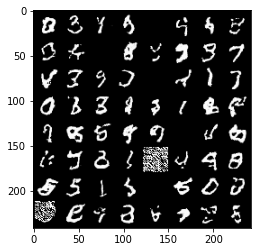

Epoch: [276/500]) Batch: [2/75] Negative Log-Likelihood: -3707.499267578125
Epoch: [276/500]) Batch: [3/75] Negative Log-Likelihood: -3714.730224609375
Epoch: [276/500]) Batch: [4/75] Negative Log-Likelihood: -3699.4462890625
Epoch: [276/500]) Batch: [5/75] Negative Log-Likelihood: -3709.854248046875
Epoch: [276/500]) Batch: [6/75] Negative Log-Likelihood: -3710.39111328125
Epoch: [276/500]) Batch: [7/75] Negative Log-Likelihood: -3699.192138671875
Epoch: [276/500]) Batch: [8/75] Negative Log-Likelihood: -3712.390625
Epoch: [276/500]) Batch: [9/75] Negative Log-Likelihood: -3718.803955078125
Epoch: [276/500]) Batch: [10/75] Negative Log-Likelihood: -3714.66064453125
Epoch: [276/500]) Batch: [11/75] Negative Log-Likelihood: -3710.747802734375
Epoch: [276/500]) Batch: [12/75] Negative Log-Likelihood: -3706.605224609375
Epoch: [276/500]) Batch: [13/75] Negative Log-Likelihood: -3699.050537109375
Epoch: [276/500]) Batch: [14/75] Negative Log-Likelihood: -3711.041259765625
Epoch: [276/500])

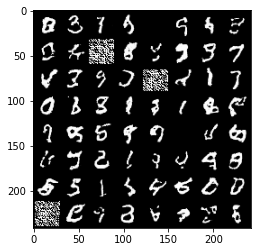

Epoch: [276/500]) Negative Log-Likelihood: -3687.4619140625
Epoch: [277/500]) Batch: [1/75] Negative Log-Likelihood: -3707.89990234375


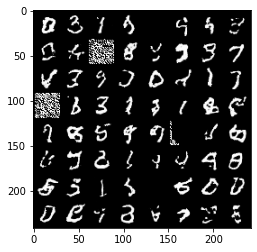

Epoch: [277/500]) Batch: [2/75] Negative Log-Likelihood: -3708.15234375
Epoch: [277/500]) Batch: [3/75] Negative Log-Likelihood: -3717.0361328125
Epoch: [277/500]) Batch: [4/75] Negative Log-Likelihood: -3703.139892578125
Epoch: [277/500]) Batch: [5/75] Negative Log-Likelihood: -3711.76611328125
Epoch: [277/500]) Batch: [6/75] Negative Log-Likelihood: -3710.4287109375
Epoch: [277/500]) Batch: [7/75] Negative Log-Likelihood: -3683.039306640625
Epoch: [277/500]) Batch: [8/75] Negative Log-Likelihood: -3667.565185546875
Epoch: [277/500]) Batch: [9/75] Negative Log-Likelihood: -3692.01171875
Epoch: [277/500]) Batch: [10/75] Negative Log-Likelihood: -3706.818603515625
Epoch: [277/500]) Batch: [11/75] Negative Log-Likelihood: -3701.32421875
Epoch: [277/500]) Batch: [12/75] Negative Log-Likelihood: -3700.877685546875
Epoch: [277/500]) Batch: [13/75] Negative Log-Likelihood: -3691.3037109375
Epoch: [277/500]) Batch: [14/75] Negative Log-Likelihood: -3702.866455078125
Epoch: [277/500]) Batch: [

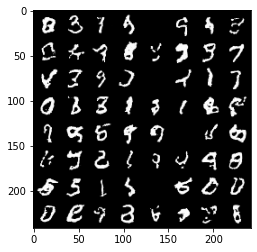

Epoch: [277/500]) Negative Log-Likelihood: -3685.75244140625
Epoch: [278/500]) Batch: [1/75] Negative Log-Likelihood: -3703.537353515625


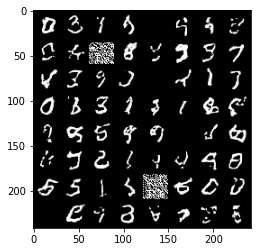

Epoch: [278/500]) Batch: [2/75] Negative Log-Likelihood: -3708.642333984375
Epoch: [278/500]) Batch: [3/75] Negative Log-Likelihood: -3717.920654296875
Epoch: [278/500]) Batch: [4/75] Negative Log-Likelihood: -3699.705322265625
Epoch: [278/500]) Batch: [5/75] Negative Log-Likelihood: -3709.818603515625
Epoch: [278/500]) Batch: [6/75] Negative Log-Likelihood: -3712.191162109375
Epoch: [278/500]) Batch: [7/75] Negative Log-Likelihood: -3702.83935546875
Epoch: [278/500]) Batch: [8/75] Negative Log-Likelihood: -3714.53173828125
Epoch: [278/500]) Batch: [9/75] Negative Log-Likelihood: -3722.283935546875
Epoch: [278/500]) Batch: [10/75] Negative Log-Likelihood: -3720.200439453125
Epoch: [278/500]) Batch: [11/75] Negative Log-Likelihood: -3718.947998046875
Epoch: [278/500]) Batch: [12/75] Negative Log-Likelihood: -3715.141845703125
Epoch: [278/500]) Batch: [13/75] Negative Log-Likelihood: -3714.1875
Epoch: [278/500]) Batch: [14/75] Negative Log-Likelihood: -3713.86328125
Epoch: [278/500]) Bat

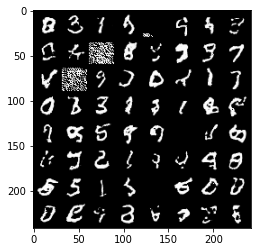

Epoch: [278/500]) Negative Log-Likelihood: -3687.854248046875
Epoch: [279/500]) Batch: [1/75] Negative Log-Likelihood: -3709.045654296875


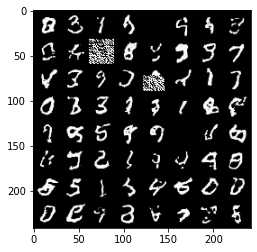

Epoch: [279/500]) Batch: [2/75] Negative Log-Likelihood: -3713.994873046875
Epoch: [279/500]) Batch: [3/75] Negative Log-Likelihood: -3720.026123046875
Epoch: [279/500]) Batch: [4/75] Negative Log-Likelihood: -3704.349365234375
Epoch: [279/500]) Batch: [5/75] Negative Log-Likelihood: -3710.93408203125
Epoch: [279/500]) Batch: [6/75] Negative Log-Likelihood: -3709.282958984375
Epoch: [279/500]) Batch: [7/75] Negative Log-Likelihood: -3698.904296875
Epoch: [279/500]) Batch: [8/75] Negative Log-Likelihood: -3702.123046875
Epoch: [279/500]) Batch: [9/75] Negative Log-Likelihood: -3720.274169921875
Epoch: [279/500]) Batch: [10/75] Negative Log-Likelihood: -3715.739501953125
Epoch: [279/500]) Batch: [11/75] Negative Log-Likelihood: -3713.0625
Epoch: [279/500]) Batch: [12/75] Negative Log-Likelihood: -3715.69873046875
Epoch: [279/500]) Batch: [13/75] Negative Log-Likelihood: -3705.497802734375
Epoch: [279/500]) Batch: [14/75] Negative Log-Likelihood: -3713.380126953125
Epoch: [279/500]) Batch

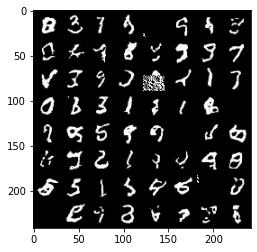

Epoch: [279/500]) Negative Log-Likelihood: -3691.447509765625
Epoch: [280/500]) Batch: [1/75] Negative Log-Likelihood: -3711.807373046875


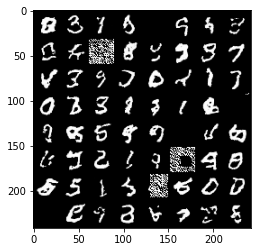

Epoch: [280/500]) Batch: [2/75] Negative Log-Likelihood: -3713.395263671875
Epoch: [280/500]) Batch: [3/75] Negative Log-Likelihood: -3718.877197265625
Epoch: [280/500]) Batch: [4/75] Negative Log-Likelihood: -3702.27783203125
Epoch: [280/500]) Batch: [5/75] Negative Log-Likelihood: -3712.655029296875
Epoch: [280/500]) Batch: [6/75] Negative Log-Likelihood: -3714.117919921875
Epoch: [280/500]) Batch: [7/75] Negative Log-Likelihood: -3702.372802734375
Epoch: [280/500]) Batch: [8/75] Negative Log-Likelihood: -3711.64111328125
Epoch: [280/500]) Batch: [9/75] Negative Log-Likelihood: -3718.783447265625
Epoch: [280/500]) Batch: [10/75] Negative Log-Likelihood: -3710.267333984375
Epoch: [280/500]) Batch: [11/75] Negative Log-Likelihood: -3711.99169921875
Epoch: [280/500]) Batch: [12/75] Negative Log-Likelihood: -3713.08740234375
Epoch: [280/500]) Batch: [13/75] Negative Log-Likelihood: -3704.617431640625
Epoch: [280/500]) Batch: [14/75] Negative Log-Likelihood: -3712.070556640625
Epoch: [280

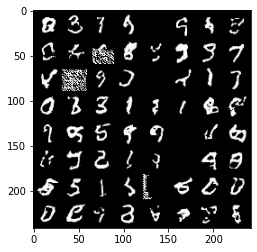

Epoch: [280/500]) Negative Log-Likelihood: -3651.91455078125
Epoch: [281/500]) Batch: [1/75] Negative Log-Likelihood: -3678.1484375


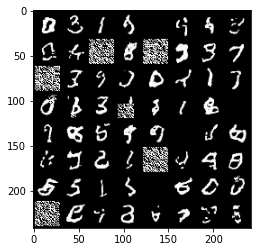

Epoch: [281/500]) Batch: [2/75] Negative Log-Likelihood: -3692.33203125
Epoch: [281/500]) Batch: [3/75] Negative Log-Likelihood: -3708.655029296875
Epoch: [281/500]) Batch: [4/75] Negative Log-Likelihood: -3685.00732421875
Epoch: [281/500]) Batch: [5/75] Negative Log-Likelihood: -3699.212158203125
Epoch: [281/500]) Batch: [6/75] Negative Log-Likelihood: -3699.11376953125
Epoch: [281/500]) Batch: [7/75] Negative Log-Likelihood: -3688.70361328125
Epoch: [281/500]) Batch: [8/75] Negative Log-Likelihood: -3706.973388671875
Epoch: [281/500]) Batch: [9/75] Negative Log-Likelihood: -3717.265625
Epoch: [281/500]) Batch: [10/75] Negative Log-Likelihood: -3711.673095703125
Epoch: [281/500]) Batch: [11/75] Negative Log-Likelihood: -3709.729248046875
Epoch: [281/500]) Batch: [12/75] Negative Log-Likelihood: -3709.23486328125
Epoch: [281/500]) Batch: [13/75] Negative Log-Likelihood: -3699.53466796875
Epoch: [281/500]) Batch: [14/75] Negative Log-Likelihood: -3707.144287109375
Epoch: [281/500]) Batc

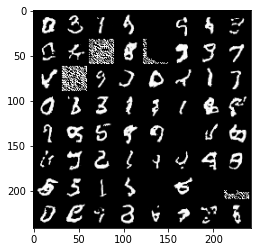

Epoch: [281/500]) Negative Log-Likelihood: -3691.387939453125
Epoch: [282/500]) Batch: [1/75] Negative Log-Likelihood: -3710.230224609375


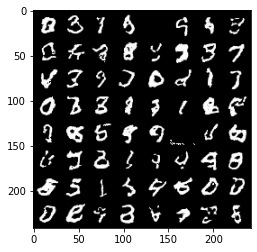

Epoch: [282/500]) Batch: [2/75] Negative Log-Likelihood: -3713.5498046875
Epoch: [282/500]) Batch: [3/75] Negative Log-Likelihood: -3715.48779296875
Epoch: [282/500]) Batch: [4/75] Negative Log-Likelihood: -3691.231689453125
Epoch: [282/500]) Batch: [5/75] Negative Log-Likelihood: -3707.709228515625
Epoch: [282/500]) Batch: [6/75] Negative Log-Likelihood: -3701.872314453125
Epoch: [282/500]) Batch: [7/75] Negative Log-Likelihood: -3695.142822265625
Epoch: [282/500]) Batch: [8/75] Negative Log-Likelihood: -3709.39794921875
Epoch: [282/500]) Batch: [9/75] Negative Log-Likelihood: -3717.304931640625
Epoch: [282/500]) Batch: [10/75] Negative Log-Likelihood: -3708.65869140625
Epoch: [282/500]) Batch: [11/75] Negative Log-Likelihood: -3705.08740234375
Epoch: [282/500]) Batch: [12/75] Negative Log-Likelihood: -3707.74560546875
Epoch: [282/500]) Batch: [13/75] Negative Log-Likelihood: -3706.010498046875
Epoch: [282/500]) Batch: [14/75] Negative Log-Likelihood: -3712.53369140625
Epoch: [282/500

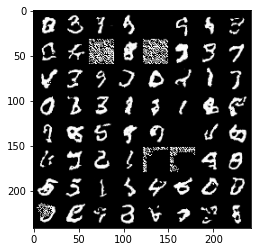

Epoch: [282/500]) Negative Log-Likelihood: -3658.757080078125
Epoch: [283/500]) Batch: [1/75] Negative Log-Likelihood: -3697.710205078125


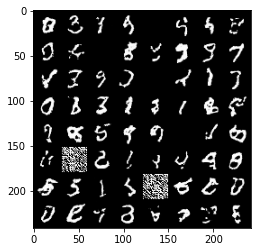

Epoch: [283/500]) Batch: [2/75] Negative Log-Likelihood: -3693.092529296875
Epoch: [283/500]) Batch: [3/75] Negative Log-Likelihood: -3681.638671875
Epoch: [283/500]) Batch: [4/75] Negative Log-Likelihood: -3672.299560546875
Epoch: [283/500]) Batch: [5/75] Negative Log-Likelihood: -3696.067138671875
Epoch: [283/500]) Batch: [6/75] Negative Log-Likelihood: -3697.39794921875
Epoch: [283/500]) Batch: [7/75] Negative Log-Likelihood: -3687.875
Epoch: [283/500]) Batch: [8/75] Negative Log-Likelihood: -3706.9990234375
Epoch: [283/500]) Batch: [9/75] Negative Log-Likelihood: -3712.686279296875
Epoch: [283/500]) Batch: [10/75] Negative Log-Likelihood: -3708.263671875
Epoch: [283/500]) Batch: [11/75] Negative Log-Likelihood: -3710.7744140625
Epoch: [283/500]) Batch: [12/75] Negative Log-Likelihood: -3698.4658203125
Epoch: [283/500]) Batch: [13/75] Negative Log-Likelihood: -3698.562744140625
Epoch: [283/500]) Batch: [14/75] Negative Log-Likelihood: -3705.78955078125
Epoch: [283/500]) Batch: [15/7

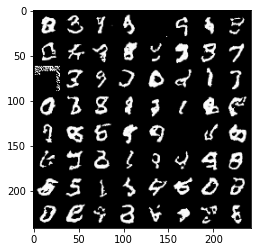

Epoch: [283/500]) Negative Log-Likelihood: -3684.907470703125
Epoch: [284/500]) Batch: [1/75] Negative Log-Likelihood: -3708.623046875


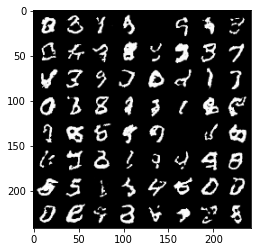

Epoch: [284/500]) Batch: [2/75] Negative Log-Likelihood: -3706.279296875
Epoch: [284/500]) Batch: [3/75] Negative Log-Likelihood: -3716.51123046875
Epoch: [284/500]) Batch: [4/75] Negative Log-Likelihood: -3694.39501953125
Epoch: [284/500]) Batch: [5/75] Negative Log-Likelihood: -3696.119873046875
Epoch: [284/500]) Batch: [6/75] Negative Log-Likelihood: -3699.150634765625
Epoch: [284/500]) Batch: [7/75] Negative Log-Likelihood: -3691.2802734375
Epoch: [284/500]) Batch: [8/75] Negative Log-Likelihood: -3706.0947265625
Epoch: [284/500]) Batch: [9/75] Negative Log-Likelihood: -3712.380615234375
Epoch: [284/500]) Batch: [10/75] Negative Log-Likelihood: -3712.36181640625
Epoch: [284/500]) Batch: [11/75] Negative Log-Likelihood: -3711.416259765625
Epoch: [284/500]) Batch: [12/75] Negative Log-Likelihood: -3707.992431640625
Epoch: [284/500]) Batch: [13/75] Negative Log-Likelihood: -3702.763671875
Epoch: [284/500]) Batch: [14/75] Negative Log-Likelihood: -3706.009521484375
Epoch: [284/500]) Ba

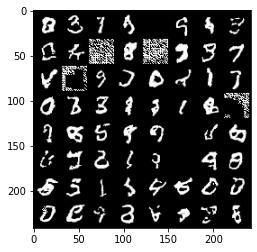

Epoch: [284/500]) Negative Log-Likelihood: -3687.11669921875
Epoch: [285/500]) Batch: [1/75] Negative Log-Likelihood: -3708.639892578125


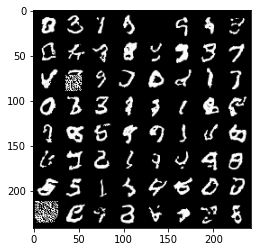

Epoch: [285/500]) Batch: [2/75] Negative Log-Likelihood: -3705.76806640625
Epoch: [285/500]) Batch: [3/75] Negative Log-Likelihood: -3714.96240234375
Epoch: [285/500]) Batch: [4/75] Negative Log-Likelihood: -3696.583984375
Epoch: [285/500]) Batch: [5/75] Negative Log-Likelihood: -3707.54638671875
Epoch: [285/500]) Batch: [6/75] Negative Log-Likelihood: -3712.455810546875
Epoch: [285/500]) Batch: [7/75] Negative Log-Likelihood: -3700.79150390625
Epoch: [285/500]) Batch: [8/75] Negative Log-Likelihood: -3707.677978515625
Epoch: [285/500]) Batch: [9/75] Negative Log-Likelihood: -3719.651123046875
Epoch: [285/500]) Batch: [10/75] Negative Log-Likelihood: -3712.512939453125
Epoch: [285/500]) Batch: [11/75] Negative Log-Likelihood: -3710.373779296875
Epoch: [285/500]) Batch: [12/75] Negative Log-Likelihood: -3711.79150390625
Epoch: [285/500]) Batch: [13/75] Negative Log-Likelihood: -3706.57470703125
Epoch: [285/500]) Batch: [14/75] Negative Log-Likelihood: -3714.024169921875
Epoch: [285/500]

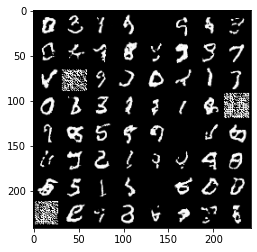

Epoch: [285/500]) Negative Log-Likelihood: -3679.07421875
Epoch: [286/500]) Batch: [1/75] Negative Log-Likelihood: -3700.176513671875


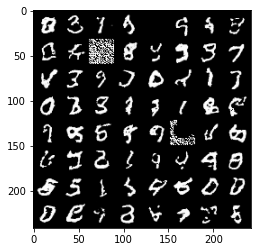

Epoch: [286/500]) Batch: [2/75] Negative Log-Likelihood: -3702.453369140625
Epoch: [286/500]) Batch: [3/75] Negative Log-Likelihood: -3713.340576171875
Epoch: [286/500]) Batch: [4/75] Negative Log-Likelihood: -3698.450439453125
Epoch: [286/500]) Batch: [5/75] Negative Log-Likelihood: -3708.9130859375
Epoch: [286/500]) Batch: [6/75] Negative Log-Likelihood: -3711.82080078125
Epoch: [286/500]) Batch: [7/75] Negative Log-Likelihood: -3702.69873046875
Epoch: [286/500]) Batch: [8/75] Negative Log-Likelihood: -3713.443603515625
Epoch: [286/500]) Batch: [9/75] Negative Log-Likelihood: -3722.271728515625
Epoch: [286/500]) Batch: [10/75] Negative Log-Likelihood: -3713.9189453125
Epoch: [286/500]) Batch: [11/75] Negative Log-Likelihood: -3707.87158203125
Epoch: [286/500]) Batch: [12/75] Negative Log-Likelihood: -3713.359619140625
Epoch: [286/500]) Batch: [13/75] Negative Log-Likelihood: -3707.0966796875
Epoch: [286/500]) Batch: [14/75] Negative Log-Likelihood: -3716.45703125
Epoch: [286/500]) Ba

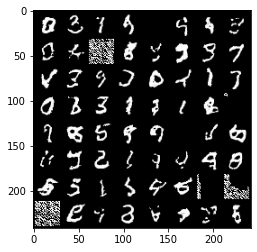

Epoch: [286/500]) Negative Log-Likelihood: -3686.657470703125
Epoch: [287/500]) Batch: [1/75] Negative Log-Likelihood: -3704.6826171875


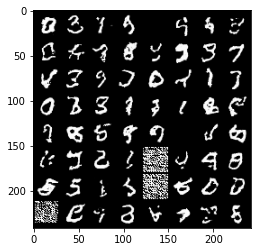

Epoch: [287/500]) Batch: [2/75] Negative Log-Likelihood: -3703.30419921875
Epoch: [287/500]) Batch: [3/75] Negative Log-Likelihood: -3715.396240234375
Epoch: [287/500]) Batch: [4/75] Negative Log-Likelihood: -3699.579345703125
Epoch: [287/500]) Batch: [5/75] Negative Log-Likelihood: -3710.3818359375
Epoch: [287/500]) Batch: [6/75] Negative Log-Likelihood: -3712.703369140625
Epoch: [287/500]) Batch: [7/75] Negative Log-Likelihood: -3699.494873046875
Epoch: [287/500]) Batch: [8/75] Negative Log-Likelihood: -3706.670166015625
Epoch: [287/500]) Batch: [9/75] Negative Log-Likelihood: -3716.954833984375
Epoch: [287/500]) Batch: [10/75] Negative Log-Likelihood: -3712.496826171875
Epoch: [287/500]) Batch: [11/75] Negative Log-Likelihood: -3714.8974609375
Epoch: [287/500]) Batch: [12/75] Negative Log-Likelihood: -3712.591552734375
Epoch: [287/500]) Batch: [13/75] Negative Log-Likelihood: -3705.021728515625
Epoch: [287/500]) Batch: [14/75] Negative Log-Likelihood: -3717.084228515625
Epoch: [287/

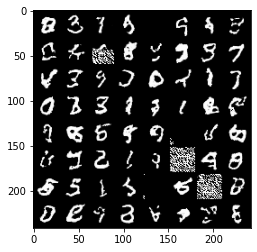

Epoch: [287/500]) Negative Log-Likelihood: -3691.236083984375
Epoch: [288/500]) Batch: [1/75] Negative Log-Likelihood: -3711.73876953125


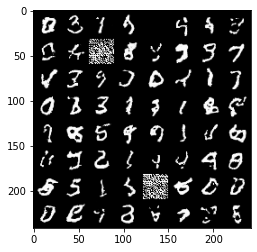

Epoch: [288/500]) Batch: [2/75] Negative Log-Likelihood: -3710.59423828125
Epoch: [288/500]) Batch: [3/75] Negative Log-Likelihood: -3715.414306640625
Epoch: [288/500]) Batch: [4/75] Negative Log-Likelihood: -3699.619873046875
Epoch: [288/500]) Batch: [5/75] Negative Log-Likelihood: -3700.7021484375
Epoch: [288/500]) Batch: [6/75] Negative Log-Likelihood: -3713.8818359375
Epoch: [288/500]) Batch: [7/75] Negative Log-Likelihood: -3692.87744140625
Epoch: [288/500]) Batch: [8/75] Negative Log-Likelihood: -3709.28173828125
Epoch: [288/500]) Batch: [9/75] Negative Log-Likelihood: -3716.414306640625
Epoch: [288/500]) Batch: [10/75] Negative Log-Likelihood: -3698.91650390625
Epoch: [288/500]) Batch: [11/75] Negative Log-Likelihood: -3697.56982421875
Epoch: [288/500]) Batch: [12/75] Negative Log-Likelihood: -3708.3603515625
Epoch: [288/500]) Batch: [13/75] Negative Log-Likelihood: -3702.46435546875
Epoch: [288/500]) Batch: [14/75] Negative Log-Likelihood: -3704.364990234375
Epoch: [288/500]) B

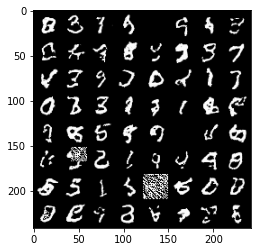

Epoch: [288/500]) Negative Log-Likelihood: -3684.3505859375
Epoch: [289/500]) Batch: [1/75] Negative Log-Likelihood: -3704.90673828125


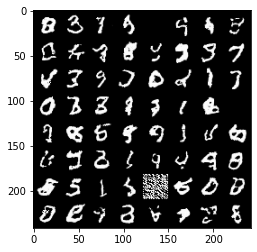

Epoch: [289/500]) Batch: [2/75] Negative Log-Likelihood: -3697.9189453125
Epoch: [289/500]) Batch: [3/75] Negative Log-Likelihood: -3712.482666015625
Epoch: [289/500]) Batch: [4/75] Negative Log-Likelihood: -3694.5849609375
Epoch: [289/500]) Batch: [5/75] Negative Log-Likelihood: -3708.452392578125
Epoch: [289/500]) Batch: [6/75] Negative Log-Likelihood: -3704.043701171875
Epoch: [289/500]) Batch: [7/75] Negative Log-Likelihood: -3703.12744140625
Epoch: [289/500]) Batch: [8/75] Negative Log-Likelihood: -3712.961181640625
Epoch: [289/500]) Batch: [9/75] Negative Log-Likelihood: -3721.404296875
Epoch: [289/500]) Batch: [10/75] Negative Log-Likelihood: -3716.6591796875
Epoch: [289/500]) Batch: [11/75] Negative Log-Likelihood: -3716.54248046875
Epoch: [289/500]) Batch: [12/75] Negative Log-Likelihood: -3716.677490234375
Epoch: [289/500]) Batch: [13/75] Negative Log-Likelihood: -3714.117431640625
Epoch: [289/500]) Batch: [14/75] Negative Log-Likelihood: -3715.177490234375
Epoch: [289/500]) 

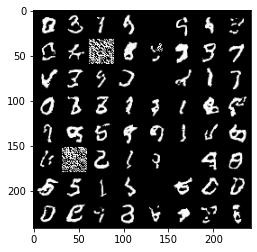

Epoch: [289/500]) Negative Log-Likelihood: -3690.128662109375
Epoch: [290/500]) Batch: [1/75] Negative Log-Likelihood: -3707.7685546875


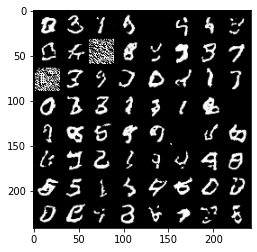

Epoch: [290/500]) Batch: [2/75] Negative Log-Likelihood: -3712.3251953125
Epoch: [290/500]) Batch: [3/75] Negative Log-Likelihood: -3715.33251953125
Epoch: [290/500]) Batch: [4/75] Negative Log-Likelihood: -3693.03369140625
Epoch: [290/500]) Batch: [5/75] Negative Log-Likelihood: -3710.0087890625
Epoch: [290/500]) Batch: [6/75] Negative Log-Likelihood: -3699.841064453125
Epoch: [290/500]) Batch: [7/75] Negative Log-Likelihood: -3700.80517578125
Epoch: [290/500]) Batch: [8/75] Negative Log-Likelihood: -3708.5341796875
Epoch: [290/500]) Batch: [9/75] Negative Log-Likelihood: -3721.583740234375
Epoch: [290/500]) Batch: [10/75] Negative Log-Likelihood: -3716.44873046875
Epoch: [290/500]) Batch: [11/75] Negative Log-Likelihood: -3711.4755859375
Epoch: [290/500]) Batch: [12/75] Negative Log-Likelihood: -3714.6591796875
Epoch: [290/500]) Batch: [13/75] Negative Log-Likelihood: -3708.108154296875
Epoch: [290/500]) Batch: [14/75] Negative Log-Likelihood: -3716.203125
Epoch: [290/500]) Batch: [1

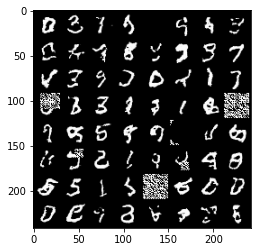

Epoch: [290/500]) Negative Log-Likelihood: -3688.0888671875
Epoch: [291/500]) Batch: [1/75] Negative Log-Likelihood: -3710.30712890625


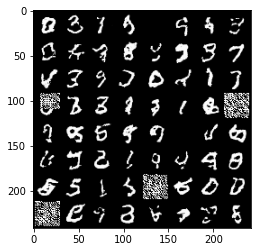

Epoch: [291/500]) Batch: [2/75] Negative Log-Likelihood: -3711.90869140625
Epoch: [291/500]) Batch: [3/75] Negative Log-Likelihood: -3719.87548828125
Epoch: [291/500]) Batch: [4/75] Negative Log-Likelihood: -3702.991455078125
Epoch: [291/500]) Batch: [5/75] Negative Log-Likelihood: -3706.56298828125
Epoch: [291/500]) Batch: [6/75] Negative Log-Likelihood: -3697.378662109375
Epoch: [291/500]) Batch: [7/75] Negative Log-Likelihood: -3689.43701171875
Epoch: [291/500]) Batch: [8/75] Negative Log-Likelihood: -3710.4892578125
Epoch: [291/500]) Batch: [9/75] Negative Log-Likelihood: -3718.666748046875
Epoch: [291/500]) Batch: [10/75] Negative Log-Likelihood: -3712.30615234375
Epoch: [291/500]) Batch: [11/75] Negative Log-Likelihood: -3713.131103515625
Epoch: [291/500]) Batch: [12/75] Negative Log-Likelihood: -3714.4345703125
Epoch: [291/500]) Batch: [13/75] Negative Log-Likelihood: -3712.41796875
Epoch: [291/500]) Batch: [14/75] Negative Log-Likelihood: -3712.939208984375
Epoch: [291/500]) Ba

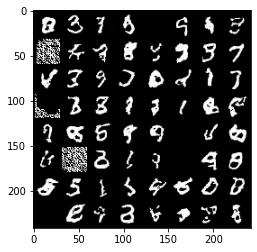

Epoch: [291/500]) Negative Log-Likelihood: -3682.6279296875
Epoch: [292/500]) Batch: [1/75] Negative Log-Likelihood: -3706.354248046875


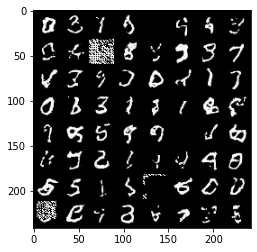

Epoch: [292/500]) Batch: [2/75] Negative Log-Likelihood: -3706.65234375
Epoch: [292/500]) Batch: [3/75] Negative Log-Likelihood: -3709.69775390625
Epoch: [292/500]) Batch: [4/75] Negative Log-Likelihood: -3694.29150390625
Epoch: [292/500]) Batch: [5/75] Negative Log-Likelihood: -3700.332763671875
Epoch: [292/500]) Batch: [6/75] Negative Log-Likelihood: -3692.5
Epoch: [292/500]) Batch: [7/75] Negative Log-Likelihood: -3691.123779296875
Epoch: [292/500]) Batch: [8/75] Negative Log-Likelihood: -3701.5654296875
Epoch: [292/500]) Batch: [9/75] Negative Log-Likelihood: -3712.39892578125
Epoch: [292/500]) Batch: [10/75] Negative Log-Likelihood: -3711.850341796875
Epoch: [292/500]) Batch: [11/75] Negative Log-Likelihood: -3711.3994140625
Epoch: [292/500]) Batch: [12/75] Negative Log-Likelihood: -3710.17578125
Epoch: [292/500]) Batch: [13/75] Negative Log-Likelihood: -3705.74365234375
Epoch: [292/500]) Batch: [14/75] Negative Log-Likelihood: -3712.70361328125
Epoch: [292/500]) Batch: [15/75] Ne

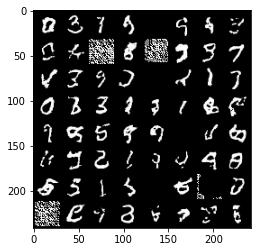

Epoch: [292/500]) Negative Log-Likelihood: -3689.716552734375
Epoch: [293/500]) Batch: [1/75] Negative Log-Likelihood: -3708.4619140625


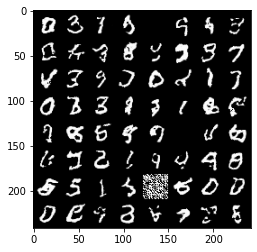

Epoch: [293/500]) Batch: [2/75] Negative Log-Likelihood: -3708.23046875
Epoch: [293/500]) Batch: [3/75] Negative Log-Likelihood: -3705.4189453125
Epoch: [293/500]) Batch: [4/75] Negative Log-Likelihood: -3696.427490234375
Epoch: [293/500]) Batch: [5/75] Negative Log-Likelihood: -3708.418701171875
Epoch: [293/500]) Batch: [6/75] Negative Log-Likelihood: -3707.361083984375
Epoch: [293/500]) Batch: [7/75] Negative Log-Likelihood: -3697.9384765625
Epoch: [293/500]) Batch: [8/75] Negative Log-Likelihood: -3711.753662109375
Epoch: [293/500]) Batch: [9/75] Negative Log-Likelihood: -3714.9716796875
Epoch: [293/500]) Batch: [10/75] Negative Log-Likelihood: -3709.89501953125
Epoch: [293/500]) Batch: [11/75] Negative Log-Likelihood: -3713.78369140625
Epoch: [293/500]) Batch: [12/75] Negative Log-Likelihood: -3711.71240234375
Epoch: [293/500]) Batch: [13/75] Negative Log-Likelihood: -3704.746826171875
Epoch: [293/500]) Batch: [14/75] Negative Log-Likelihood: -3711.053466796875
Epoch: [293/500]) Ba

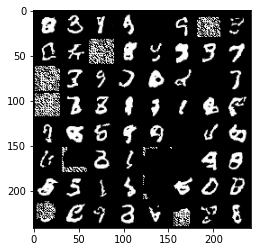

Epoch: [293/500]) Negative Log-Likelihood: -3677.79248046875
Epoch: [294/500]) Batch: [1/75] Negative Log-Likelihood: -3700.46875


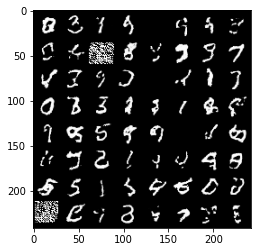

Epoch: [294/500]) Batch: [2/75] Negative Log-Likelihood: -3700.03466796875
Epoch: [294/500]) Batch: [3/75] Negative Log-Likelihood: -3715.548095703125
Epoch: [294/500]) Batch: [4/75] Negative Log-Likelihood: -3694.20654296875
Epoch: [294/500]) Batch: [5/75] Negative Log-Likelihood: -3705.62109375
Epoch: [294/500]) Batch: [6/75] Negative Log-Likelihood: -3708.919189453125
Epoch: [294/500]) Batch: [7/75] Negative Log-Likelihood: -3701.357177734375
Epoch: [294/500]) Batch: [8/75] Negative Log-Likelihood: -3714.62109375
Epoch: [294/500]) Batch: [9/75] Negative Log-Likelihood: -3718.045166015625
Epoch: [294/500]) Batch: [10/75] Negative Log-Likelihood: -3713.875
Epoch: [294/500]) Batch: [11/75] Negative Log-Likelihood: -3710.4169921875
Epoch: [294/500]) Batch: [12/75] Negative Log-Likelihood: -3709.155517578125
Epoch: [294/500]) Batch: [13/75] Negative Log-Likelihood: -3702.961181640625
Epoch: [294/500]) Batch: [14/75] Negative Log-Likelihood: -3709.78564453125
Epoch: [294/500]) Batch: [15/

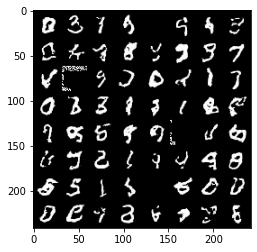

Epoch: [294/500]) Negative Log-Likelihood: -3692.945556640625
Epoch: [295/500]) Batch: [1/75] Negative Log-Likelihood: -3714.690185546875


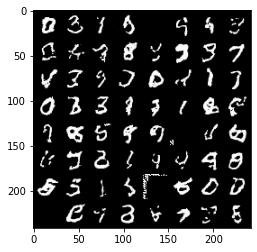

Epoch: [295/500]) Batch: [2/75] Negative Log-Likelihood: -3713.6689453125
Epoch: [295/500]) Batch: [3/75] Negative Log-Likelihood: -3721.241455078125
Epoch: [295/500]) Batch: [4/75] Negative Log-Likelihood: -3705.174072265625
Epoch: [295/500]) Batch: [5/75] Negative Log-Likelihood: -3713.810546875
Epoch: [295/500]) Batch: [6/75] Negative Log-Likelihood: -3714.90771484375
Epoch: [295/500]) Batch: [7/75] Negative Log-Likelihood: -3701.93115234375
Epoch: [295/500]) Batch: [8/75] Negative Log-Likelihood: -3712.539306640625
Epoch: [295/500]) Batch: [9/75] Negative Log-Likelihood: -3722.907958984375
Epoch: [295/500]) Batch: [10/75] Negative Log-Likelihood: -3715.4013671875
Epoch: [295/500]) Batch: [11/75] Negative Log-Likelihood: -3716.977294921875
Epoch: [295/500]) Batch: [12/75] Negative Log-Likelihood: -3718.349365234375
Epoch: [295/500]) Batch: [13/75] Negative Log-Likelihood: -3714.695556640625
Epoch: [295/500]) Batch: [14/75] Negative Log-Likelihood: -3718.342529296875
Epoch: [295/500]

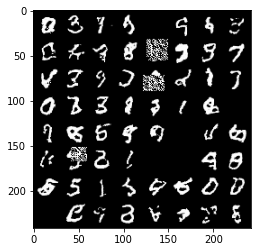

Epoch: [295/500]) Negative Log-Likelihood: -3679.794189453125
Epoch: [296/500]) Batch: [1/75] Negative Log-Likelihood: -3704.86376953125


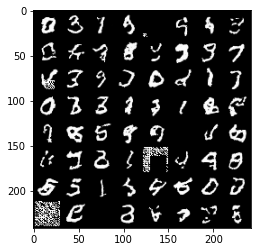

Epoch: [296/500]) Batch: [2/75] Negative Log-Likelihood: -3708.6298828125
Epoch: [296/500]) Batch: [3/75] Negative Log-Likelihood: -3714.92236328125
Epoch: [296/500]) Batch: [4/75] Negative Log-Likelihood: -3699.27490234375
Epoch: [296/500]) Batch: [5/75] Negative Log-Likelihood: -3709.62548828125
Epoch: [296/500]) Batch: [6/75] Negative Log-Likelihood: -3713.445556640625
Epoch: [296/500]) Batch: [7/75] Negative Log-Likelihood: -3696.0947265625
Epoch: [296/500]) Batch: [8/75] Negative Log-Likelihood: -3700.693603515625
Epoch: [296/500]) Batch: [9/75] Negative Log-Likelihood: -3719.3779296875
Epoch: [296/500]) Batch: [10/75] Negative Log-Likelihood: -3713.8466796875
Epoch: [296/500]) Batch: [11/75] Negative Log-Likelihood: -3705.512451171875
Epoch: [296/500]) Batch: [12/75] Negative Log-Likelihood: -3714.6162109375
Epoch: [296/500]) Batch: [13/75] Negative Log-Likelihood: -3703.81396484375
Epoch: [296/500]) Batch: [14/75] Negative Log-Likelihood: -3707.1181640625
Epoch: [296/500]) Batch

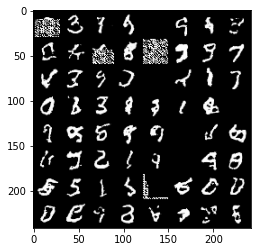

Epoch: [296/500]) Negative Log-Likelihood: -3689.552490234375
Epoch: [297/500]) Batch: [1/75] Negative Log-Likelihood: -3711.18310546875


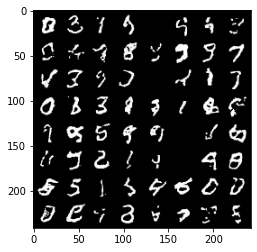

Epoch: [297/500]) Batch: [2/75] Negative Log-Likelihood: -3713.47607421875
Epoch: [297/500]) Batch: [3/75] Negative Log-Likelihood: -3719.247314453125
Epoch: [297/500]) Batch: [4/75] Negative Log-Likelihood: -3703.735595703125
Epoch: [297/500]) Batch: [5/75] Negative Log-Likelihood: -3712.076904296875
Epoch: [297/500]) Batch: [6/75] Negative Log-Likelihood: -3712.372314453125
Epoch: [297/500]) Batch: [7/75] Negative Log-Likelihood: -3701.827392578125
Epoch: [297/500]) Batch: [8/75] Negative Log-Likelihood: -3713.544921875
Epoch: [297/500]) Batch: [9/75] Negative Log-Likelihood: -3722.349365234375
Epoch: [297/500]) Batch: [10/75] Negative Log-Likelihood: -3716.52392578125
Epoch: [297/500]) Batch: [11/75] Negative Log-Likelihood: -3719.50927734375
Epoch: [297/500]) Batch: [12/75] Negative Log-Likelihood: -3717.603759765625
Epoch: [297/500]) Batch: [13/75] Negative Log-Likelihood: -3712.090576171875
Epoch: [297/500]) Batch: [14/75] Negative Log-Likelihood: -3716.233642578125
Epoch: [297/5

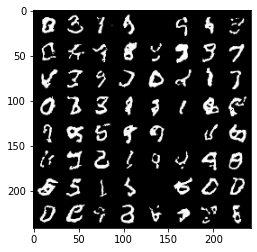

Epoch: [297/500]) Negative Log-Likelihood: -3673.71923828125
Epoch: [298/500]) Batch: [1/75] Negative Log-Likelihood: -3706.49609375


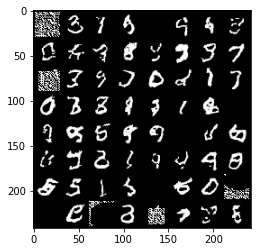

Epoch: [298/500]) Batch: [2/75] Negative Log-Likelihood: -3697.91796875
Epoch: [298/500]) Batch: [3/75] Negative Log-Likelihood: -3709.09814453125
Epoch: [298/500]) Batch: [4/75] Negative Log-Likelihood: -3698.267333984375
Epoch: [298/500]) Batch: [5/75] Negative Log-Likelihood: -3708.552490234375
Epoch: [298/500]) Batch: [6/75] Negative Log-Likelihood: -3704.5166015625
Epoch: [298/500]) Batch: [7/75] Negative Log-Likelihood: -3697.201904296875
Epoch: [298/500]) Batch: [8/75] Negative Log-Likelihood: -3711.51220703125
Epoch: [298/500]) Batch: [9/75] Negative Log-Likelihood: -3716.6669921875
Epoch: [298/500]) Batch: [10/75] Negative Log-Likelihood: -3713.896484375
Epoch: [298/500]) Batch: [11/75] Negative Log-Likelihood: -3715.328369140625
Epoch: [298/500]) Batch: [12/75] Negative Log-Likelihood: -3713.04150390625
Epoch: [298/500]) Batch: [13/75] Negative Log-Likelihood: -3710.3173828125
Epoch: [298/500]) Batch: [14/75] Negative Log-Likelihood: -3705.28369140625
Epoch: [298/500]) Batch:

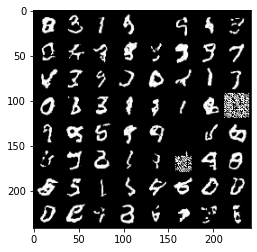

Epoch: [298/500]) Negative Log-Likelihood: -3689.28271484375
Epoch: [299/500]) Batch: [1/75] Negative Log-Likelihood: -3708.9091796875


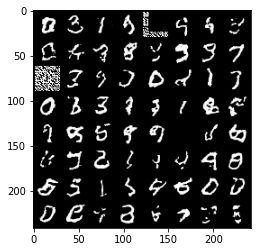

Epoch: [299/500]) Batch: [2/75] Negative Log-Likelihood: -3710.289306640625
Epoch: [299/500]) Batch: [3/75] Negative Log-Likelihood: -3718.3232421875
Epoch: [299/500]) Batch: [4/75] Negative Log-Likelihood: -3700.309814453125
Epoch: [299/500]) Batch: [5/75] Negative Log-Likelihood: -3706.54736328125
Epoch: [299/500]) Batch: [6/75] Negative Log-Likelihood: -3711.593994140625
Epoch: [299/500]) Batch: [7/75] Negative Log-Likelihood: -3707.668701171875
Epoch: [299/500]) Batch: [8/75] Negative Log-Likelihood: -3715.419189453125
Epoch: [299/500]) Batch: [9/75] Negative Log-Likelihood: -3720.642333984375
Epoch: [299/500]) Batch: [10/75] Negative Log-Likelihood: -3721.1005859375
Epoch: [299/500]) Batch: [11/75] Negative Log-Likelihood: -3717.92431640625
Epoch: [299/500]) Batch: [12/75] Negative Log-Likelihood: -3710.44873046875
Epoch: [299/500]) Batch: [13/75] Negative Log-Likelihood: -3700.86865234375
Epoch: [299/500]) Batch: [14/75] Negative Log-Likelihood: -3696.41748046875
Epoch: [299/500]

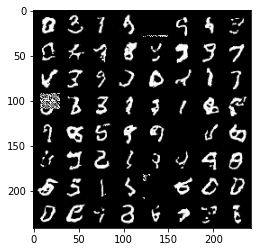

Epoch: [299/500]) Negative Log-Likelihood: -3682.592529296875
Epoch: [300/500]) Batch: [1/75] Negative Log-Likelihood: -3698.708251953125


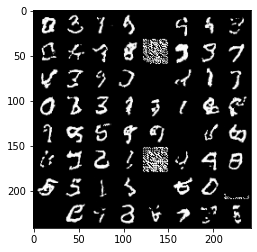

Epoch: [300/500]) Batch: [2/75] Negative Log-Likelihood: -3698.86279296875
Epoch: [300/500]) Batch: [3/75] Negative Log-Likelihood: -3710.35400390625
Epoch: [300/500]) Batch: [4/75] Negative Log-Likelihood: -3693.6025390625
Epoch: [300/500]) Batch: [5/75] Negative Log-Likelihood: -3702.50927734375
Epoch: [300/500]) Batch: [6/75] Negative Log-Likelihood: -3706.534912109375
Epoch: [300/500]) Batch: [7/75] Negative Log-Likelihood: -3704.840576171875
Epoch: [300/500]) Batch: [8/75] Negative Log-Likelihood: -3711.07470703125
Epoch: [300/500]) Batch: [9/75] Negative Log-Likelihood: -3718.759033203125
Epoch: [300/500]) Batch: [10/75] Negative Log-Likelihood: -3717.516845703125
Epoch: [300/500]) Batch: [11/75] Negative Log-Likelihood: -3709.820556640625
Epoch: [300/500]) Batch: [12/75] Negative Log-Likelihood: -3711.506591796875
Epoch: [300/500]) Batch: [13/75] Negative Log-Likelihood: -3704.98828125
Epoch: [300/500]) Batch: [14/75] Negative Log-Likelihood: -3713.349853515625
Epoch: [300/500])

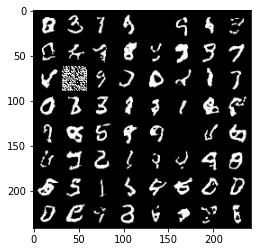

Epoch: [300/500]) Negative Log-Likelihood: -3696.217529296875
Epoch: [301/500]) Batch: [1/75] Negative Log-Likelihood: -3708.3193359375


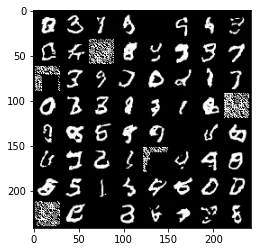

Epoch: [301/500]) Batch: [2/75] Negative Log-Likelihood: -3701.456787109375
Epoch: [301/500]) Batch: [3/75] Negative Log-Likelihood: -3718.4130859375
Epoch: [301/500]) Batch: [4/75] Negative Log-Likelihood: -3693.388671875
Epoch: [301/500]) Batch: [5/75] Negative Log-Likelihood: -3703.4287109375
Epoch: [301/500]) Batch: [6/75] Negative Log-Likelihood: -3705.078125
Epoch: [301/500]) Batch: [7/75] Negative Log-Likelihood: -3698.326904296875
Epoch: [301/500]) Batch: [8/75] Negative Log-Likelihood: -3713.630126953125
Epoch: [301/500]) Batch: [9/75] Negative Log-Likelihood: -3719.69775390625
Epoch: [301/500]) Batch: [10/75] Negative Log-Likelihood: -3711.01611328125
Epoch: [301/500]) Batch: [11/75] Negative Log-Likelihood: -3716.98583984375
Epoch: [301/500]) Batch: [12/75] Negative Log-Likelihood: -3708.807373046875
Epoch: [301/500]) Batch: [13/75] Negative Log-Likelihood: -3702.561767578125
Epoch: [301/500]) Batch: [14/75] Negative Log-Likelihood: -3715.656982421875
Epoch: [301/500]) Batch

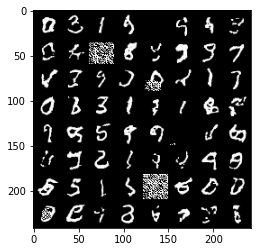

Epoch: [301/500]) Negative Log-Likelihood: -3696.27685546875
Epoch: [302/500]) Batch: [1/75] Negative Log-Likelihood: -3711.566162109375


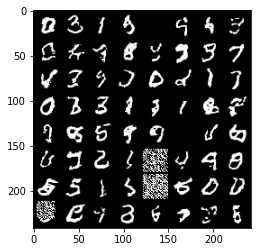

Epoch: [302/500]) Batch: [2/75] Negative Log-Likelihood: -3716.0068359375
Epoch: [302/500]) Batch: [3/75] Negative Log-Likelihood: -3720.7861328125
Epoch: [302/500]) Batch: [4/75] Negative Log-Likelihood: -3707.11328125
Epoch: [302/500]) Batch: [5/75] Negative Log-Likelihood: -3708.0048828125
Epoch: [302/500]) Batch: [6/75] Negative Log-Likelihood: -3701.252197265625
Epoch: [302/500]) Batch: [7/75] Negative Log-Likelihood: -3704.52685546875
Epoch: [302/500]) Batch: [8/75] Negative Log-Likelihood: -3707.338623046875
Epoch: [302/500]) Batch: [9/75] Negative Log-Likelihood: -3712.1591796875
Epoch: [302/500]) Batch: [10/75] Negative Log-Likelihood: -3713.890869140625
Epoch: [302/500]) Batch: [11/75] Negative Log-Likelihood: -3714.973388671875
Epoch: [302/500]) Batch: [12/75] Negative Log-Likelihood: -3711.07421875
Epoch: [302/500]) Batch: [13/75] Negative Log-Likelihood: -3709.5625
Epoch: [302/500]) Batch: [14/75] Negative Log-Likelihood: -3714.498046875
Epoch: [302/500]) Batch: [15/75] Ne

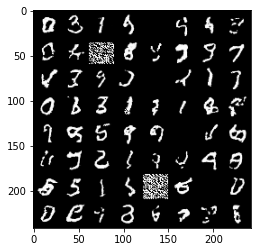

Epoch: [302/500]) Negative Log-Likelihood: -3691.0966796875
Epoch: [303/500]) Batch: [1/75] Negative Log-Likelihood: -3705.86669921875


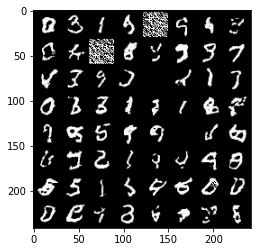

Epoch: [303/500]) Batch: [2/75] Negative Log-Likelihood: -3693.2412109375
Epoch: [303/500]) Batch: [3/75] Negative Log-Likelihood: -3713.9013671875
Epoch: [303/500]) Batch: [4/75] Negative Log-Likelihood: -3695.682373046875
Epoch: [303/500]) Batch: [5/75] Negative Log-Likelihood: -3690.248779296875
Epoch: [303/500]) Batch: [6/75] Negative Log-Likelihood: -3707.5986328125
Epoch: [303/500]) Batch: [7/75] Negative Log-Likelihood: -3693.95263671875
Epoch: [303/500]) Batch: [8/75] Negative Log-Likelihood: -3699.81298828125
Epoch: [303/500]) Batch: [9/75] Negative Log-Likelihood: -3714.944091796875
Epoch: [303/500]) Batch: [10/75] Negative Log-Likelihood: -3713.764892578125
Epoch: [303/500]) Batch: [11/75] Negative Log-Likelihood: -3707.961181640625
Epoch: [303/500]) Batch: [12/75] Negative Log-Likelihood: -3702.322509765625
Epoch: [303/500]) Batch: [13/75] Negative Log-Likelihood: -3703.7802734375
Epoch: [303/500]) Batch: [14/75] Negative Log-Likelihood: -3710.416259765625
Epoch: [303/500])

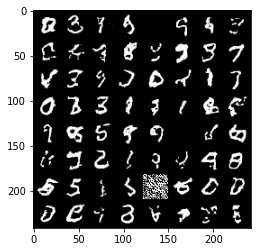

Epoch: [303/500]) Negative Log-Likelihood: -3667.729248046875
Epoch: [304/500]) Batch: [1/75] Negative Log-Likelihood: -3697.873046875


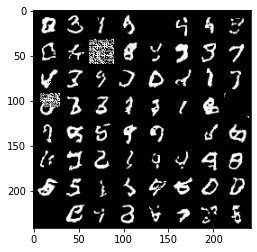

Epoch: [304/500]) Batch: [2/75] Negative Log-Likelihood: -3694.348876953125
Epoch: [304/500]) Batch: [3/75] Negative Log-Likelihood: -3710.581787109375
Epoch: [304/500]) Batch: [4/75] Negative Log-Likelihood: -3689.990966796875
Epoch: [304/500]) Batch: [5/75] Negative Log-Likelihood: -3703.13427734375
Epoch: [304/500]) Batch: [6/75] Negative Log-Likelihood: -3697.4130859375
Epoch: [304/500]) Batch: [7/75] Negative Log-Likelihood: -3689.77685546875
Epoch: [304/500]) Batch: [8/75] Negative Log-Likelihood: -3706.3095703125
Epoch: [304/500]) Batch: [9/75] Negative Log-Likelihood: -3715.16357421875
Epoch: [304/500]) Batch: [10/75] Negative Log-Likelihood: -3709.464599609375
Epoch: [304/500]) Batch: [11/75] Negative Log-Likelihood: -3711.39453125
Epoch: [304/500]) Batch: [12/75] Negative Log-Likelihood: -3704.94970703125
Epoch: [304/500]) Batch: [13/75] Negative Log-Likelihood: -3693.262939453125
Epoch: [304/500]) Batch: [14/75] Negative Log-Likelihood: -3699.068115234375
Epoch: [304/500]) B

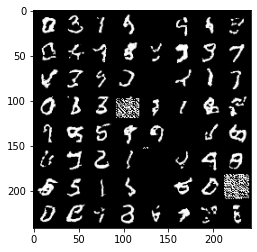

Epoch: [304/500]) Negative Log-Likelihood: -3685.15234375
Epoch: [305/500]) Batch: [1/75] Negative Log-Likelihood: -3704.357421875


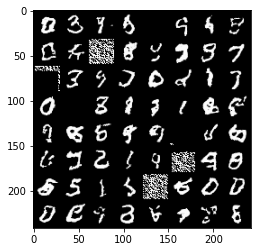

Epoch: [305/500]) Batch: [2/75] Negative Log-Likelihood: -3707.763671875
Epoch: [305/500]) Batch: [3/75] Negative Log-Likelihood: -3716.0986328125
Epoch: [305/500]) Batch: [4/75] Negative Log-Likelihood: -3698.592529296875
Epoch: [305/500]) Batch: [5/75] Negative Log-Likelihood: -3711.20751953125
Epoch: [305/500]) Batch: [6/75] Negative Log-Likelihood: -3710.98828125
Epoch: [305/500]) Batch: [7/75] Negative Log-Likelihood: -3698.965576171875
Epoch: [305/500]) Batch: [8/75] Negative Log-Likelihood: -3716.070556640625
Epoch: [305/500]) Batch: [9/75] Negative Log-Likelihood: -3719.4091796875
Epoch: [305/500]) Batch: [10/75] Negative Log-Likelihood: -3710.13330078125
Epoch: [305/500]) Batch: [11/75] Negative Log-Likelihood: -3711.968017578125
Epoch: [305/500]) Batch: [12/75] Negative Log-Likelihood: -3714.15771484375
Epoch: [305/500]) Batch: [13/75] Negative Log-Likelihood: -3711.00439453125
Epoch: [305/500]) Batch: [14/75] Negative Log-Likelihood: -3711.257080078125
Epoch: [305/500]) Batc

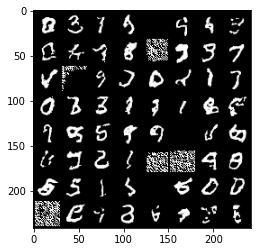

Epoch: [305/500]) Negative Log-Likelihood: -3696.0634765625
Epoch: [306/500]) Batch: [1/75] Negative Log-Likelihood: -3717.22119140625


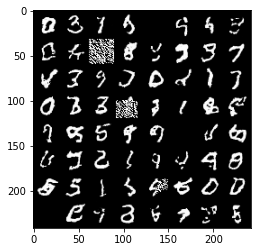

Epoch: [306/500]) Batch: [2/75] Negative Log-Likelihood: -3714.655517578125
Epoch: [306/500]) Batch: [3/75] Negative Log-Likelihood: -3722.193603515625
Epoch: [306/500]) Batch: [4/75] Negative Log-Likelihood: -3702.266845703125
Epoch: [306/500]) Batch: [5/75] Negative Log-Likelihood: -3710.590576171875
Epoch: [306/500]) Batch: [6/75] Negative Log-Likelihood: -3714.623046875
Epoch: [306/500]) Batch: [7/75] Negative Log-Likelihood: -3701.27587890625
Epoch: [306/500]) Batch: [8/75] Negative Log-Likelihood: -3712.1787109375
Epoch: [306/500]) Batch: [9/75] Negative Log-Likelihood: -3719.37646484375
Epoch: [306/500]) Batch: [10/75] Negative Log-Likelihood: -3704.994873046875
Epoch: [306/500]) Batch: [11/75] Negative Log-Likelihood: -3708.977783203125
Epoch: [306/500]) Batch: [12/75] Negative Log-Likelihood: -3716.863037109375
Epoch: [306/500]) Batch: [13/75] Negative Log-Likelihood: -3709.32080078125
Epoch: [306/500]) Batch: [14/75] Negative Log-Likelihood: -3715.701904296875
Epoch: [306/500

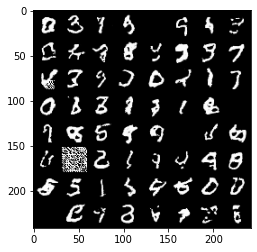

Epoch: [306/500]) Negative Log-Likelihood: -3688.228271484375
Epoch: [307/500]) Batch: [1/75] Negative Log-Likelihood: -3712.00390625


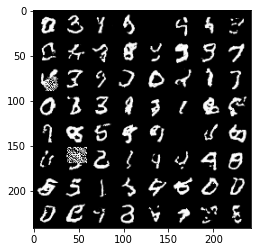

Epoch: [307/500]) Batch: [2/75] Negative Log-Likelihood: -3713.7158203125
Epoch: [307/500]) Batch: [3/75] Negative Log-Likelihood: -3719.588623046875
Epoch: [307/500]) Batch: [4/75] Negative Log-Likelihood: -3704.12548828125
Epoch: [307/500]) Batch: [5/75] Negative Log-Likelihood: -3711.376708984375
Epoch: [307/500]) Batch: [6/75] Negative Log-Likelihood: -3712.74560546875
Epoch: [307/500]) Batch: [7/75] Negative Log-Likelihood: -3704.5224609375
Epoch: [307/500]) Batch: [8/75] Negative Log-Likelihood: -3713.99365234375
Epoch: [307/500]) Batch: [9/75] Negative Log-Likelihood: -3725.151123046875
Epoch: [307/500]) Batch: [10/75] Negative Log-Likelihood: -3709.646484375
Epoch: [307/500]) Batch: [11/75] Negative Log-Likelihood: -3696.04736328125
Epoch: [307/500]) Batch: [12/75] Negative Log-Likelihood: -3702.528076171875
Epoch: [307/500]) Batch: [13/75] Negative Log-Likelihood: -3704.79345703125
Epoch: [307/500]) Batch: [14/75] Negative Log-Likelihood: -3703.48388671875
Epoch: [307/500]) Ba

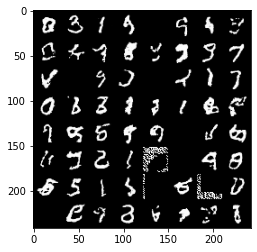

Epoch: [307/500]) Negative Log-Likelihood: -3687.544921875
Epoch: [308/500]) Batch: [1/75] Negative Log-Likelihood: -3711.76123046875


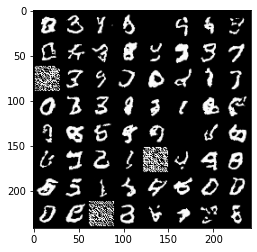

Epoch: [308/500]) Batch: [2/75] Negative Log-Likelihood: -3712.385009765625
Epoch: [308/500]) Batch: [3/75] Negative Log-Likelihood: -3714.712646484375
Epoch: [308/500]) Batch: [4/75] Negative Log-Likelihood: -3694.684326171875
Epoch: [308/500]) Batch: [5/75] Negative Log-Likelihood: -3710.664306640625
Epoch: [308/500]) Batch: [6/75] Negative Log-Likelihood: -3707.986572265625
Epoch: [308/500]) Batch: [7/75] Negative Log-Likelihood: -3699.52685546875
Epoch: [308/500]) Batch: [8/75] Negative Log-Likelihood: -3712.998779296875
Epoch: [308/500]) Batch: [9/75] Negative Log-Likelihood: -3719.620849609375
Epoch: [308/500]) Batch: [10/75] Negative Log-Likelihood: -3718.146728515625
Epoch: [308/500]) Batch: [11/75] Negative Log-Likelihood: -3714.005126953125
Epoch: [308/500]) Batch: [12/75] Negative Log-Likelihood: -3715.887451171875
Epoch: [308/500]) Batch: [13/75] Negative Log-Likelihood: -3712.1484375
Epoch: [308/500]) Batch: [14/75] Negative Log-Likelihood: -3715.147705078125
Epoch: [308/5

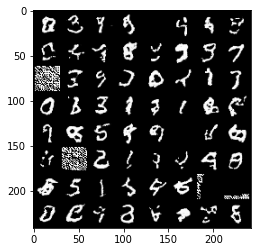

Epoch: [308/500]) Negative Log-Likelihood: -3681.86669921875
Epoch: [309/500]) Batch: [1/75] Negative Log-Likelihood: -3696.360595703125


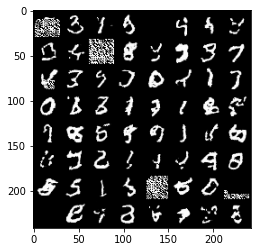

Epoch: [309/500]) Batch: [2/75] Negative Log-Likelihood: -3682.69189453125
Epoch: [309/500]) Batch: [3/75] Negative Log-Likelihood: -3703.119384765625
Epoch: [309/500]) Batch: [4/75] Negative Log-Likelihood: -3687.873779296875
Epoch: [309/500]) Batch: [5/75] Negative Log-Likelihood: -3700.9560546875
Epoch: [309/500]) Batch: [6/75] Negative Log-Likelihood: -3702.950927734375
Epoch: [309/500]) Batch: [7/75] Negative Log-Likelihood: -3693.318603515625
Epoch: [309/500]) Batch: [8/75] Negative Log-Likelihood: -3712.262451171875
Epoch: [309/500]) Batch: [9/75] Negative Log-Likelihood: -3707.607177734375
Epoch: [309/500]) Batch: [10/75] Negative Log-Likelihood: -3694.8671875
Epoch: [309/500]) Batch: [11/75] Negative Log-Likelihood: -3690.990478515625
Epoch: [309/500]) Batch: [12/75] Negative Log-Likelihood: -3698.29931640625
Epoch: [309/500]) Batch: [13/75] Negative Log-Likelihood: -3696.028076171875
Epoch: [309/500]) Batch: [14/75] Negative Log-Likelihood: -3708.88427734375
Epoch: [309/500])

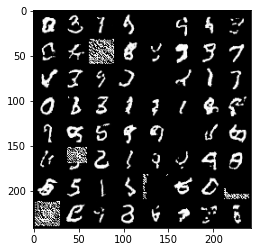

Epoch: [309/500]) Negative Log-Likelihood: -3692.619873046875
Epoch: [310/500]) Batch: [1/75] Negative Log-Likelihood: -3714.329833984375


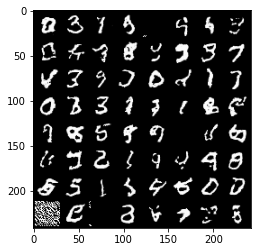

Epoch: [310/500]) Batch: [2/75] Negative Log-Likelihood: -3715.414794921875
Epoch: [310/500]) Batch: [3/75] Negative Log-Likelihood: -3724.1318359375
Epoch: [310/500]) Batch: [4/75] Negative Log-Likelihood: -3703.092529296875
Epoch: [310/500]) Batch: [5/75] Negative Log-Likelihood: -3710.8525390625
Epoch: [310/500]) Batch: [6/75] Negative Log-Likelihood: -3717.115966796875
Epoch: [310/500]) Batch: [7/75] Negative Log-Likelihood: -3701.396728515625
Epoch: [310/500]) Batch: [8/75] Negative Log-Likelihood: -3711.28369140625
Epoch: [310/500]) Batch: [9/75] Negative Log-Likelihood: -3718.152099609375
Epoch: [310/500]) Batch: [10/75] Negative Log-Likelihood: -3710.361572265625
Epoch: [310/500]) Batch: [11/75] Negative Log-Likelihood: -3714.7841796875
Epoch: [310/500]) Batch: [12/75] Negative Log-Likelihood: -3715.029296875
Epoch: [310/500]) Batch: [13/75] Negative Log-Likelihood: -3709.595458984375
Epoch: [310/500]) Batch: [14/75] Negative Log-Likelihood: -3717.685302734375
Epoch: [310/500])

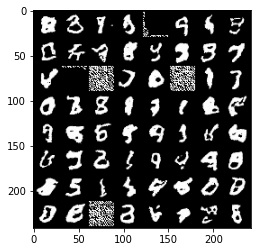

Epoch: [310/500]) Negative Log-Likelihood: -3682.25439453125
Epoch: [311/500]) Batch: [1/75] Negative Log-Likelihood: -3703.298583984375


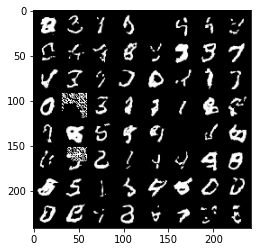

Epoch: [311/500]) Batch: [2/75] Negative Log-Likelihood: -3699.63232421875
Epoch: [311/500]) Batch: [3/75] Negative Log-Likelihood: -3710.87744140625
Epoch: [311/500]) Batch: [4/75] Negative Log-Likelihood: -3699.705810546875
Epoch: [311/500]) Batch: [5/75] Negative Log-Likelihood: -3706.693603515625
Epoch: [311/500]) Batch: [6/75] Negative Log-Likelihood: -3710.458740234375
Epoch: [311/500]) Batch: [7/75] Negative Log-Likelihood: -3702.709228515625
Epoch: [311/500]) Batch: [8/75] Negative Log-Likelihood: -3711.756103515625
Epoch: [311/500]) Batch: [9/75] Negative Log-Likelihood: -3723.61767578125
Epoch: [311/500]) Batch: [10/75] Negative Log-Likelihood: -3717.498779296875
Epoch: [311/500]) Batch: [11/75] Negative Log-Likelihood: -3715.90771484375
Epoch: [311/500]) Batch: [12/75] Negative Log-Likelihood: -3715.985107421875
Epoch: [311/500]) Batch: [13/75] Negative Log-Likelihood: -3712.40673828125
Epoch: [311/500]) Batch: [14/75] Negative Log-Likelihood: -3715.373046875
Epoch: [311/500

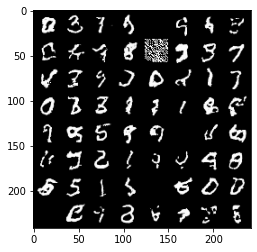

Epoch: [311/500]) Negative Log-Likelihood: -3688.575439453125
Epoch: [312/500]) Batch: [1/75] Negative Log-Likelihood: -3702.655517578125


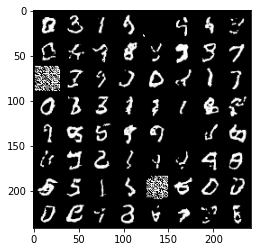

Epoch: [312/500]) Batch: [2/75] Negative Log-Likelihood: -3707.94677734375
Epoch: [312/500]) Batch: [3/75] Negative Log-Likelihood: -3715.25927734375
Epoch: [312/500]) Batch: [4/75] Negative Log-Likelihood: -3699.34423828125
Epoch: [312/500]) Batch: [5/75] Negative Log-Likelihood: -3713.485595703125
Epoch: [312/500]) Batch: [6/75] Negative Log-Likelihood: -3712.0576171875
Epoch: [312/500]) Batch: [7/75] Negative Log-Likelihood: -3704.735595703125
Epoch: [312/500]) Batch: [8/75] Negative Log-Likelihood: -3715.036865234375
Epoch: [312/500]) Batch: [9/75] Negative Log-Likelihood: -3721.76611328125
Epoch: [312/500]) Batch: [10/75] Negative Log-Likelihood: -3711.57177734375
Epoch: [312/500]) Batch: [11/75] Negative Log-Likelihood: -3718.62109375
Epoch: [312/500]) Batch: [12/75] Negative Log-Likelihood: -3709.985595703125
Epoch: [312/500]) Batch: [13/75] Negative Log-Likelihood: -3702.669677734375
Epoch: [312/500]) Batch: [14/75] Negative Log-Likelihood: -3712.267333984375
Epoch: [312/500]) 

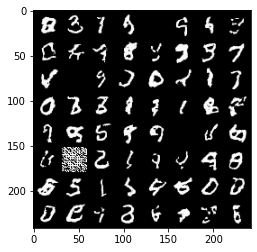

Epoch: [312/500]) Negative Log-Likelihood: -3680.842529296875
Epoch: [313/500]) Batch: [1/75] Negative Log-Likelihood: -3705.42919921875


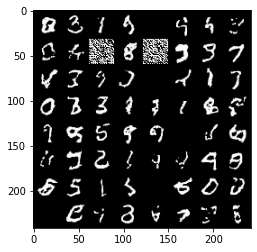

Epoch: [313/500]) Batch: [2/75] Negative Log-Likelihood: -3704.86669921875
Epoch: [313/500]) Batch: [3/75] Negative Log-Likelihood: -3716.68798828125
Epoch: [313/500]) Batch: [4/75] Negative Log-Likelihood: -3696.25439453125
Epoch: [313/500]) Batch: [5/75] Negative Log-Likelihood: -3708.010498046875
Epoch: [313/500]) Batch: [6/75] Negative Log-Likelihood: -3713.6650390625
Epoch: [313/500]) Batch: [7/75] Negative Log-Likelihood: -3701.353271484375
Epoch: [313/500]) Batch: [8/75] Negative Log-Likelihood: -3710.980224609375
Epoch: [313/500]) Batch: [9/75] Negative Log-Likelihood: -3721.2724609375
Epoch: [313/500]) Batch: [10/75] Negative Log-Likelihood: -3715.669677734375
Epoch: [313/500]) Batch: [11/75] Negative Log-Likelihood: -3715.992919921875
Epoch: [313/500]) Batch: [12/75] Negative Log-Likelihood: -3716.09814453125
Epoch: [313/500]) Batch: [13/75] Negative Log-Likelihood: -3698.9853515625
Epoch: [313/500]) Batch: [14/75] Negative Log-Likelihood: -3719.661376953125
Epoch: [313/500])

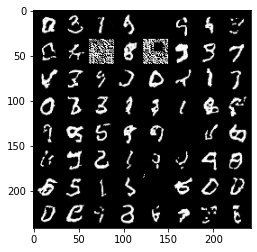

Epoch: [313/500]) Negative Log-Likelihood: -3686.363037109375
Epoch: [314/500]) Batch: [1/75] Negative Log-Likelihood: -3705.35546875


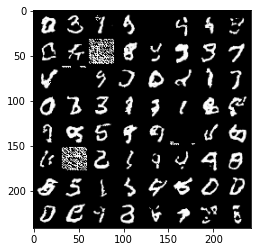

Epoch: [314/500]) Batch: [2/75] Negative Log-Likelihood: -3712.29052734375
Epoch: [314/500]) Batch: [3/75] Negative Log-Likelihood: -3715.3466796875
Epoch: [314/500]) Batch: [4/75] Negative Log-Likelihood: -3699.842529296875
Epoch: [314/500]) Batch: [5/75] Negative Log-Likelihood: -3712.6474609375
Epoch: [314/500]) Batch: [6/75] Negative Log-Likelihood: -3715.23046875
Epoch: [314/500]) Batch: [7/75] Negative Log-Likelihood: -3703.865966796875
Epoch: [314/500]) Batch: [8/75] Negative Log-Likelihood: -3712.10302734375
Epoch: [314/500]) Batch: [9/75] Negative Log-Likelihood: -3722.37109375
Epoch: [314/500]) Batch: [10/75] Negative Log-Likelihood: -3718.82958984375
Epoch: [314/500]) Batch: [11/75] Negative Log-Likelihood: -3717.976806640625
Epoch: [314/500]) Batch: [12/75] Negative Log-Likelihood: -3712.718017578125
Epoch: [314/500]) Batch: [13/75] Negative Log-Likelihood: -3710.746826171875
Epoch: [314/500]) Batch: [14/75] Negative Log-Likelihood: -3713.001220703125
Epoch: [314/500]) Batc

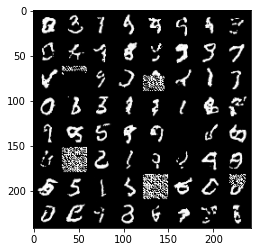

Epoch: [314/500]) Negative Log-Likelihood: -3687.54736328125
Epoch: [315/500]) Batch: [1/75] Negative Log-Likelihood: -3704.718017578125


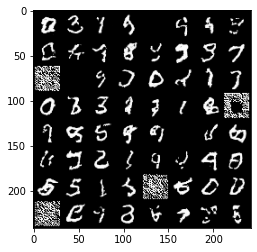

Epoch: [315/500]) Batch: [2/75] Negative Log-Likelihood: -3709.705810546875
Epoch: [315/500]) Batch: [3/75] Negative Log-Likelihood: -3713.04931640625
Epoch: [315/500]) Batch: [4/75] Negative Log-Likelihood: -3700.611083984375
Epoch: [315/500]) Batch: [5/75] Negative Log-Likelihood: -3712.5048828125
Epoch: [315/500]) Batch: [6/75] Negative Log-Likelihood: -3712.219970703125
Epoch: [315/500]) Batch: [7/75] Negative Log-Likelihood: -3701.93896484375
Epoch: [315/500]) Batch: [8/75] Negative Log-Likelihood: -3716.615478515625
Epoch: [315/500]) Batch: [9/75] Negative Log-Likelihood: -3724.453857421875
Epoch: [315/500]) Batch: [10/75] Negative Log-Likelihood: -3717.966064453125
Epoch: [315/500]) Batch: [11/75] Negative Log-Likelihood: -3710.835205078125
Epoch: [315/500]) Batch: [12/75] Negative Log-Likelihood: -3714.59375
Epoch: [315/500]) Batch: [13/75] Negative Log-Likelihood: -3706.963623046875
Epoch: [315/500]) Batch: [14/75] Negative Log-Likelihood: -3715.927734375
Epoch: [315/500]) Bat

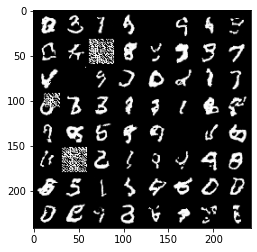

Epoch: [315/500]) Negative Log-Likelihood: -3685.740478515625
Epoch: [316/500]) Batch: [1/75] Negative Log-Likelihood: -3706.263916015625


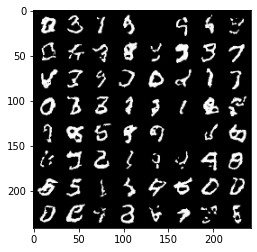

Epoch: [316/500]) Batch: [2/75] Negative Log-Likelihood: -3702.0029296875
Epoch: [316/500]) Batch: [3/75] Negative Log-Likelihood: -3714.50927734375
Epoch: [316/500]) Batch: [4/75] Negative Log-Likelihood: -3692.703125
Epoch: [316/500]) Batch: [5/75] Negative Log-Likelihood: -3681.87548828125
Epoch: [316/500]) Batch: [6/75] Negative Log-Likelihood: -3693.29150390625
Epoch: [316/500]) Batch: [7/75] Negative Log-Likelihood: -3692.98681640625
Epoch: [316/500]) Batch: [8/75] Negative Log-Likelihood: -3702.222412109375
Epoch: [316/500]) Batch: [9/75] Negative Log-Likelihood: -3713.527099609375
Epoch: [316/500]) Batch: [10/75] Negative Log-Likelihood: -3706.137451171875
Epoch: [316/500]) Batch: [11/75] Negative Log-Likelihood: -3709.273681640625
Epoch: [316/500]) Batch: [12/75] Negative Log-Likelihood: -3704.736083984375
Epoch: [316/500]) Batch: [13/75] Negative Log-Likelihood: -3697.06201171875
Epoch: [316/500]) Batch: [14/75] Negative Log-Likelihood: -3700.64453125
Epoch: [316/500]) Batch:

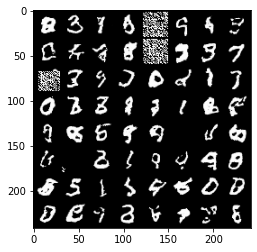

Epoch: [316/500]) Negative Log-Likelihood: -3689.260009765625
Epoch: [317/500]) Batch: [1/75] Negative Log-Likelihood: -3709.869873046875


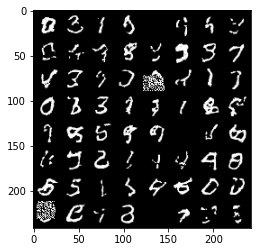

Epoch: [317/500]) Batch: [2/75] Negative Log-Likelihood: -3707.377197265625
Epoch: [317/500]) Batch: [3/75] Negative Log-Likelihood: -3716.02294921875
Epoch: [317/500]) Batch: [4/75] Negative Log-Likelihood: -3704.822509765625
Epoch: [317/500]) Batch: [5/75] Negative Log-Likelihood: -3714.669921875
Epoch: [317/500]) Batch: [6/75] Negative Log-Likelihood: -3714.742431640625
Epoch: [317/500]) Batch: [7/75] Negative Log-Likelihood: -3699.7529296875
Epoch: [317/500]) Batch: [8/75] Negative Log-Likelihood: -3705.114990234375
Epoch: [317/500]) Batch: [9/75] Negative Log-Likelihood: -3717.2080078125
Epoch: [317/500]) Batch: [10/75] Negative Log-Likelihood: -3718.869873046875
Epoch: [317/500]) Batch: [11/75] Negative Log-Likelihood: -3718.512451171875
Epoch: [317/500]) Batch: [12/75] Negative Log-Likelihood: -3717.21435546875
Epoch: [317/500]) Batch: [13/75] Negative Log-Likelihood: -3711.33056640625
Epoch: [317/500]) Batch: [14/75] Negative Log-Likelihood: -3720.310791015625
Epoch: [317/500])

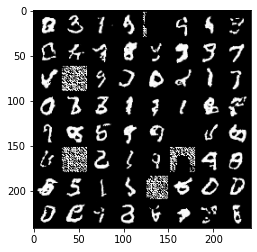

Epoch: [317/500]) Negative Log-Likelihood: -3691.1181640625
Epoch: [318/500]) Batch: [1/75] Negative Log-Likelihood: -3711.58544921875


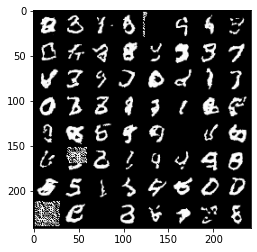

Epoch: [318/500]) Batch: [2/75] Negative Log-Likelihood: -3709.00048828125
Epoch: [318/500]) Batch: [3/75] Negative Log-Likelihood: -3718.314208984375
Epoch: [318/500]) Batch: [4/75] Negative Log-Likelihood: -3698.89990234375
Epoch: [318/500]) Batch: [5/75] Negative Log-Likelihood: -3701.5283203125
Epoch: [318/500]) Batch: [6/75] Negative Log-Likelihood: -3696.21337890625
Epoch: [318/500]) Batch: [7/75] Negative Log-Likelihood: -3692.970458984375
Epoch: [318/500]) Batch: [8/75] Negative Log-Likelihood: -3712.571533203125
Epoch: [318/500]) Batch: [9/75] Negative Log-Likelihood: -3715.925537109375
Epoch: [318/500]) Batch: [10/75] Negative Log-Likelihood: -3710.299560546875
Epoch: [318/500]) Batch: [11/75] Negative Log-Likelihood: -3714.796875
Epoch: [318/500]) Batch: [12/75] Negative Log-Likelihood: -3703.6943359375
Epoch: [318/500]) Batch: [13/75] Negative Log-Likelihood: -3708.6337890625
Epoch: [318/500]) Batch: [14/75] Negative Log-Likelihood: -3708.538330078125
Epoch: [318/500]) Batc

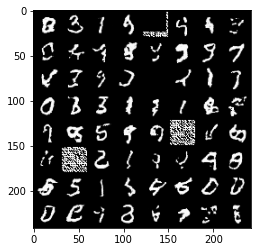

Epoch: [318/500]) Negative Log-Likelihood: -3685.640625
Epoch: [319/500]) Batch: [1/75] Negative Log-Likelihood: -3697.505615234375


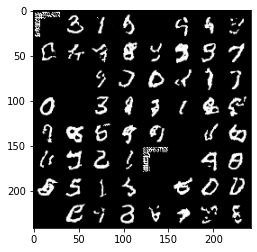

Epoch: [319/500]) Batch: [2/75] Negative Log-Likelihood: -3697.037109375
Epoch: [319/500]) Batch: [3/75] Negative Log-Likelihood: -3710.2021484375
Epoch: [319/500]) Batch: [4/75] Negative Log-Likelihood: -3697.8203125
Epoch: [319/500]) Batch: [5/75] Negative Log-Likelihood: -3710.3525390625
Epoch: [319/500]) Batch: [6/75] Negative Log-Likelihood: -3710.341064453125
Epoch: [319/500]) Batch: [7/75] Negative Log-Likelihood: -3701.30908203125
Epoch: [319/500]) Batch: [8/75] Negative Log-Likelihood: -3711.16357421875
Epoch: [319/500]) Batch: [9/75] Negative Log-Likelihood: -3723.330810546875
Epoch: [319/500]) Batch: [10/75] Negative Log-Likelihood: -3714.86962890625
Epoch: [319/500]) Batch: [11/75] Negative Log-Likelihood: -3714.14794921875
Epoch: [319/500]) Batch: [12/75] Negative Log-Likelihood: -3712.660888671875
Epoch: [319/500]) Batch: [13/75] Negative Log-Likelihood: -3707.708251953125
Epoch: [319/500]) Batch: [14/75] Negative Log-Likelihood: -3716.317626953125
Epoch: [319/500]) Batch

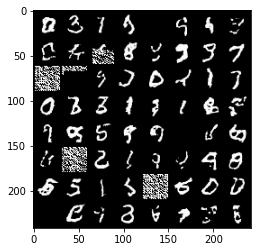

Epoch: [319/500]) Negative Log-Likelihood: -3695.1787109375
Epoch: [320/500]) Batch: [1/75] Negative Log-Likelihood: -3713.324951171875


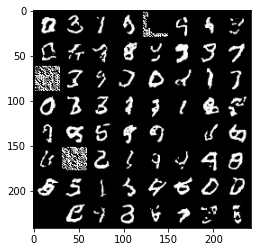

Epoch: [320/500]) Batch: [2/75] Negative Log-Likelihood: -3713.9755859375
Epoch: [320/500]) Batch: [3/75] Negative Log-Likelihood: -3721.206787109375
Epoch: [320/500]) Batch: [4/75] Negative Log-Likelihood: -3705.697998046875
Epoch: [320/500]) Batch: [5/75] Negative Log-Likelihood: -3717.610595703125
Epoch: [320/500]) Batch: [6/75] Negative Log-Likelihood: -3717.030517578125
Epoch: [320/500]) Batch: [7/75] Negative Log-Likelihood: -3709.70654296875
Epoch: [320/500]) Batch: [8/75] Negative Log-Likelihood: -3722.53125
Epoch: [320/500]) Batch: [9/75] Negative Log-Likelihood: -3723.50927734375
Epoch: [320/500]) Batch: [10/75] Negative Log-Likelihood: -3719.779296875
Epoch: [320/500]) Batch: [11/75] Negative Log-Likelihood: -3721.201416015625
Epoch: [320/500]) Batch: [12/75] Negative Log-Likelihood: -3718.310546875
Epoch: [320/500]) Batch: [13/75] Negative Log-Likelihood: -3713.4140625
Epoch: [320/500]) Batch: [14/75] Negative Log-Likelihood: -3719.099609375
Epoch: [320/500]) Batch: [15/75]

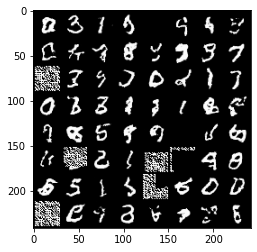

Epoch: [320/500]) Negative Log-Likelihood: -3693.984619140625
Epoch: [321/500]) Batch: [1/75] Negative Log-Likelihood: -3716.071533203125


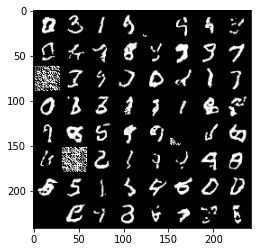

Epoch: [321/500]) Batch: [2/75] Negative Log-Likelihood: -3706.621826171875
Epoch: [321/500]) Batch: [3/75] Negative Log-Likelihood: -3706.045654296875
Epoch: [321/500]) Batch: [4/75] Negative Log-Likelihood: -3696.82080078125
Epoch: [321/500]) Batch: [5/75] Negative Log-Likelihood: -3711.08056640625
Epoch: [321/500]) Batch: [6/75] Negative Log-Likelihood: -3709.846435546875
Epoch: [321/500]) Batch: [7/75] Negative Log-Likelihood: -3702.839599609375
Epoch: [321/500]) Batch: [8/75] Negative Log-Likelihood: -3712.26806640625
Epoch: [321/500]) Batch: [9/75] Negative Log-Likelihood: -3724.710205078125
Epoch: [321/500]) Batch: [10/75] Negative Log-Likelihood: -3719.4267578125
Epoch: [321/500]) Batch: [11/75] Negative Log-Likelihood: -3717.621826171875
Epoch: [321/500]) Batch: [12/75] Negative Log-Likelihood: -3716.690185546875
Epoch: [321/500]) Batch: [13/75] Negative Log-Likelihood: -3710.865234375
Epoch: [321/500]) Batch: [14/75] Negative Log-Likelihood: -3720.39111328125
Epoch: [321/500]

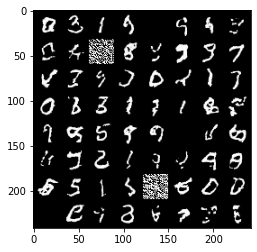

Epoch: [321/500]) Negative Log-Likelihood: -3690.579345703125
Epoch: [322/500]) Batch: [1/75] Negative Log-Likelihood: -3703.439208984375


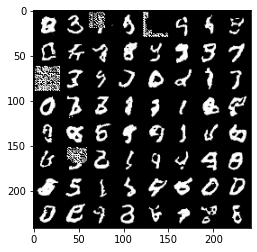

Epoch: [322/500]) Batch: [2/75] Negative Log-Likelihood: -3704.04736328125
Epoch: [322/500]) Batch: [3/75] Negative Log-Likelihood: -3714.060546875
Epoch: [322/500]) Batch: [4/75] Negative Log-Likelihood: -3701.170654296875
Epoch: [322/500]) Batch: [5/75] Negative Log-Likelihood: -3706.405029296875
Epoch: [322/500]) Batch: [6/75] Negative Log-Likelihood: -3699.716552734375
Epoch: [322/500]) Batch: [7/75] Negative Log-Likelihood: -3696.349365234375
Epoch: [322/500]) Batch: [8/75] Negative Log-Likelihood: -3712.889404296875
Epoch: [322/500]) Batch: [9/75] Negative Log-Likelihood: -3723.3076171875
Epoch: [322/500]) Batch: [10/75] Negative Log-Likelihood: -3714.428466796875
Epoch: [322/500]) Batch: [11/75] Negative Log-Likelihood: -3706.4609375
Epoch: [322/500]) Batch: [12/75] Negative Log-Likelihood: -3712.302490234375
Epoch: [322/500]) Batch: [13/75] Negative Log-Likelihood: -3708.732177734375
Epoch: [322/500]) Batch: [14/75] Negative Log-Likelihood: -3717.881103515625
Epoch: [322/500]) 

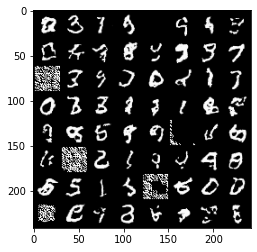

Epoch: [322/500]) Negative Log-Likelihood: -3686.06982421875
Epoch: [323/500]) Batch: [1/75] Negative Log-Likelihood: -3710.2578125


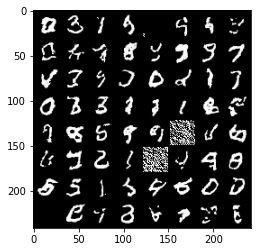

Epoch: [323/500]) Batch: [2/75] Negative Log-Likelihood: -3703.48876953125
Epoch: [323/500]) Batch: [3/75] Negative Log-Likelihood: -3721.12060546875
Epoch: [323/500]) Batch: [4/75] Negative Log-Likelihood: -3699.904296875
Epoch: [323/500]) Batch: [5/75] Negative Log-Likelihood: -3714.703125
Epoch: [323/500]) Batch: [6/75] Negative Log-Likelihood: -3713.27001953125
Epoch: [323/500]) Batch: [7/75] Negative Log-Likelihood: -3698.192626953125
Epoch: [323/500]) Batch: [8/75] Negative Log-Likelihood: -3716.98876953125
Epoch: [323/500]) Batch: [9/75] Negative Log-Likelihood: -3721.6474609375
Epoch: [323/500]) Batch: [10/75] Negative Log-Likelihood: -3719.049072265625
Epoch: [323/500]) Batch: [11/75] Negative Log-Likelihood: -3712.33935546875
Epoch: [323/500]) Batch: [12/75] Negative Log-Likelihood: -3716.400634765625
Epoch: [323/500]) Batch: [13/75] Negative Log-Likelihood: -3710.73486328125
Epoch: [323/500]) Batch: [14/75] Negative Log-Likelihood: -3713.529296875
Epoch: [323/500]) Batch: [1

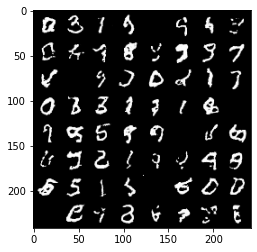

Epoch: [323/500]) Negative Log-Likelihood: -3697.842529296875
Epoch: [324/500]) Batch: [1/75] Negative Log-Likelihood: -3709.165771484375


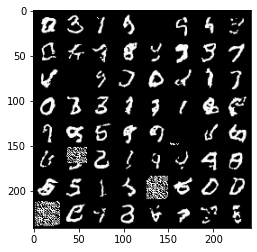

Epoch: [324/500]) Batch: [2/75] Negative Log-Likelihood: -3714.605224609375
Epoch: [324/500]) Batch: [3/75] Negative Log-Likelihood: -3718.631103515625
Epoch: [324/500]) Batch: [4/75] Negative Log-Likelihood: -3702.880859375
Epoch: [324/500]) Batch: [5/75] Negative Log-Likelihood: -3715.048095703125
Epoch: [324/500]) Batch: [6/75] Negative Log-Likelihood: -3714.519287109375
Epoch: [324/500]) Batch: [7/75] Negative Log-Likelihood: -3707.810546875
Epoch: [324/500]) Batch: [8/75] Negative Log-Likelihood: -3716.439208984375
Epoch: [324/500]) Batch: [9/75] Negative Log-Likelihood: -3728.6318359375
Epoch: [324/500]) Batch: [10/75] Negative Log-Likelihood: -3713.889892578125
Epoch: [324/500]) Batch: [11/75] Negative Log-Likelihood: -3713.767822265625
Epoch: [324/500]) Batch: [12/75] Negative Log-Likelihood: -3711.506103515625
Epoch: [324/500]) Batch: [13/75] Negative Log-Likelihood: -3700.675537109375
Epoch: [324/500]) Batch: [14/75] Negative Log-Likelihood: -3708.04736328125
Epoch: [324/500]

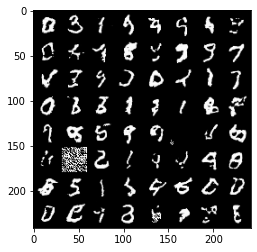

Epoch: [324/500]) Negative Log-Likelihood: -3690.63525390625
Epoch: [325/500]) Batch: [1/75] Negative Log-Likelihood: -3705.697509765625


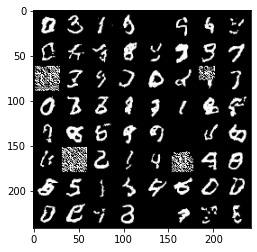

Epoch: [325/500]) Batch: [2/75] Negative Log-Likelihood: -3709.234375
Epoch: [325/500]) Batch: [3/75] Negative Log-Likelihood: -3701.783447265625
Epoch: [325/500]) Batch: [4/75] Negative Log-Likelihood: -3679.858154296875
Epoch: [325/500]) Batch: [5/75] Negative Log-Likelihood: -3701.95751953125
Epoch: [325/500]) Batch: [6/75] Negative Log-Likelihood: -3698.939208984375
Epoch: [325/500]) Batch: [7/75] Negative Log-Likelihood: -3697.80126953125
Epoch: [325/500]) Batch: [8/75] Negative Log-Likelihood: -3705.84716796875
Epoch: [325/500]) Batch: [9/75] Negative Log-Likelihood: -3703.43701171875
Epoch: [325/500]) Batch: [10/75] Negative Log-Likelihood: -3703.412841796875
Epoch: [325/500]) Batch: [11/75] Negative Log-Likelihood: -3707.94677734375
Epoch: [325/500]) Batch: [12/75] Negative Log-Likelihood: -3706.9150390625
Epoch: [325/500]) Batch: [13/75] Negative Log-Likelihood: -3702.3203125
Epoch: [325/500]) Batch: [14/75] Negative Log-Likelihood: -3709.617431640625
Epoch: [325/500]) Batch: 

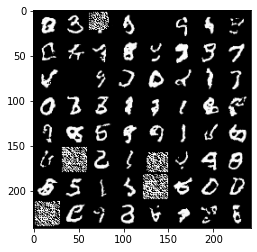

Epoch: [325/500]) Negative Log-Likelihood: -3694.92333984375
Epoch: [326/500]) Batch: [1/75] Negative Log-Likelihood: -3712.363037109375


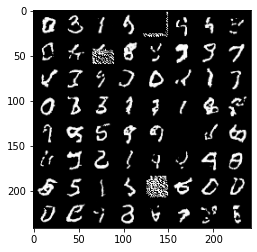

Epoch: [326/500]) Batch: [2/75] Negative Log-Likelihood: -3718.0625
Epoch: [326/500]) Batch: [3/75] Negative Log-Likelihood: -3717.306884765625
Epoch: [326/500]) Batch: [4/75] Negative Log-Likelihood: -3700.55419921875
Epoch: [326/500]) Batch: [5/75] Negative Log-Likelihood: -3714.669189453125
Epoch: [326/500]) Batch: [6/75] Negative Log-Likelihood: -3710.89306640625
Epoch: [326/500]) Batch: [7/75] Negative Log-Likelihood: -3707.109375
Epoch: [326/500]) Batch: [8/75] Negative Log-Likelihood: -3715.1611328125
Epoch: [326/500]) Batch: [9/75] Negative Log-Likelihood: -3720.259033203125
Epoch: [326/500]) Batch: [10/75] Negative Log-Likelihood: -3716.076171875
Epoch: [326/500]) Batch: [11/75] Negative Log-Likelihood: -3717.943603515625
Epoch: [326/500]) Batch: [12/75] Negative Log-Likelihood: -3715.056884765625
Epoch: [326/500]) Batch: [13/75] Negative Log-Likelihood: -3709.61181640625
Epoch: [326/500]) Batch: [14/75] Negative Log-Likelihood: -3715.6455078125
Epoch: [326/500]) Batch: [15/75

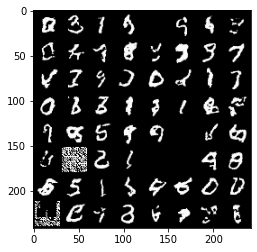

Epoch: [326/500]) Negative Log-Likelihood: -3685.669921875
Epoch: [327/500]) Batch: [1/75] Negative Log-Likelihood: -3707.361083984375


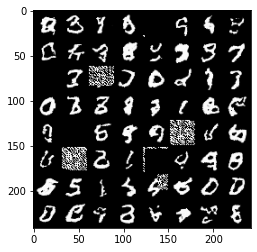

Epoch: [327/500]) Batch: [2/75] Negative Log-Likelihood: -3702.122314453125
Epoch: [327/500]) Batch: [3/75] Negative Log-Likelihood: -3709.983154296875
Epoch: [327/500]) Batch: [4/75] Negative Log-Likelihood: -3698.4560546875
Epoch: [327/500]) Batch: [5/75] Negative Log-Likelihood: -3708.253662109375
Epoch: [327/500]) Batch: [6/75] Negative Log-Likelihood: -3707.234375
Epoch: [327/500]) Batch: [7/75] Negative Log-Likelihood: -3700.439697265625
Epoch: [327/500]) Batch: [8/75] Negative Log-Likelihood: -3712.724853515625
Epoch: [327/500]) Batch: [9/75] Negative Log-Likelihood: -3724.0849609375
Epoch: [327/500]) Batch: [10/75] Negative Log-Likelihood: -3715.86865234375
Epoch: [327/500]) Batch: [11/75] Negative Log-Likelihood: -3714.59033203125
Epoch: [327/500]) Batch: [12/75] Negative Log-Likelihood: -3715.727783203125
Epoch: [327/500]) Batch: [13/75] Negative Log-Likelihood: -3705.40185546875
Epoch: [327/500]) Batch: [14/75] Negative Log-Likelihood: -3709.4775390625
Epoch: [327/500]) Batc

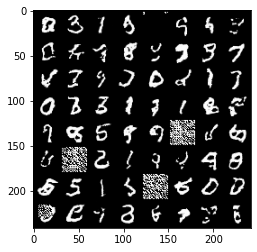

Epoch: [327/500]) Negative Log-Likelihood: -3690.42919921875
Epoch: [328/500]) Batch: [1/75] Negative Log-Likelihood: -3711.688720703125


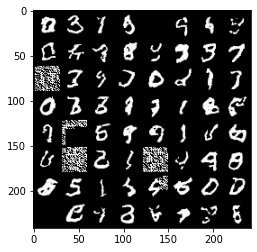

Epoch: [328/500]) Batch: [2/75] Negative Log-Likelihood: -3710.2080078125
Epoch: [328/500]) Batch: [3/75] Negative Log-Likelihood: -3718.27490234375
Epoch: [328/500]) Batch: [4/75] Negative Log-Likelihood: -3695.048095703125
Epoch: [328/500]) Batch: [5/75] Negative Log-Likelihood: -3709.22314453125
Epoch: [328/500]) Batch: [6/75] Negative Log-Likelihood: -3697.177490234375
Epoch: [328/500]) Batch: [7/75] Negative Log-Likelihood: -3697.052001953125
Epoch: [328/500]) Batch: [8/75] Negative Log-Likelihood: -3713.255126953125
Epoch: [328/500]) Batch: [9/75] Negative Log-Likelihood: -3718.891357421875
Epoch: [328/500]) Batch: [10/75] Negative Log-Likelihood: -3711.85205078125
Epoch: [328/500]) Batch: [11/75] Negative Log-Likelihood: -3714.317138671875
Epoch: [328/500]) Batch: [12/75] Negative Log-Likelihood: -3706.16748046875
Epoch: [328/500]) Batch: [13/75] Negative Log-Likelihood: -3705.779296875
Epoch: [328/500]) Batch: [14/75] Negative Log-Likelihood: -3712.65966796875
Epoch: [328/500])

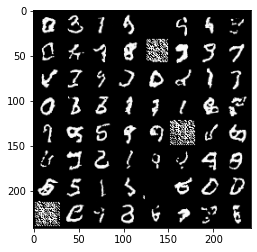

Epoch: [328/500]) Negative Log-Likelihood: -3686.03369140625
Epoch: [329/500]) Batch: [1/75] Negative Log-Likelihood: -3702.790283203125


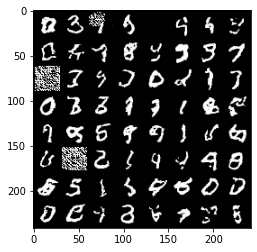

Epoch: [329/500]) Batch: [2/75] Negative Log-Likelihood: -3706.181884765625
Epoch: [329/500]) Batch: [3/75] Negative Log-Likelihood: -3717.214599609375
Epoch: [329/500]) Batch: [4/75] Negative Log-Likelihood: -3701.227783203125
Epoch: [329/500]) Batch: [5/75] Negative Log-Likelihood: -3706.944091796875
Epoch: [329/500]) Batch: [6/75] Negative Log-Likelihood: -3709.293701171875
Epoch: [329/500]) Batch: [7/75] Negative Log-Likelihood: -3702.686279296875
Epoch: [329/500]) Batch: [8/75] Negative Log-Likelihood: -3709.419189453125
Epoch: [329/500]) Batch: [9/75] Negative Log-Likelihood: -3721.119384765625
Epoch: [329/500]) Batch: [10/75] Negative Log-Likelihood: -3713.98828125
Epoch: [329/500]) Batch: [11/75] Negative Log-Likelihood: -3708.741455078125
Epoch: [329/500]) Batch: [12/75] Negative Log-Likelihood: -3704.46533203125
Epoch: [329/500]) Batch: [13/75] Negative Log-Likelihood: -3700.2236328125
Epoch: [329/500]) Batch: [14/75] Negative Log-Likelihood: -3714.67138671875
Epoch: [329/500

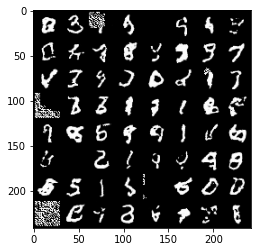

Epoch: [329/500]) Negative Log-Likelihood: -3684.623779296875
Epoch: [330/500]) Batch: [1/75] Negative Log-Likelihood: -3701.85107421875


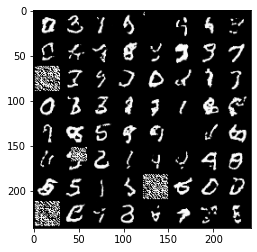

Epoch: [330/500]) Batch: [2/75] Negative Log-Likelihood: -3698.016845703125
Epoch: [330/500]) Batch: [3/75] Negative Log-Likelihood: -3704.33740234375
Epoch: [330/500]) Batch: [4/75] Negative Log-Likelihood: -3686.97802734375
Epoch: [330/500]) Batch: [5/75] Negative Log-Likelihood: -3705.18017578125
Epoch: [330/500]) Batch: [6/75] Negative Log-Likelihood: -3709.99462890625
Epoch: [330/500]) Batch: [7/75] Negative Log-Likelihood: -3698.911865234375
Epoch: [330/500]) Batch: [8/75] Negative Log-Likelihood: -3710.317626953125
Epoch: [330/500]) Batch: [9/75] Negative Log-Likelihood: -3722.423095703125
Epoch: [330/500]) Batch: [10/75] Negative Log-Likelihood: -3720.532958984375
Epoch: [330/500]) Batch: [11/75] Negative Log-Likelihood: -3716.664794921875
Epoch: [330/500]) Batch: [12/75] Negative Log-Likelihood: -3710.603759765625
Epoch: [330/500]) Batch: [13/75] Negative Log-Likelihood: -3707.51611328125
Epoch: [330/500]) Batch: [14/75] Negative Log-Likelihood: -3717.965576171875
Epoch: [330/

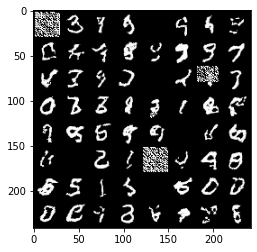

Epoch: [330/500]) Negative Log-Likelihood: -3678.68310546875
Epoch: [331/500]) Batch: [1/75] Negative Log-Likelihood: -3690.6611328125


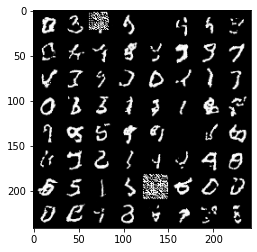

Epoch: [331/500]) Batch: [2/75] Negative Log-Likelihood: -3691.017333984375
Epoch: [331/500]) Batch: [3/75] Negative Log-Likelihood: -3698.97802734375
Epoch: [331/500]) Batch: [4/75] Negative Log-Likelihood: -3692.920166015625
Epoch: [331/500]) Batch: [5/75] Negative Log-Likelihood: -3701.61376953125
Epoch: [331/500]) Batch: [6/75] Negative Log-Likelihood: -3697.269287109375
Epoch: [331/500]) Batch: [7/75] Negative Log-Likelihood: -3690.526123046875
Epoch: [331/500]) Batch: [8/75] Negative Log-Likelihood: -3697.66357421875
Epoch: [331/500]) Batch: [9/75] Negative Log-Likelihood: -3715.869384765625
Epoch: [331/500]) Batch: [10/75] Negative Log-Likelihood: -3711.903564453125
Epoch: [331/500]) Batch: [11/75] Negative Log-Likelihood: -3707.851806640625
Epoch: [331/500]) Batch: [12/75] Negative Log-Likelihood: -3713.369873046875
Epoch: [331/500]) Batch: [13/75] Negative Log-Likelihood: -3700.86865234375
Epoch: [331/500]) Batch: [14/75] Negative Log-Likelihood: -3714.203125
Epoch: [331/500])

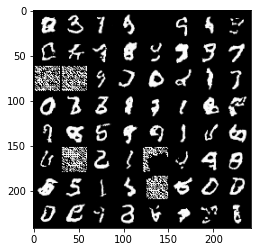

Epoch: [331/500]) Negative Log-Likelihood: -3697.0966796875
Epoch: [332/500]) Batch: [1/75] Negative Log-Likelihood: -3713.7939453125


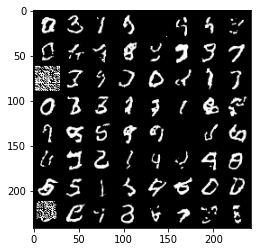

Epoch: [332/500]) Batch: [2/75] Negative Log-Likelihood: -3714.990234375
Epoch: [332/500]) Batch: [3/75] Negative Log-Likelihood: -3724.941162109375
Epoch: [332/500]) Batch: [4/75] Negative Log-Likelihood: -3701.17431640625
Epoch: [332/500]) Batch: [5/75] Negative Log-Likelihood: -3713.6044921875
Epoch: [332/500]) Batch: [6/75] Negative Log-Likelihood: -3715.561767578125
Epoch: [332/500]) Batch: [7/75] Negative Log-Likelihood: -3698.494384765625
Epoch: [332/500]) Batch: [8/75] Negative Log-Likelihood: -3709.11376953125
Epoch: [332/500]) Batch: [9/75] Negative Log-Likelihood: -3726.642333984375
Epoch: [332/500]) Batch: [10/75] Negative Log-Likelihood: -3721.625244140625
Epoch: [332/500]) Batch: [11/75] Negative Log-Likelihood: -3716.71435546875
Epoch: [332/500]) Batch: [12/75] Negative Log-Likelihood: -3718.51708984375
Epoch: [332/500]) Batch: [13/75] Negative Log-Likelihood: -3713.8642578125
Epoch: [332/500]) Batch: [14/75] Negative Log-Likelihood: -3714.197998046875
Epoch: [332/500]) 

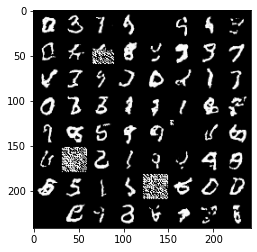

Epoch: [332/500]) Negative Log-Likelihood: -3695.03564453125
Epoch: [333/500]) Batch: [1/75] Negative Log-Likelihood: -3711.056884765625


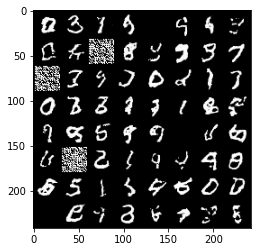

Epoch: [333/500]) Batch: [2/75] Negative Log-Likelihood: -3714.998046875
Epoch: [333/500]) Batch: [3/75] Negative Log-Likelihood: -3722.113037109375
Epoch: [333/500]) Batch: [4/75] Negative Log-Likelihood: -3705.00732421875
Epoch: [333/500]) Batch: [5/75] Negative Log-Likelihood: -3712.818359375
Epoch: [333/500]) Batch: [6/75] Negative Log-Likelihood: -3709.500244140625
Epoch: [333/500]) Batch: [7/75] Negative Log-Likelihood: -3704.40673828125
Epoch: [333/500]) Batch: [8/75] Negative Log-Likelihood: -3716.69189453125
Epoch: [333/500]) Batch: [9/75] Negative Log-Likelihood: -3723.711669921875
Epoch: [333/500]) Batch: [10/75] Negative Log-Likelihood: -3722.336181640625
Epoch: [333/500]) Batch: [11/75] Negative Log-Likelihood: -3717.177490234375
Epoch: [333/500]) Batch: [12/75] Negative Log-Likelihood: -3712.369384765625
Epoch: [333/500]) Batch: [13/75] Negative Log-Likelihood: -3711.260009765625
Epoch: [333/500]) Batch: [14/75] Negative Log-Likelihood: -3723.267333984375
Epoch: [333/500]

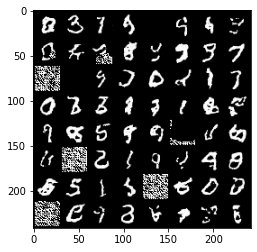

Epoch: [333/500]) Negative Log-Likelihood: -3687.817138671875
Epoch: [334/500]) Batch: [1/75] Negative Log-Likelihood: -3715.041259765625


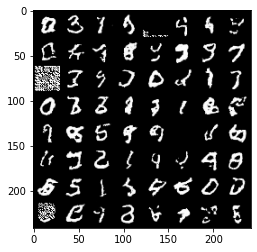

Epoch: [334/500]) Batch: [2/75] Negative Log-Likelihood: -3715.010498046875
Epoch: [334/500]) Batch: [3/75] Negative Log-Likelihood: -3722.266845703125
Epoch: [334/500]) Batch: [4/75] Negative Log-Likelihood: -3708.327392578125
Epoch: [334/500]) Batch: [5/75] Negative Log-Likelihood: -3716.458740234375
Epoch: [334/500]) Batch: [6/75] Negative Log-Likelihood: -3716.526123046875
Epoch: [334/500]) Batch: [7/75] Negative Log-Likelihood: -3709.753662109375
Epoch: [334/500]) Batch: [8/75] Negative Log-Likelihood: -3715.756591796875
Epoch: [334/500]) Batch: [9/75] Negative Log-Likelihood: -3727.64111328125
Epoch: [334/500]) Batch: [10/75] Negative Log-Likelihood: -3718.696533203125
Epoch: [334/500]) Batch: [11/75] Negative Log-Likelihood: -3722.178955078125
Epoch: [334/500]) Batch: [12/75] Negative Log-Likelihood: -3719.4580078125
Epoch: [334/500]) Batch: [13/75] Negative Log-Likelihood: -3712.338134765625
Epoch: [334/500]) Batch: [14/75] Negative Log-Likelihood: -3722.72021484375
Epoch: [334

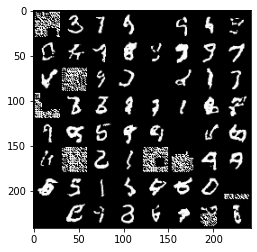

Epoch: [334/500]) Negative Log-Likelihood: -3679.891845703125
Epoch: [335/500]) Batch: [1/75] Negative Log-Likelihood: -3699.017333984375


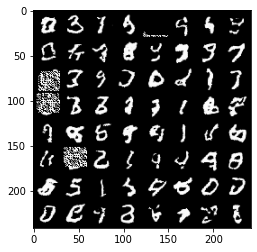

Epoch: [335/500]) Batch: [2/75] Negative Log-Likelihood: -3682.99462890625
Epoch: [335/500]) Batch: [3/75] Negative Log-Likelihood: -3689.35205078125
Epoch: [335/500]) Batch: [4/75] Negative Log-Likelihood: -3688.05859375
Epoch: [335/500]) Batch: [5/75] Negative Log-Likelihood: -3702.3056640625
Epoch: [335/500]) Batch: [6/75] Negative Log-Likelihood: -3701.122314453125
Epoch: [335/500]) Batch: [7/75] Negative Log-Likelihood: -3694.65625
Epoch: [335/500]) Batch: [8/75] Negative Log-Likelihood: -3710.224853515625
Epoch: [335/500]) Batch: [9/75] Negative Log-Likelihood: -3716.224365234375
Epoch: [335/500]) Batch: [10/75] Negative Log-Likelihood: -3699.89990234375
Epoch: [335/500]) Batch: [11/75] Negative Log-Likelihood: -3696.863037109375
Epoch: [335/500]) Batch: [12/75] Negative Log-Likelihood: -3704.873779296875
Epoch: [335/500]) Batch: [13/75] Negative Log-Likelihood: -3704.37890625
Epoch: [335/500]) Batch: [14/75] Negative Log-Likelihood: -3713.44677734375
Epoch: [335/500]) Batch: [15

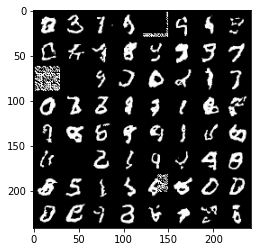

Epoch: [335/500]) Negative Log-Likelihood: -3679.872314453125
Epoch: [336/500]) Batch: [1/75] Negative Log-Likelihood: -3704.030029296875


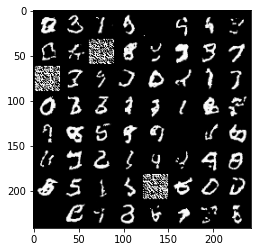

Epoch: [336/500]) Batch: [2/75] Negative Log-Likelihood: -3697.239990234375
Epoch: [336/500]) Batch: [3/75] Negative Log-Likelihood: -3712.335205078125
Epoch: [336/500]) Batch: [4/75] Negative Log-Likelihood: -3696.391845703125
Epoch: [336/500]) Batch: [5/75] Negative Log-Likelihood: -3704.077392578125
Epoch: [336/500]) Batch: [6/75] Negative Log-Likelihood: -3696.499267578125
Epoch: [336/500]) Batch: [7/75] Negative Log-Likelihood: -3695.041259765625
Epoch: [336/500]) Batch: [8/75] Negative Log-Likelihood: -3713.123779296875
Epoch: [336/500]) Batch: [9/75] Negative Log-Likelihood: -3716.450439453125
Epoch: [336/500]) Batch: [10/75] Negative Log-Likelihood: -3708.368896484375
Epoch: [336/500]) Batch: [11/75] Negative Log-Likelihood: -3711.09619140625
Epoch: [336/500]) Batch: [12/75] Negative Log-Likelihood: -3712.528564453125
Epoch: [336/500]) Batch: [13/75] Negative Log-Likelihood: -3710.322509765625
Epoch: [336/500]) Batch: [14/75] Negative Log-Likelihood: -3714.77685546875
Epoch: [3

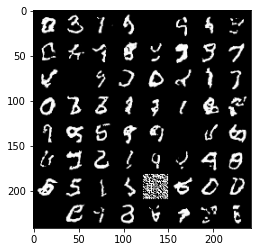

Epoch: [336/500]) Negative Log-Likelihood: -3691.673095703125
Epoch: [337/500]) Batch: [1/75] Negative Log-Likelihood: -3712.869384765625


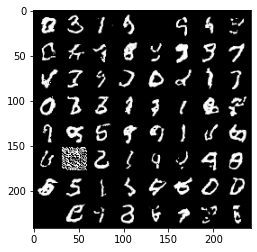

Epoch: [337/500]) Batch: [2/75] Negative Log-Likelihood: -3713.7138671875
Epoch: [337/500]) Batch: [3/75] Negative Log-Likelihood: -3720.177734375
Epoch: [337/500]) Batch: [4/75] Negative Log-Likelihood: -3705.216064453125
Epoch: [337/500]) Batch: [5/75] Negative Log-Likelihood: -3714.798095703125
Epoch: [337/500]) Batch: [6/75] Negative Log-Likelihood: -3714.79345703125
Epoch: [337/500]) Batch: [7/75] Negative Log-Likelihood: -3707.71875
Epoch: [337/500]) Batch: [8/75] Negative Log-Likelihood: -3719.445556640625
Epoch: [337/500]) Batch: [9/75] Negative Log-Likelihood: -3728.38623046875
Epoch: [337/500]) Batch: [10/75] Negative Log-Likelihood: -3722.10595703125
Epoch: [337/500]) Batch: [11/75] Negative Log-Likelihood: -3725.8740234375
Epoch: [337/500]) Batch: [12/75] Negative Log-Likelihood: -3721.5263671875
Epoch: [337/500]) Batch: [13/75] Negative Log-Likelihood: -3718.591796875
Epoch: [337/500]) Batch: [14/75] Negative Log-Likelihood: -3718.47021484375
Epoch: [337/500]) Batch: [15/7

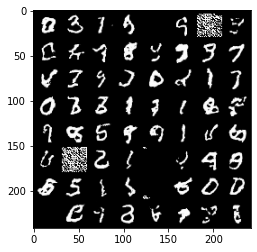

Epoch: [337/500]) Negative Log-Likelihood: -3696.8125
Epoch: [338/500]) Batch: [1/75] Negative Log-Likelihood: -3715.8095703125


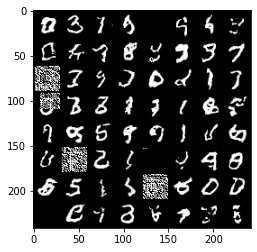

Epoch: [338/500]) Batch: [2/75] Negative Log-Likelihood: -3718.60888671875
Epoch: [338/500]) Batch: [3/75] Negative Log-Likelihood: -3721.1787109375
Epoch: [338/500]) Batch: [4/75] Negative Log-Likelihood: -3707.76904296875
Epoch: [338/500]) Batch: [5/75] Negative Log-Likelihood: -3713.74609375
Epoch: [338/500]) Batch: [6/75] Negative Log-Likelihood: -3707.191162109375
Epoch: [338/500]) Batch: [7/75] Negative Log-Likelihood: -3709.82861328125
Epoch: [338/500]) Batch: [8/75] Negative Log-Likelihood: -3717.133056640625
Epoch: [338/500]) Batch: [9/75] Negative Log-Likelihood: -3722.81982421875
Epoch: [338/500]) Batch: [10/75] Negative Log-Likelihood: -3722.610595703125
Epoch: [338/500]) Batch: [11/75] Negative Log-Likelihood: -3713.11181640625
Epoch: [338/500]) Batch: [12/75] Negative Log-Likelihood: -3710.6171875
Epoch: [338/500]) Batch: [13/75] Negative Log-Likelihood: -3708.236572265625
Epoch: [338/500]) Batch: [14/75] Negative Log-Likelihood: -3718.22265625
Epoch: [338/500]) Batch: [1

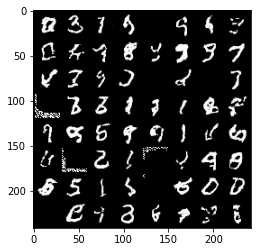

Epoch: [338/500]) Negative Log-Likelihood: -3689.21484375
Epoch: [339/500]) Batch: [1/75] Negative Log-Likelihood: -3715.224853515625


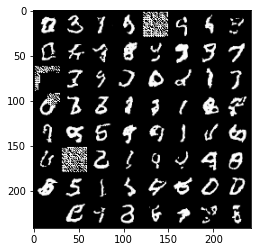

Epoch: [339/500]) Batch: [2/75] Negative Log-Likelihood: -3710.6630859375
Epoch: [339/500]) Batch: [3/75] Negative Log-Likelihood: -3714.3818359375
Epoch: [339/500]) Batch: [4/75] Negative Log-Likelihood: -3707.40869140625
Epoch: [339/500]) Batch: [5/75] Negative Log-Likelihood: -3710.4169921875
Epoch: [339/500]) Batch: [6/75] Negative Log-Likelihood: -3703.935546875
Epoch: [339/500]) Batch: [7/75] Negative Log-Likelihood: -3704.926513671875
Epoch: [339/500]) Batch: [8/75] Negative Log-Likelihood: -3718.09423828125
Epoch: [339/500]) Batch: [9/75] Negative Log-Likelihood: -3719.380859375
Epoch: [339/500]) Batch: [10/75] Negative Log-Likelihood: -3712.1787109375
Epoch: [339/500]) Batch: [11/75] Negative Log-Likelihood: -3713.060302734375
Epoch: [339/500]) Batch: [12/75] Negative Log-Likelihood: -3714.295654296875
Epoch: [339/500]) Batch: [13/75] Negative Log-Likelihood: -3703.58740234375
Epoch: [339/500]) Batch: [14/75] Negative Log-Likelihood: -3710.26611328125
Epoch: [339/500]) Batch: 

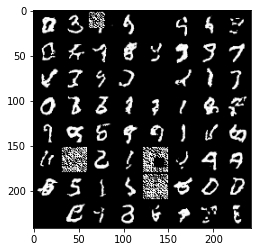

Epoch: [339/500]) Negative Log-Likelihood: -3691.416259765625
Epoch: [340/500]) Batch: [1/75] Negative Log-Likelihood: -3709.9599609375


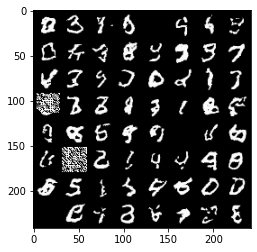

Epoch: [340/500]) Batch: [2/75] Negative Log-Likelihood: -3711.517333984375
Epoch: [340/500]) Batch: [3/75] Negative Log-Likelihood: -3717.031982421875
Epoch: [340/500]) Batch: [4/75] Negative Log-Likelihood: -3704.6982421875
Epoch: [340/500]) Batch: [5/75] Negative Log-Likelihood: -3715.9326171875
Epoch: [340/500]) Batch: [6/75] Negative Log-Likelihood: -3715.466552734375
Epoch: [340/500]) Batch: [7/75] Negative Log-Likelihood: -3708.022216796875
Epoch: [340/500]) Batch: [8/75] Negative Log-Likelihood: -3719.485595703125
Epoch: [340/500]) Batch: [9/75] Negative Log-Likelihood: -3727.674072265625
Epoch: [340/500]) Batch: [10/75] Negative Log-Likelihood: -3718.4921875
Epoch: [340/500]) Batch: [11/75] Negative Log-Likelihood: -3717.045654296875
Epoch: [340/500]) Batch: [12/75] Negative Log-Likelihood: -3715.278076171875
Epoch: [340/500]) Batch: [13/75] Negative Log-Likelihood: -3709.54931640625
Epoch: [340/500]) Batch: [14/75] Negative Log-Likelihood: -3718.65234375
Epoch: [340/500]) Bat

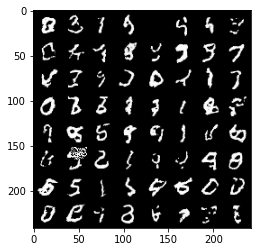

Epoch: [340/500]) Negative Log-Likelihood: -3680.3974609375
Epoch: [341/500]) Batch: [1/75] Negative Log-Likelihood: -3703.733642578125


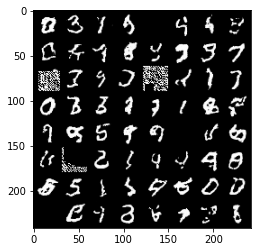

Epoch: [341/500]) Batch: [2/75] Negative Log-Likelihood: -3705.73095703125
Epoch: [341/500]) Batch: [3/75] Negative Log-Likelihood: -3714.123779296875
Epoch: [341/500]) Batch: [4/75] Negative Log-Likelihood: -3696.656494140625
Epoch: [341/500]) Batch: [5/75] Negative Log-Likelihood: -3710.213134765625
Epoch: [341/500]) Batch: [6/75] Negative Log-Likelihood: -3709.495849609375
Epoch: [341/500]) Batch: [7/75] Negative Log-Likelihood: -3691.354248046875
Epoch: [341/500]) Batch: [8/75] Negative Log-Likelihood: -3712.1357421875
Epoch: [341/500]) Batch: [9/75] Negative Log-Likelihood: -3715.56689453125
Epoch: [341/500]) Batch: [10/75] Negative Log-Likelihood: -3713.181884765625
Epoch: [341/500]) Batch: [11/75] Negative Log-Likelihood: -3718.9287109375
Epoch: [341/500]) Batch: [12/75] Negative Log-Likelihood: -3706.9873046875
Epoch: [341/500]) Batch: [13/75] Negative Log-Likelihood: -3693.720458984375
Epoch: [341/500]) Batch: [14/75] Negative Log-Likelihood: -3699.30615234375
Epoch: [341/500]

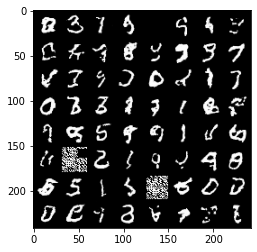

Epoch: [341/500]) Negative Log-Likelihood: -3693.99169921875
Epoch: [342/500]) Batch: [1/75] Negative Log-Likelihood: -3711.22314453125


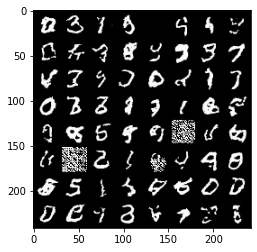

Epoch: [342/500]) Batch: [2/75] Negative Log-Likelihood: -3710.546142578125
Epoch: [342/500]) Batch: [3/75] Negative Log-Likelihood: -3713.55419921875
Epoch: [342/500]) Batch: [4/75] Negative Log-Likelihood: -3696.284912109375
Epoch: [342/500]) Batch: [5/75] Negative Log-Likelihood: -3712.365234375
Epoch: [342/500]) Batch: [6/75] Negative Log-Likelihood: -3700.876220703125
Epoch: [342/500]) Batch: [7/75] Negative Log-Likelihood: -3702.663330078125
Epoch: [342/500]) Batch: [8/75] Negative Log-Likelihood: -3716.390869140625
Epoch: [342/500]) Batch: [9/75] Negative Log-Likelihood: -3719.47314453125
Epoch: [342/500]) Batch: [10/75] Negative Log-Likelihood: -3712.646728515625
Epoch: [342/500]) Batch: [11/75] Negative Log-Likelihood: -3717.811767578125
Epoch: [342/500]) Batch: [12/75] Negative Log-Likelihood: -3709.235595703125
Epoch: [342/500]) Batch: [13/75] Negative Log-Likelihood: -3700.3369140625
Epoch: [342/500]) Batch: [14/75] Negative Log-Likelihood: -3710.814208984375
Epoch: [342/50

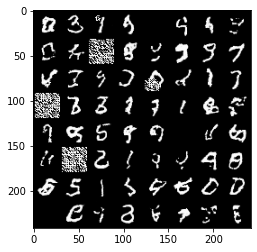

Epoch: [342/500]) Negative Log-Likelihood: -3674.397705078125
Epoch: [343/500]) Batch: [1/75] Negative Log-Likelihood: -3701.0595703125


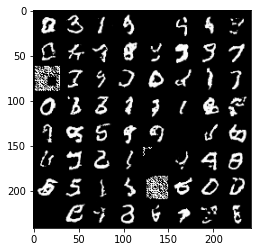

Epoch: [343/500]) Batch: [2/75] Negative Log-Likelihood: -3707.71484375
Epoch: [343/500]) Batch: [3/75] Negative Log-Likelihood: -3707.865966796875
Epoch: [343/500]) Batch: [4/75] Negative Log-Likelihood: -3685.697998046875
Epoch: [343/500]) Batch: [5/75] Negative Log-Likelihood: -3703.403564453125
Epoch: [343/500]) Batch: [6/75] Negative Log-Likelihood: -3710.87939453125
Epoch: [343/500]) Batch: [7/75] Negative Log-Likelihood: -3700.03857421875
Epoch: [343/500]) Batch: [8/75] Negative Log-Likelihood: -3706.429931640625
Epoch: [343/500]) Batch: [9/75] Negative Log-Likelihood: -3718.943359375
Epoch: [343/500]) Batch: [10/75] Negative Log-Likelihood: -3717.341064453125
Epoch: [343/500]) Batch: [11/75] Negative Log-Likelihood: -3714.615966796875
Epoch: [343/500]) Batch: [12/75] Negative Log-Likelihood: -3713.392333984375
Epoch: [343/500]) Batch: [13/75] Negative Log-Likelihood: -3709.71923828125
Epoch: [343/500]) Batch: [14/75] Negative Log-Likelihood: -3716.196044921875
Epoch: [343/500])

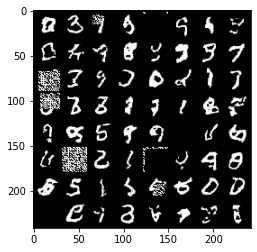

Epoch: [343/500]) Negative Log-Likelihood: -3690.72314453125
Epoch: [344/500]) Batch: [1/75] Negative Log-Likelihood: -3703.559814453125


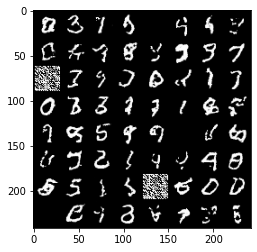

Epoch: [344/500]) Batch: [2/75] Negative Log-Likelihood: -3700.126708984375
Epoch: [344/500]) Batch: [3/75] Negative Log-Likelihood: -3711.596435546875
Epoch: [344/500]) Batch: [4/75] Negative Log-Likelihood: -3702.79931640625
Epoch: [344/500]) Batch: [5/75] Negative Log-Likelihood: -3707.362060546875
Epoch: [344/500]) Batch: [6/75] Negative Log-Likelihood: -3700.4736328125
Epoch: [344/500]) Batch: [7/75] Negative Log-Likelihood: -3700.09375
Epoch: [344/500]) Batch: [8/75] Negative Log-Likelihood: -3714.87451171875
Epoch: [344/500]) Batch: [9/75] Negative Log-Likelihood: -3718.838623046875
Epoch: [344/500]) Batch: [10/75] Negative Log-Likelihood: -3714.1787109375
Epoch: [344/500]) Batch: [11/75] Negative Log-Likelihood: -3721.270751953125
Epoch: [344/500]) Batch: [12/75] Negative Log-Likelihood: -3718.89990234375
Epoch: [344/500]) Batch: [13/75] Negative Log-Likelihood: -3713.021728515625
Epoch: [344/500]) Batch: [14/75] Negative Log-Likelihood: -3718.591552734375
Epoch: [344/500]) Bat

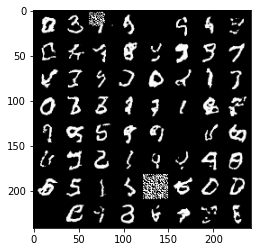

Epoch: [344/500]) Negative Log-Likelihood: -3683.185546875
Epoch: [345/500]) Batch: [1/75] Negative Log-Likelihood: -3714.100830078125


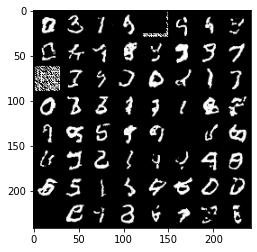

Epoch: [345/500]) Batch: [2/75] Negative Log-Likelihood: -3715.7216796875
Epoch: [345/500]) Batch: [3/75] Negative Log-Likelihood: -3722.501708984375
Epoch: [345/500]) Batch: [4/75] Negative Log-Likelihood: -3705.1904296875
Epoch: [345/500]) Batch: [5/75] Negative Log-Likelihood: -3720.017333984375
Epoch: [345/500]) Batch: [6/75] Negative Log-Likelihood: -3714.481201171875
Epoch: [345/500]) Batch: [7/75] Negative Log-Likelihood: -3704.32861328125
Epoch: [345/500]) Batch: [8/75] Negative Log-Likelihood: -3716.42626953125
Epoch: [345/500]) Batch: [9/75] Negative Log-Likelihood: -3725.177490234375
Epoch: [345/500]) Batch: [10/75] Negative Log-Likelihood: -3721.863037109375
Epoch: [345/500]) Batch: [11/75] Negative Log-Likelihood: -3724.29345703125
Epoch: [345/500]) Batch: [12/75] Negative Log-Likelihood: -3720.920654296875
Epoch: [345/500]) Batch: [13/75] Negative Log-Likelihood: -3715.50390625
Epoch: [345/500]) Batch: [14/75] Negative Log-Likelihood: -3718.98876953125
Epoch: [345/500]) B

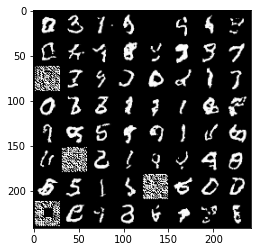

Epoch: [345/500]) Negative Log-Likelihood: -3680.771240234375
Epoch: [346/500]) Batch: [1/75] Negative Log-Likelihood: -3708.738037109375


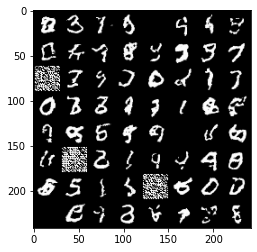

Epoch: [346/500]) Batch: [2/75] Negative Log-Likelihood: -3714.27685546875
Epoch: [346/500]) Batch: [3/75] Negative Log-Likelihood: -3714.97314453125
Epoch: [346/500]) Batch: [4/75] Negative Log-Likelihood: -3698.77001953125
Epoch: [346/500]) Batch: [5/75] Negative Log-Likelihood: -3712.66455078125
Epoch: [346/500]) Batch: [6/75] Negative Log-Likelihood: -3715.765625
Epoch: [346/500]) Batch: [7/75] Negative Log-Likelihood: -3704.329833984375
Epoch: [346/500]) Batch: [8/75] Negative Log-Likelihood: -3715.8623046875
Epoch: [346/500]) Batch: [9/75] Negative Log-Likelihood: -3725.3857421875
Epoch: [346/500]) Batch: [10/75] Negative Log-Likelihood: -3722.77734375
Epoch: [346/500]) Batch: [11/75] Negative Log-Likelihood: -3722.6298828125
Epoch: [346/500]) Batch: [12/75] Negative Log-Likelihood: -3717.7392578125
Epoch: [346/500]) Batch: [13/75] Negative Log-Likelihood: -3712.80908203125
Epoch: [346/500]) Batch: [14/75] Negative Log-Likelihood: -3710.120849609375
Epoch: [346/500]) Batch: [15/7

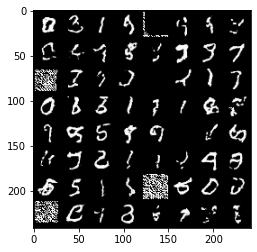

Epoch: [346/500]) Negative Log-Likelihood: -3697.059814453125
Epoch: [347/500]) Batch: [1/75] Negative Log-Likelihood: -3707.22119140625


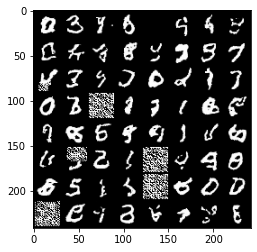

Epoch: [347/500]) Batch: [2/75] Negative Log-Likelihood: -3702.6064453125
Epoch: [347/500]) Batch: [3/75] Negative Log-Likelihood: -3711.260498046875
Epoch: [347/500]) Batch: [4/75] Negative Log-Likelihood: -3699.899658203125
Epoch: [347/500]) Batch: [5/75] Negative Log-Likelihood: -3708.889404296875
Epoch: [347/500]) Batch: [6/75] Negative Log-Likelihood: -3703.7060546875
Epoch: [347/500]) Batch: [7/75] Negative Log-Likelihood: -3703.26611328125
Epoch: [347/500]) Batch: [8/75] Negative Log-Likelihood: -3718.69677734375
Epoch: [347/500]) Batch: [9/75] Negative Log-Likelihood: -3720.981689453125
Epoch: [347/500]) Batch: [10/75] Negative Log-Likelihood: -3714.021728515625
Epoch: [347/500]) Batch: [11/75] Negative Log-Likelihood: -3719.41796875
Epoch: [347/500]) Batch: [12/75] Negative Log-Likelihood: -3718.508056640625
Epoch: [347/500]) Batch: [13/75] Negative Log-Likelihood: -3713.233154296875
Epoch: [347/500]) Batch: [14/75] Negative Log-Likelihood: -3714.39794921875
Epoch: [347/500]) 

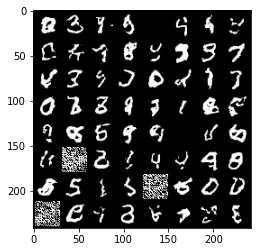

Epoch: [347/500]) Negative Log-Likelihood: -3692.560791015625
Epoch: [348/500]) Batch: [1/75] Negative Log-Likelihood: -3714.2216796875


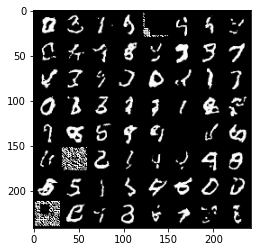

Epoch: [348/500]) Batch: [2/75] Negative Log-Likelihood: -3713.4091796875
Epoch: [348/500]) Batch: [3/75] Negative Log-Likelihood: -3722.121826171875
Epoch: [348/500]) Batch: [4/75] Negative Log-Likelihood: -3704.778564453125
Epoch: [348/500]) Batch: [5/75] Negative Log-Likelihood: -3717.0830078125
Epoch: [348/500]) Batch: [6/75] Negative Log-Likelihood: -3716.378662109375
Epoch: [348/500]) Batch: [7/75] Negative Log-Likelihood: -3712.55419921875
Epoch: [348/500]) Batch: [8/75] Negative Log-Likelihood: -3722.409912109375
Epoch: [348/500]) Batch: [9/75] Negative Log-Likelihood: -3730.43994140625
Epoch: [348/500]) Batch: [10/75] Negative Log-Likelihood: -3724.8427734375
Epoch: [348/500]) Batch: [11/75] Negative Log-Likelihood: -3725.559814453125
Epoch: [348/500]) Batch: [12/75] Negative Log-Likelihood: -3717.356689453125
Epoch: [348/500]) Batch: [13/75] Negative Log-Likelihood: -3705.67236328125
Epoch: [348/500]) Batch: [14/75] Negative Log-Likelihood: -3709.371826171875
Epoch: [348/500]

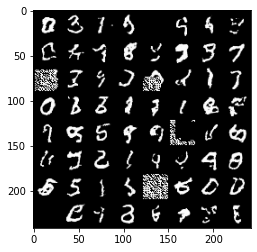

Epoch: [348/500]) Negative Log-Likelihood: -3695.14794921875
Epoch: [349/500]) Batch: [1/75] Negative Log-Likelihood: -3712.27734375


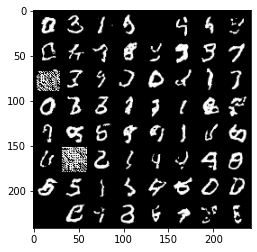

Epoch: [349/500]) Batch: [2/75] Negative Log-Likelihood: -3711.053955078125
Epoch: [349/500]) Batch: [3/75] Negative Log-Likelihood: -3714.342041015625
Epoch: [349/500]) Batch: [4/75] Negative Log-Likelihood: -3701.60302734375
Epoch: [349/500]) Batch: [5/75] Negative Log-Likelihood: -3715.496826171875
Epoch: [349/500]) Batch: [6/75] Negative Log-Likelihood: -3711.21337890625
Epoch: [349/500]) Batch: [7/75] Negative Log-Likelihood: -3707.0517578125
Epoch: [349/500]) Batch: [8/75] Negative Log-Likelihood: -3717.931884765625
Epoch: [349/500]) Batch: [9/75] Negative Log-Likelihood: -3721.438720703125
Epoch: [349/500]) Batch: [10/75] Negative Log-Likelihood: -3724.669189453125
Epoch: [349/500]) Batch: [11/75] Negative Log-Likelihood: -3719.7724609375
Epoch: [349/500]) Batch: [12/75] Negative Log-Likelihood: -3718.729248046875
Epoch: [349/500]) Batch: [13/75] Negative Log-Likelihood: -3706.763427734375
Epoch: [349/500]) Batch: [14/75] Negative Log-Likelihood: -3693.9306640625
Epoch: [349/500

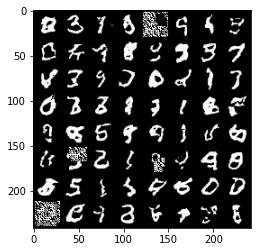

Epoch: [349/500]) Negative Log-Likelihood: -3696.80126953125
Epoch: [350/500]) Batch: [1/75] Negative Log-Likelihood: -3711.18310546875


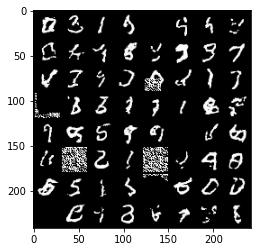

Epoch: [350/500]) Batch: [2/75] Negative Log-Likelihood: -3714.8349609375
Epoch: [350/500]) Batch: [3/75] Negative Log-Likelihood: -3722.9443359375
Epoch: [350/500]) Batch: [4/75] Negative Log-Likelihood: -3704.3310546875
Epoch: [350/500]) Batch: [5/75] Negative Log-Likelihood: -3718.11376953125
Epoch: [350/500]) Batch: [6/75] Negative Log-Likelihood: -3718.693603515625
Epoch: [350/500]) Batch: [7/75] Negative Log-Likelihood: -3710.89794921875
Epoch: [350/500]) Batch: [8/75] Negative Log-Likelihood: -3722.33056640625
Epoch: [350/500]) Batch: [9/75] Negative Log-Likelihood: -3728.079345703125
Epoch: [350/500]) Batch: [10/75] Negative Log-Likelihood: -3724.638671875
Epoch: [350/500]) Batch: [11/75] Negative Log-Likelihood: -3721.813720703125
Epoch: [350/500]) Batch: [12/75] Negative Log-Likelihood: -3721.050537109375
Epoch: [350/500]) Batch: [13/75] Negative Log-Likelihood: -3710.22265625
Epoch: [350/500]) Batch: [14/75] Negative Log-Likelihood: -3713.232421875
Epoch: [350/500]) Batch: [

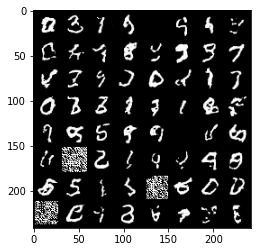

Epoch: [350/500]) Negative Log-Likelihood: -3698.37890625
Epoch: [351/500]) Batch: [1/75] Negative Log-Likelihood: -3712.184814453125


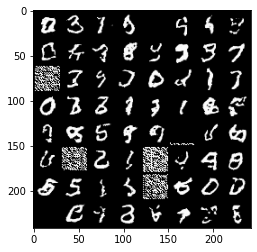

Epoch: [351/500]) Batch: [2/75] Negative Log-Likelihood: -3705.7998046875
Epoch: [351/500]) Batch: [3/75] Negative Log-Likelihood: -3713.914794921875
Epoch: [351/500]) Batch: [4/75] Negative Log-Likelihood: -3703.12158203125
Epoch: [351/500]) Batch: [5/75] Negative Log-Likelihood: -3715.803955078125
Epoch: [351/500]) Batch: [6/75] Negative Log-Likelihood: -3711.903564453125
Epoch: [351/500]) Batch: [7/75] Negative Log-Likelihood: -3696.599853515625
Epoch: [351/500]) Batch: [8/75] Negative Log-Likelihood: -3714.388671875
Epoch: [351/500]) Batch: [9/75] Negative Log-Likelihood: -3726.354248046875
Epoch: [351/500]) Batch: [10/75] Negative Log-Likelihood: -3720.01806640625
Epoch: [351/500]) Batch: [11/75] Negative Log-Likelihood: -3716.63330078125
Epoch: [351/500]) Batch: [12/75] Negative Log-Likelihood: -3718.4638671875
Epoch: [351/500]) Batch: [13/75] Negative Log-Likelihood: -3715.432373046875
Epoch: [351/500]) Batch: [14/75] Negative Log-Likelihood: -3719.53955078125
Epoch: [351/500]) 

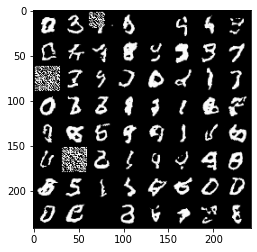

Epoch: [351/500]) Negative Log-Likelihood: -3689.731201171875
Epoch: [352/500]) Batch: [1/75] Negative Log-Likelihood: -3692.476806640625


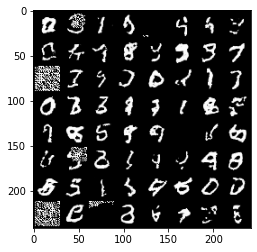

Epoch: [352/500]) Batch: [2/75] Negative Log-Likelihood: -3704.782470703125
Epoch: [352/500]) Batch: [3/75] Negative Log-Likelihood: -3715.302978515625
Epoch: [352/500]) Batch: [4/75] Negative Log-Likelihood: -3696.20654296875
Epoch: [352/500]) Batch: [5/75] Negative Log-Likelihood: -3708.16748046875
Epoch: [352/500]) Batch: [6/75] Negative Log-Likelihood: -3711.438720703125
Epoch: [352/500]) Batch: [7/75] Negative Log-Likelihood: -3700.720947265625
Epoch: [352/500]) Batch: [8/75] Negative Log-Likelihood: -3705.070556640625
Epoch: [352/500]) Batch: [9/75] Negative Log-Likelihood: -3714.017333984375
Epoch: [352/500]) Batch: [10/75] Negative Log-Likelihood: -3710.3359375
Epoch: [352/500]) Batch: [11/75] Negative Log-Likelihood: -3706.178466796875
Epoch: [352/500]) Batch: [12/75] Negative Log-Likelihood: -3703.640625
Epoch: [352/500]) Batch: [13/75] Negative Log-Likelihood: -3703.824951171875
Epoch: [352/500]) Batch: [14/75] Negative Log-Likelihood: -3711.96044921875
Epoch: [352/500]) Bat

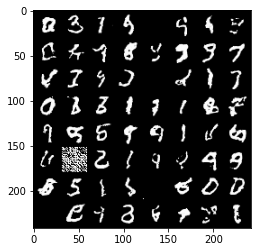

Epoch: [352/500]) Negative Log-Likelihood: -3693.7392578125
Epoch: [353/500]) Batch: [1/75] Negative Log-Likelihood: -3713.583984375


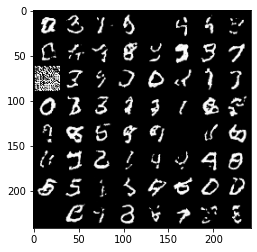

Epoch: [353/500]) Batch: [2/75] Negative Log-Likelihood: -3712.97314453125
Epoch: [353/500]) Batch: [3/75] Negative Log-Likelihood: -3723.273681640625
Epoch: [353/500]) Batch: [4/75] Negative Log-Likelihood: -3704.6552734375
Epoch: [353/500]) Batch: [5/75] Negative Log-Likelihood: -3714.843994140625
Epoch: [353/500]) Batch: [6/75] Negative Log-Likelihood: -3716.740478515625
Epoch: [353/500]) Batch: [7/75] Negative Log-Likelihood: -3712.09033203125
Epoch: [353/500]) Batch: [8/75] Negative Log-Likelihood: -3722.91748046875
Epoch: [353/500]) Batch: [9/75] Negative Log-Likelihood: -3728.64404296875
Epoch: [353/500]) Batch: [10/75] Negative Log-Likelihood: -3721.520263671875
Epoch: [353/500]) Batch: [11/75] Negative Log-Likelihood: -3722.66552734375
Epoch: [353/500]) Batch: [12/75] Negative Log-Likelihood: -3721.22265625
Epoch: [353/500]) Batch: [13/75] Negative Log-Likelihood: -3716.17431640625
Epoch: [353/500]) Batch: [14/75] Negative Log-Likelihood: -3722.16748046875
Epoch: [353/500]) Ba

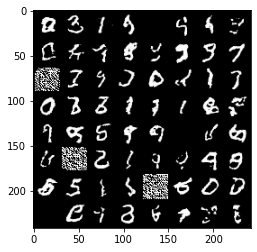

Epoch: [353/500]) Negative Log-Likelihood: -3690.367431640625
Epoch: [354/500]) Batch: [1/75] Negative Log-Likelihood: -3709.517333984375


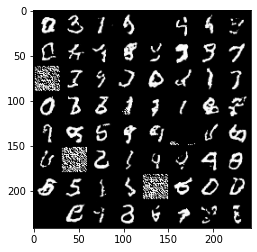

Epoch: [354/500]) Batch: [2/75] Negative Log-Likelihood: -3717.11669921875
Epoch: [354/500]) Batch: [3/75] Negative Log-Likelihood: -3721.6142578125
Epoch: [354/500]) Batch: [4/75] Negative Log-Likelihood: -3706.75390625
Epoch: [354/500]) Batch: [5/75] Negative Log-Likelihood: -3706.989013671875
Epoch: [354/500]) Batch: [6/75] Negative Log-Likelihood: -3694.750244140625
Epoch: [354/500]) Batch: [7/75] Negative Log-Likelihood: -3699.87060546875
Epoch: [354/500]) Batch: [8/75] Negative Log-Likelihood: -3711.7255859375
Epoch: [354/500]) Batch: [9/75] Negative Log-Likelihood: -3718.424560546875
Epoch: [354/500]) Batch: [10/75] Negative Log-Likelihood: -3718.0263671875
Epoch: [354/500]) Batch: [11/75] Negative Log-Likelihood: -3720.078125
Epoch: [354/500]) Batch: [12/75] Negative Log-Likelihood: -3714.847412109375
Epoch: [354/500]) Batch: [13/75] Negative Log-Likelihood: -3715.4755859375
Epoch: [354/500]) Batch: [14/75] Negative Log-Likelihood: -3721.348876953125
Epoch: [354/500]) Batch: [1

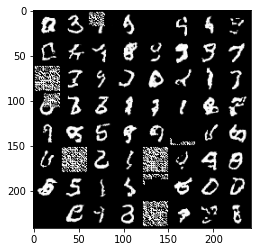

Epoch: [354/500]) Negative Log-Likelihood: -3683.70361328125
Epoch: [355/500]) Batch: [1/75] Negative Log-Likelihood: -3711.74560546875


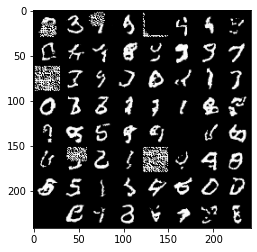

Epoch: [355/500]) Batch: [2/75] Negative Log-Likelihood: -3709.677490234375
Epoch: [355/500]) Batch: [3/75] Negative Log-Likelihood: -3707.848388671875
Epoch: [355/500]) Batch: [4/75] Negative Log-Likelihood: -3698.159912109375
Epoch: [355/500]) Batch: [5/75] Negative Log-Likelihood: -3712.8955078125
Epoch: [355/500]) Batch: [6/75] Negative Log-Likelihood: -3706.76171875
Epoch: [355/500]) Batch: [7/75] Negative Log-Likelihood: -3689.4619140625
Epoch: [355/500]) Batch: [8/75] Negative Log-Likelihood: -3710.885009765625
Epoch: [355/500]) Batch: [9/75] Negative Log-Likelihood: -3717.0693359375
Epoch: [355/500]) Batch: [10/75] Negative Log-Likelihood: -3711.7412109375
Epoch: [355/500]) Batch: [11/75] Negative Log-Likelihood: -3709.84619140625
Epoch: [355/500]) Batch: [12/75] Negative Log-Likelihood: -3708.723876953125
Epoch: [355/500]) Batch: [13/75] Negative Log-Likelihood: -3708.2109375
Epoch: [355/500]) Batch: [14/75] Negative Log-Likelihood: -3705.318603515625
Epoch: [355/500]) Batch: 

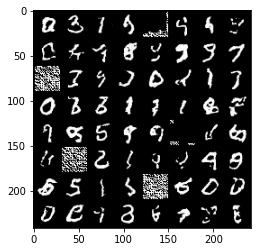

Epoch: [355/500]) Negative Log-Likelihood: -3692.0810546875
Epoch: [356/500]) Batch: [1/75] Negative Log-Likelihood: -3716.314208984375


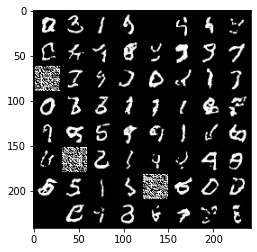

Epoch: [356/500]) Batch: [2/75] Negative Log-Likelihood: -3713.5
Epoch: [356/500]) Batch: [3/75] Negative Log-Likelihood: -3724.53173828125
Epoch: [356/500]) Batch: [4/75] Negative Log-Likelihood: -3704.887939453125
Epoch: [356/500]) Batch: [5/75] Negative Log-Likelihood: -3716.338623046875
Epoch: [356/500]) Batch: [6/75] Negative Log-Likelihood: -3721.750732421875
Epoch: [356/500]) Batch: [7/75] Negative Log-Likelihood: -3695.352783203125
Epoch: [356/500]) Batch: [8/75] Negative Log-Likelihood: -3701.44677734375
Epoch: [356/500]) Batch: [9/75] Negative Log-Likelihood: -3720.86669921875
Epoch: [356/500]) Batch: [10/75] Negative Log-Likelihood: -3719.73779296875
Epoch: [356/500]) Batch: [11/75] Negative Log-Likelihood: -3715.1943359375
Epoch: [356/500]) Batch: [12/75] Negative Log-Likelihood: -3717.803466796875
Epoch: [356/500]) Batch: [13/75] Negative Log-Likelihood: -3712.8662109375
Epoch: [356/500]) Batch: [14/75] Negative Log-Likelihood: -3716.032470703125
Epoch: [356/500]) Batch: [

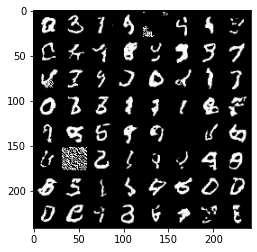

Epoch: [356/500]) Negative Log-Likelihood: -3687.724609375
Epoch: [357/500]) Batch: [1/75] Negative Log-Likelihood: -3715.278564453125


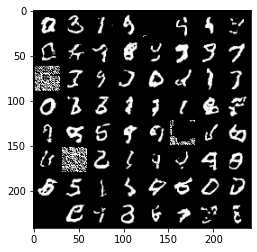

Epoch: [357/500]) Batch: [2/75] Negative Log-Likelihood: -3713.00732421875
Epoch: [357/500]) Batch: [3/75] Negative Log-Likelihood: -3711.78125
Epoch: [357/500]) Batch: [4/75] Negative Log-Likelihood: -3698.900634765625
Epoch: [357/500]) Batch: [5/75] Negative Log-Likelihood: -3714.4423828125
Epoch: [357/500]) Batch: [6/75] Negative Log-Likelihood: -3713.635498046875
Epoch: [357/500]) Batch: [7/75] Negative Log-Likelihood: -3708.15869140625
Epoch: [357/500]) Batch: [8/75] Negative Log-Likelihood: -3719.5361328125
Epoch: [357/500]) Batch: [9/75] Negative Log-Likelihood: -3722.517333984375
Epoch: [357/500]) Batch: [10/75] Negative Log-Likelihood: -3720.706787109375
Epoch: [357/500]) Batch: [11/75] Negative Log-Likelihood: -3722.19970703125
Epoch: [357/500]) Batch: [12/75] Negative Log-Likelihood: -3720.62109375
Epoch: [357/500]) Batch: [13/75] Negative Log-Likelihood: -3709.338623046875
Epoch: [357/500]) Batch: [14/75] Negative Log-Likelihood: -3708.26806640625
Epoch: [357/500]) Batch: [

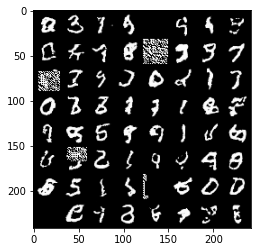

Epoch: [357/500]) Negative Log-Likelihood: -3684.778564453125
Epoch: [358/500]) Batch: [1/75] Negative Log-Likelihood: -3711.303955078125


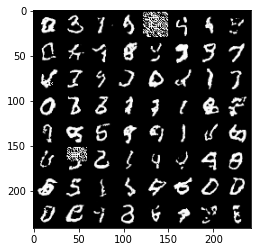

Epoch: [358/500]) Batch: [2/75] Negative Log-Likelihood: -3716.56982421875
Epoch: [358/500]) Batch: [3/75] Negative Log-Likelihood: -3718.08056640625
Epoch: [358/500]) Batch: [4/75] Negative Log-Likelihood: -3699.269287109375
Epoch: [358/500]) Batch: [5/75] Negative Log-Likelihood: -3712.08935546875
Epoch: [358/500]) Batch: [6/75] Negative Log-Likelihood: -3718.7939453125
Epoch: [358/500]) Batch: [7/75] Negative Log-Likelihood: -3704.07763671875
Epoch: [358/500]) Batch: [8/75] Negative Log-Likelihood: -3712.554931640625
Epoch: [358/500]) Batch: [9/75] Negative Log-Likelihood: -3723.23876953125
Epoch: [358/500]) Batch: [10/75] Negative Log-Likelihood: -3723.54931640625
Epoch: [358/500]) Batch: [11/75] Negative Log-Likelihood: -3721.814208984375
Epoch: [358/500]) Batch: [12/75] Negative Log-Likelihood: -3718.233642578125
Epoch: [358/500]) Batch: [13/75] Negative Log-Likelihood: -3714.013671875
Epoch: [358/500]) Batch: [14/75] Negative Log-Likelihood: -3723.0
Epoch: [358/500]) Batch: [15/

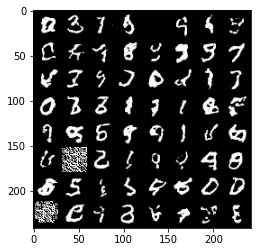

Epoch: [358/500]) Negative Log-Likelihood: -3693.910888671875
Epoch: [359/500]) Batch: [1/75] Negative Log-Likelihood: -3714.263671875


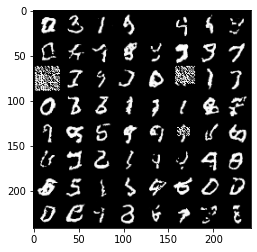

Epoch: [359/500]) Batch: [2/75] Negative Log-Likelihood: -3714.97314453125
Epoch: [359/500]) Batch: [3/75] Negative Log-Likelihood: -3721.337158203125
Epoch: [359/500]) Batch: [4/75] Negative Log-Likelihood: -3702.904296875
Epoch: [359/500]) Batch: [5/75] Negative Log-Likelihood: -3712.034912109375
Epoch: [359/500]) Batch: [6/75] Negative Log-Likelihood: -3713.723388671875
Epoch: [359/500]) Batch: [7/75] Negative Log-Likelihood: -3711.286865234375
Epoch: [359/500]) Batch: [8/75] Negative Log-Likelihood: -3715.231689453125
Epoch: [359/500]) Batch: [9/75] Negative Log-Likelihood: -3722.596435546875
Epoch: [359/500]) Batch: [10/75] Negative Log-Likelihood: -3719.5283203125
Epoch: [359/500]) Batch: [11/75] Negative Log-Likelihood: -3722.813720703125
Epoch: [359/500]) Batch: [12/75] Negative Log-Likelihood: -3721.69482421875
Epoch: [359/500]) Batch: [13/75] Negative Log-Likelihood: -3717.03564453125
Epoch: [359/500]) Batch: [14/75] Negative Log-Likelihood: -3720.841064453125
Epoch: [359/500

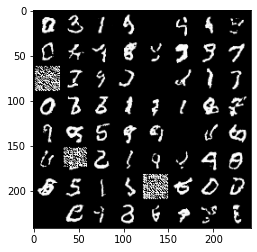

Epoch: [359/500]) Negative Log-Likelihood: -3690.75927734375
Epoch: [360/500]) Batch: [1/75] Negative Log-Likelihood: -3711.114990234375


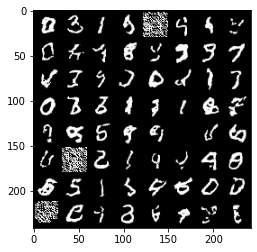

Epoch: [360/500]) Batch: [2/75] Negative Log-Likelihood: -3703.39794921875
Epoch: [360/500]) Batch: [3/75] Negative Log-Likelihood: -3711.371826171875
Epoch: [360/500]) Batch: [4/75] Negative Log-Likelihood: -3706.41796875
Epoch: [360/500]) Batch: [5/75] Negative Log-Likelihood: -3713.115478515625
Epoch: [360/500]) Batch: [6/75] Negative Log-Likelihood: -3705.66748046875
Epoch: [360/500]) Batch: [7/75] Negative Log-Likelihood: -3705.468994140625
Epoch: [360/500]) Batch: [8/75] Negative Log-Likelihood: -3721.201171875
Epoch: [360/500]) Batch: [9/75] Negative Log-Likelihood: -3722.1875
Epoch: [360/500]) Batch: [10/75] Negative Log-Likelihood: -3720.31689453125
Epoch: [360/500]) Batch: [11/75] Negative Log-Likelihood: -3727.146240234375
Epoch: [360/500]) Batch: [12/75] Negative Log-Likelihood: -3709.064208984375
Epoch: [360/500]) Batch: [13/75] Negative Log-Likelihood: -3689.907470703125
Epoch: [360/500]) Batch: [14/75] Negative Log-Likelihood: -3699.037109375
Epoch: [360/500]) Batch: [15

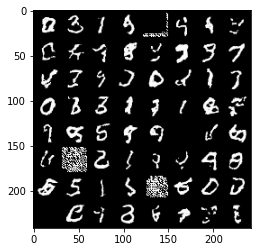

Epoch: [360/500]) Negative Log-Likelihood: -3693.564697265625
Epoch: [361/500]) Batch: [1/75] Negative Log-Likelihood: -3714.859375


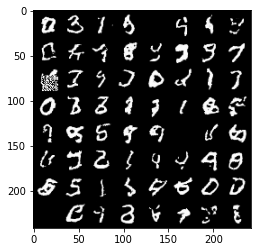

Epoch: [361/500]) Batch: [2/75] Negative Log-Likelihood: -3714.887939453125
Epoch: [361/500]) Batch: [3/75] Negative Log-Likelihood: -3722.9453125
Epoch: [361/500]) Batch: [4/75] Negative Log-Likelihood: -3707.472412109375
Epoch: [361/500]) Batch: [5/75] Negative Log-Likelihood: -3718.9130859375
Epoch: [361/500]) Batch: [6/75] Negative Log-Likelihood: -3718.5
Epoch: [361/500]) Batch: [7/75] Negative Log-Likelihood: -3709.3837890625
Epoch: [361/500]) Batch: [8/75] Negative Log-Likelihood: -3721.444580078125
Epoch: [361/500]) Batch: [9/75] Negative Log-Likelihood: -3730.7373046875
Epoch: [361/500]) Batch: [10/75] Negative Log-Likelihood: -3724.916748046875
Epoch: [361/500]) Batch: [11/75] Negative Log-Likelihood: -3721.89892578125
Epoch: [361/500]) Batch: [12/75] Negative Log-Likelihood: -3721.005126953125
Epoch: [361/500]) Batch: [13/75] Negative Log-Likelihood: -3715.80126953125
Epoch: [361/500]) Batch: [14/75] Negative Log-Likelihood: -3718.76611328125
Epoch: [361/500]) Batch: [15/75]

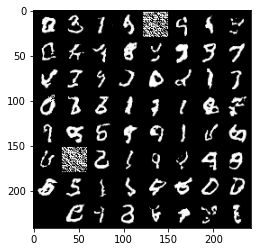

Epoch: [361/500]) Negative Log-Likelihood: -3699.544189453125
Epoch: [362/500]) Batch: [1/75] Negative Log-Likelihood: -3716.83935546875


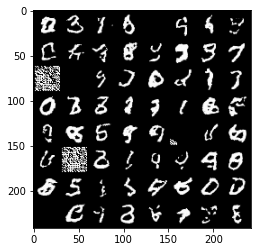

Epoch: [362/500]) Batch: [2/75] Negative Log-Likelihood: -3717.89404296875
Epoch: [362/500]) Batch: [3/75] Negative Log-Likelihood: -3722.840576171875
Epoch: [362/500]) Batch: [4/75] Negative Log-Likelihood: -3701.4736328125
Epoch: [362/500]) Batch: [5/75] Negative Log-Likelihood: -3718.93310546875
Epoch: [362/500]) Batch: [6/75] Negative Log-Likelihood: -3715.48876953125
Epoch: [362/500]) Batch: [7/75] Negative Log-Likelihood: -3711.79736328125
Epoch: [362/500]) Batch: [8/75] Negative Log-Likelihood: -3720.548583984375
Epoch: [362/500]) Batch: [9/75] Negative Log-Likelihood: -3727.519287109375
Epoch: [362/500]) Batch: [10/75] Negative Log-Likelihood: -3723.71044921875
Epoch: [362/500]) Batch: [11/75] Negative Log-Likelihood: -3727.669189453125
Epoch: [362/500]) Batch: [12/75] Negative Log-Likelihood: -3718.467041015625
Epoch: [362/500]) Batch: [13/75] Negative Log-Likelihood: -3717.04931640625
Epoch: [362/500]) Batch: [14/75] Negative Log-Likelihood: -3721.059814453125
Epoch: [362/500

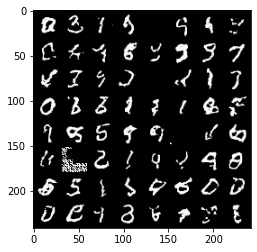

Epoch: [362/500]) Negative Log-Likelihood: -3695.47998046875
Epoch: [363/500]) Batch: [1/75] Negative Log-Likelihood: -3713.800537109375


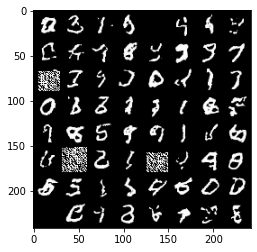

Epoch: [363/500]) Batch: [2/75] Negative Log-Likelihood: -3713.186279296875
Epoch: [363/500]) Batch: [3/75] Negative Log-Likelihood: -3723.774658203125
Epoch: [363/500]) Batch: [4/75] Negative Log-Likelihood: -3704.260498046875
Epoch: [363/500]) Batch: [5/75] Negative Log-Likelihood: -3715.526123046875
Epoch: [363/500]) Batch: [6/75] Negative Log-Likelihood: -3714.927001953125
Epoch: [363/500]) Batch: [7/75] Negative Log-Likelihood: -3708.48681640625
Epoch: [363/500]) Batch: [8/75] Negative Log-Likelihood: -3719.208740234375
Epoch: [363/500]) Batch: [9/75] Negative Log-Likelihood: -3727.27001953125
Epoch: [363/500]) Batch: [10/75] Negative Log-Likelihood: -3722.746826171875
Epoch: [363/500]) Batch: [11/75] Negative Log-Likelihood: -3726.28271484375
Epoch: [363/500]) Batch: [12/75] Negative Log-Likelihood: -3718.975341796875
Epoch: [363/500]) Batch: [13/75] Negative Log-Likelihood: -3713.552978515625
Epoch: [363/500]) Batch: [14/75] Negative Log-Likelihood: -3719.7783203125
Epoch: [363/

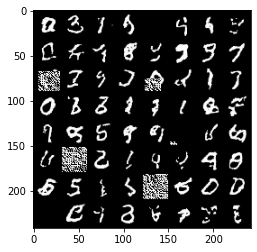

Epoch: [363/500]) Negative Log-Likelihood: -3677.76171875
Epoch: [364/500]) Batch: [1/75] Negative Log-Likelihood: -3703.6357421875


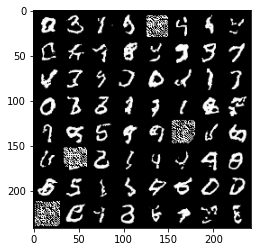

Epoch: [364/500]) Batch: [2/75] Negative Log-Likelihood: -3711.18896484375
Epoch: [364/500]) Batch: [3/75] Negative Log-Likelihood: -3717.603759765625
Epoch: [364/500]) Batch: [4/75] Negative Log-Likelihood: -3700.70263671875
Epoch: [364/500]) Batch: [5/75] Negative Log-Likelihood: -3716.214599609375
Epoch: [364/500]) Batch: [6/75] Negative Log-Likelihood: -3711.583740234375
Epoch: [364/500]) Batch: [7/75] Negative Log-Likelihood: -3704.918701171875
Epoch: [364/500]) Batch: [8/75] Negative Log-Likelihood: -3715.5029296875
Epoch: [364/500]) Batch: [9/75] Negative Log-Likelihood: -3708.7880859375
Epoch: [364/500]) Batch: [10/75] Negative Log-Likelihood: -3697.0654296875
Epoch: [364/500]) Batch: [11/75] Negative Log-Likelihood: -3703.739501953125
Epoch: [364/500]) Batch: [12/75] Negative Log-Likelihood: -3701.025634765625
Epoch: [364/500]) Batch: [13/75] Negative Log-Likelihood: -3700.07177734375
Epoch: [364/500]) Batch: [14/75] Negative Log-Likelihood: -3699.79931640625
Epoch: [364/500])

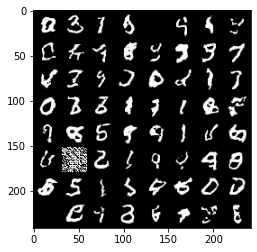

Epoch: [364/500]) Negative Log-Likelihood: -3694.671142578125
Epoch: [365/500]) Batch: [1/75] Negative Log-Likelihood: -3709.74365234375


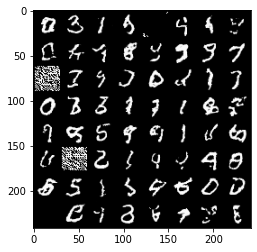

Epoch: [365/500]) Batch: [2/75] Negative Log-Likelihood: -3715.976806640625
Epoch: [365/500]) Batch: [3/75] Negative Log-Likelihood: -3716.19482421875
Epoch: [365/500]) Batch: [4/75] Negative Log-Likelihood: -3706.0244140625
Epoch: [365/500]) Batch: [5/75] Negative Log-Likelihood: -3714.53173828125
Epoch: [365/500]) Batch: [6/75] Negative Log-Likelihood: -3716.32177734375
Epoch: [365/500]) Batch: [7/75] Negative Log-Likelihood: -3710.061279296875
Epoch: [365/500]) Batch: [8/75] Negative Log-Likelihood: -3717.5986328125
Epoch: [365/500]) Batch: [9/75] Negative Log-Likelihood: -3729.71923828125
Epoch: [365/500]) Batch: [10/75] Negative Log-Likelihood: -3719.966796875
Epoch: [365/500]) Batch: [11/75] Negative Log-Likelihood: -3719.354248046875
Epoch: [365/500]) Batch: [12/75] Negative Log-Likelihood: -3719.7685546875
Epoch: [365/500]) Batch: [13/75] Negative Log-Likelihood: -3711.87939453125
Epoch: [365/500]) Batch: [14/75] Negative Log-Likelihood: -3718.52783203125
Epoch: [365/500]) Batc

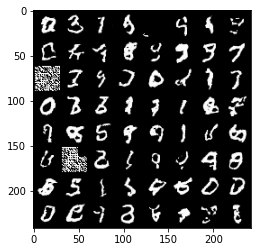

Epoch: [365/500]) Negative Log-Likelihood: -3694.5498046875
Epoch: [366/500]) Batch: [1/75] Negative Log-Likelihood: -3713.79052734375


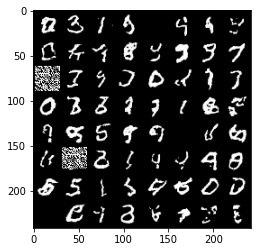

Epoch: [366/500]) Batch: [2/75] Negative Log-Likelihood: -3719.21240234375
Epoch: [366/500]) Batch: [3/75] Negative Log-Likelihood: -3700.9091796875
Epoch: [366/500]) Batch: [4/75] Negative Log-Likelihood: -3650.864013671875
Epoch: [366/500]) Batch: [5/75] Negative Log-Likelihood: -3655.615234375
Epoch: [366/500]) Batch: [6/75] Negative Log-Likelihood: -3689.691162109375
Epoch: [366/500]) Batch: [7/75] Negative Log-Likelihood: -3691.916748046875
Epoch: [366/500]) Batch: [8/75] Negative Log-Likelihood: -3692.2080078125
Epoch: [366/500]) Batch: [9/75] Negative Log-Likelihood: -3699.881591796875
Epoch: [366/500]) Batch: [10/75] Negative Log-Likelihood: -3705.4404296875
Epoch: [366/500]) Batch: [11/75] Negative Log-Likelihood: -3698.711181640625
Epoch: [366/500]) Batch: [12/75] Negative Log-Likelihood: -3701.572998046875
Epoch: [366/500]) Batch: [13/75] Negative Log-Likelihood: -3702.790283203125
Epoch: [366/500]) Batch: [14/75] Negative Log-Likelihood: -3707.6806640625
Epoch: [366/500]) B

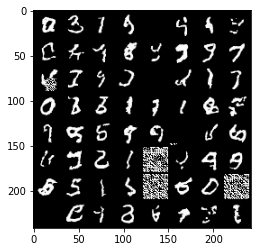

Epoch: [366/500]) Negative Log-Likelihood: -3695.18310546875
Epoch: [367/500]) Batch: [1/75] Negative Log-Likelihood: -3706.15576171875


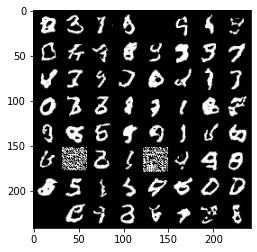

Epoch: [367/500]) Batch: [2/75] Negative Log-Likelihood: -3703.1748046875
Epoch: [367/500]) Batch: [3/75] Negative Log-Likelihood: -3718.27685546875
Epoch: [367/500]) Batch: [4/75] Negative Log-Likelihood: -3705.5068359375
Epoch: [367/500]) Batch: [5/75] Negative Log-Likelihood: -3711.938720703125
Epoch: [367/500]) Batch: [6/75] Negative Log-Likelihood: -3706.989013671875
Epoch: [367/500]) Batch: [7/75] Negative Log-Likelihood: -3702.91064453125
Epoch: [367/500]) Batch: [8/75] Negative Log-Likelihood: -3717.26953125
Epoch: [367/500]) Batch: [9/75] Negative Log-Likelihood: -3723.700927734375
Epoch: [367/500]) Batch: [10/75] Negative Log-Likelihood: -3720.4453125
Epoch: [367/500]) Batch: [11/75] Negative Log-Likelihood: -3718.12841796875
Epoch: [367/500]) Batch: [12/75] Negative Log-Likelihood: -3717.869384765625
Epoch: [367/500]) Batch: [13/75] Negative Log-Likelihood: -3712.535888671875
Epoch: [367/500]) Batch: [14/75] Negative Log-Likelihood: -3718.111083984375
Epoch: [367/500]) Batch

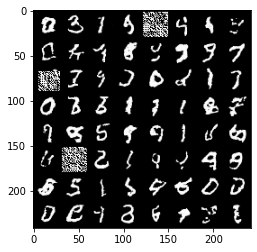

Epoch: [367/500]) Negative Log-Likelihood: -3686.414306640625
Epoch: [368/500]) Batch: [1/75] Negative Log-Likelihood: -3707.247314453125


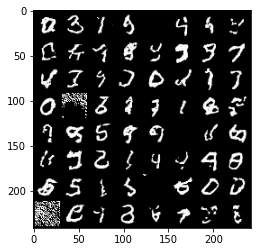

Epoch: [368/500]) Batch: [2/75] Negative Log-Likelihood: -3705.0625
Epoch: [368/500]) Batch: [3/75] Negative Log-Likelihood: -3717.389892578125
Epoch: [368/500]) Batch: [4/75] Negative Log-Likelihood: -3707.466796875
Epoch: [368/500]) Batch: [5/75] Negative Log-Likelihood: -3710.38330078125
Epoch: [368/500]) Batch: [6/75] Negative Log-Likelihood: -3706.85986328125
Epoch: [368/500]) Batch: [7/75] Negative Log-Likelihood: -3706.01513671875
Epoch: [368/500]) Batch: [8/75] Negative Log-Likelihood: -3710.98876953125
Epoch: [368/500]) Batch: [9/75] Negative Log-Likelihood: -3722.006103515625
Epoch: [368/500]) Batch: [10/75] Negative Log-Likelihood: -3720.76025390625
Epoch: [368/500]) Batch: [11/75] Negative Log-Likelihood: -3721.105224609375
Epoch: [368/500]) Batch: [12/75] Negative Log-Likelihood: -3721.371826171875
Epoch: [368/500]) Batch: [13/75] Negative Log-Likelihood: -3715.188720703125
Epoch: [368/500]) Batch: [14/75] Negative Log-Likelihood: -3715.563720703125
Epoch: [368/500]) Batch

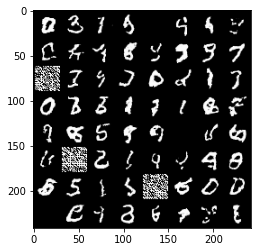

Epoch: [368/500]) Negative Log-Likelihood: -3692.3203125
Epoch: [369/500]) Batch: [1/75] Negative Log-Likelihood: -3710.072998046875


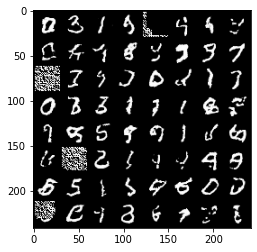

Epoch: [369/500]) Batch: [2/75] Negative Log-Likelihood: -3709.139404296875
Epoch: [369/500]) Batch: [3/75] Negative Log-Likelihood: -3718.08935546875
Epoch: [369/500]) Batch: [4/75] Negative Log-Likelihood: -3703.5009765625
Epoch: [369/500]) Batch: [5/75] Negative Log-Likelihood: -3714.954345703125
Epoch: [369/500]) Batch: [6/75] Negative Log-Likelihood: -3714.907470703125
Epoch: [369/500]) Batch: [7/75] Negative Log-Likelihood: -3704.059814453125
Epoch: [369/500]) Batch: [8/75] Negative Log-Likelihood: -3719.760498046875
Epoch: [369/500]) Batch: [9/75] Negative Log-Likelihood: -3724.12060546875
Epoch: [369/500]) Batch: [10/75] Negative Log-Likelihood: -3719.526123046875
Epoch: [369/500]) Batch: [11/75] Negative Log-Likelihood: -3722.434814453125
Epoch: [369/500]) Batch: [12/75] Negative Log-Likelihood: -3724.3330078125
Epoch: [369/500]) Batch: [13/75] Negative Log-Likelihood: -3716.10546875
Epoch: [369/500]) Batch: [14/75] Negative Log-Likelihood: -3719.349365234375
Epoch: [369/500])

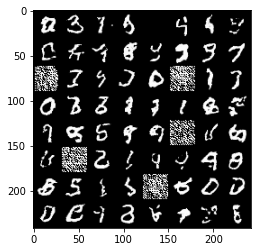

Epoch: [369/500]) Negative Log-Likelihood: -3690.7841796875
Epoch: [370/500]) Batch: [1/75] Negative Log-Likelihood: -3712.056396484375


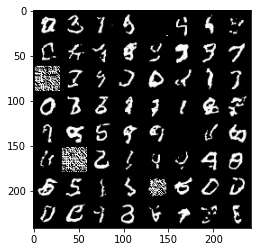

Epoch: [370/500]) Batch: [2/75] Negative Log-Likelihood: -3711.464599609375
Epoch: [370/500]) Batch: [3/75] Negative Log-Likelihood: -3716.69873046875
Epoch: [370/500]) Batch: [4/75] Negative Log-Likelihood: -3696.4775390625
Epoch: [370/500]) Batch: [5/75] Negative Log-Likelihood: -3706.016845703125
Epoch: [370/500]) Batch: [6/75] Negative Log-Likelihood: -3708.65625
Epoch: [370/500]) Batch: [7/75] Negative Log-Likelihood: -3703.55810546875
Epoch: [370/500]) Batch: [8/75] Negative Log-Likelihood: -3714.247314453125
Epoch: [370/500]) Batch: [9/75] Negative Log-Likelihood: -3722.51123046875
Epoch: [370/500]) Batch: [10/75] Negative Log-Likelihood: -3720.6484375
Epoch: [370/500]) Batch: [11/75] Negative Log-Likelihood: -3721.83154296875
Epoch: [370/500]) Batch: [12/75] Negative Log-Likelihood: -3718.381103515625
Epoch: [370/500]) Batch: [13/75] Negative Log-Likelihood: -3713.142333984375
Epoch: [370/500]) Batch: [14/75] Negative Log-Likelihood: -3721.80419921875
Epoch: [370/500]) Batch: [

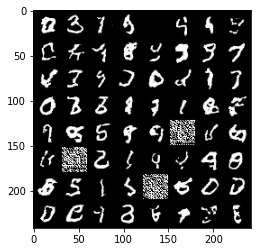

Epoch: [370/500]) Negative Log-Likelihood: -3690.1591796875
Epoch: [371/500]) Batch: [1/75] Negative Log-Likelihood: -3716.001220703125


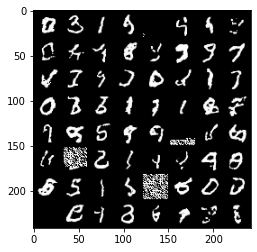

Epoch: [371/500]) Batch: [2/75] Negative Log-Likelihood: -3714.864990234375
Epoch: [371/500]) Batch: [3/75] Negative Log-Likelihood: -3720.029541015625
Epoch: [371/500]) Batch: [4/75] Negative Log-Likelihood: -3704.90185546875
Epoch: [371/500]) Batch: [5/75] Negative Log-Likelihood: -3721.975341796875
Epoch: [371/500]) Batch: [6/75] Negative Log-Likelihood: -3715.297607421875
Epoch: [371/500]) Batch: [7/75] Negative Log-Likelihood: -3702.48681640625
Epoch: [371/500]) Batch: [8/75] Negative Log-Likelihood: -3717.091064453125
Epoch: [371/500]) Batch: [9/75] Negative Log-Likelihood: -3731.4423828125
Epoch: [371/500]) Batch: [10/75] Negative Log-Likelihood: -3714.73046875
Epoch: [371/500]) Batch: [11/75] Negative Log-Likelihood: -3708.94921875
Epoch: [371/500]) Batch: [12/75] Negative Log-Likelihood: -3710.522216796875
Epoch: [371/500]) Batch: [13/75] Negative Log-Likelihood: -3714.305419921875
Epoch: [371/500]) Batch: [14/75] Negative Log-Likelihood: -3717.635498046875
Epoch: [371/500]) B

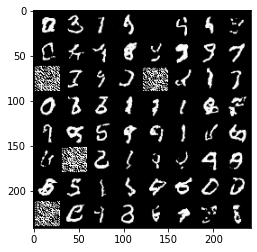

Epoch: [371/500]) Negative Log-Likelihood: -3691.3173828125
Epoch: [372/500]) Batch: [1/75] Negative Log-Likelihood: -3712.82421875


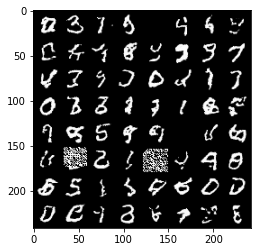

Epoch: [372/500]) Batch: [2/75] Negative Log-Likelihood: -3709.28857421875
Epoch: [372/500]) Batch: [3/75] Negative Log-Likelihood: -3720.201904296875
Epoch: [372/500]) Batch: [4/75] Negative Log-Likelihood: -3705.021728515625
Epoch: [372/500]) Batch: [5/75] Negative Log-Likelihood: -3714.4404296875
Epoch: [372/500]) Batch: [6/75] Negative Log-Likelihood: -3720.8818359375
Epoch: [372/500]) Batch: [7/75] Negative Log-Likelihood: -3708.6904296875
Epoch: [372/500]) Batch: [8/75] Negative Log-Likelihood: -3723.028076171875
Epoch: [372/500]) Batch: [9/75] Negative Log-Likelihood: -3725.974609375
Epoch: [372/500]) Batch: [10/75] Negative Log-Likelihood: -3717.606689453125
Epoch: [372/500]) Batch: [11/75] Negative Log-Likelihood: -3722.858154296875
Epoch: [372/500]) Batch: [12/75] Negative Log-Likelihood: -3719.085205078125
Epoch: [372/500]) Batch: [13/75] Negative Log-Likelihood: -3707.754638671875
Epoch: [372/500]) Batch: [14/75] Negative Log-Likelihood: -3723.625
Epoch: [372/500]) Batch: [

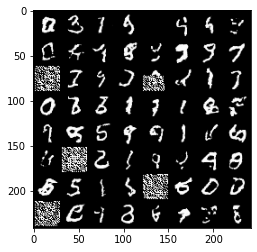

Epoch: [372/500]) Negative Log-Likelihood: -3694.14990234375
Epoch: [373/500]) Batch: [1/75] Negative Log-Likelihood: -3706.1865234375


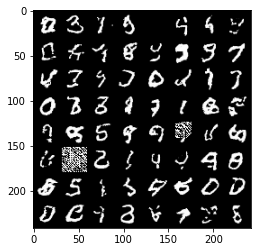

Epoch: [373/500]) Batch: [2/75] Negative Log-Likelihood: -3705.364013671875
Epoch: [373/500]) Batch: [3/75] Negative Log-Likelihood: -3721.11279296875
Epoch: [373/500]) Batch: [4/75] Negative Log-Likelihood: -3706.43310546875
Epoch: [373/500]) Batch: [5/75] Negative Log-Likelihood: -3716.961669921875
Epoch: [373/500]) Batch: [6/75] Negative Log-Likelihood: -3717.279296875
Epoch: [373/500]) Batch: [7/75] Negative Log-Likelihood: -3711.15185546875
Epoch: [373/500]) Batch: [8/75] Negative Log-Likelihood: -3723.42431640625
Epoch: [373/500]) Batch: [9/75] Negative Log-Likelihood: -3727.691162109375
Epoch: [373/500]) Batch: [10/75] Negative Log-Likelihood: -3725.211181640625
Epoch: [373/500]) Batch: [11/75] Negative Log-Likelihood: -3721.774169921875
Epoch: [373/500]) Batch: [12/75] Negative Log-Likelihood: -3718.7607421875
Epoch: [373/500]) Batch: [13/75] Negative Log-Likelihood: -3711.40625
Epoch: [373/500]) Batch: [14/75] Negative Log-Likelihood: -3708.697998046875
Epoch: [373/500]) Batch

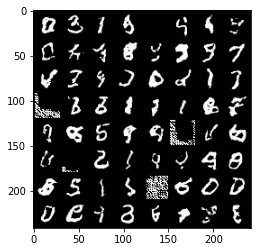

Epoch: [373/500]) Negative Log-Likelihood: -3690.939208984375
Epoch: [374/500]) Batch: [1/75] Negative Log-Likelihood: -3711.5419921875


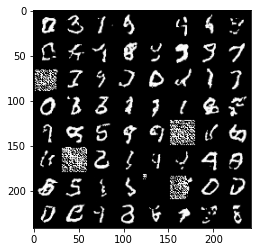

Epoch: [374/500]) Batch: [2/75] Negative Log-Likelihood: -3709.7236328125
Epoch: [374/500]) Batch: [3/75] Negative Log-Likelihood: -3715.3798828125
Epoch: [374/500]) Batch: [4/75] Negative Log-Likelihood: -3701.771728515625
Epoch: [374/500]) Batch: [5/75] Negative Log-Likelihood: -3713.298095703125
Epoch: [374/500]) Batch: [6/75] Negative Log-Likelihood: -3714.452392578125
Epoch: [374/500]) Batch: [7/75] Negative Log-Likelihood: -3709.37109375
Epoch: [374/500]) Batch: [8/75] Negative Log-Likelihood: -3719.33935546875
Epoch: [374/500]) Batch: [9/75] Negative Log-Likelihood: -3729.81982421875
Epoch: [374/500]) Batch: [10/75] Negative Log-Likelihood: -3720.774169921875
Epoch: [374/500]) Batch: [11/75] Negative Log-Likelihood: -3719.209228515625
Epoch: [374/500]) Batch: [12/75] Negative Log-Likelihood: -3718.05126953125
Epoch: [374/500]) Batch: [13/75] Negative Log-Likelihood: -3710.544189453125
Epoch: [374/500]) Batch: [14/75] Negative Log-Likelihood: -3719.66455078125
Epoch: [374/500]) B

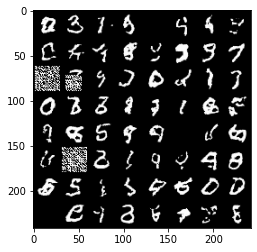

Epoch: [374/500]) Negative Log-Likelihood: -3695.96044921875
Epoch: [375/500]) Batch: [1/75] Negative Log-Likelihood: -3711.594970703125


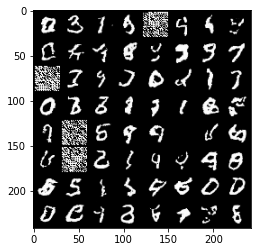

Epoch: [375/500]) Batch: [2/75] Negative Log-Likelihood: -3709.70458984375
Epoch: [375/500]) Batch: [3/75] Negative Log-Likelihood: -3718.5126953125
Epoch: [375/500]) Batch: [4/75] Negative Log-Likelihood: -3704.529541015625
Epoch: [375/500]) Batch: [5/75] Negative Log-Likelihood: -3713.34814453125
Epoch: [375/500]) Batch: [6/75] Negative Log-Likelihood: -3713.33056640625
Epoch: [375/500]) Batch: [7/75] Negative Log-Likelihood: -3708.3125
Epoch: [375/500]) Batch: [8/75] Negative Log-Likelihood: -3719.587646484375
Epoch: [375/500]) Batch: [9/75] Negative Log-Likelihood: -3726.947509765625
Epoch: [375/500]) Batch: [10/75] Negative Log-Likelihood: -3724.858642578125
Epoch: [375/500]) Batch: [11/75] Negative Log-Likelihood: -3720.89013671875
Epoch: [375/500]) Batch: [12/75] Negative Log-Likelihood: -3718.41796875
Epoch: [375/500]) Batch: [13/75] Negative Log-Likelihood: -3710.434326171875
Epoch: [375/500]) Batch: [14/75] Negative Log-Likelihood: -3717.40771484375
Epoch: [375/500]) Batch: [

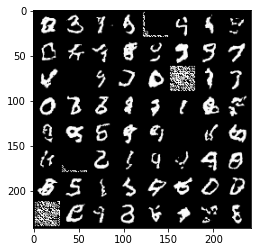

Epoch: [375/500]) Negative Log-Likelihood: -3685.6787109375
Epoch: [376/500]) Batch: [1/75] Negative Log-Likelihood: -3715.97607421875


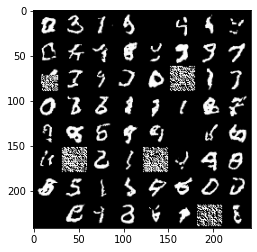

Epoch: [376/500]) Batch: [2/75] Negative Log-Likelihood: -3710.581787109375
Epoch: [376/500]) Batch: [3/75] Negative Log-Likelihood: -3720.4140625
Epoch: [376/500]) Batch: [4/75] Negative Log-Likelihood: -3703.064208984375
Epoch: [376/500]) Batch: [5/75] Negative Log-Likelihood: -3714.364990234375
Epoch: [376/500]) Batch: [6/75] Negative Log-Likelihood: -3716.8310546875
Epoch: [376/500]) Batch: [7/75] Negative Log-Likelihood: -3708.44677734375
Epoch: [376/500]) Batch: [8/75] Negative Log-Likelihood: -3718.416259765625
Epoch: [376/500]) Batch: [9/75] Negative Log-Likelihood: -3727.14794921875
Epoch: [376/500]) Batch: [10/75] Negative Log-Likelihood: -3712.213134765625
Epoch: [376/500]) Batch: [11/75] Negative Log-Likelihood: -3703.2548828125
Epoch: [376/500]) Batch: [12/75] Negative Log-Likelihood: -3712.726806640625
Epoch: [376/500]) Batch: [13/75] Negative Log-Likelihood: -3701.708740234375
Epoch: [376/500]) Batch: [14/75] Negative Log-Likelihood: -3713.549072265625
Epoch: [376/500]) 

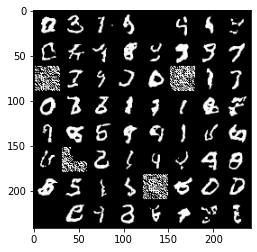

Epoch: [376/500]) Negative Log-Likelihood: -3698.64501953125
Epoch: [377/500]) Batch: [1/75] Negative Log-Likelihood: -3720.060546875


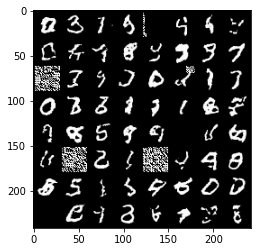

Epoch: [377/500]) Batch: [2/75] Negative Log-Likelihood: -3719.722412109375
Epoch: [377/500]) Batch: [3/75] Negative Log-Likelihood: -3727.966796875
Epoch: [377/500]) Batch: [4/75] Negative Log-Likelihood: -3708.424560546875
Epoch: [377/500]) Batch: [5/75] Negative Log-Likelihood: -3717.795166015625
Epoch: [377/500]) Batch: [6/75] Negative Log-Likelihood: -3717.436767578125
Epoch: [377/500]) Batch: [7/75] Negative Log-Likelihood: -3706.08740234375
Epoch: [377/500]) Batch: [8/75] Negative Log-Likelihood: -3721.196044921875
Epoch: [377/500]) Batch: [9/75] Negative Log-Likelihood: -3728.220458984375
Epoch: [377/500]) Batch: [10/75] Negative Log-Likelihood: -3725.09765625
Epoch: [377/500]) Batch: [11/75] Negative Log-Likelihood: -3726.530029296875
Epoch: [377/500]) Batch: [12/75] Negative Log-Likelihood: -3723.47607421875
Epoch: [377/500]) Batch: [13/75] Negative Log-Likelihood: -3720.734375
Epoch: [377/500]) Batch: [14/75] Negative Log-Likelihood: -3723.256103515625
Epoch: [377/500]) Batc

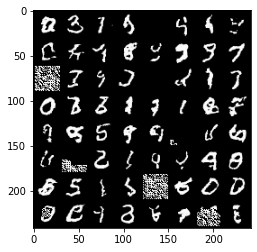

Epoch: [377/500]) Negative Log-Likelihood: -3694.626220703125
Epoch: [378/500]) Batch: [1/75] Negative Log-Likelihood: -3714.316162109375


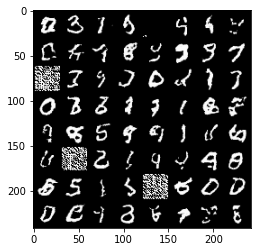

Epoch: [378/500]) Batch: [2/75] Negative Log-Likelihood: -3709.017333984375
Epoch: [378/500]) Batch: [3/75] Negative Log-Likelihood: -3720.3349609375
Epoch: [378/500]) Batch: [4/75] Negative Log-Likelihood: -3708.308349609375
Epoch: [378/500]) Batch: [5/75] Negative Log-Likelihood: -3715.751708984375
Epoch: [378/500]) Batch: [6/75] Negative Log-Likelihood: -3716.856689453125
Epoch: [378/500]) Batch: [7/75] Negative Log-Likelihood: -3713.298583984375
Epoch: [378/500]) Batch: [8/75] Negative Log-Likelihood: -3723.713623046875
Epoch: [378/500]) Batch: [9/75] Negative Log-Likelihood: -3728.053955078125
Epoch: [378/500]) Batch: [10/75] Negative Log-Likelihood: -3725.686279296875
Epoch: [378/500]) Batch: [11/75] Negative Log-Likelihood: -3726.706787109375
Epoch: [378/500]) Batch: [12/75] Negative Log-Likelihood: -3723.47802734375
Epoch: [378/500]) Batch: [13/75] Negative Log-Likelihood: -3717.88427734375
Epoch: [378/500]) Batch: [14/75] Negative Log-Likelihood: -3719.309326171875
Epoch: [378

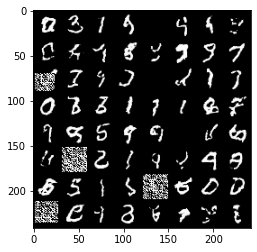

Epoch: [378/500]) Negative Log-Likelihood: -3693.013427734375
Epoch: [379/500]) Batch: [1/75] Negative Log-Likelihood: -3715.14990234375


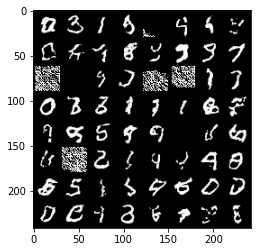

Epoch: [379/500]) Batch: [2/75] Negative Log-Likelihood: -3716.38720703125
Epoch: [379/500]) Batch: [3/75] Negative Log-Likelihood: -3723.316162109375
Epoch: [379/500]) Batch: [4/75] Negative Log-Likelihood: -3706.742431640625
Epoch: [379/500]) Batch: [5/75] Negative Log-Likelihood: -3720.71240234375
Epoch: [379/500]) Batch: [6/75] Negative Log-Likelihood: -3715.233154296875
Epoch: [379/500]) Batch: [7/75] Negative Log-Likelihood: -3712.072998046875
Epoch: [379/500]) Batch: [8/75] Negative Log-Likelihood: -3721.60986328125
Epoch: [379/500]) Batch: [9/75] Negative Log-Likelihood: -3728.8349609375
Epoch: [379/500]) Batch: [10/75] Negative Log-Likelihood: -3724.9169921875
Epoch: [379/500]) Batch: [11/75] Negative Log-Likelihood: -3727.361083984375
Epoch: [379/500]) Batch: [12/75] Negative Log-Likelihood: -3724.30126953125
Epoch: [379/500]) Batch: [13/75] Negative Log-Likelihood: -3719.490234375
Epoch: [379/500]) Batch: [14/75] Negative Log-Likelihood: -3719.731201171875
Epoch: [379/500]) 

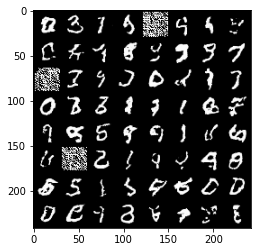

Epoch: [379/500]) Negative Log-Likelihood: -3700.63671875
Epoch: [380/500]) Batch: [1/75] Negative Log-Likelihood: -3716.833984375


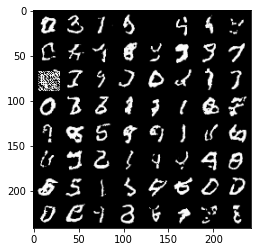

Epoch: [380/500]) Batch: [2/75] Negative Log-Likelihood: -3721.838623046875
Epoch: [380/500]) Batch: [3/75] Negative Log-Likelihood: -3722.882080078125
Epoch: [380/500]) Batch: [4/75] Negative Log-Likelihood: -3705.1962890625
Epoch: [380/500]) Batch: [5/75] Negative Log-Likelihood: -3710.54736328125
Epoch: [380/500]) Batch: [6/75] Negative Log-Likelihood: -3702.879638671875
Epoch: [380/500]) Batch: [7/75] Negative Log-Likelihood: -3702.58935546875
Epoch: [380/500]) Batch: [8/75] Negative Log-Likelihood: -3717.634521484375
Epoch: [380/500]) Batch: [9/75] Negative Log-Likelihood: -3723.139892578125
Epoch: [380/500]) Batch: [10/75] Negative Log-Likelihood: -3721.83056640625
Epoch: [380/500]) Batch: [11/75] Negative Log-Likelihood: -3722.08544921875
Epoch: [380/500]) Batch: [12/75] Negative Log-Likelihood: -3718.829345703125
Epoch: [380/500]) Batch: [13/75] Negative Log-Likelihood: -3713.5625
Epoch: [380/500]) Batch: [14/75] Negative Log-Likelihood: -3719.880126953125
Epoch: [380/500]) Bat

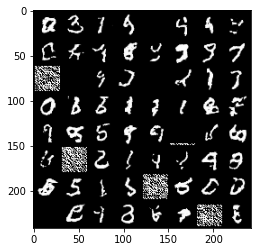

Epoch: [380/500]) Negative Log-Likelihood: -3688.628662109375
Epoch: [381/500]) Batch: [1/75] Negative Log-Likelihood: -3714.117431640625


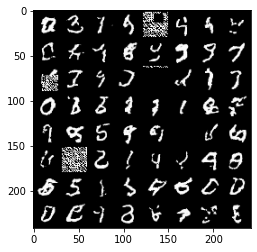

Epoch: [381/500]) Batch: [2/75] Negative Log-Likelihood: -3713.596435546875
Epoch: [381/500]) Batch: [3/75] Negative Log-Likelihood: -3721.686767578125
Epoch: [381/500]) Batch: [4/75] Negative Log-Likelihood: -3705.1279296875
Epoch: [381/500]) Batch: [5/75] Negative Log-Likelihood: -3715.95458984375
Epoch: [381/500]) Batch: [6/75] Negative Log-Likelihood: -3708.052490234375
Epoch: [381/500]) Batch: [7/75] Negative Log-Likelihood: -3707.027099609375
Epoch: [381/500]) Batch: [8/75] Negative Log-Likelihood: -3715.60888671875
Epoch: [381/500]) Batch: [9/75] Negative Log-Likelihood: -3727.008056640625
Epoch: [381/500]) Batch: [10/75] Negative Log-Likelihood: -3723.753662109375
Epoch: [381/500]) Batch: [11/75] Negative Log-Likelihood: -3718.919189453125
Epoch: [381/500]) Batch: [12/75] Negative Log-Likelihood: -3713.1767578125
Epoch: [381/500]) Batch: [13/75] Negative Log-Likelihood: -3711.334716796875
Epoch: [381/500]) Batch: [14/75] Negative Log-Likelihood: -3715.635498046875
Epoch: [381/5

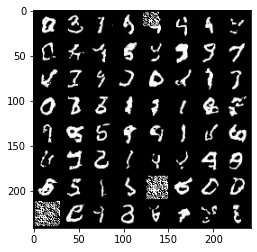

Epoch: [381/500]) Negative Log-Likelihood: -3687.136474609375
Epoch: [382/500]) Batch: [1/75] Negative Log-Likelihood: -3697.1474609375


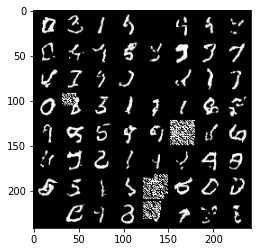

Epoch: [382/500]) Batch: [2/75] Negative Log-Likelihood: -3706.311279296875
Epoch: [382/500]) Batch: [3/75] Negative Log-Likelihood: -3719.299560546875
Epoch: [382/500]) Batch: [4/75] Negative Log-Likelihood: -3699.718994140625
Epoch: [382/500]) Batch: [5/75] Negative Log-Likelihood: -3713.310546875
Epoch: [382/500]) Batch: [6/75] Negative Log-Likelihood: -3716.769287109375
Epoch: [382/500]) Batch: [7/75] Negative Log-Likelihood: -3707.289306640625
Epoch: [382/500]) Batch: [8/75] Negative Log-Likelihood: -3718.736083984375
Epoch: [382/500]) Batch: [9/75] Negative Log-Likelihood: -3718.153076171875
Epoch: [382/500]) Batch: [10/75] Negative Log-Likelihood: -3719.072998046875
Epoch: [382/500]) Batch: [11/75] Negative Log-Likelihood: -3716.7685546875
Epoch: [382/500]) Batch: [12/75] Negative Log-Likelihood: -3713.369873046875
Epoch: [382/500]) Batch: [13/75] Negative Log-Likelihood: -3717.076904296875
Epoch: [382/500]) Batch: [14/75] Negative Log-Likelihood: -3717.89111328125
Epoch: [382/5

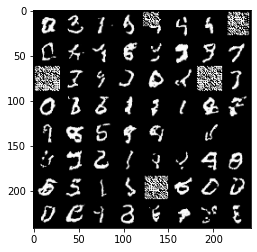

Epoch: [382/500]) Negative Log-Likelihood: -3692.872314453125
Epoch: [383/500]) Batch: [1/75] Negative Log-Likelihood: -3713.63427734375


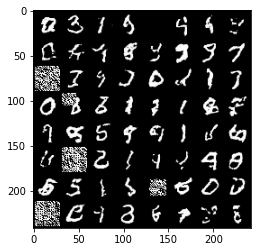

Epoch: [383/500]) Batch: [2/75] Negative Log-Likelihood: -3716.22998046875
Epoch: [383/500]) Batch: [3/75] Negative Log-Likelihood: -3719.706787109375
Epoch: [383/500]) Batch: [4/75] Negative Log-Likelihood: -3698.298583984375
Epoch: [383/500]) Batch: [5/75] Negative Log-Likelihood: -3703.825927734375
Epoch: [383/500]) Batch: [6/75] Negative Log-Likelihood: -3713.151123046875
Epoch: [383/500]) Batch: [7/75] Negative Log-Likelihood: -3705.271240234375
Epoch: [383/500]) Batch: [8/75] Negative Log-Likelihood: -3716.797607421875
Epoch: [383/500]) Batch: [9/75] Negative Log-Likelihood: -3723.1787109375
Epoch: [383/500]) Batch: [10/75] Negative Log-Likelihood: -3717.058349609375
Epoch: [383/500]) Batch: [11/75] Negative Log-Likelihood: -3713.075439453125
Epoch: [383/500]) Batch: [12/75] Negative Log-Likelihood: -3704.203125
Epoch: [383/500]) Batch: [13/75] Negative Log-Likelihood: -3703.93701171875
Epoch: [383/500]) Batch: [14/75] Negative Log-Likelihood: -3712.6748046875
Epoch: [383/500]) B

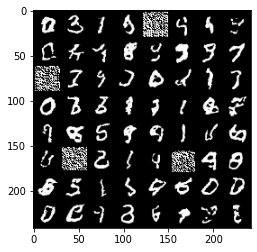

Epoch: [383/500]) Negative Log-Likelihood: -3683.645263671875
Epoch: [384/500]) Batch: [1/75] Negative Log-Likelihood: -3713.828125


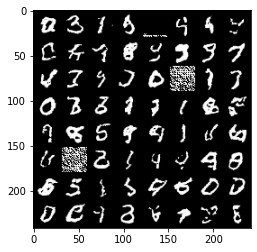

Epoch: [384/500]) Batch: [2/75] Negative Log-Likelihood: -3707.635009765625
Epoch: [384/500]) Batch: [3/75] Negative Log-Likelihood: -3714.85546875
Epoch: [384/500]) Batch: [4/75] Negative Log-Likelihood: -3700.04052734375
Epoch: [384/500]) Batch: [5/75] Negative Log-Likelihood: -3717.159912109375
Epoch: [384/500]) Batch: [6/75] Negative Log-Likelihood: -3712.86767578125
Epoch: [384/500]) Batch: [7/75] Negative Log-Likelihood: -3710.98681640625
Epoch: [384/500]) Batch: [8/75] Negative Log-Likelihood: -3719.284912109375
Epoch: [384/500]) Batch: [9/75] Negative Log-Likelihood: -3726.071533203125
Epoch: [384/500]) Batch: [10/75] Negative Log-Likelihood: -3722.684326171875
Epoch: [384/500]) Batch: [11/75] Negative Log-Likelihood: -3716.040283203125
Epoch: [384/500]) Batch: [12/75] Negative Log-Likelihood: -3715.371826171875
Epoch: [384/500]) Batch: [13/75] Negative Log-Likelihood: -3711.29833984375
Epoch: [384/500]) Batch: [14/75] Negative Log-Likelihood: -3717.85986328125
Epoch: [384/500]

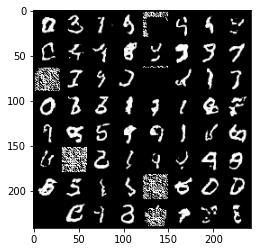

Epoch: [384/500]) Negative Log-Likelihood: -3691.735595703125
Epoch: [385/500]) Batch: [1/75] Negative Log-Likelihood: -3710.695556640625


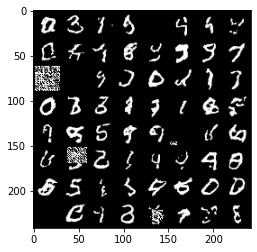

Epoch: [385/500]) Batch: [2/75] Negative Log-Likelihood: -3714.60107421875
Epoch: [385/500]) Batch: [3/75] Negative Log-Likelihood: -3723.84423828125
Epoch: [385/500]) Batch: [4/75] Negative Log-Likelihood: -3704.166259765625
Epoch: [385/500]) Batch: [5/75] Negative Log-Likelihood: -3718.789794921875
Epoch: [385/500]) Batch: [6/75] Negative Log-Likelihood: -3712.356201171875
Epoch: [385/500]) Batch: [7/75] Negative Log-Likelihood: -3702.2568359375
Epoch: [385/500]) Batch: [8/75] Negative Log-Likelihood: -3720.646240234375
Epoch: [385/500]) Batch: [9/75] Negative Log-Likelihood: -3726.193115234375
Epoch: [385/500]) Batch: [10/75] Negative Log-Likelihood: -3724.347412109375
Epoch: [385/500]) Batch: [11/75] Negative Log-Likelihood: -3724.95556640625
Epoch: [385/500]) Batch: [12/75] Negative Log-Likelihood: -3723.760498046875
Epoch: [385/500]) Batch: [13/75] Negative Log-Likelihood: -3718.501220703125
Epoch: [385/500]) Batch: [14/75] Negative Log-Likelihood: -3723.10400390625
Epoch: [385/5

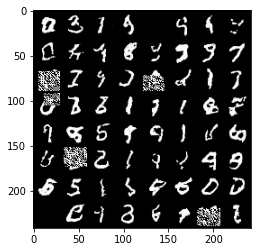

Epoch: [385/500]) Negative Log-Likelihood: -3685.906494140625
Epoch: [386/500]) Batch: [1/75] Negative Log-Likelihood: -3697.71240234375


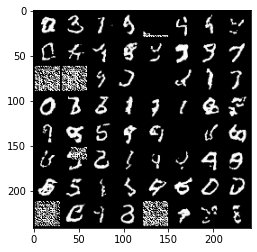

Epoch: [386/500]) Batch: [2/75] Negative Log-Likelihood: -3716.78369140625
Epoch: [386/500]) Batch: [3/75] Negative Log-Likelihood: -3715.4638671875
Epoch: [386/500]) Batch: [4/75] Negative Log-Likelihood: -3697.708984375
Epoch: [386/500]) Batch: [5/75] Negative Log-Likelihood: -3714.8984375
Epoch: [386/500]) Batch: [6/75] Negative Log-Likelihood: -3713.828369140625
Epoch: [386/500]) Batch: [7/75] Negative Log-Likelihood: -3708.178955078125
Epoch: [386/500]) Batch: [8/75] Negative Log-Likelihood: -3710.1474609375
Epoch: [386/500]) Batch: [9/75] Negative Log-Likelihood: -3719.806884765625
Epoch: [386/500]) Batch: [10/75] Negative Log-Likelihood: -3721.625244140625
Epoch: [386/500]) Batch: [11/75] Negative Log-Likelihood: -3720.17431640625
Epoch: [386/500]) Batch: [12/75] Negative Log-Likelihood: -3716.798583984375
Epoch: [386/500]) Batch: [13/75] Negative Log-Likelihood: -3715.24365234375
Epoch: [386/500]) Batch: [14/75] Negative Log-Likelihood: -3716.796142578125
Epoch: [386/500]) Batc

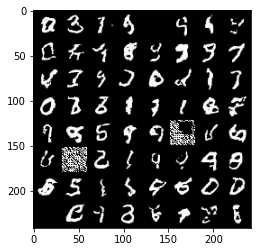

Epoch: [386/500]) Negative Log-Likelihood: -3688.443115234375
Epoch: [387/500]) Batch: [1/75] Negative Log-Likelihood: -3716.450439453125


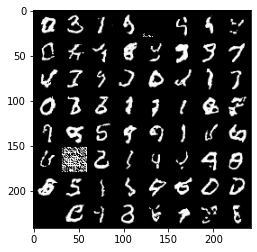

Epoch: [387/500]) Batch: [2/75] Negative Log-Likelihood: -3716.095947265625
Epoch: [387/500]) Batch: [3/75] Negative Log-Likelihood: -3722.106201171875
Epoch: [387/500]) Batch: [4/75] Negative Log-Likelihood: -3707.33935546875
Epoch: [387/500]) Batch: [5/75] Negative Log-Likelihood: -3719.339599609375
Epoch: [387/500]) Batch: [6/75] Negative Log-Likelihood: -3721.4423828125
Epoch: [387/500]) Batch: [7/75] Negative Log-Likelihood: -3709.215576171875
Epoch: [387/500]) Batch: [8/75] Negative Log-Likelihood: -3722.669921875
Epoch: [387/500]) Batch: [9/75] Negative Log-Likelihood: -3726.65087890625
Epoch: [387/500]) Batch: [10/75] Negative Log-Likelihood: -3720.170654296875
Epoch: [387/500]) Batch: [11/75] Negative Log-Likelihood: -3724.681884765625
Epoch: [387/500]) Batch: [12/75] Negative Log-Likelihood: -3718.193115234375
Epoch: [387/500]) Batch: [13/75] Negative Log-Likelihood: -3713.794189453125
Epoch: [387/500]) Batch: [14/75] Negative Log-Likelihood: -3724.351806640625
Epoch: [387/50

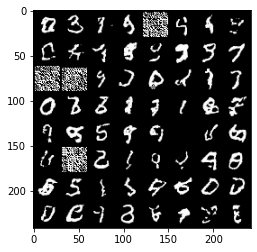

Epoch: [387/500]) Negative Log-Likelihood: -3695.86865234375
Epoch: [388/500]) Batch: [1/75] Negative Log-Likelihood: -3712.1240234375


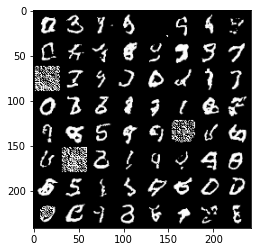

Epoch: [388/500]) Batch: [2/75] Negative Log-Likelihood: -3714.4248046875
Epoch: [388/500]) Batch: [3/75] Negative Log-Likelihood: -3718.4287109375
Epoch: [388/500]) Batch: [4/75] Negative Log-Likelihood: -3698.02294921875
Epoch: [388/500]) Batch: [5/75] Negative Log-Likelihood: -3712.282958984375
Epoch: [388/500]) Batch: [6/75] Negative Log-Likelihood: -3713.44970703125
Epoch: [388/500]) Batch: [7/75] Negative Log-Likelihood: -3698.9375
Epoch: [388/500]) Batch: [8/75] Negative Log-Likelihood: -3699.06640625
Epoch: [388/500]) Batch: [9/75] Negative Log-Likelihood: -3714.559814453125
Epoch: [388/500]) Batch: [10/75] Negative Log-Likelihood: -3715.31640625
Epoch: [388/500]) Batch: [11/75] Negative Log-Likelihood: -3709.957763671875
Epoch: [388/500]) Batch: [12/75] Negative Log-Likelihood: -3713.219970703125
Epoch: [388/500]) Batch: [13/75] Negative Log-Likelihood: -3699.280517578125
Epoch: [388/500]) Batch: [14/75] Negative Log-Likelihood: -3710.760498046875
Epoch: [388/500]) Batch: [15/

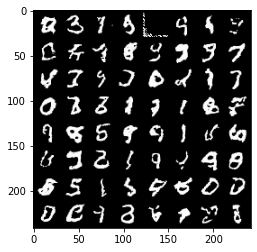

Epoch: [388/500]) Negative Log-Likelihood: -3680.20361328125
Epoch: [389/500]) Batch: [1/75] Negative Log-Likelihood: -3687.3564453125


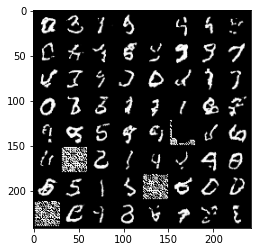

Epoch: [389/500]) Batch: [2/75] Negative Log-Likelihood: -3703.121826171875
Epoch: [389/500]) Batch: [3/75] Negative Log-Likelihood: -3709.25244140625
Epoch: [389/500]) Batch: [4/75] Negative Log-Likelihood: -3677.011474609375
Epoch: [389/500]) Batch: [5/75] Negative Log-Likelihood: -3700.171875
Epoch: [389/500]) Batch: [6/75] Negative Log-Likelihood: -3702.7705078125
Epoch: [389/500]) Batch: [7/75] Negative Log-Likelihood: -3672.70361328125
Epoch: [389/500]) Batch: [8/75] Negative Log-Likelihood: -3685.044189453125
Epoch: [389/500]) Batch: [9/75] Negative Log-Likelihood: -3709.962158203125
Epoch: [389/500]) Batch: [10/75] Negative Log-Likelihood: -3709.833740234375
Epoch: [389/500]) Batch: [11/75] Negative Log-Likelihood: -3695.046875
Epoch: [389/500]) Batch: [12/75] Negative Log-Likelihood: -3697.54833984375
Epoch: [389/500]) Batch: [13/75] Negative Log-Likelihood: -3703.609619140625
Epoch: [389/500]) Batch: [14/75] Negative Log-Likelihood: -3707.49609375
Epoch: [389/500]) Batch: [15

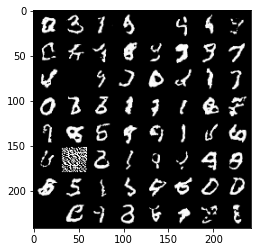

Epoch: [389/500]) Negative Log-Likelihood: -3694.08935546875
Epoch: [390/500]) Batch: [1/75] Negative Log-Likelihood: -3712.175537109375


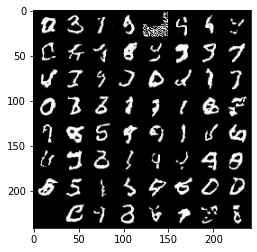

Epoch: [390/500]) Batch: [2/75] Negative Log-Likelihood: -3708.3447265625
Epoch: [390/500]) Batch: [3/75] Negative Log-Likelihood: -3721.336669921875
Epoch: [390/500]) Batch: [4/75] Negative Log-Likelihood: -3702.5703125
Epoch: [390/500]) Batch: [5/75] Negative Log-Likelihood: -3708.171875
Epoch: [390/500]) Batch: [6/75] Negative Log-Likelihood: -3711.8232421875
Epoch: [390/500]) Batch: [7/75] Negative Log-Likelihood: -3710.30615234375
Epoch: [390/500]) Batch: [8/75] Negative Log-Likelihood: -3716.953125
Epoch: [390/500]) Batch: [9/75] Negative Log-Likelihood: -3726.282958984375
Epoch: [390/500]) Batch: [10/75] Negative Log-Likelihood: -3725.793701171875
Epoch: [390/500]) Batch: [11/75] Negative Log-Likelihood: -3718.091796875
Epoch: [390/500]) Batch: [12/75] Negative Log-Likelihood: -3715.828125
Epoch: [390/500]) Batch: [13/75] Negative Log-Likelihood: -3712.0517578125
Epoch: [390/500]) Batch: [14/75] Negative Log-Likelihood: -3716.86962890625
Epoch: [390/500]) Batch: [15/75] Negative

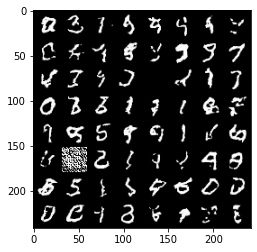

Epoch: [390/500]) Negative Log-Likelihood: -3685.72021484375
Epoch: [391/500]) Batch: [1/75] Negative Log-Likelihood: -3697.87451171875


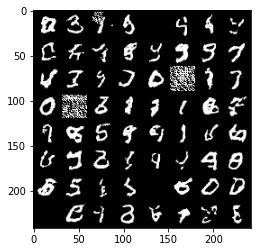

Epoch: [391/500]) Batch: [2/75] Negative Log-Likelihood: -3706.803955078125
Epoch: [391/500]) Batch: [3/75] Negative Log-Likelihood: -3714.570556640625
Epoch: [391/500]) Batch: [4/75] Negative Log-Likelihood: -3698.97900390625
Epoch: [391/500]) Batch: [5/75] Negative Log-Likelihood: -3701.777099609375
Epoch: [391/500]) Batch: [6/75] Negative Log-Likelihood: -3675.97607421875
Epoch: [391/500]) Batch: [7/75] Negative Log-Likelihood: -3682.891845703125
Epoch: [391/500]) Batch: [8/75] Negative Log-Likelihood: -3702.526123046875
Epoch: [391/500]) Batch: [9/75] Negative Log-Likelihood: -3712.74609375
Epoch: [391/500]) Batch: [10/75] Negative Log-Likelihood: -3711.02294921875
Epoch: [391/500]) Batch: [11/75] Negative Log-Likelihood: -3704.4990234375
Epoch: [391/500]) Batch: [12/75] Negative Log-Likelihood: -3711.266845703125
Epoch: [391/500]) Batch: [13/75] Negative Log-Likelihood: -3702.9775390625
Epoch: [391/500]) Batch: [14/75] Negative Log-Likelihood: -3693.036865234375
Epoch: [391/500]) 

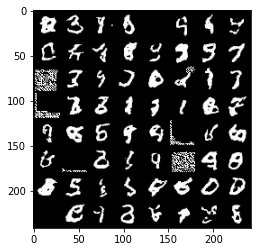

Epoch: [391/500]) Negative Log-Likelihood: -3691.1630859375
Epoch: [392/500]) Batch: [1/75] Negative Log-Likelihood: -3709.95556640625


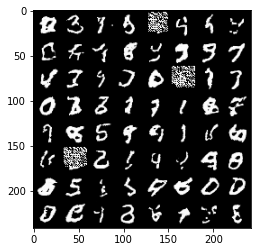

Epoch: [392/500]) Batch: [2/75] Negative Log-Likelihood: -3708.16796875
Epoch: [392/500]) Batch: [3/75] Negative Log-Likelihood: -3711.6796875
Epoch: [392/500]) Batch: [4/75] Negative Log-Likelihood: -3692.2529296875


ERROR:root:Internal Python error in the inspect module.
Below is the traceback from this internal error.



Traceback (most recent call last):
  File "/home/jason/.local/lib/python3.6/site-packages/IPython/core/interactiveshell.py", line 3343, in run_code
    exec(code_obj, self.user_global_ns, self.user_ns)
  File "<ipython-input-15-bd79b813c1a6>", line 23, in <module>
    nll = -model.log_prob(x, device).mean()
  File "<ipython-input-13-e98576962061>", line 67, in log_prob
    zs, logdet = self.forward(input, device)
  File "<ipython-input-13-e98576962061>", line 24, in forward
    z, logdet = self.flows[-1](z, logdet)
  File "/home/jason/.local/lib/python3.6/site-packages/torch/nn/modules/module.py", line 727, in _call_impl
    result = self.forward(*input, **kwargs)
  File "<ipython-input-12-cc6974c08cf1>", line 13, in forward
    out, logdet = flow(out, logdet)
  File "/home/jason/.local/lib/python3.6/site-packages/torch/nn/modules/module.py", line 727, in _call_impl
    result = self.forward(*input, **kwargs)
  File "<ipython-input-11-fa7ee0813d7b>", line 15, in forward
    out, logdet

TypeError: object of type 'NoneType' has no len()

In [15]:
from torch import autograd
import torch.nn.utils as utils

def gen_checkpoint():
    return

num_epochs = 500
optimizer = torch.optim.Adam(model.parameters(), lr=1e-3)
scheduler = torch.optim.lr_scheduler.CosineAnnealingWarmRestarts(optimizer, T_0=100, T_mult=1, eta_min=0.001, last_epoch=-1)
device = 'cuda' if torch.cuda.is_available() else 'cpu'
model = model.to(device)
fixed_sample, fixed_logdet = model.gen_z((64,1,28,28), device)
sample_record = []
ll_record = []

#TODO: Checkpoint

for e in range(num_epochs):
    for batch_idx, (x, _) in enumerate(train_loader):
        x = x.to(device)
        logdet = torch.zeros(x.shape[0]).to(device)
        optimizer.zero_grad()
        nll = -model.log_prob(x, device).mean()
        nll.backward()

        for group in optimizer.param_groups:
            utils.clip_grad_norm_(group['params'], 1, 2)

        optimizer.step()
        scheduler.step()

        print(f'Epoch: [{e+1}/{num_epochs}]) Batch: [{batch_idx+1}/{len(train_loader)}] Negative Log-Likelihood: {nll.item()}')
        
        if batch_idx % 10 == 0:
            samples, _ = model.inverse(fixed_sample, fixed_logdet)
            samples = samples.detach().cpu() 

            ll_record.append(nll.item())
            sample_record.append(samples)
        
        
        if batch_idx % 100 == 0:
            batch_grid = make_grid(samples, normalize=True)
            show(batch_grid)

    
    batch_grid = make_grid(samples, normalize=True)
    show(batch_grid)

    print(f'Epoch: [{e+1}/{num_epochs}]) Negative Log-Likelihood: {nll.item()}')
        

In [36]:
for n, p in model.named_parameters():
    print(n, p.max().item(), p.min().item(), p.mean().item(), p.var().item())

flows.0.flows.0.actnorm.scale 0.35314685106277466 0.3034805655479431 0.31899505853652954 0.0005337359034456313
flows.0.flows.0.actnorm.bias 1.4291476011276245 1.4010841846466064 1.4123841524124146 0.00017543519788887352
flows.0.flows.0.invconv.W 0.8093035221099854 -0.9471094012260437 -0.17369845509529114 0.2956017851829529
flows.0.flows.0.affine.st.scaling -0.06965474039316177 -1.4358863830566406 -0.6429975032806396 0.3624490797519684
flows.0.flows.0.affine.st.conv1.weight 0.3861662745475769 -0.5925466418266296 -0.004426227882504463 0.006447752937674522
flows.0.flows.0.affine.st.an1.scale 5.025737285614014 2.3043885231018066 3.1870882511138916 0.36373043060302734
flows.0.flows.0.affine.st.an1.bias 0.33372125029563904 -0.21861158311367035 0.016492949798703194 0.016160383820533752
flows.0.flows.0.affine.st.conv2.weight 0.2370338886976242 -0.22734461724758148 -0.0016965961549431086 0.007442285772413015
flows.0.flows.0.affine.st.an2.scale 4.047968864440918 2.0892317295074463 3.072829723358

In [ ]:
from datetime import datetime
timestamp = datetime.now().strftime('%m-%d-%Y-%H:%M:%S')

# Save Checkpoint and Records
PATH = f'{timestamp}-{DATASET}.pt'

torch.save({
        'epoch': e,
        'model_state_dict': model.state_dict(),
        'optimizer_state_dict': optimizer.state_dict(),
        'scheduler_state_dict': scheduler.state_dict(),
        'train_nll': nll,
        'K': K,
        'L': L,
        'in_dim': 1,
        'num_hidden': 32
        #'test_ll': average_ll
    }, PATH)


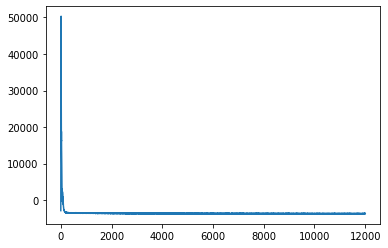

In [28]:
plt.plot(range(len(ll_record)), ll_record)

/usr/lib/python3/dist-packages/ipykernel_launcher.py:5: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  """


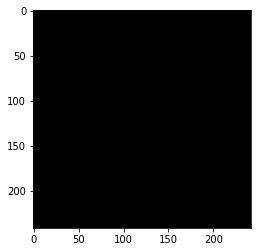

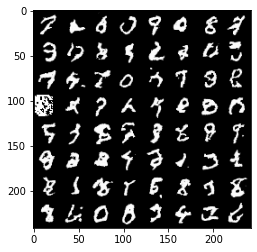

In [29]:
import skvideo.io
import numpy as np

def batch2grid(batch: np.array) -> np.array:
    batch = torch.tensor(batch).clip(0,1)*255
    grid = make_grid(batch).numpy().transpose(1,2,0)
    return grid.astype(np.uint8)

MP4_PATH = f'{timestamp}-{DATASET}.mp4'
    
sample_record_grid = [ batch2grid(sr) for sr in sample_record]
plt.imshow(sample_record_grid[0])
plt.show()
plt.imshow(sample_record_grid[-1])

skvideo.io.vwrite(MP4_PATH, sample_record_grid)